**stage2_DANN_HPsearch.ipynb**. This notebook attempts to search the hyperparameter that yields the optimal validation performance.

**Edit**<br/>

**TODO**<br/>

# Import packages and get authenticated

In [ ]:
# from google.colab import drive
# drive.mount('drive')

In [1]:
import numpy as np

import pandas as pd
pd.set_option('display.max_columns', 500)
from tqdm import tqdm_notebook as tqdm
from IPython.display import display
import os
import sys
sys.path.append('/content/drive/My Drive/中研院/repo/')
# sys.path.append('~/project_FDDAT/repo/')
sys.path.append('../') # add this line so Data and data are visible in this file
from os.path import expanduser
home = expanduser("~")

from falldetect.utilities import *
from falldetect.models import *
from falldetect.dataset_util import *
from falldetect.training_util import *
from falldetect.eval_util import *

import time
import datetime
from datetime import datetime
import json
import argparse

# Plotting
# checklist 1: comment inline, uncomment Agg
%matplotlib inline
import matplotlib
# matplotlib.use('Agg')
import matplotlib.pyplot as plt
matplotlib.rc( 'savefig', facecolor = 'white' )

from sklearn.decomposition import PCA

import torch
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
import torch.nn.functional as F

# Get user inputs
In ipython notebook, these are hardcoded. In production python code, use parsers to provide these inputs

In [3]:
# tasks_list = [('UMAFall_waist', 'UPFall_belt'), ('UMAFall_waist', 'UPFall_belt')]

# # extractor_type = 'CNN'
# # num_epochs = 2
# # CV_n = 2
# device = torch.device('cuda:1' if torch.cuda.is_available() else 'cpu')


In [4]:
parser = argparse.ArgumentParser(description='FD_DAT')
parser.add_argument('--input_folder', metavar='input_folder', help='input_folder',
                    default='../')
parser.add_argument('--output_folder', metavar='output_folder', help='output_folder',
                    default='../')
parser.add_argument('--extractor_type', metavar='extractor_type', help='extractor_type',
                    default='CNN')
parser.add_argument('--num_epochs', type=int, metavar='num_epochs', help='number of epochs',
                    default='5')
parser.add_argument('--CV_n', type=int, metavar='CV_n', help='CV folds',
                    default='../')
parser.add_argument('--tasks_list', metavar='tasks_list', help='a list of all tasks',
                    default='UMAFall_waist_UPFall_belt UPFall_wrist_UMAFall_ankle')



# split_mode = 'LOO'
# split_mode = '5fold'

# checklist 2: comment first line, uncomment second line seizures_FN
args = parser.parse_args(['--input_folder', 'stage1_preprocessed_18hz_5fold', 
                          '--output_folder', 'stage2_modeloutput_18hz_5fold',
                          '--extractor_type', 'CNN',
                          '--num_epochs', '2',
                          '--CV_n', '2',
                          '--tasks_list', 'UMAFall_waist-UPFall_belt UPFall_wrist-UMAFall_ankle',])
                          
# args = parser.parse_args()

In [5]:
home_dir = home+'/project_FDDAT/'
input_folder = args.input_folder
output_folder = args.output_folder
extractor_type = args.extractor_type
num_epochs = args.num_epochs
CV_n = args.CV_n

tasks_list = []
for item in args.tasks_list.split(' '):
    tasks_list.append((item.split('-')[0], item.split('-')[1]))
    
inputdir = home_dir + 'data_mic/{}/'.format(input_folder)

device = torch.device('cuda:1' if torch.cuda.is_available() else 'cpu')

In [6]:
# CV_n = 17
# tasks_list = [('UMAFall_wrist', 'UPFall_neck'), ('UMAFall_wrist', 'UPFall_belt'), ('UMAFall_wrist', 'UPFall_ankle'),
#               ('UMAFall_waist', 'UPFall_neck'), ('UMAFall_waist', 'UPFall_wrist'), ('UMAFall_waist', 'UPFall_ankle'),
#               ('UMAFall_ankle', 'UPFall_neck'), ('UMAFall_ankle', 'UPFall_wrist'), ('UMAFall_ankle', 'UPFall_belt')]

# CV_n = 15
# tasks_list = [('UMAFall_wrist', 'UPFall_rightpocket'), ('UMAFall_waist', 'UPFall_rightpocket'), ('UMAFall_ankle', 'UPFall_rightpocket'),
#               ('UMAFall_leg', 'UPFall_neck'), ('UMAFall_leg', 'UPFall_wrist'), ('UMAFall_leg', 'UPFall_belt'), ('UMAFall_leg', 'UPFall_ankle')]


# new arch HP search

In [7]:
# def get_optimal(df_performance_table_agg):
#     df_performance_table_agg_temp = df_performance_table_agg.copy()

#     result = df_performance_table_agg_temp[['HP_i0','HP_i1','HP_i2']].sort_values(by='DANN', ascending=False, axis=1)
#     batch_size_optimal = result.loc['batch_size'][0]

#     result = df_performance_table_agg_temp[['HP_i3','HP_i3_1','HP_i4']].sort_values(by='DANN', ascending=False, axis=1)
#     channel_n_optimal = result.loc['channel_n'][0]

#     result = df_performance_table_agg_temp[['HP_i5','HP_i5_1','HP_i6']].sort_values(by='DANN', ascending=False, axis=1)
#     learning_rate_optimal = result.loc['learning_rate'][0]

#     return int(batch_size_optimal), int(channel_n_optimal), learning_rate_optimal

In [8]:
training_params_list = [
  {
    'HP_name': 'HP_i0',
    'classes_n': 2,
    'CV_n': CV_n,
    'num_epochs': num_epochs,
    'channel_n': 4,
    'batch_size': 16,
    'learning_rate': 0.01,
    'extractor_type': extractor_type,
    'device': device,
    'dropout': 0.5,
    'hiddenDim_f': 3,
    'hiddenDim_y': 3,
    'hiddenDim_d': 3,
    'win_size': 18,
    'win_stride': 6,
    'step_n': 9,
  },

  {
    'HP_name': 'HP_i1',
    'classes_n': 2,
    'CV_n': CV_n,
    'num_epochs': num_epochs,
    'channel_n': 4,
    'batch_size': 4,
    'learning_rate': 0.01,
    'extractor_type': extractor_type,
    'device': device,
    'dropout': 0.5,
    'hiddenDim_f': 3,
    'hiddenDim_y': 3,
    'hiddenDim_d': 3,
    'win_size': 18,
    'win_stride': 6,
    'step_n': 9,
  },

  {
    'HP_name': 'HP_i2',
    'classes_n': 2,
    'CV_n': CV_n,
    'num_epochs': num_epochs,
    'channel_n': 4,
    'batch_size': 64,
    'learning_rate': 0.01,
    'extractor_type': extractor_type,
    'device': device,
    'dropout': 0.5,
    'hiddenDim_f': 3,
    'hiddenDim_y': 3,
    'hiddenDim_d': 3,
    'win_size': 18,
    'win_stride': 6,
    'step_n': 9,
  },
    
  {
    'HP_name': 'HP_i3',
    'classes_n': 2,
    'CV_n': CV_n,
    'num_epochs': num_epochs,
    'channel_n': 16,
    'batch_size': 4,
    'learning_rate': 0.01,
    'extractor_type': extractor_type,
    'device': device,
    'dropout': 0.5,
    'hiddenDim_f': 3,
    'hiddenDim_y': 3,
    'hiddenDim_d': 3,
    'win_size': 18,
    'win_stride': 6,
    'step_n': 9,
  },

  {
    'HP_name': 'HP_i4',
    'classes_n': 2,
    'CV_n': CV_n,
    'num_epochs': num_epochs,
    'channel_n': 32,
    'batch_size': 4,
    'learning_rate': 0.01,
    'extractor_type': extractor_type,
    'device': device,
    'dropout': 0.5,
    'hiddenDim_f': 3,
    'hiddenDim_y': 3,
    'hiddenDim_d': 3,
    'win_size': 18,
    'win_stride': 6,
    'step_n': 9,
  },

  {
    'HP_name': 'HP_i5',
    'classes_n': 2,
    'CV_n': CV_n,
    'num_epochs': num_epochs,
    'channel_n': 4,
    'batch_size': 4,
    'learning_rate': 0.001,
    'extractor_type': extractor_type,
    'device': device,
    'dropout': 0.5,
    'hiddenDim_f': 3,
    'hiddenDim_y': 3,
    'hiddenDim_d': 3,
    'win_size': 18,
    'win_stride': 6,
    'step_n': 9,
  },

  {
    'HP_name': 'HP_i6',
    'classes_n': 2,
    'CV_n': CV_n,
    'num_epochs': num_epochs,
    'channel_n': 4,
    'batch_size': 4,
    'learning_rate': 0.0001,
    'extractor_type': extractor_type,
    'device': device,
    'dropout': 0.5,
    'hiddenDim_f': 3,
    'hiddenDim_y': 3,
    'hiddenDim_d': 3,
    'win_size': 18,
    'win_stride': 6,
    'step_n': 9,
  }, ]


outputdir for stage2 ('UMAFall_waist', 'UPFall_belt') output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/
HP df_performance_table_agg saved at /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/HP_search/

======================  train on source, val on target(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.5632183908045977 0.0 0.8697318007662835 1.6245210727969348
acc performan

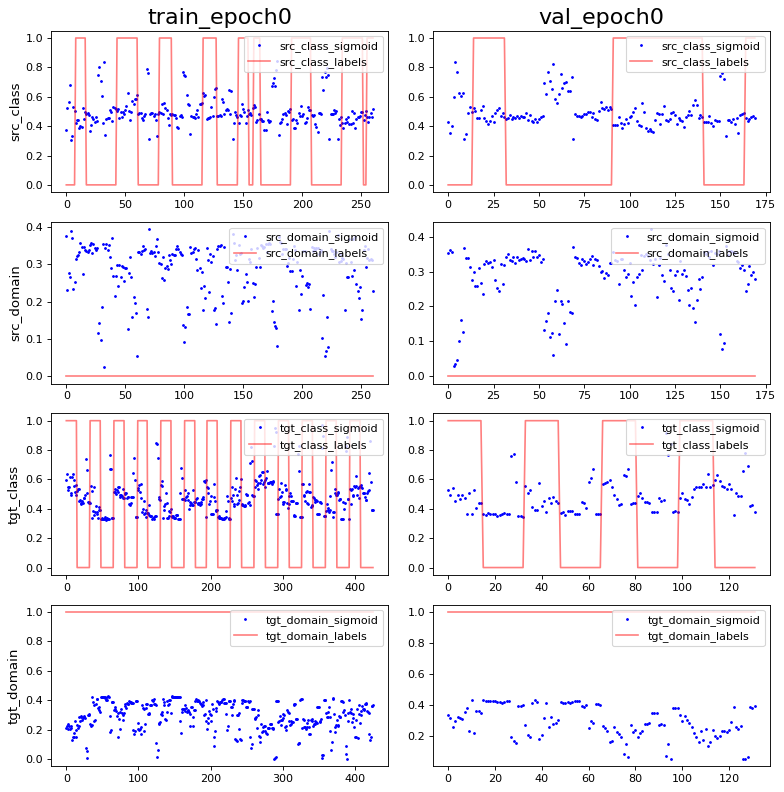

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: -8.4832746e-10 0.99999994
PCA var: [36.1      45.1      50.199997 54.6      58.899998 61.999996 64.6
 66.9      68.8      70.600006]
show standardize mean and std: -1.4034942e-09 0.9965218
PCA var: [35.2      43.6      49.6      54.699997 59.399998 63.699997 67.
 69.6      72.       74.1     ]


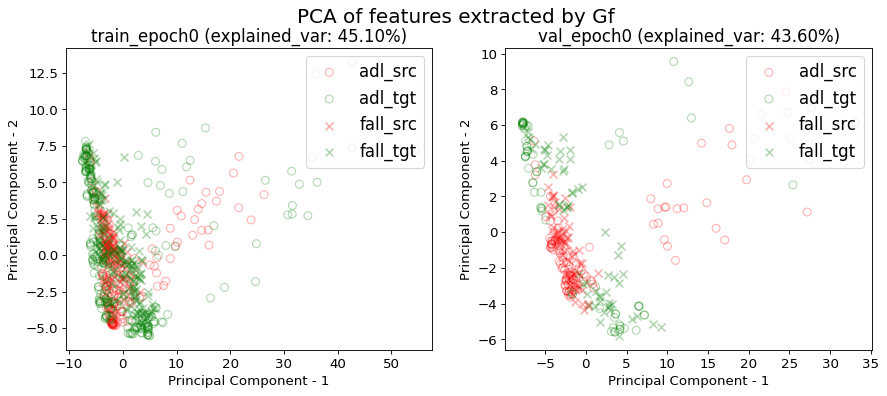

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/


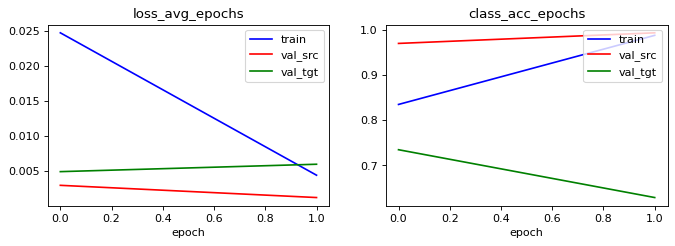

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.9770114942528736 0.0 1.1532567049808429 1.5862068965517242
acc performance: 0.9941176470588236 0.0 0.48823529411764705 0.7764705882352941


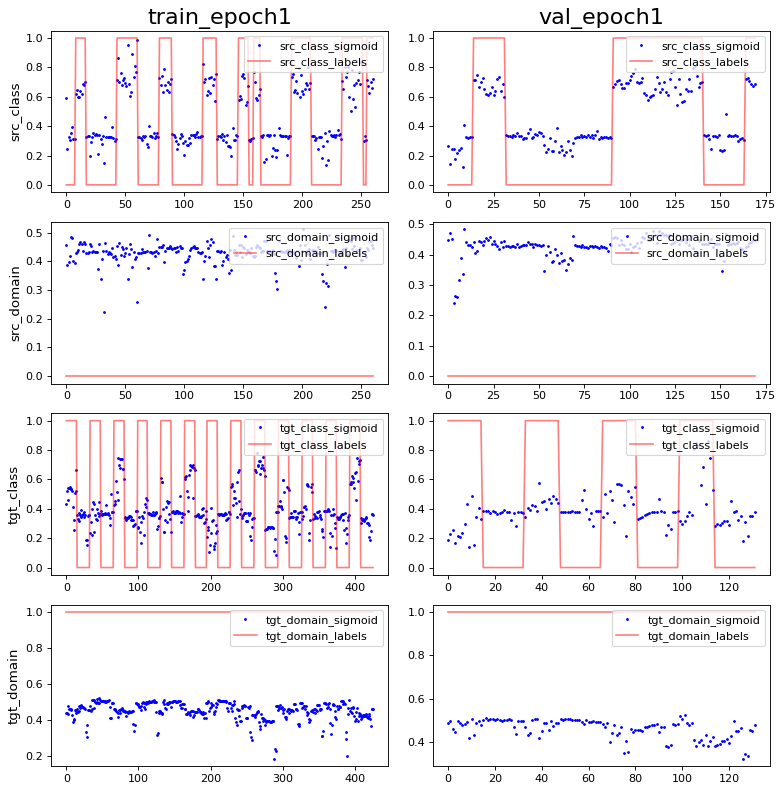

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: -1.6195343e-09 0.9965217
PCA var: [28.2      41.2      49.800003 57.100002 61.4      64.8      68.200005
 70.50001  72.50001  74.200005]
show standardize mean and std: 1.7543678e-09 0.99303126
PCA var: [28.8      39.9      49.4      55.800003 61.300003 65.200005 68.700005
 71.700005 74.50001  76.90001 ]


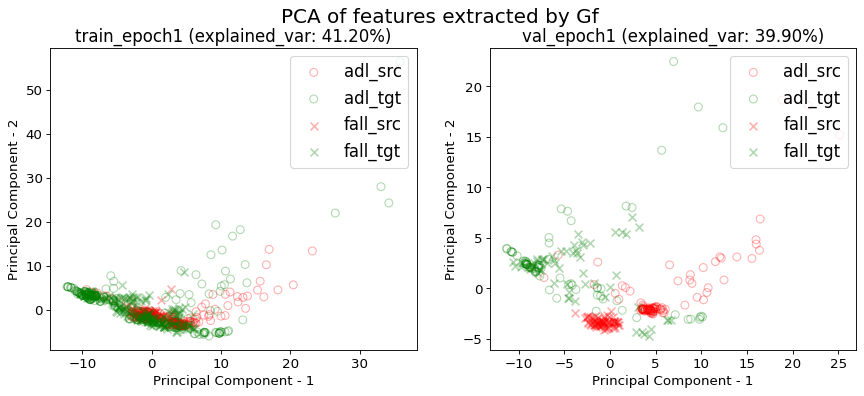

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.3313782991202346 0.31671554252199413 0.49853372434017595 0.7888563049853372
acc performance: 0.37777777777777777 0.18888888888888888 0.6 0.9222222222222223


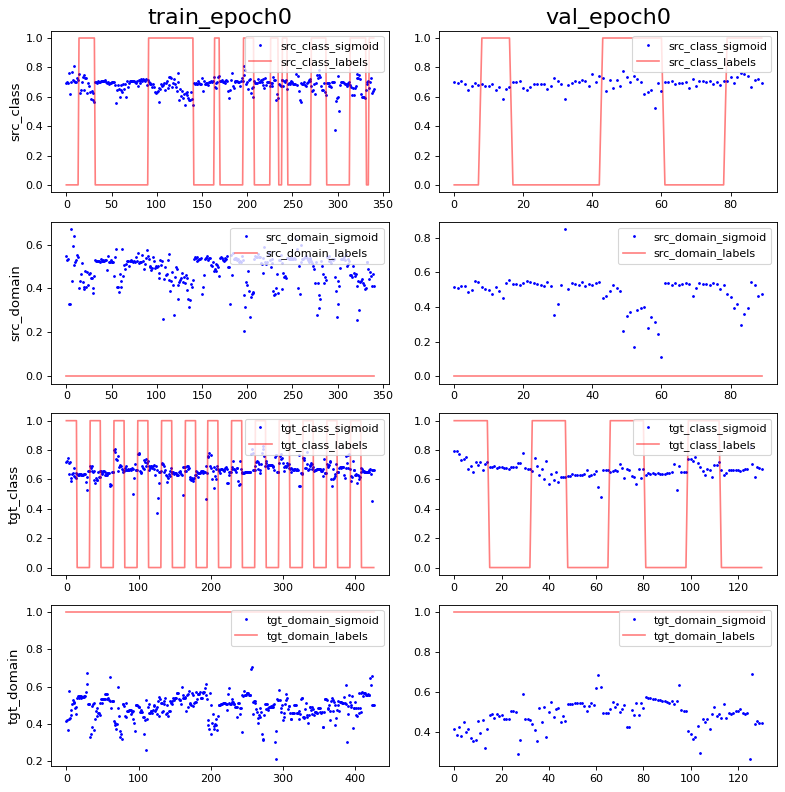

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: -2.0696058e-09 0.99999994
PCA var: [29.499998 40.199997 46.799995 51.499996 55.999996 59.599995 62.699993
 65.399994 67.7      69.7     ]
show standardize mean and std: 2.8768457e-09 0.9965218
PCA var: [28.7      39.4      48.2      54.100002 59.300003 63.4      66.9
 70.       72.8      75.      ]


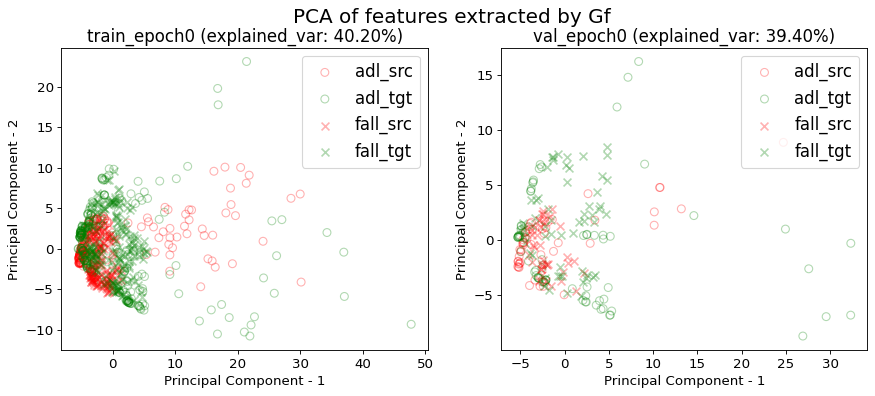

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/


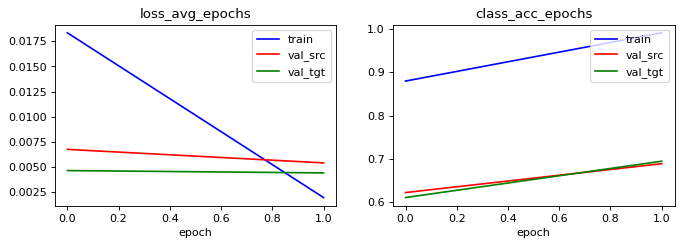

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.6832844574780058 0.9090909090909091 0.7888563049853372 0.11436950146627566
acc performance: 0.6888888888888889 0.8444444444444444 1.011111111111111 0.13333333333333333


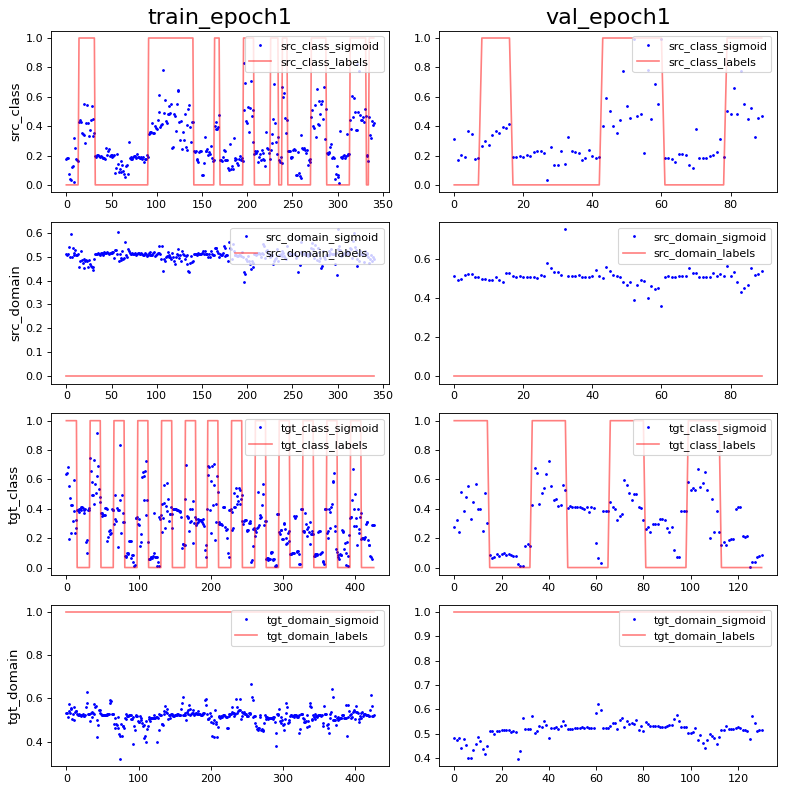

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: 4.0012376e-09 0.9930313
PCA var: [27.599998 42.1      49.199997 55.1      58.899998 62.499996 65.399994
 68.09999  70.69999  72.99999 ]
show standardize mean and std: 0.0 0.98952854
PCA var: [31.3      45.1      52.8      58.1      62.399998 66.5      70.3
 73.8      76.700005 79.3     ]


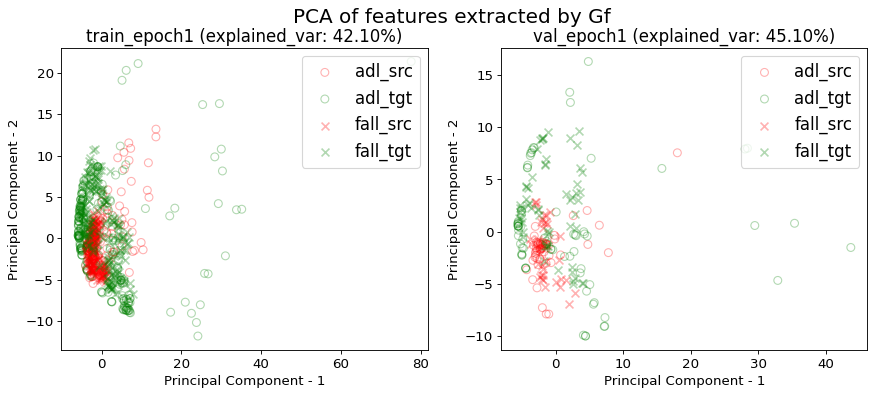

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.004383,0.988506,0.001196,0.994118,0.005947,0.628788
1,1.000000,0.001946,0.991202,0.005397,0.688889,0.004399,0.694656
mean,0.500000,0.003165,0.989854,0.003297,0.841503,0.005173,0.661722
std,0.707107,0.001723,0.001907,0.002971,0.215829,0.001095,0.046576


src val loss: 0.0033±0.0030
src val acc: 0.8415±0.2158
tgt val loss: 0.0052±0.0011
tgt val acc: 0.6617±0.0466
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 431, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UMAFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 16, 'learning_rate': 0.01, 'sensor_loc': 'waist', 'date': '2020/04/09 20:05:27', 'input_dim': (16, 3, 66), 'output_dim': (16,)}

======================  train on target, val on target(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modelo

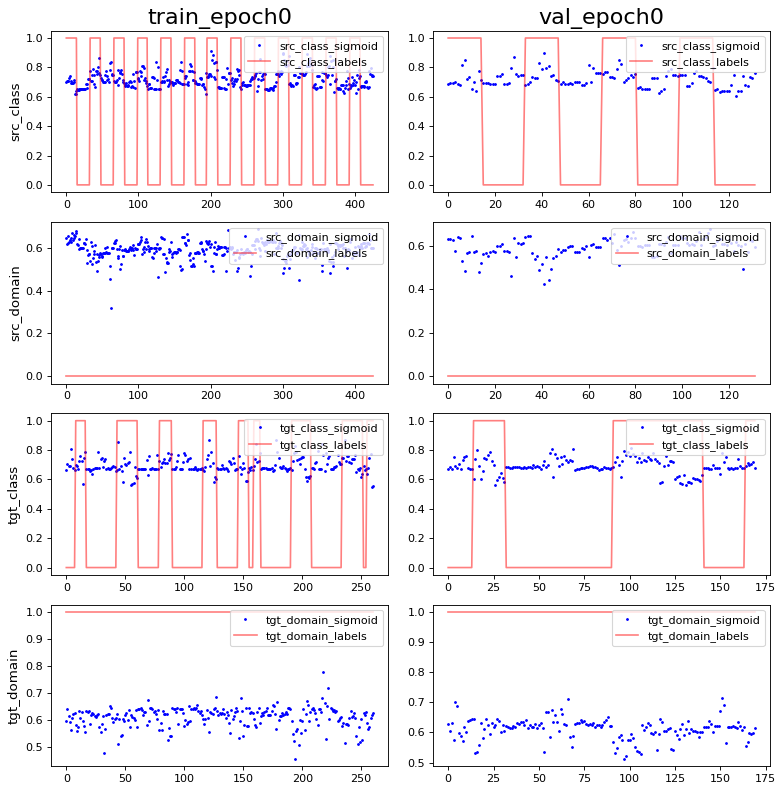

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: 2.5449824e-09 1.0
PCA var: [25.6 38.1 47.5 56.3 60.7 64.5 67.2 69.2 71.  72.7]
show standardize mean and std: 1.4034942e-09 1.0
PCA var: [21.6      35.100002 45.4      54.9      59.800003 63.300003 66.3
 69.100006 71.40001  73.50001 ]


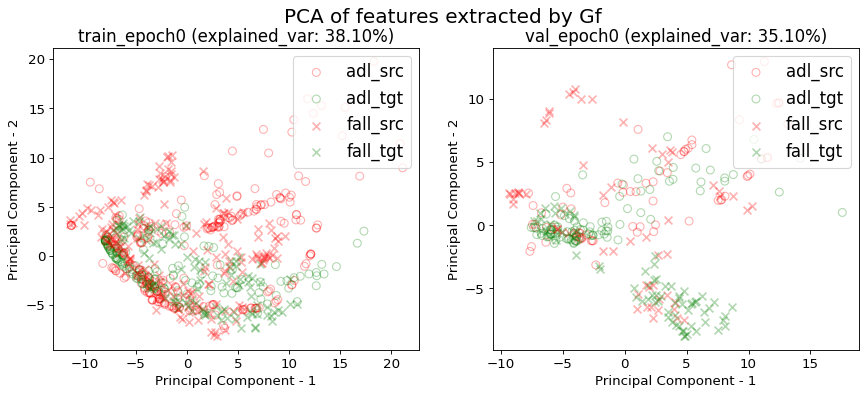

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/


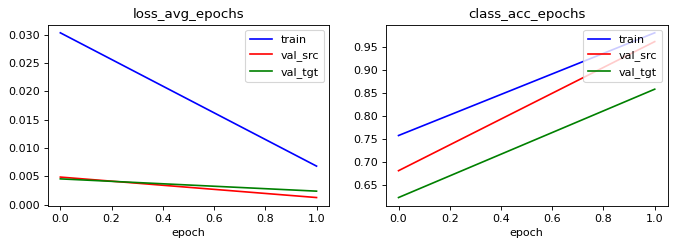

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.9413145539906104 0.9507042253521126 0.57981220657277 0.056338028169014086
acc performance: 0.9621212121212122 0.8939393939393939 1.106060606060606 0.045454545454545456


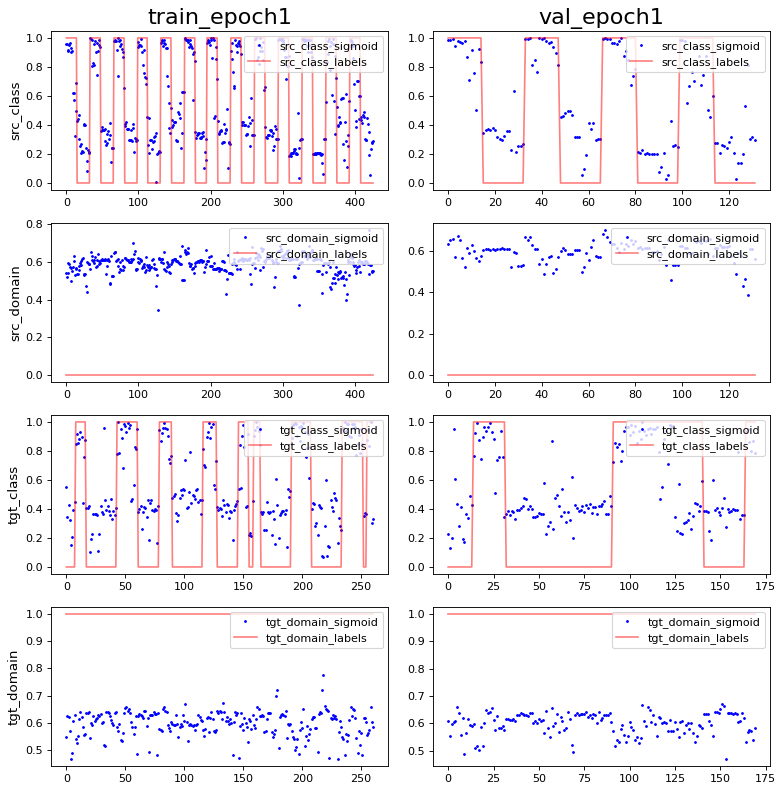

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: -1.3881722e-09 0.9965218
PCA var: [23.5      37.1      45.899998 53.3      58.2      62.5      65.8
 68.3      70.700005 72.700005]
show standardize mean and std: 2.1052413e-09 0.99303126
PCA var: [21.1      34.3      44.1      51.1      57.399998 62.1      66.2
 69.2      71.799995 73.99999 ]


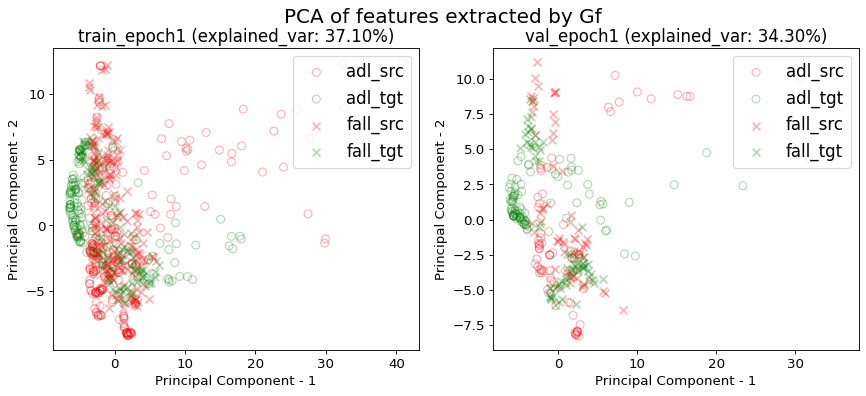

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.45901639344262296 0.4613583138173302 0.2810304449648712 0.639344262295082
acc performance: 0.4122137404580153 0.45038167938931295 0.2366412213740458 0.5725190839694656


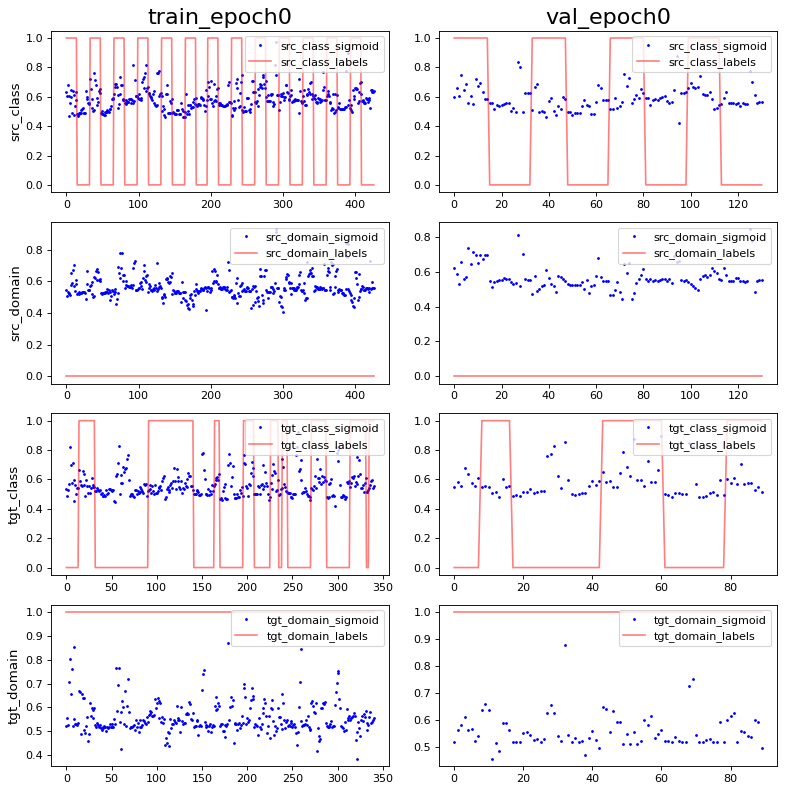

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: 1.1037897e-09 0.9965218
PCA var: [25.2      38.9      46.9      54.100002 58.300003 62.000004 64.9
 67.6      69.6      71.4     ]
show standardize mean and std: -1.9178972e-09 0.98952854
PCA var: [24.3      42.1      51.6      58.3      62.6      66.5      69.4
 72.       74.2      76.399994]


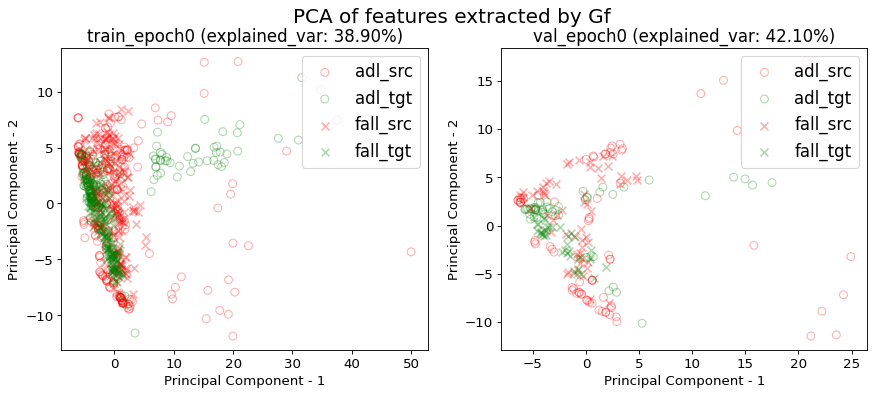

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/


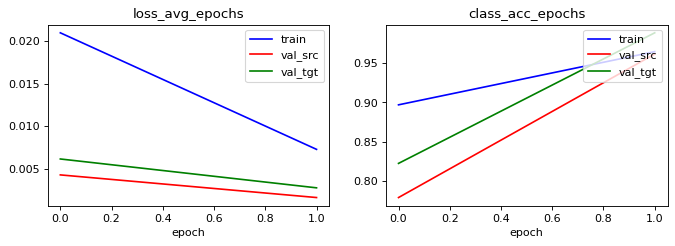

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.892271662763466 0.351288056206089 0.765807962529274 0.5339578454332553
acc performance: 0.9618320610687023 0.45038167938931295 0.6793893129770993 0.48854961832061067


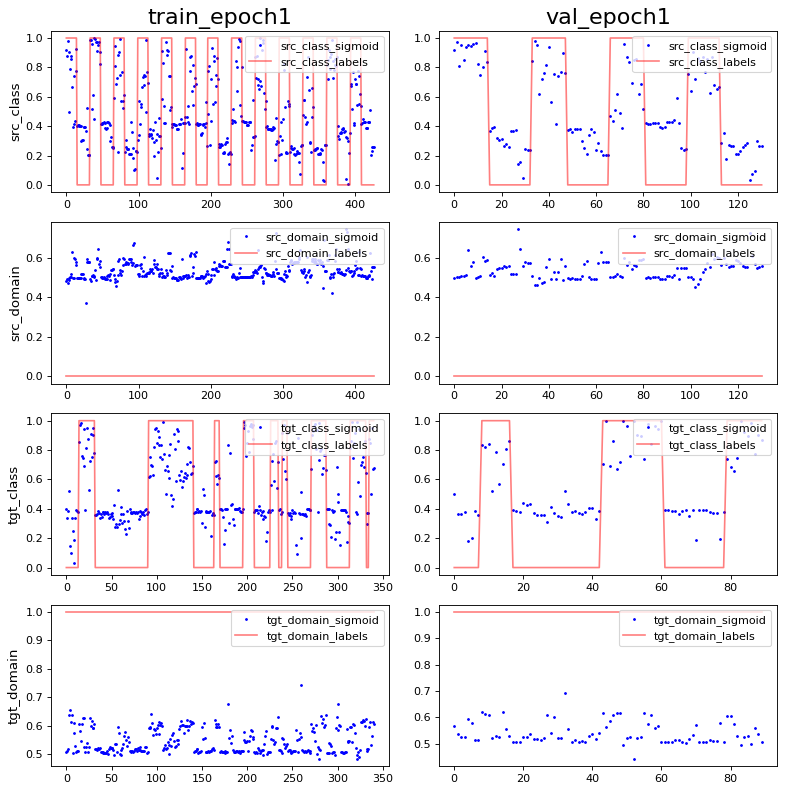

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: -5.5189484e-09 0.99999994
PCA var: [34.6      47.199997 53.799995 58.999996 63.199997 66.899994 69.59999
 71.899994 73.799995 75.399994]
show standardize mean and std: -1.9178972e-09 0.9965218
PCA var: [37.9      50.300003 58.000004 63.700005 68.3      71.8      74.9
 77.9      80.3      82.5     ]


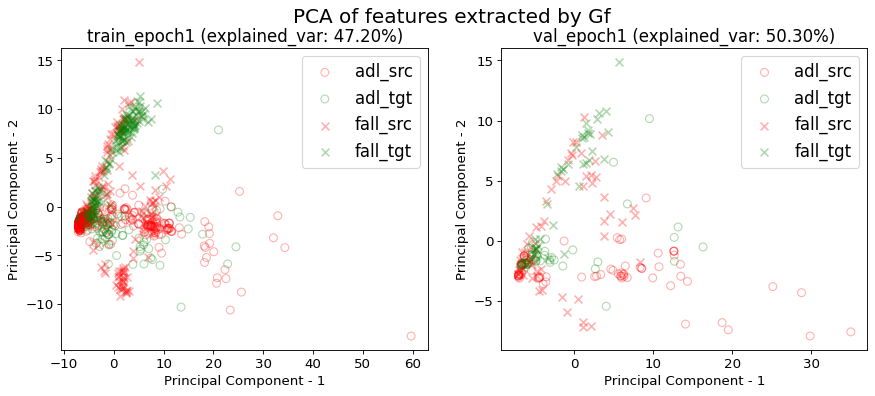

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.006790,0.981221,0.001241,0.962121,0.002371,0.858824
1,1.000000,0.007291,0.964871,0.001626,0.961832,0.002768,0.988889
mean,0.500000,0.007041,0.973046,0.001434,0.961977,0.002570,0.923856
std,0.707107,0.000354,0.011561,0.000272,0.000204,0.000280,0.091970


src val loss: 0.0014±0.0003
src val acc: 0.9620±0.0002
tgt val loss: 0.0026±0.0003
tgt val acc: 0.9239±0.0920
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UPFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 16, 'learning_rate': 0.01, 'sensor_loc': 'belt', 'date': '2020/04/09 20:05:38', 'input_dim': (16, 3, 66), 'output_dim': (16,)}

======================  DANN training transferring knowledge(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_mo

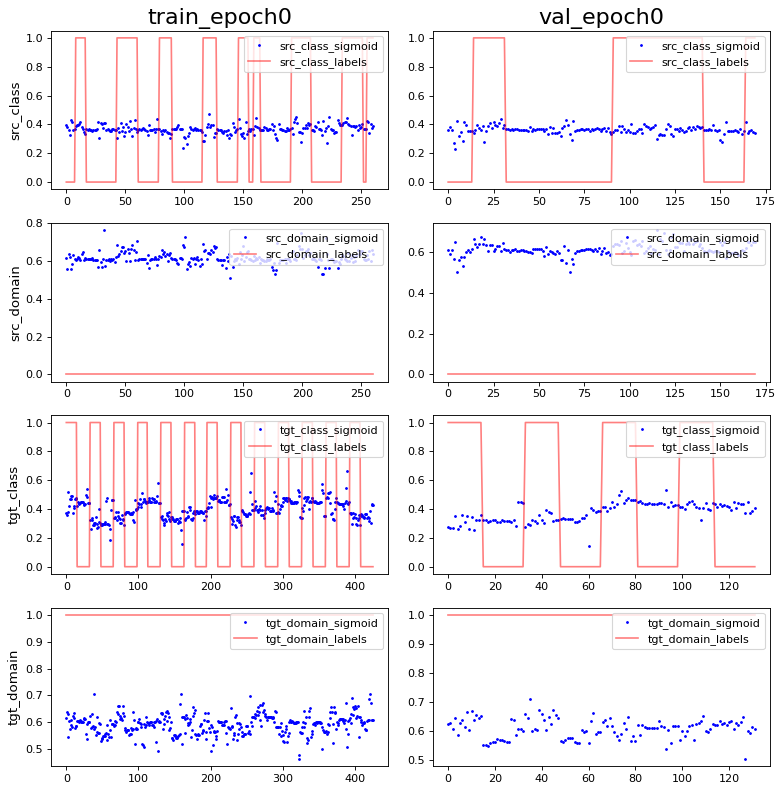

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -7.7120677e-10 0.9965217
PCA var: [23.7      37.300003 44.100002 48.9      53.100002 56.7      59.600002
 62.300003 64.700005 66.8     ]
show standardize mean and std: -2.8069884e-09 0.98952854
PCA var: [24.3 38.3 45.6 51.6 55.8 59.2 62.4 65.4 67.9 70.3]


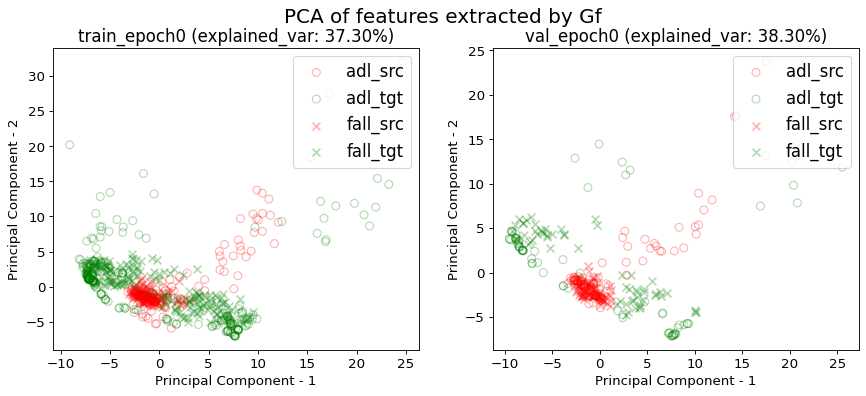

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/


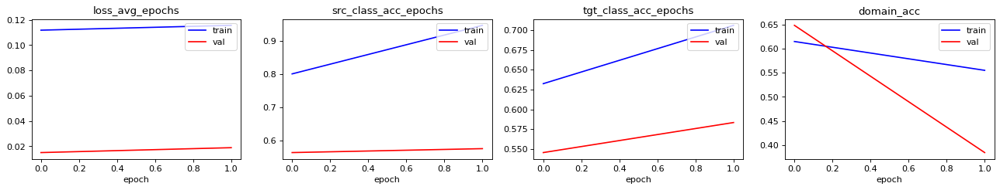

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.632183908045977 0.06513409961685823 0.9578544061302682 1.5134099616858236
acc performance: 0.5764705882352941 0.023529411764705882 0.45294117647058824 0.6588235294117647


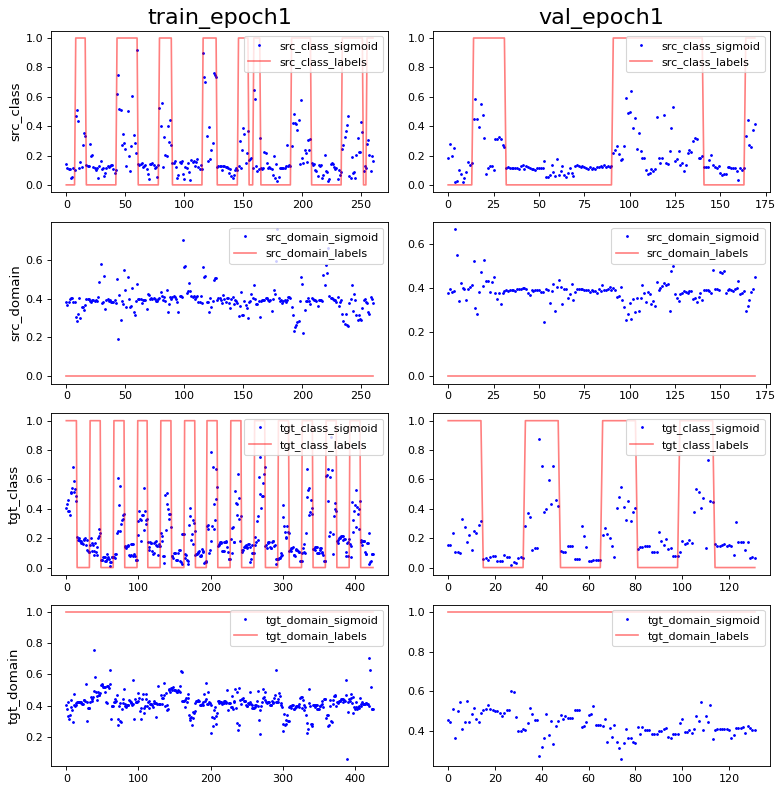

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -2.0051376e-09 0.8660254
PCA var: [21.9      35.4      43.4      50.800003 55.700005 60.200005 64.200005
 67.4      69.9      72.      ]
show standardize mean and std: 1.4034942e-09 0.7772816
PCA var: [24.5      35.6      44.899998 52.8      59.2      63.9      67.200005
 70.00001  72.30001  74.40001 ]


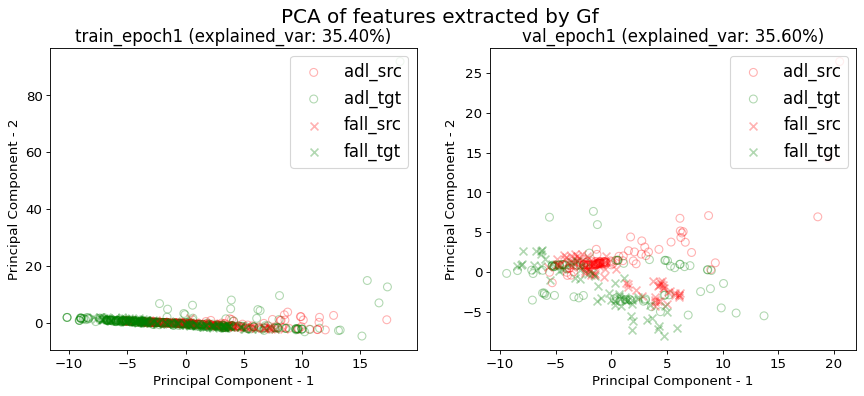

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.41642228739002934 0.002932551319648094 0.5747800586510264 1.1202346041055717
acc performance: 0.4222222222222222 0.011111111111111112 0.6666666666666666 1.2555555555555555


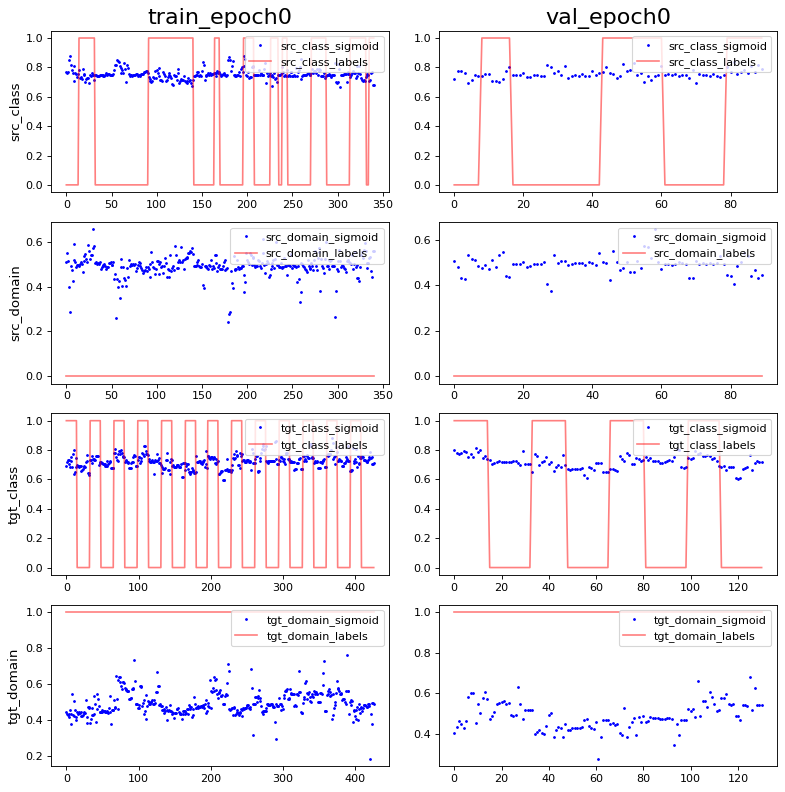

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -1.1037897e-09 0.9965217
PCA var: [25.9      38.3      46.2      53.       56.9      60.100002 63.000004
 65.8      68.       70.1     ]
show standardize mean and std: -1.9178972e-09 0.9965218
PCA var: [26.4      40.9      50.300003 57.300003 61.9      65.1      68.1
 70.9      73.6      75.799995]


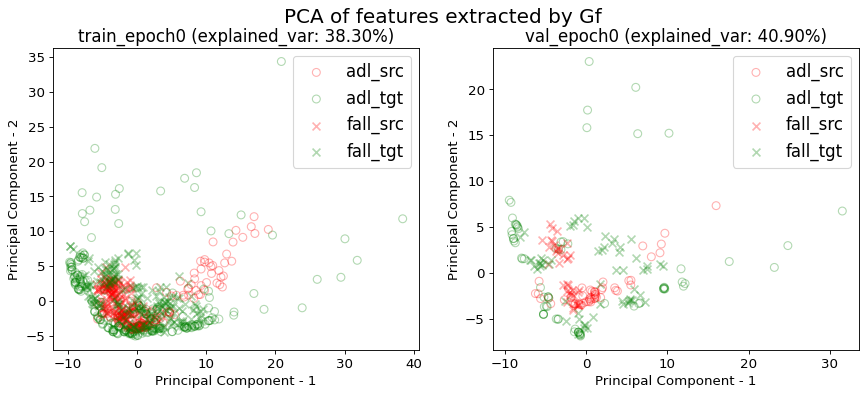

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/


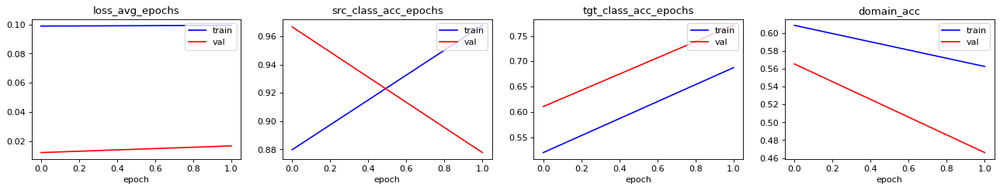

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.906158357771261 0.34310850439882695 0.8914956011730205 0.8533724340175953
acc performance: 0.8777777777777778 0.3 1.1222222222222222 0.8444444444444444


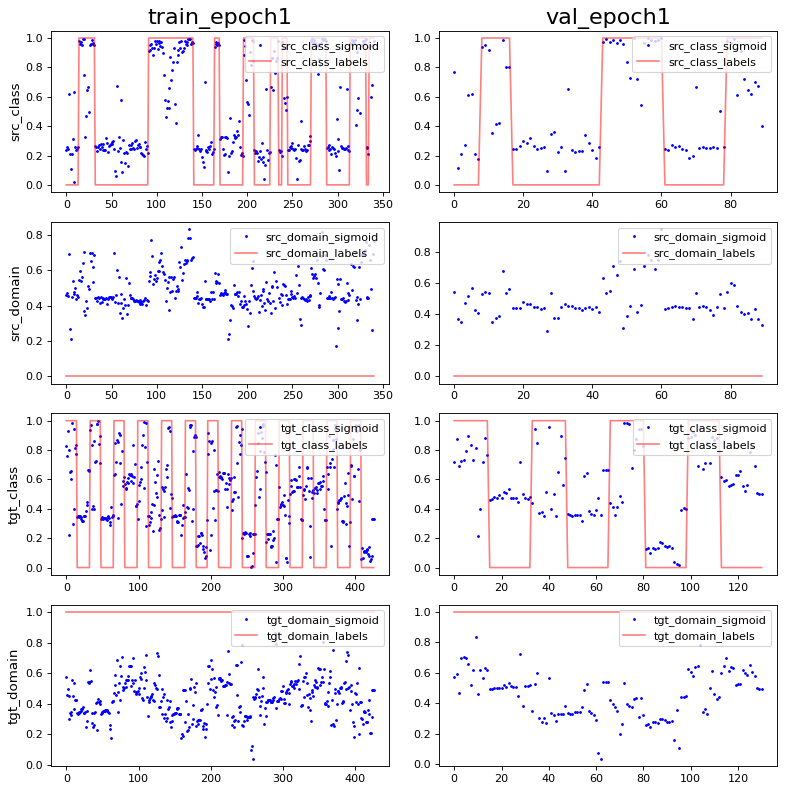

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -3.3113692e-09 1.0
PCA var: [20.7      39.9      48.9      55.800003 60.000004 63.300003 66.100006
 68.600006 70.8      72.9     ]
show standardize mean and std: 1.9178972e-09 0.9965218
PCA var: [23.5      43.7      53.5      59.9      64.200005 67.50001  70.40001
 72.90001  75.30001  77.50001 ]


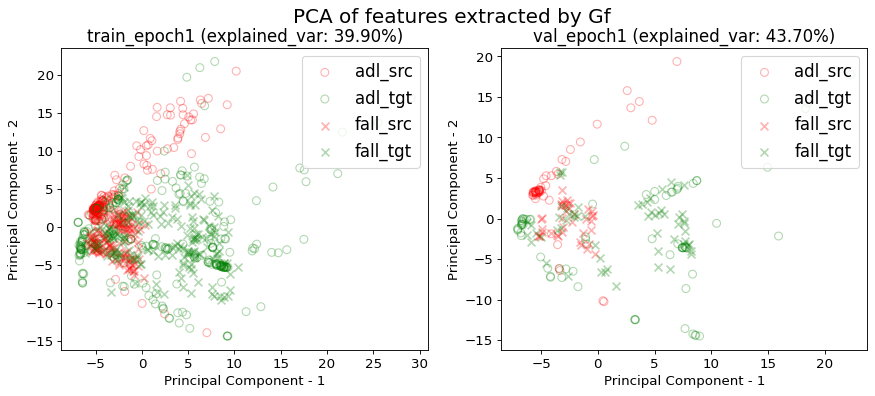

---------------Exporting model performance---------------
show df_performance


,i_CV,train_src_class_loss,train_tgt_class_loss,train_src_domain_loss,train_tgt_domain_loss,train_src_class_acc,train_tgt_class_acc,train_domain_acc,val_src_class_loss,val_tgt_class_loss,val_src_domain_loss,val_tgt_domain_loss,val_src_class_acc,val_tgt_class_acc,val_domain_acc
0,0.000000,0.014214,0.041519,0.051499,0.049924,0.946360,0.705882,0.555347,0.007740,0.008927,0.007805,0.003398,0.576471,0.583333,0.384106
1,1.000000,0.007610,0.051321,0.044908,0.046851,0.967742,0.687500,0.562771,0.002861,0.003876,0.009262,0.004747,0.877778,0.770992,0.466063
mean,0.500000,0.010912,0.046420,0.048204,0.048387,0.957051,0.696691,0.559059,0.005301,0.006401,0.008533,0.004073,0.727124,0.677163,0.425085
std,0.707107,0.004670,0.006931,0.004661,0.002173,0.015119,0.012998,0.005249,0.003450,0.003572,0.001030,0.000954,0.213056,0.132695,0.057953


val_src_class_acc: 0.7271±0.2131
val_tgt_class_acc: 0.6772±0.1327
val_domain_acc: 0.4251±0.0580
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 431, 'classes_n': 2, 'model_name': 'DannModel', 'src_dataset_name': 'UMAFall', 'tgt_dataset_name': 'UPFall', 'src_sensor_loc': 'waist', 'tgt_sensor_loc': 'belt', 'date': '2020/04/09 20:05:51', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 16, 'learning_rate': 0.01, 'input_dim': (16, 3, 66), 'output_dim': 2, 'label_dim': (16,)}
val_tgt_class_acc: 0.6772±0.1327
val_domain_acc: 0.4251±0.0580
time elapsed: 00:00:38

======================  train on source, val on target(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_

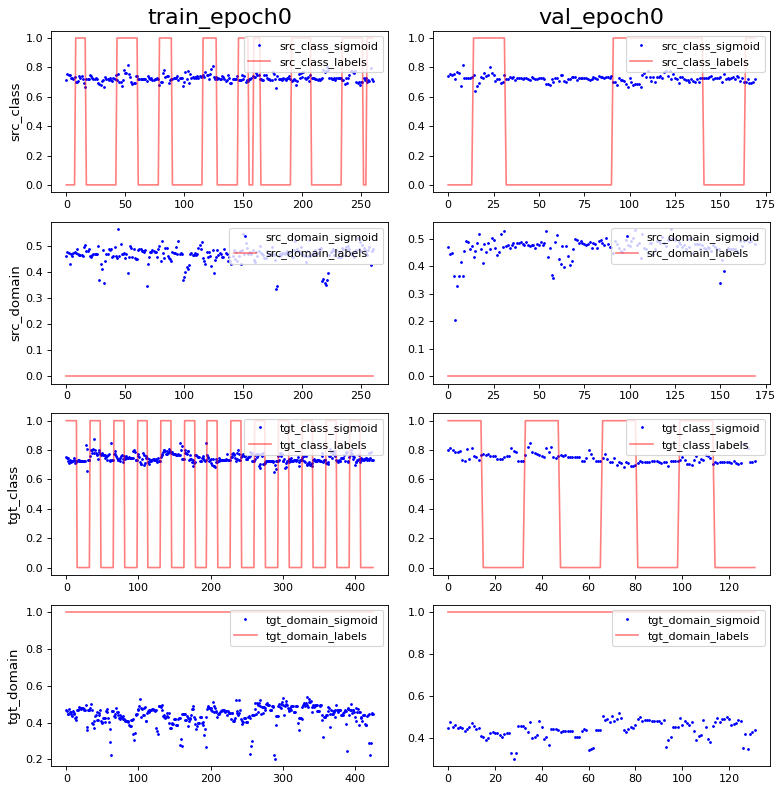

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: 1.5424136e-10 0.9965218
PCA var: [22.  36.5 48.7 55.2 59.5 63.  65.7 68.2 70.5 72.5]
show standardize mean and std: -2.4561149e-09 0.9965218
PCA var: [17.9      32.6      44.6      51.899998 57.399998 61.8      64.9
 67.700005 70.100006 72.200005]


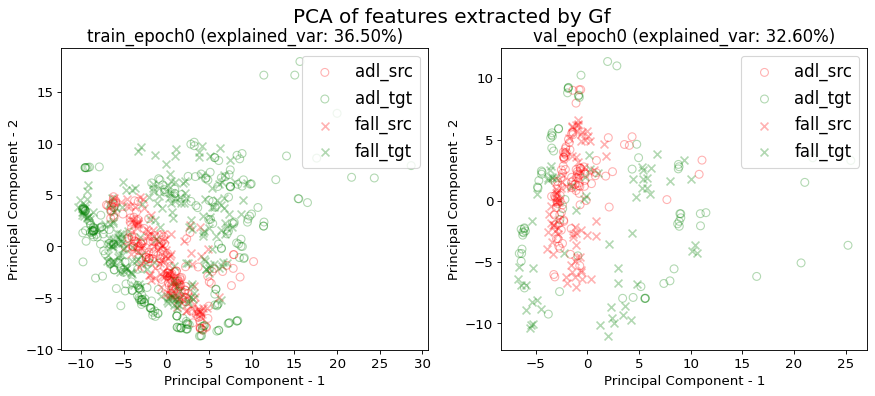

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/


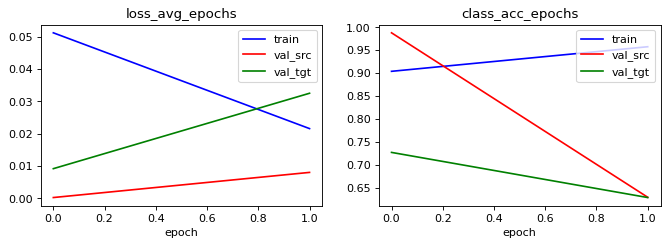

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.6743295019157088 0.0038314176245210726 1.0613026819923372 1.628352490421456
acc performance: 0.6294117647058823 0.0 0.48823529411764705 0.7705882352941177


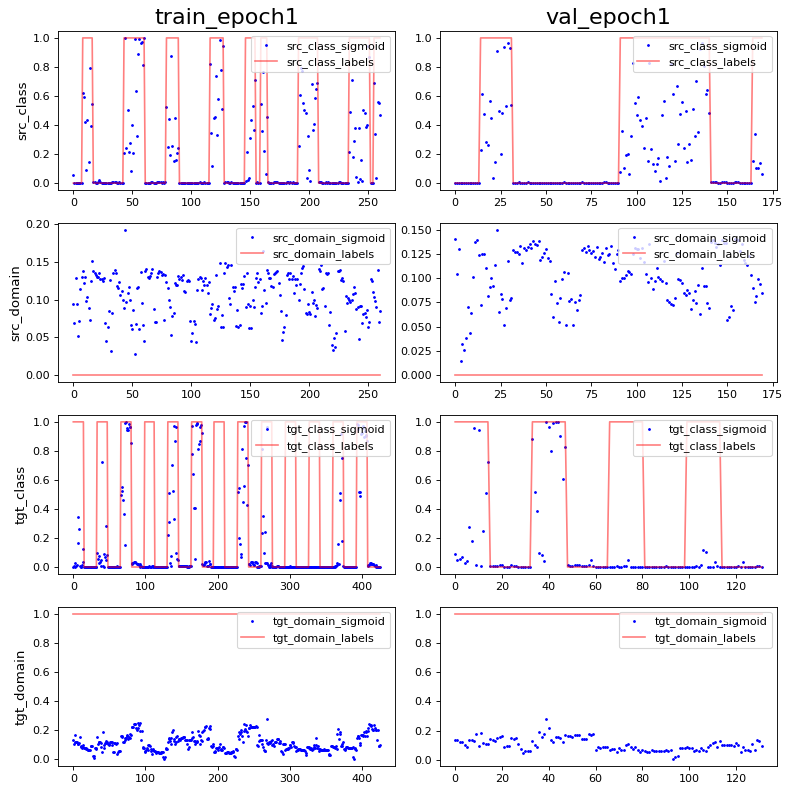

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: 3.1233875e-09 0.9537936
PCA var: [37.5 49.5 58.1 61.8 65.  67.7 70.2 72.2 74.1 75.9]
show standardize mean and std: -5.613977e-09 0.931695
PCA var: [32.600002 48.800003 56.300003 61.100002 65.700005 69.8      73.200005
 75.4      77.4      79.1     ]


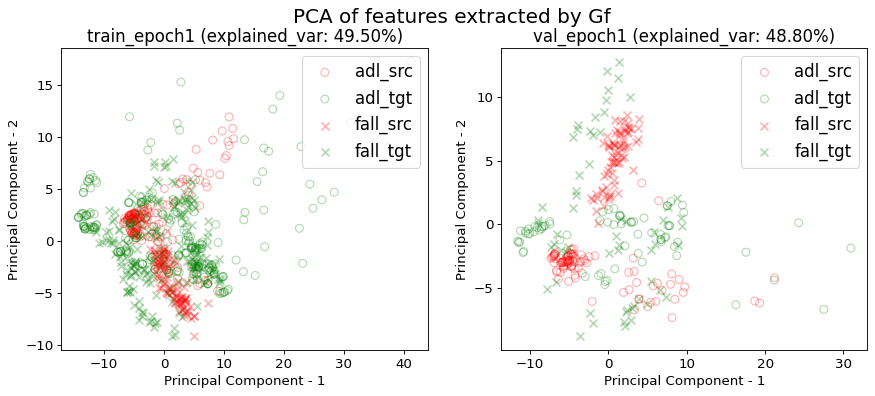

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.6920821114369502 0.7478005865102639 0.7624633431085044 0.44281524926686217
acc performance: 0.7555555555555555 0.6222222222222222 0.8222222222222222 0.5444444444444444


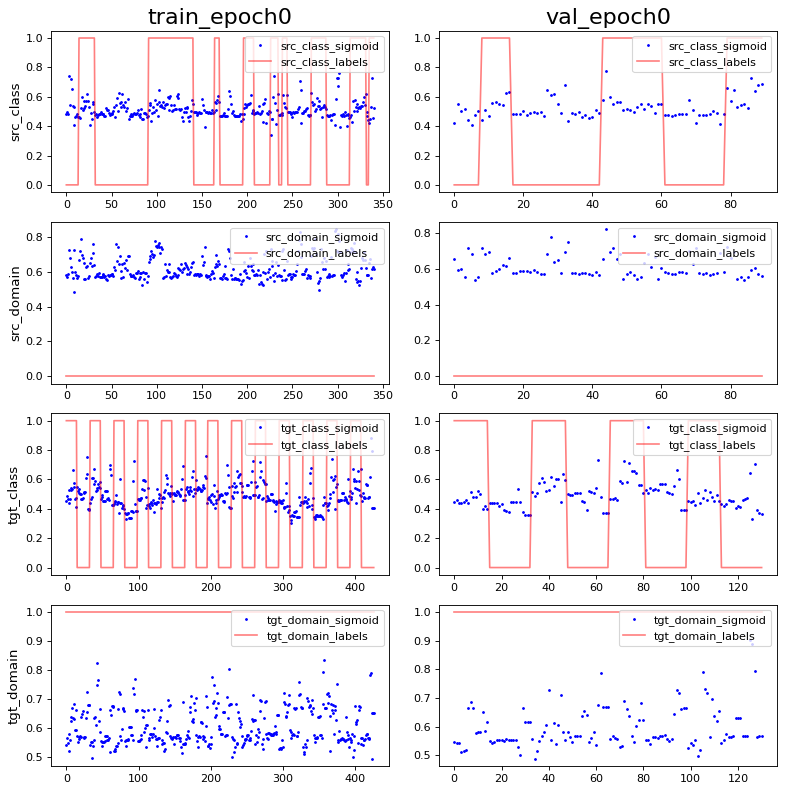

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: -1.931632e-09 0.9965218
PCA var: [19.6      33.4      42.600002 48.600002 52.300003 55.000004 57.400005
 59.700005 61.900005 64.00001 ]
show standardize mean and std: 1.9178972e-09 0.9965218
PCA var: [21.1      36.100002 45.5      52.3      57.2      60.9      64.
 66.8      69.600006 72.100006]


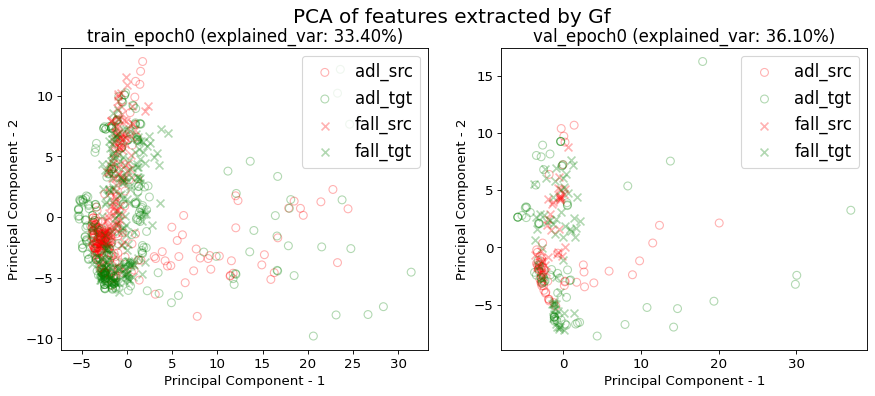

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/


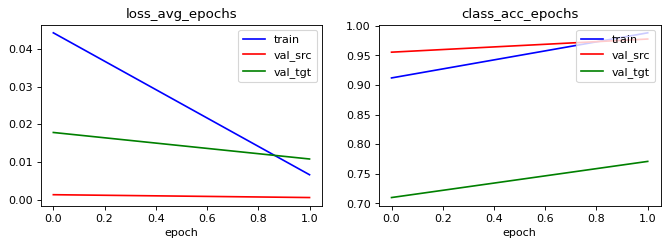

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.9970674486803519 0.6275659824046921 0.9120234604105572 0.25219941348973607
acc performance: 0.9777777777777777 0.6555555555555556 1.1222222222222222 0.3


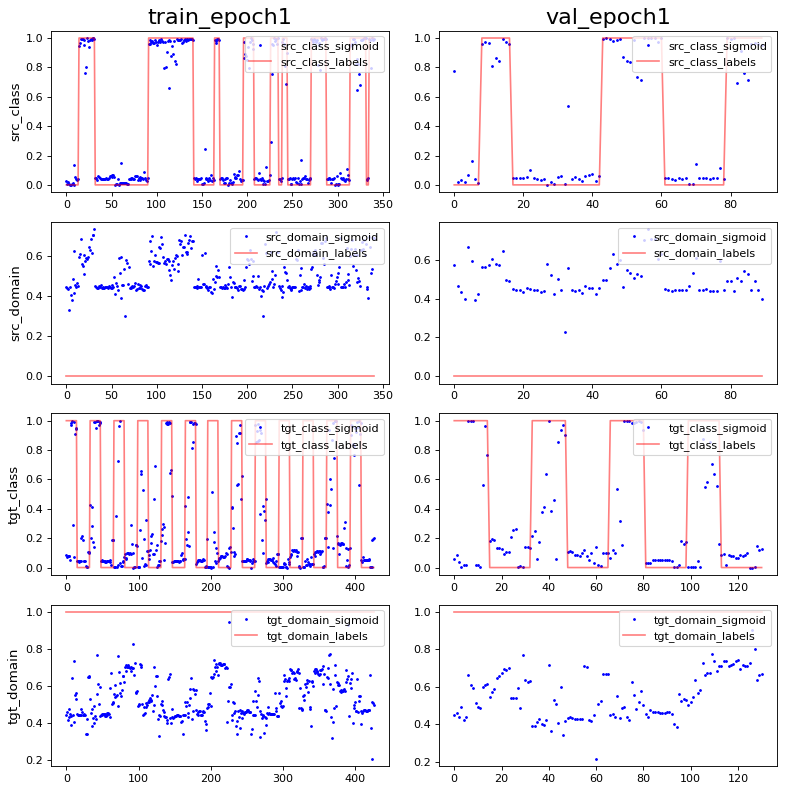

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: -1.1037897e-09 1.0
PCA var: [31.900002 51.9      64.200005 67.50001  70.100006 72.40001  74.600006
 76.600006 78.3      79.9     ]
show standardize mean and std: 0.0 0.99999994
PCA var: [36.  57.  67.7 71.5 74.8 77.5 79.8 81.9 83.6 85.2]


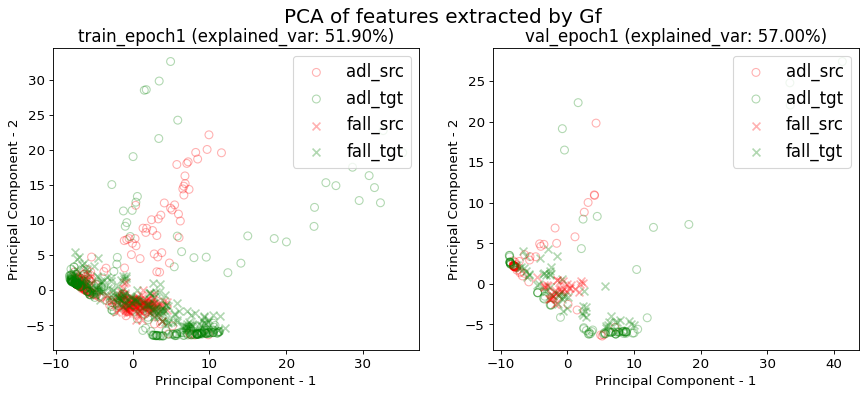

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.021599,0.957854,0.008056,0.629412,0.032527,0.628788
1,1.000000,0.006630,0.988270,0.000583,0.977778,0.010811,0.770992
mean,0.500000,0.014115,0.973062,0.004319,0.803595,0.021669,0.699890
std,0.707107,0.010585,0.021507,0.005284,0.246332,0.015356,0.100554


src val loss: 0.0043±0.0053
src val acc: 0.8036±0.2463
tgt val loss: 0.0217±0.0154
tgt val acc: 0.6999±0.1006
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 431, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UMAFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.01, 'sensor_loc': 'waist', 'date': '2020/04/09 20:06:03', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  train on target, val on target(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutp

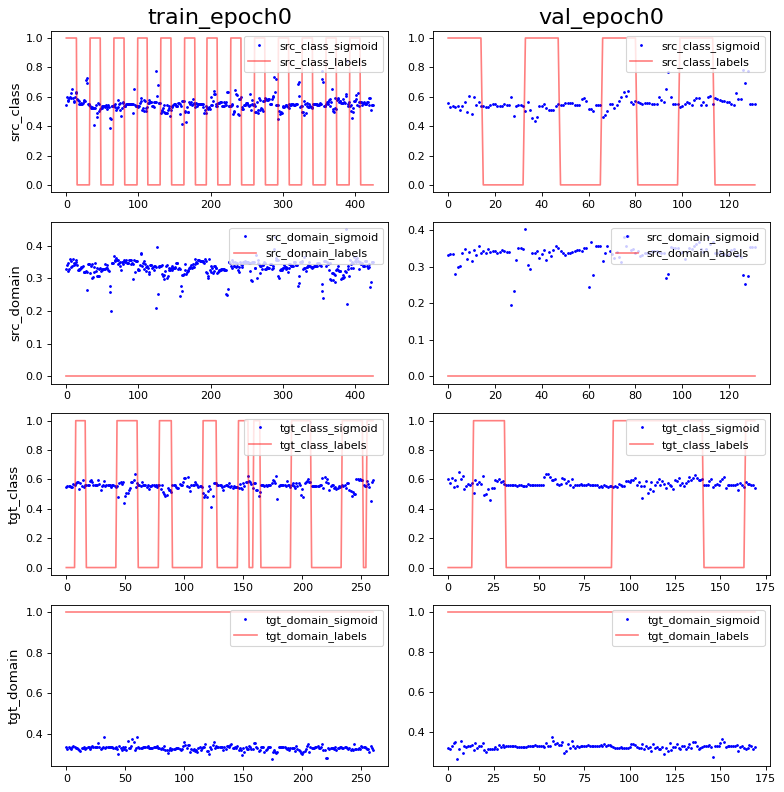

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: 5.398448e-10 1.0
PCA var: [26.499998 38.6      45.6      51.399998 55.699997 58.999996 62.099995
 64.59999  66.79999  68.89999 ]
show standardize mean and std: -2.8069884e-09 0.99999994
PCA var: [28.2      40.100002 46.600002 52.000004 56.800003 61.200005 64.50001
 67.100006 69.600006 71.8     ]


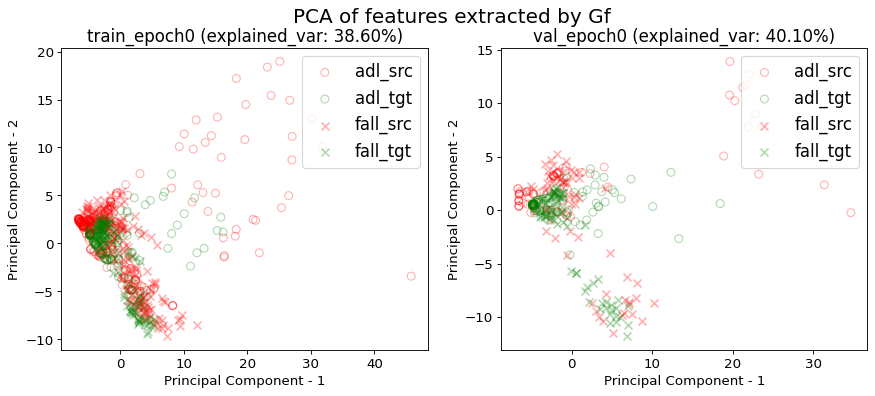

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/


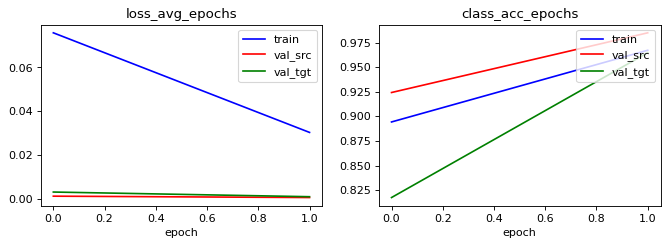

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.9788732394366197 0.004694835680751174 0.5845070422535211 0.6126760563380281
acc performance: 0.9848484848484849 0.015151515151515152 1.2424242424242424 1.2878787878787878


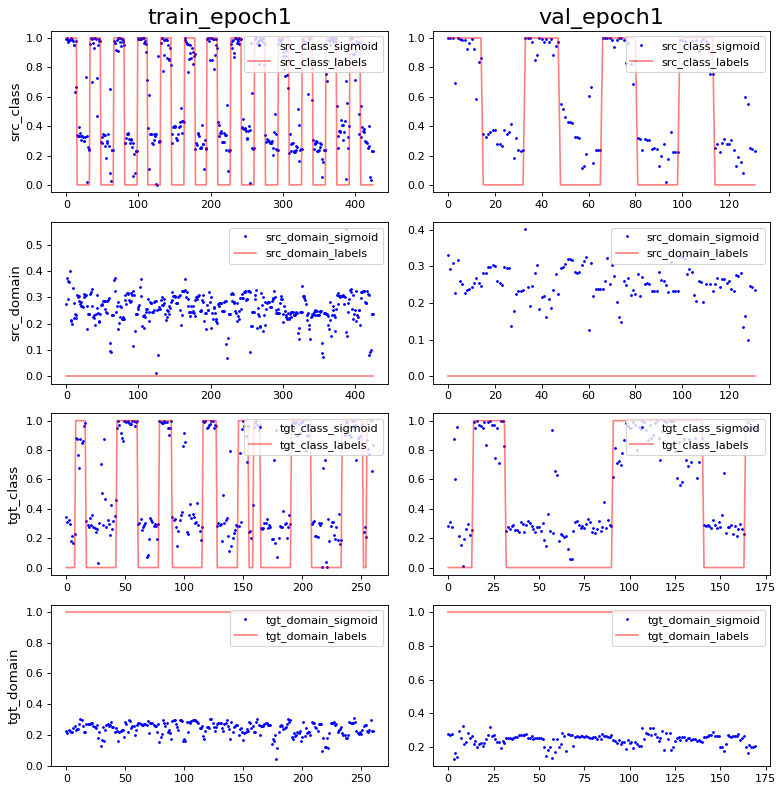

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: 6.940861e-10 0.9391189
PCA var: [31.7      45.6      51.399998 56.1      59.899998 63.1      66.1
 68.6      70.799995 72.799995]
show standardize mean and std: 3.5087355e-10 0.93541425
PCA var: [28.8      43.199997 50.1      55.6      59.399998 62.399998 65.399994
 68.09999  70.59999  72.79999 ]


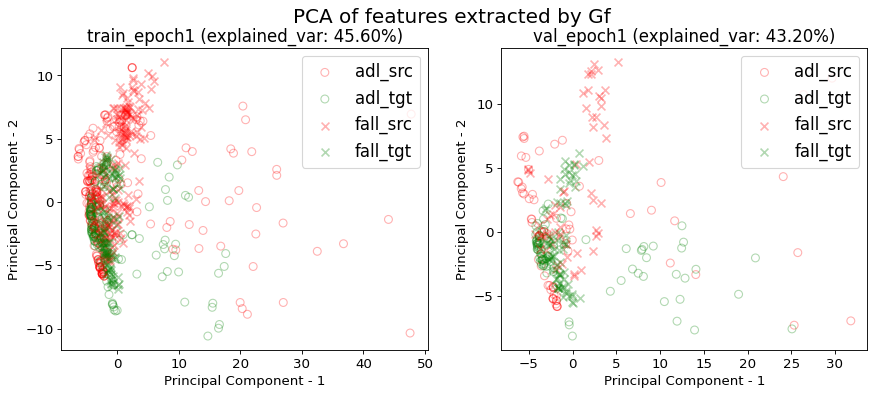

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.5433255269320844 0.0 0.46604215456674475 0.7985948477751756
acc performance: 0.549618320610687 0.0 0.3969465648854962 0.6870229007633588


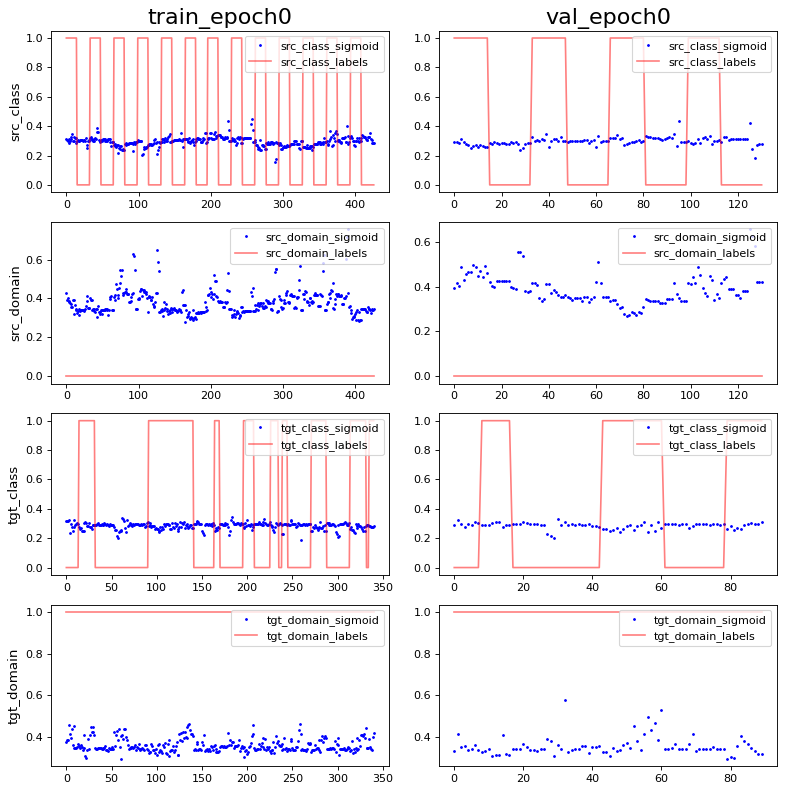

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: -5.5189486e-10 0.9965217
PCA var: [25.2      39.       47.       52.1      56.399998 60.1      63.399998
 66.399994 69.2      71.2     ]
show standardize mean and std: -1.9178972e-09 0.9965217
PCA var: [27.2      43.2      51.6      56.1      60.199997 64.2      67.7
 70.899994 73.59999  75.99999 ]


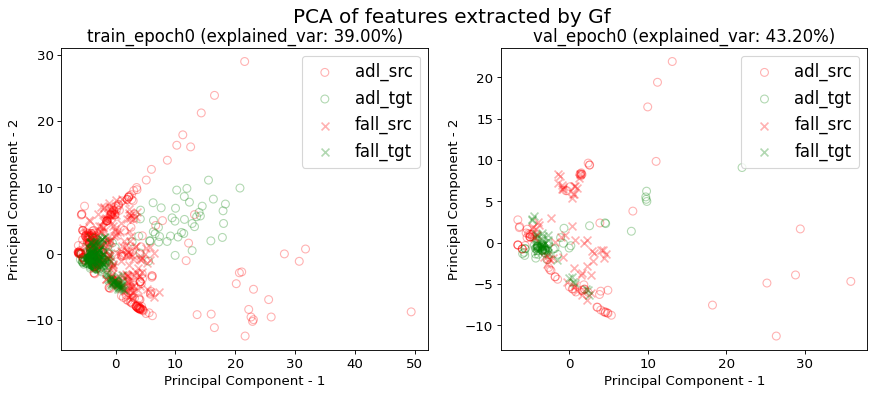

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/


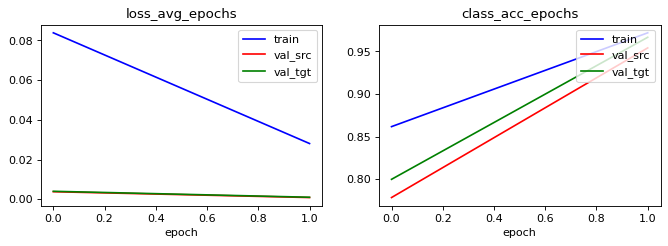

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.9695550351288056 0.0468384074941452 0.7822014051522248 0.7798594847775175
acc performance: 0.9541984732824428 0.04580152671755725 0.6641221374045801 0.6793893129770993


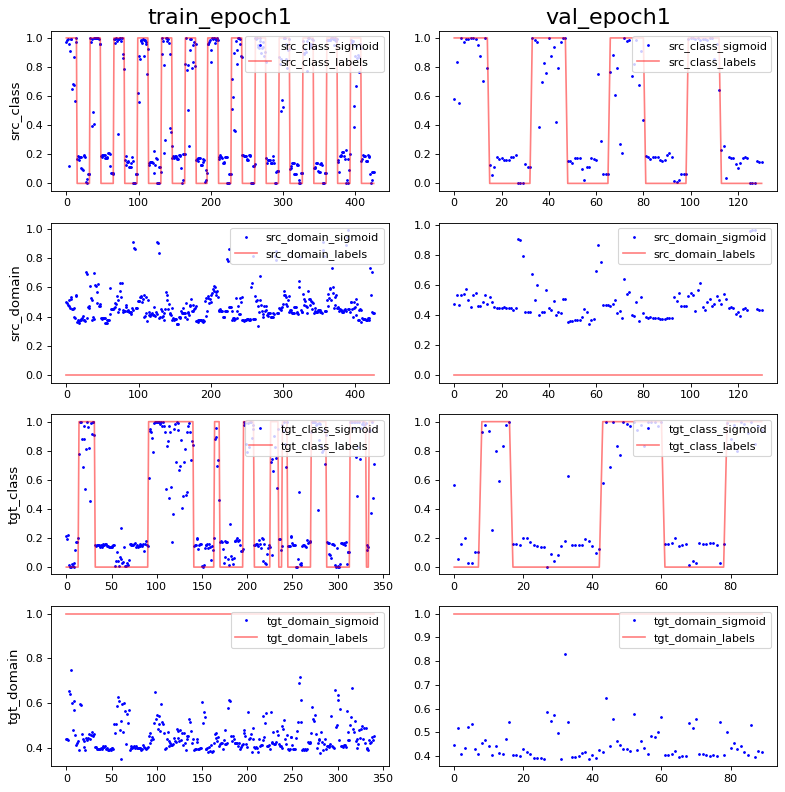

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: -5.5189486e-10 1.0
PCA var: [30.599998 46.1      54.8      60.8      65.3      68.4      71.
 73.       75.       76.8     ]
show standardize mean and std: 0.0 1.0
PCA var: [36.6      51.699997 59.899998 66.1      70.       73.4      76.3
 78.5      80.4      82.200005]


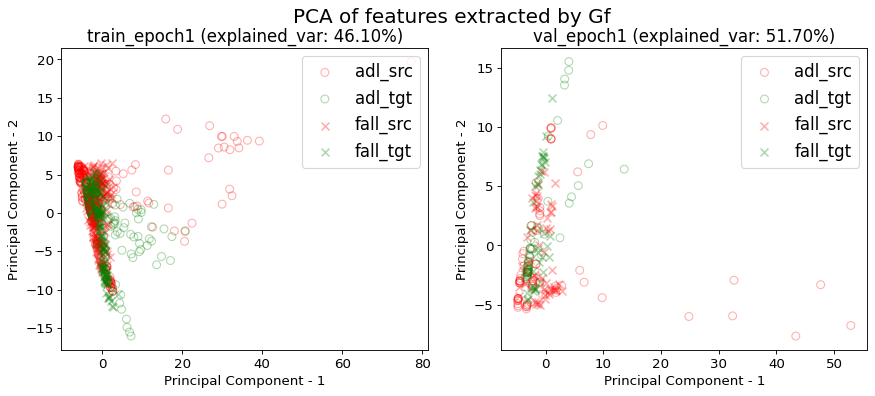

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.030398,0.967136,0.000723,0.984848,0.001102,0.964706
1,1.000000,0.028051,0.971897,0.000829,0.954198,0.000979,0.966667
mean,0.500000,0.029224,0.969517,0.000776,0.969523,0.001041,0.965686
std,0.707107,0.001659,0.003366,0.000075,0.021673,0.000087,0.001386


src val loss: 0.0008±0.0001
src val acc: 0.9695±0.0217
tgt val loss: 0.0010±0.0001
tgt val acc: 0.9657±0.0014
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UPFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.01, 'sensor_loc': 'belt', 'date': '2020/04/09 20:06:16', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  DANN training transferring knowledge(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_model

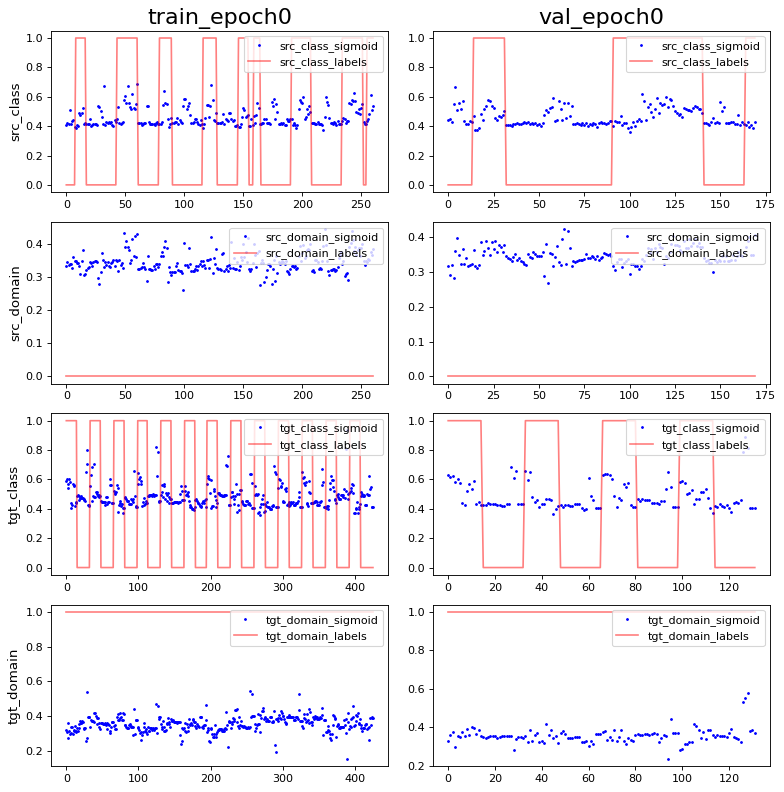

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: 0.0 0.9930313
PCA var: [27.5      38.1      47.6      54.199997 59.1      63.399998 66.2
 68.6      70.5      72.4     ]
show standardize mean and std: -7.017471e-10 0.9930313
PCA var: [25.2      35.       43.5      50.8      56.2      60.100002 63.500004
 66.700005 69.100006 71.3     ]


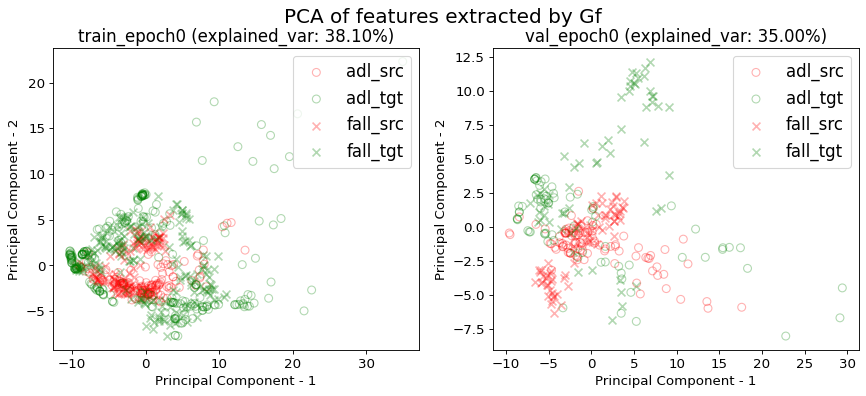

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/


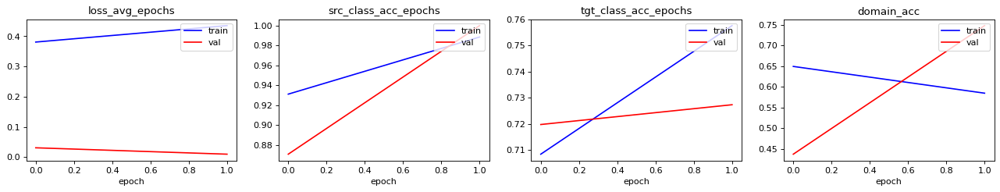

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.9885057471264368 0.9540229885057471 1.2413793103448276 0.6513409961685823
acc performance: 1.0 0.9705882352941176 0.5647058823529412 0.3588235294117647


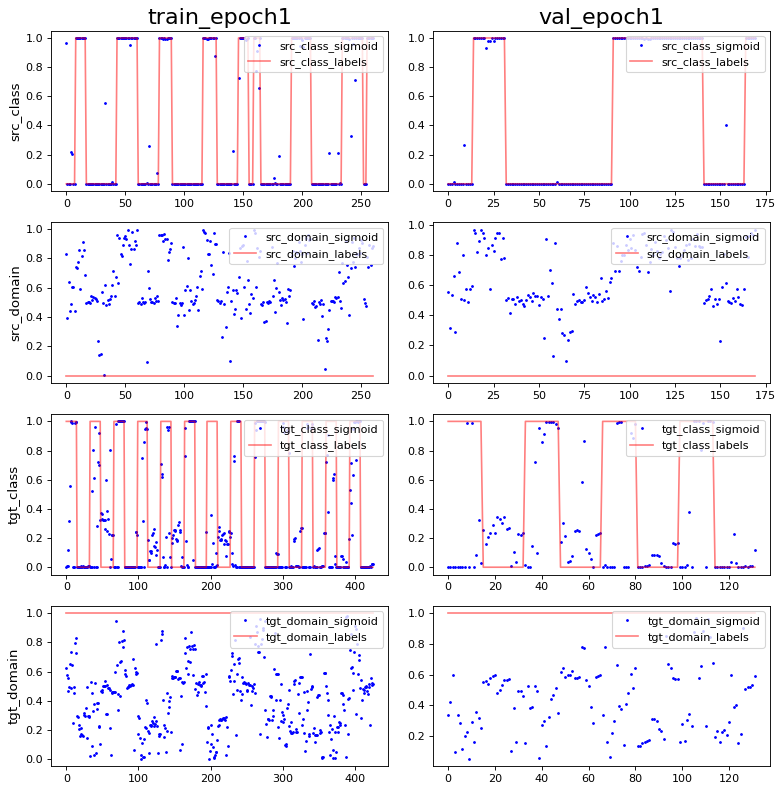

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -4.9357234e-09 1.0
PCA var: [36.199997 49.299995 58.899994 66.799995 69.99999  72.799995 75.49999
 77.399994 79.299995 80.899994]
show standardize mean and std: -1.4034942e-09 0.9965218
PCA var: [36.8      50.8      60.6      67.1      70.799995 74.399994 77.7
 80.       81.7      83.399994]


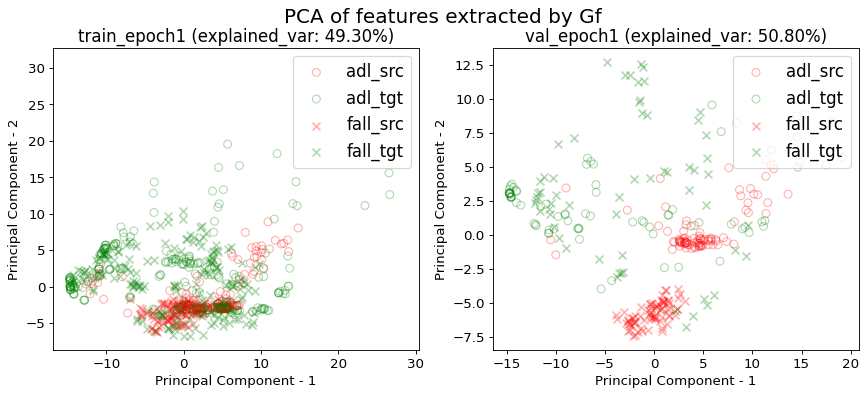

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.4574780058651026 0.9736070381231672 0.5102639296187683 0.05278592375366569
acc performance: 0.5444444444444444 0.9444444444444444 0.6777777777777778 0.1


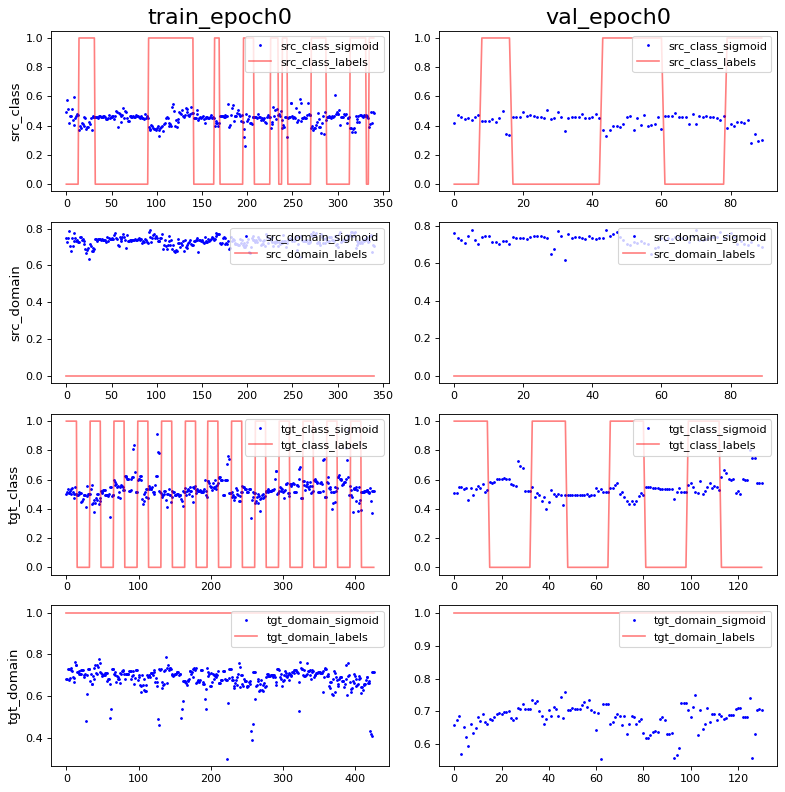

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -2.483527e-09 0.9965218
PCA var: [29.1      48.4      59.300003 64.600006 69.100006 72.100006 74.200005
 76.100006 77.8      79.4     ]
show standardize mean and std: 0.0 0.9965218
PCA var: [31.5 51.3 61.5 68.8 73.5 76.7 79.5 81.7 83.6 85.2]


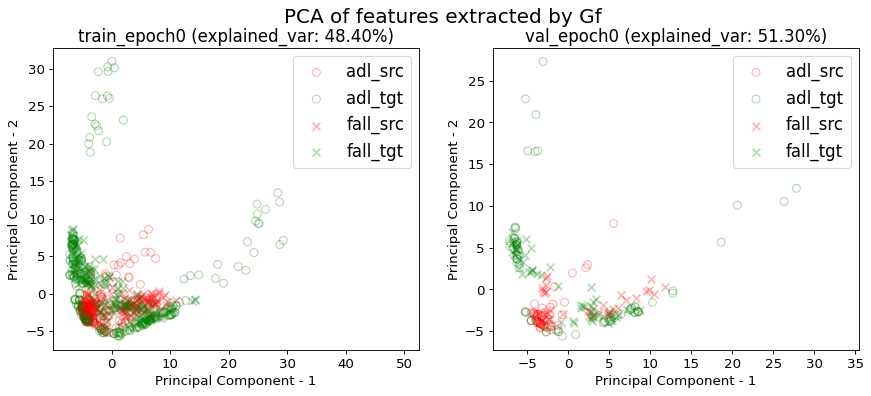

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/


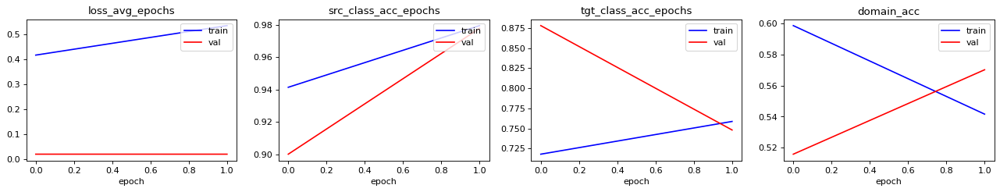

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.9970674486803519 0.31085043988269795 0.9618768328445748 1.0586510263929618
acc performance: 0.9777777777777777 0.28888888888888886 1.0888888888888888 1.1111111111111112


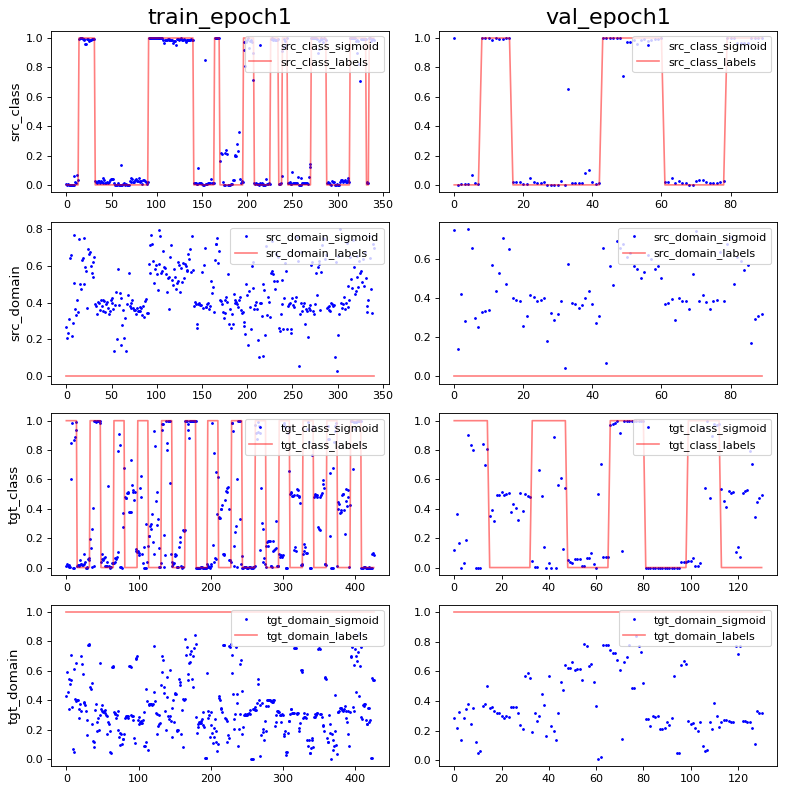

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -2.2075795e-09 1.0
PCA var: [31.8      53.8      64.8      70.600006 75.40001  77.70001  79.90001
 81.90001  83.70001  85.20001 ]
show standardize mean and std: 1.9178972e-09 1.0
PCA var: [35.8      59.9      71.9      77.       81.2      83.7      85.299995
 86.899994 88.399994 89.59999 ]


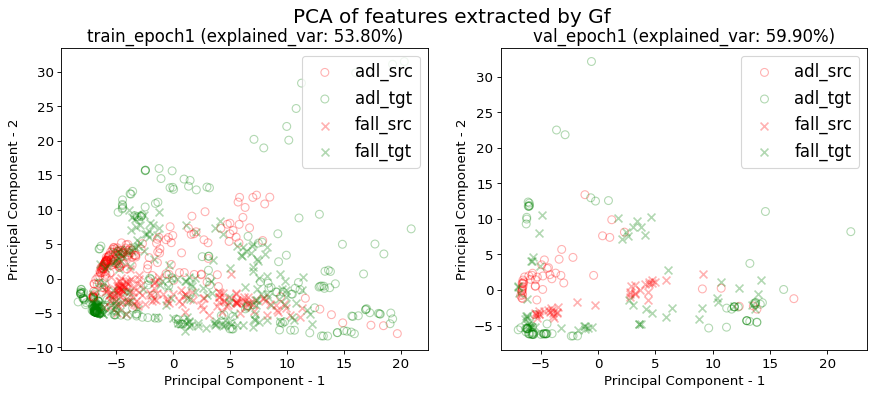

---------------Exporting model performance---------------
show df_performance


,i_CV,train_src_class_loss,train_tgt_class_loss,train_src_domain_loss,train_tgt_domain_loss,train_src_class_acc,train_tgt_class_acc,train_domain_acc,val_src_class_loss,val_tgt_class_loss,val_src_domain_loss,val_tgt_domain_loss,val_src_class_acc,val_tgt_class_acc,val_domain_acc
0,0.000000,0.012066,0.445461,0.206283,0.216834,0.988506,0.757576,0.584762,0.000018,0.036435,0.000638,0.008918,1.000000,0.727273,0.748344
1,1.000000,0.018633,0.374288,0.234807,0.280151,0.979472,0.758721,0.541606,0.001599,0.019009,0.013587,0.003536,0.977778,0.748092,0.570136
mean,0.500000,0.015350,0.409875,0.220545,0.248492,0.983989,0.758148,0.563184,0.000809,0.027722,0.007113,0.006227,0.988889,0.737682,0.659240
std,0.707107,0.004644,0.050327,0.020169,0.044772,0.006388,0.000810,0.030516,0.001118,0.012322,0.009156,0.003805,0.015713,0.014721,0.126013


val_src_class_acc: 0.9889±0.0157
val_tgt_class_acc: 0.7377±0.0147
val_domain_acc: 0.6592±0.1260
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 431, 'classes_n': 2, 'model_name': 'DannModel', 'src_dataset_name': 'UMAFall', 'tgt_dataset_name': 'UPFall', 'src_sensor_loc': 'waist', 'tgt_sensor_loc': 'belt', 'date': '2020/04/09 20:06:31', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.01, 'input_dim': (4, 3, 66), 'output_dim': 2, 'label_dim': (4,)}
val_tgt_class_acc: 0.7377±0.0147
val_domain_acc: 0.6592±0.1260
time elapsed: 00:00:40

======================  train on source, val on target(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_tot

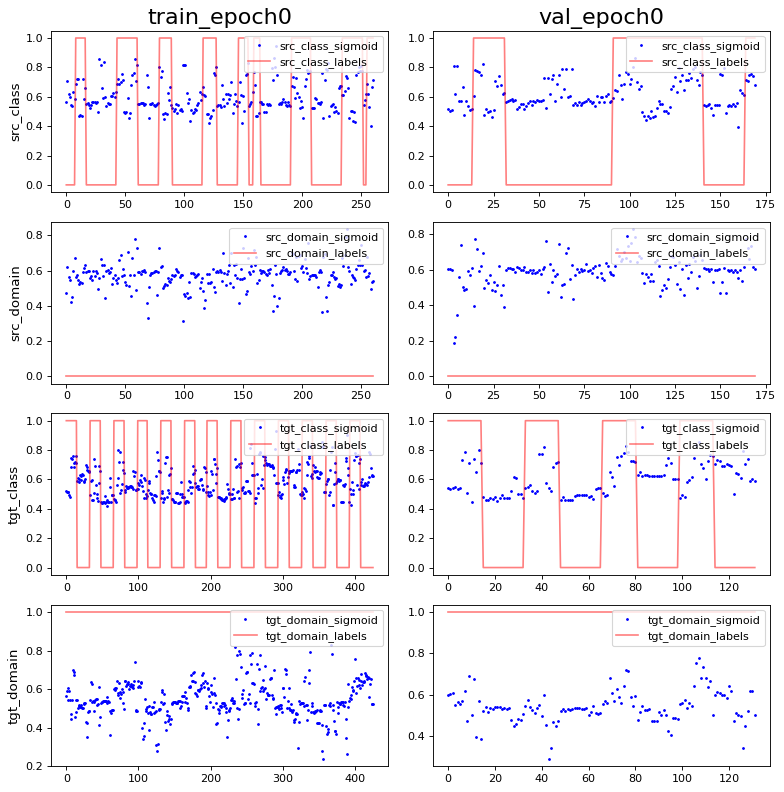

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: -6.169654e-10 0.99303126
PCA var: [29.199999 42.7      50.4      56.4      61.4      65.3      68.600006
 70.90001  72.90001  74.70001 ]
show standardize mean and std: -2.8069884e-09 0.98952854
PCA var: [30.5      42.3      50.9      56.600002 61.500004 65.5      68.6
 71.4      73.6      75.5     ]


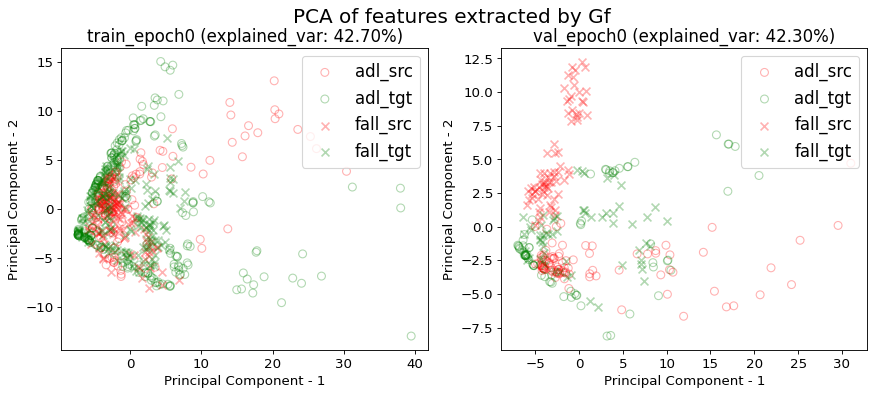

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/


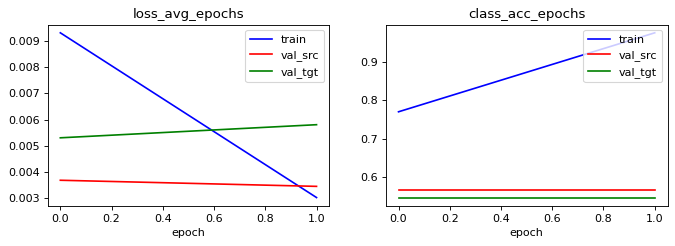

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.5938697318007663 1.0 0.8888888888888888 0.0
acc performance: 0.5647058823529412 1.0 0.4235294117647059 0.0


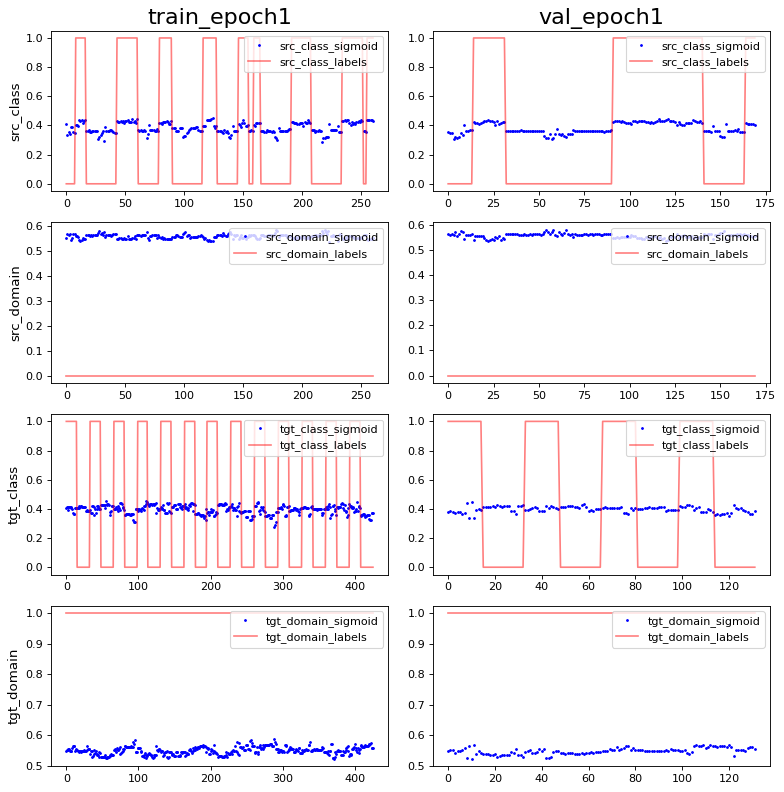

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: -1.0989697e-09 0.97182536
PCA var: [28.400002 40.9      48.7      54.300003 58.100002 61.600002 64.100006
 66.50001  68.700005 70.4     ]
show standardize mean and std: -7.017471e-10 0.939119
PCA var: [25.9      34.6      42.1      48.399998 53.6      58.1      62.
 65.3      68.4      71.200005]


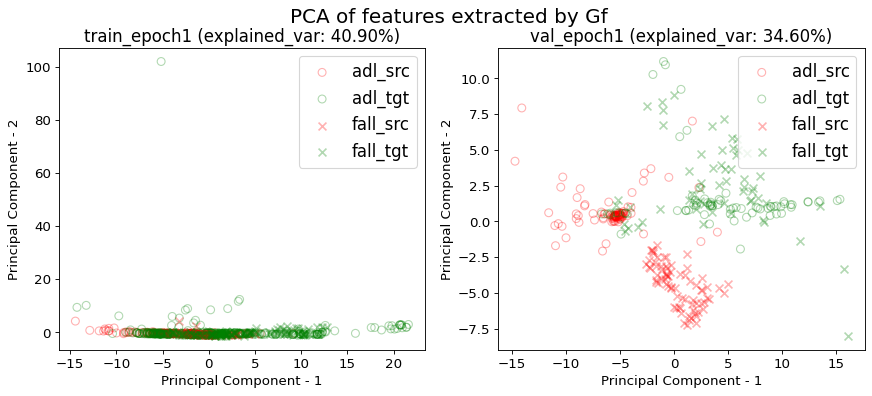

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.3255131964809384 1.0 0.44281524926686217 0.0
acc performance: 0.28888888888888886 1.0 0.5777777777777777 0.0


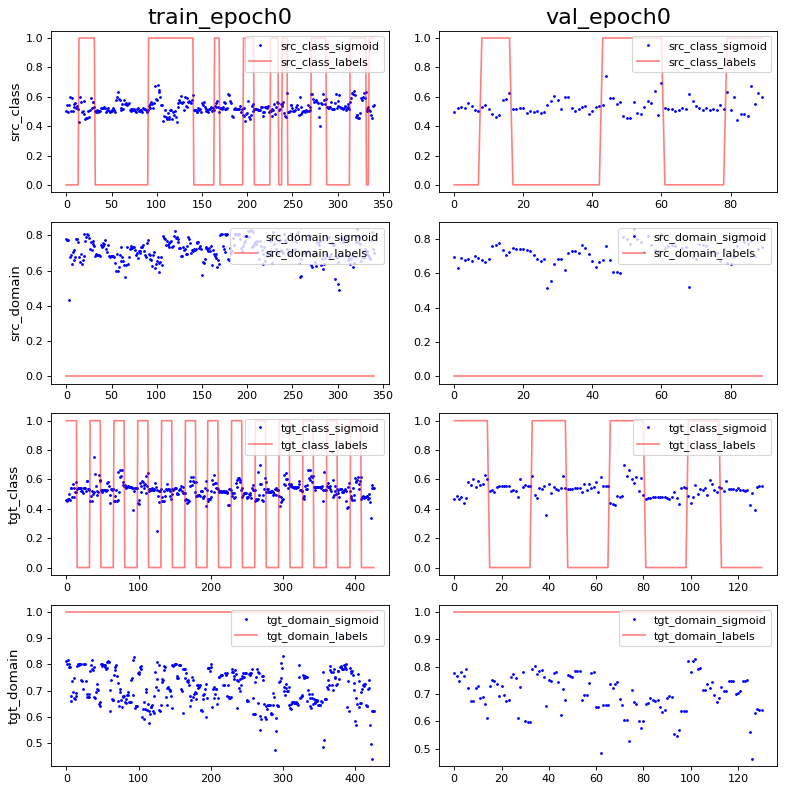

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: -4.1392115e-10 0.9965218
PCA var: [27.000002 38.9      48.7      54.300003 58.000004 61.500004 64.3
 66.600006 68.700005 70.50001 ]
show standardize mean and std: -1.9178972e-09 0.9965218
PCA var: [25.400002 37.       47.2      54.2      59.600002 63.100002 66.3
 69.100006 71.600006 74.00001 ]


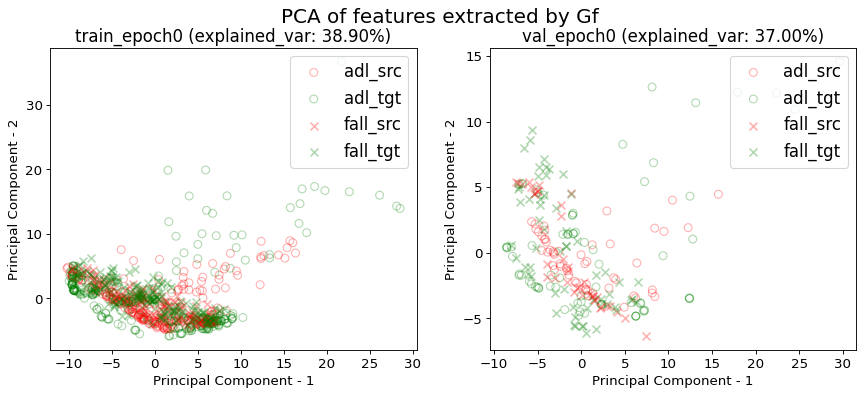

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/


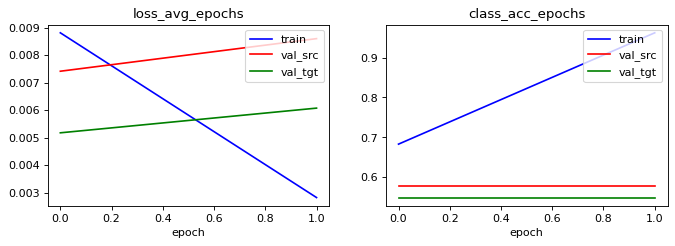

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.5835777126099707 1.0 0.6803519061583577 0.0
acc performance: 0.5777777777777777 1.0 0.8 0.0


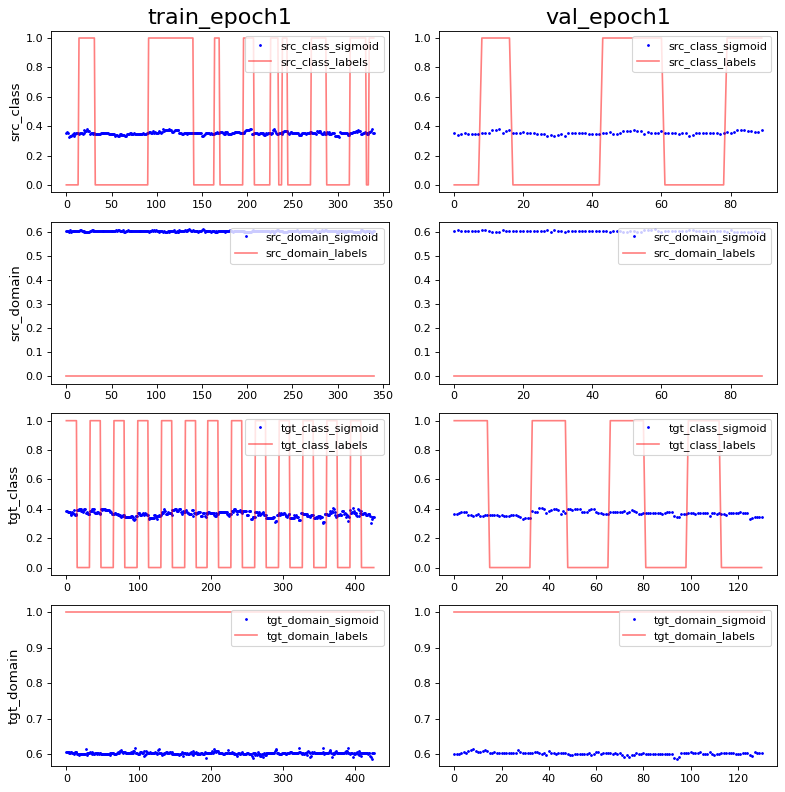

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: 1.3797371e-09 0.8660254
PCA var: [35.100002 48.700005 57.300003 61.500004 64.700005 67.600006 70.200005
 72.50001  74.600006 76.40001 ]
show standardize mean and std: -1.9178972e-09 0.8660254
PCA var: [36.7      50.100002 57.       62.       65.9      69.5      72.9
 76.       78.7      80.799995]


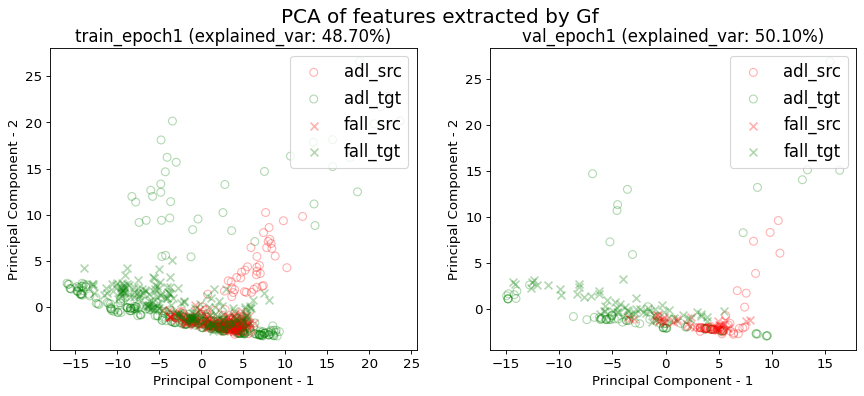

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.003024,0.977011,0.003451,0.564706,0.005805,0.545455
1,1.000000,0.002825,0.961877,0.008599,0.577778,0.006074,0.549618
mean,0.500000,0.002925,0.969444,0.006025,0.571242,0.005940,0.547536
std,0.707107,0.000141,0.010702,0.003640,0.009243,0.000190,0.002944


src val loss: 0.0060±0.0036
src val acc: 0.5712±0.0092
tgt val loss: 0.0059±0.0002
tgt val acc: 0.5475±0.0029
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 431, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UMAFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 64, 'learning_rate': 0.01, 'sensor_loc': 'waist', 'date': '2020/04/09 20:06:43', 'input_dim': (64, 3, 66), 'output_dim': (64,)}

======================  train on target, val on target(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modelo

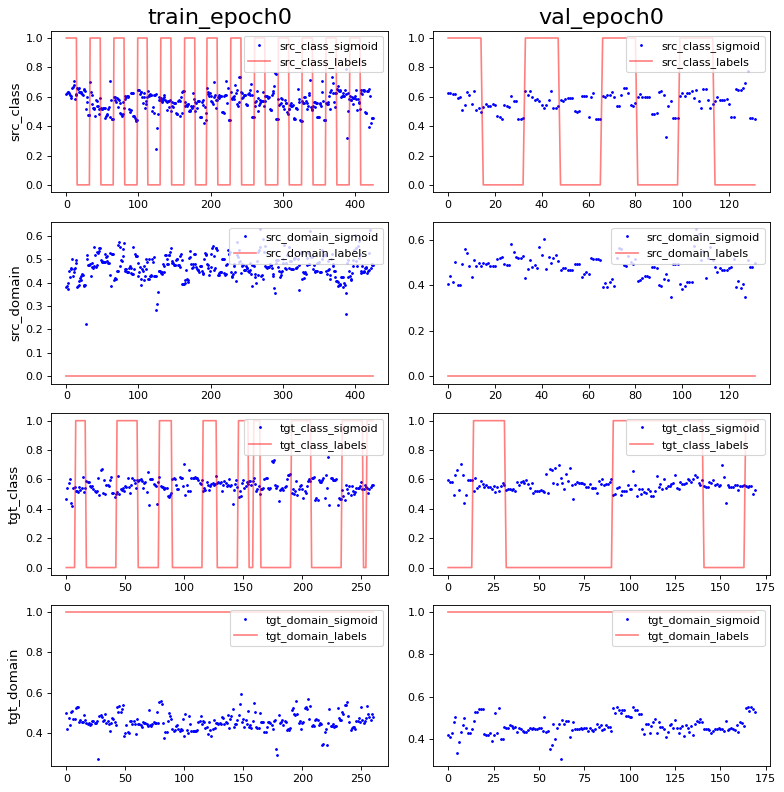

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: -2.7763445e-09 1.0
PCA var: [23.6      41.1      47.8      53.3      57.1      60.1      62.899998
 65.399994 67.7      69.6     ]
show standardize mean and std: -2.8069884e-09 0.9965218
PCA var: [24.2 39.3 47.5 53.3 58.7 62.7 66.2 69.1 71.4 73.4]


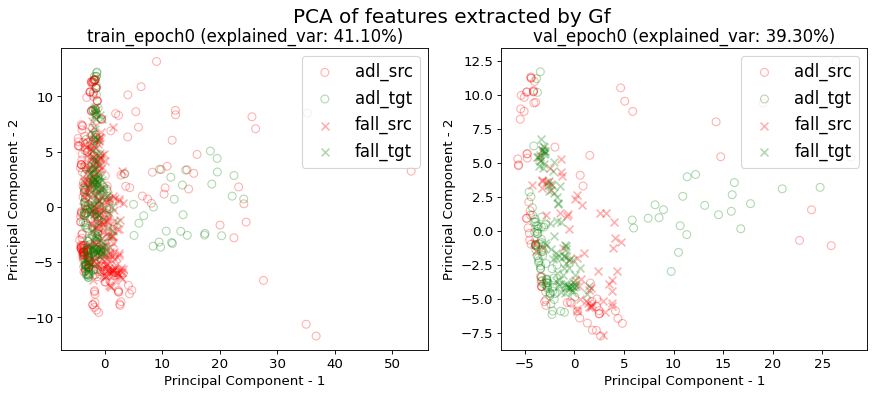

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/


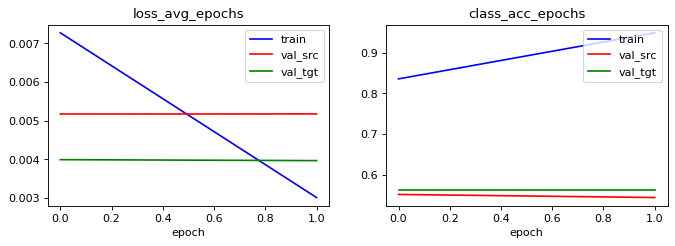

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.5446009389671361 1.0 0.37089201877934275 0.0
acc performance: 0.5454545454545454 1.0 0.7272727272727273 0.0


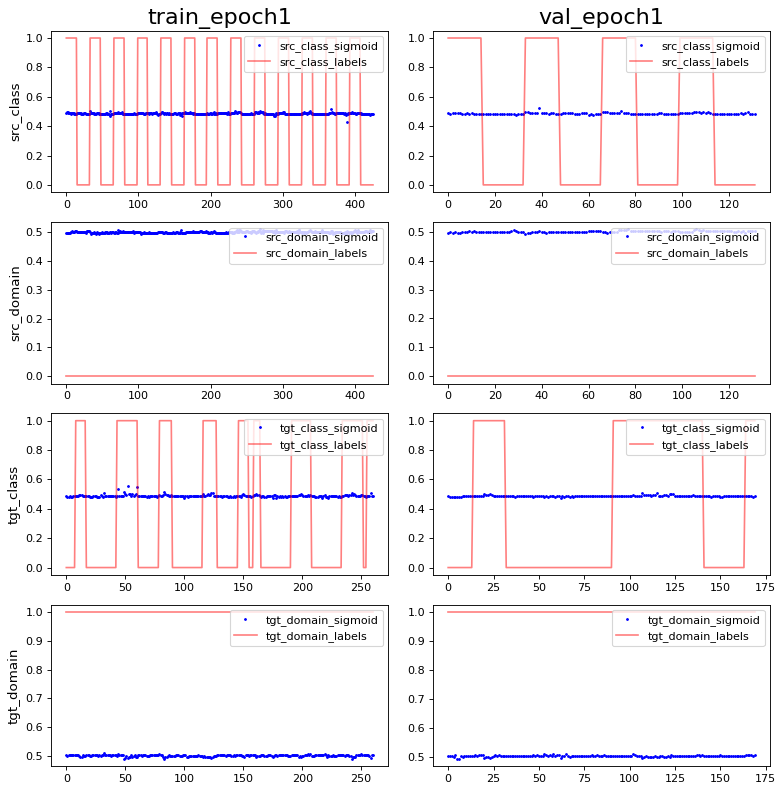

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: -1.1568102e-09 0.8498366
PCA var: [24.8      36.9      43.5      48.4      52.800003 56.700005 60.100006
 63.200005 66.3      68.8     ]
show standardize mean and std: -1.0526207e-09 0.80363756
PCA var: [24.3      33.699997 40.299995 45.299995 49.899994 53.999992 57.699993
 61.199993 64.299995 67.2     ]


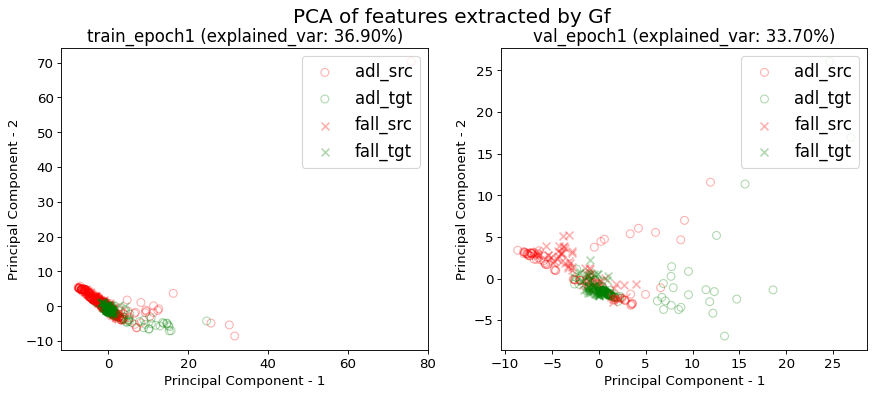

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.6206088992974239 0.7002341920374707 0.33489461358313816 0.26229508196721313
acc performance: 0.5267175572519084 0.7480916030534351 0.3053435114503817 0.1984732824427481


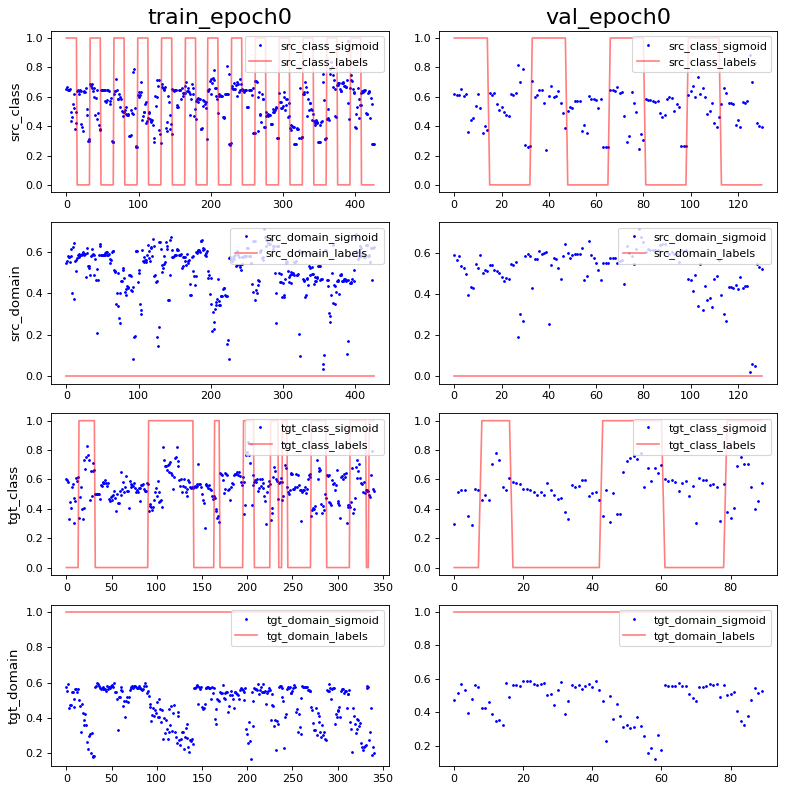

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: -2.345553e-09 0.99999994
PCA var: [26.800001 39.9      51.300003 57.300003 62.200005 65.4      67.9
 70.1      72.2      74.1     ]
show standardize mean and std: -3.3563199e-09 1.0
PCA var: [27.900002 41.300003 52.000004 60.600006 65.8      68.8      71.3
 73.8      76.       77.9     ]


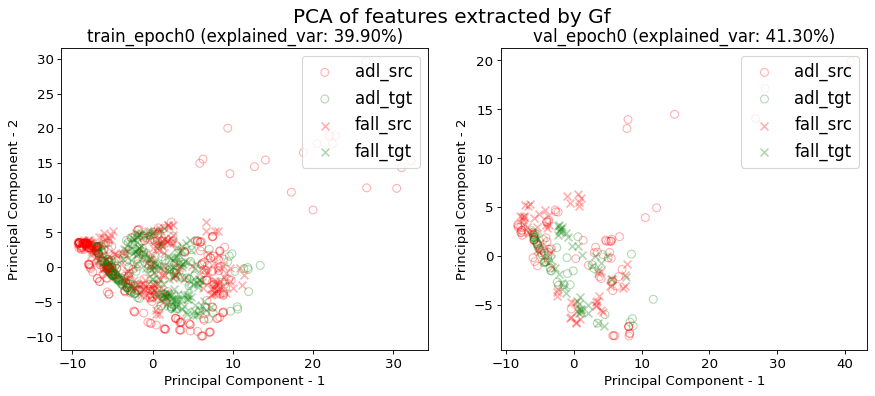

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/


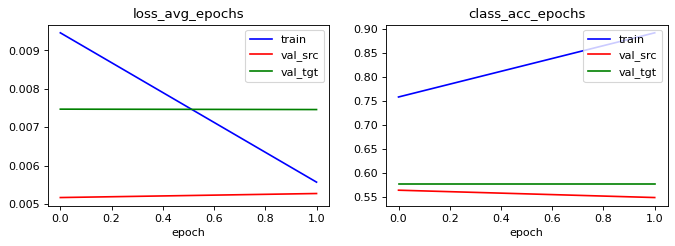

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.5433255269320844 0.9929742388758782 0.46604215456674475 0.0
acc performance: 0.549618320610687 1.0 0.3969465648854962 0.0


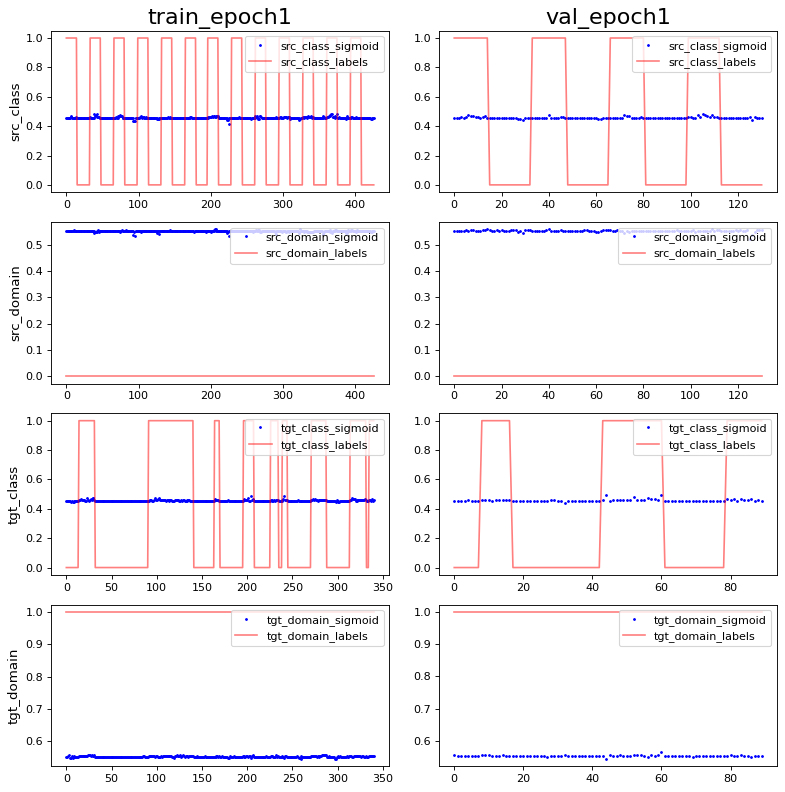

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: -6.8986855e-10 0.8579692
PCA var: [28.7      40.7      48.4      55.2      59.9      63.600002 67.100006
 70.40001  73.30001  75.90001 ]
show standardize mean and std: -2.8768457e-09 0.8498366
PCA var: [36.5      50.800003 60.800003 66.5      71.6      76.2      80.299995
 83.899994 86.99999  89.299995]


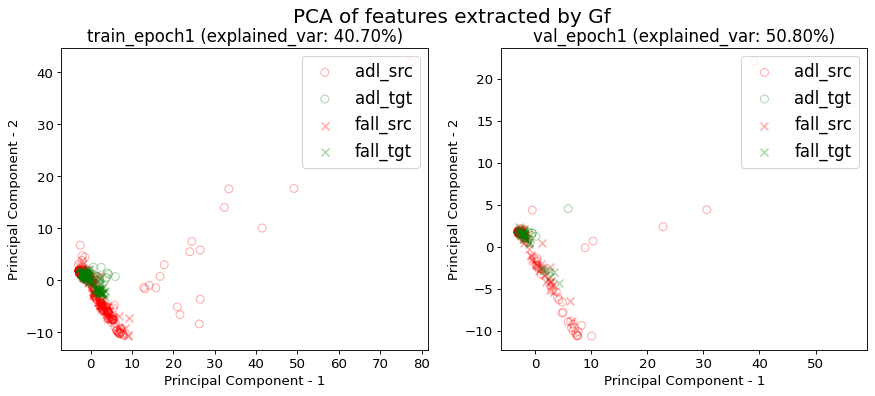

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.003015,0.948357,0.005178,0.545455,0.003971,0.564706
1,1.000000,0.005574,0.892272,0.005278,0.549618,0.007463,0.577778
mean,0.500000,0.004295,0.920314,0.005228,0.547536,0.005717,0.571242
std,0.707107,0.001810,0.039658,0.000071,0.002944,0.002470,0.009243


src val loss: 0.0052±0.0001
src val acc: 0.5475±0.0029
tgt val loss: 0.0057±0.0025
tgt val acc: 0.5712±0.0092
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UPFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 64, 'learning_rate': 0.01, 'sensor_loc': 'belt', 'date': '2020/04/09 20:06:55', 'input_dim': (64, 3, 66), 'output_dim': (64,)}

======================  DANN training transferring knowledge(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_mo

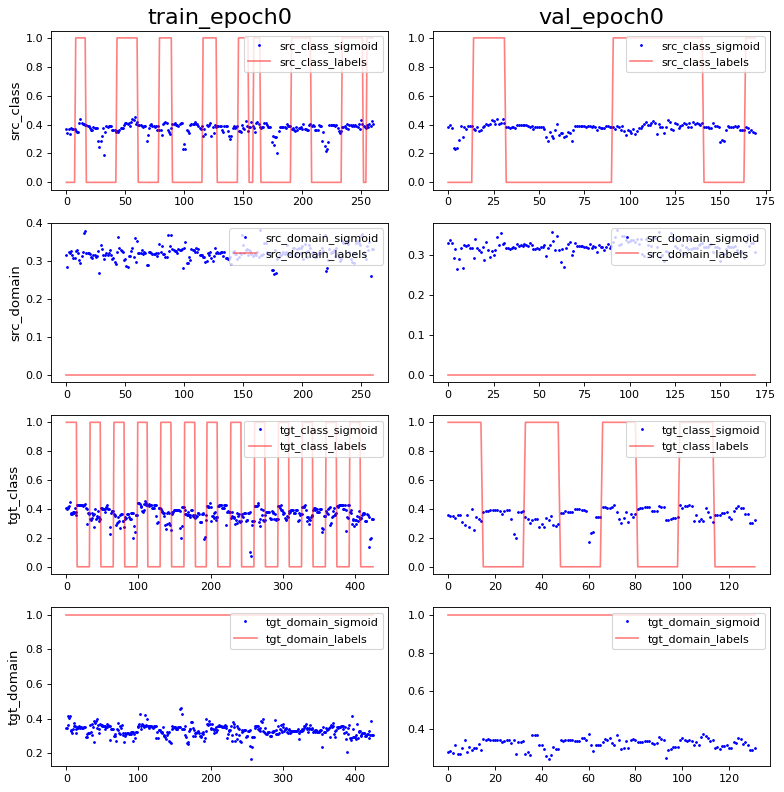

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: 5.552689e-09 0.9930313
PCA var: [22.400002 38.9      51.9      57.600002 61.2      64.5      67.6
 69.9      72.       73.8     ]
show standardize mean and std: 2.1052413e-09 0.99303126
PCA var: [21.199999 37.199997 50.199997 56.299995 60.399994 63.999992 66.899994
 69.799995 72.49999  74.799995]


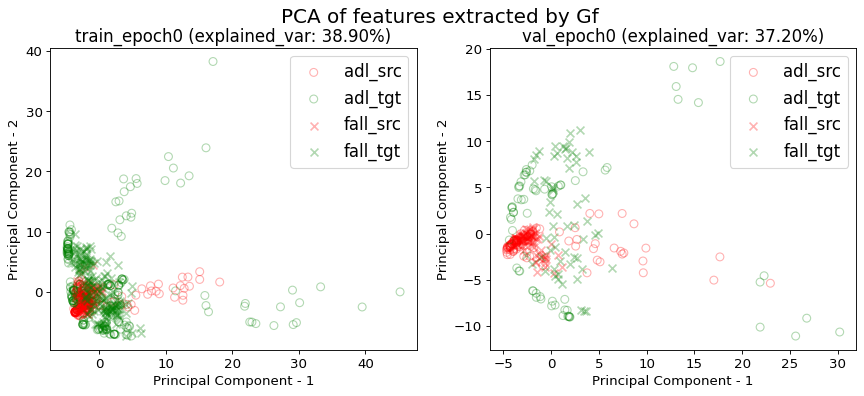

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/


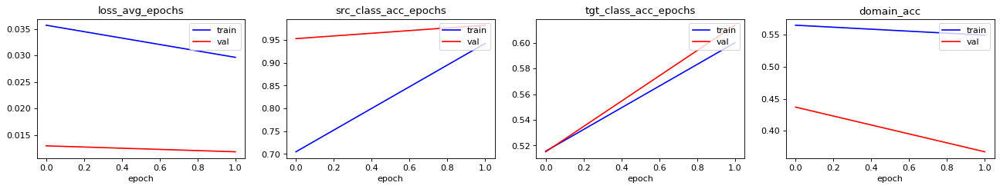

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.9655172413793104 0.10727969348659004 0.9425287356321839 1.1226053639846743
acc performance: 0.9823529411764705 0.1 0.4764705882352941 0.5529411764705883


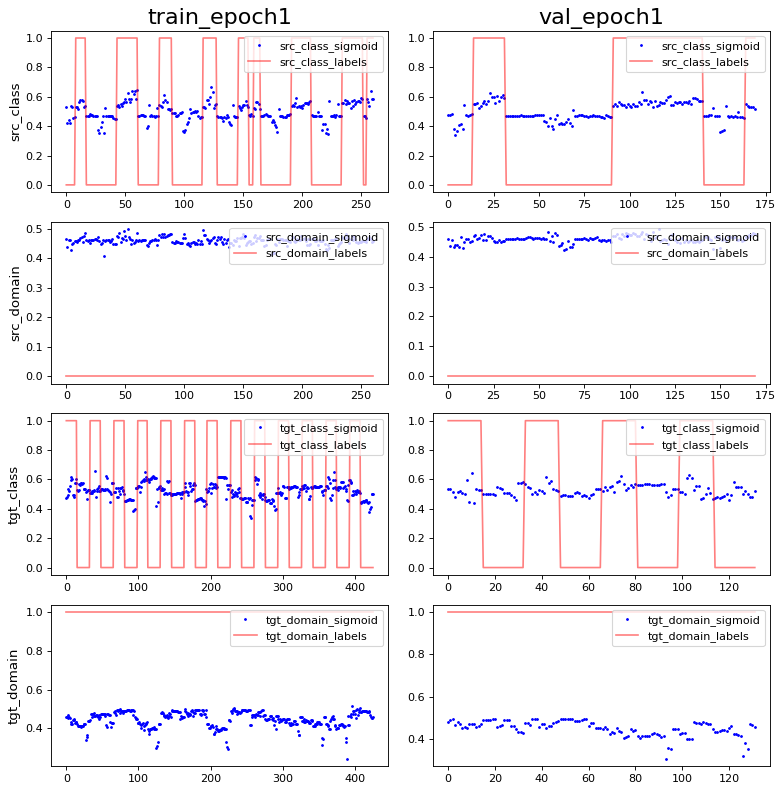

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -1.5809739e-09 0.9930313
PCA var: [27.3      42.5      49.6      55.8      59.8      62.899998 65.5
 67.9      70.200005 72.3     ]
show standardize mean and std: -5.613977e-09 0.9860133
PCA var: [23.7      39.       48.       56.1      59.899998 63.6      67.
 70.2      72.899994 75.49999 ]


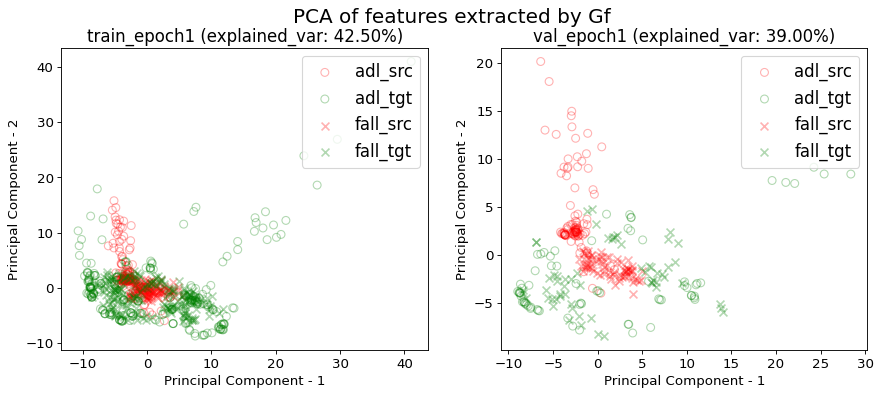

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.7653958944281525 0.6422287390029325 0.624633431085044 0.3225806451612903
acc performance: 0.6888888888888889 0.6333333333333333 0.6888888888888889 0.2777777777777778


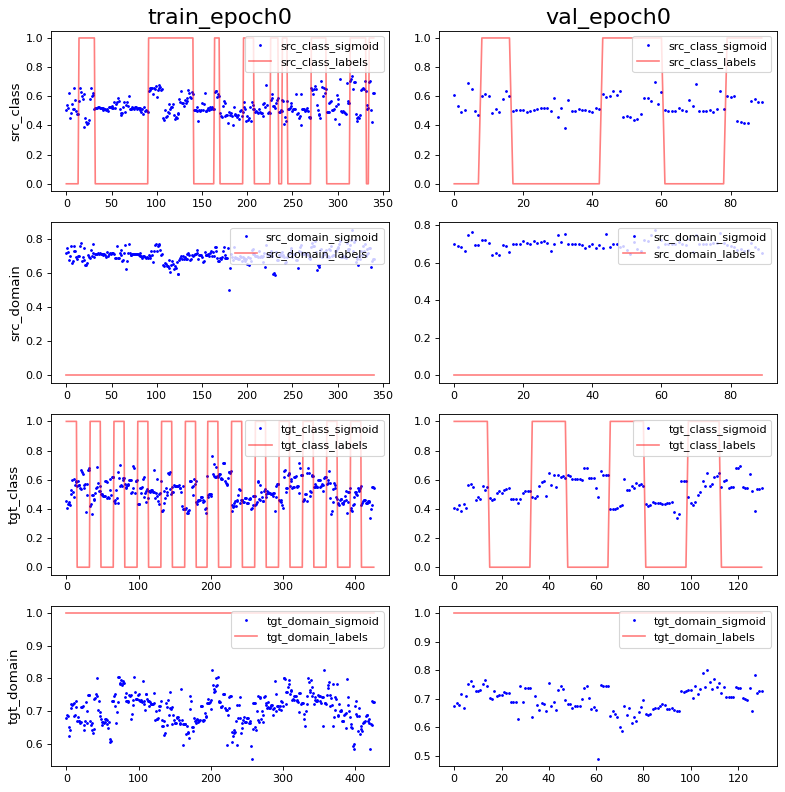

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -1.931632e-09 0.99999994
PCA var: [20.6 35.2 43.4 49.  54.5 57.7 60.3 62.6 64.6 66.6]
show standardize mean and std: 1.4384228e-09 1.0
PCA var: [22.300001 37.9      46.4      53.7      59.5      63.5      66.8
 69.600006 72.3      74.5     ]


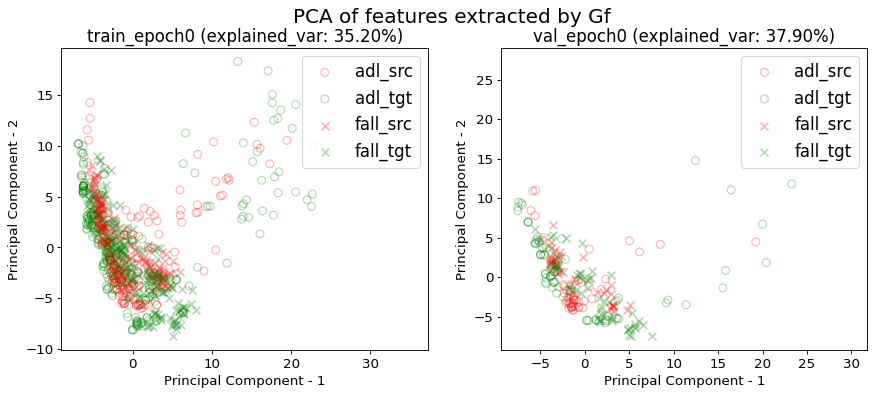

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/


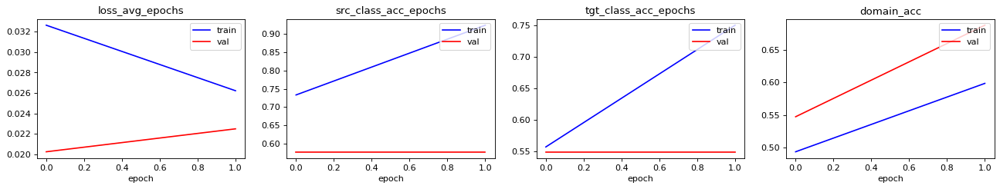

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.5835777126099707 0.24926686217008798 0.6803519061583577 1.2052785923753666
acc performance: 0.5777777777777777 0.3111111111111111 0.8 1.3777777777777778


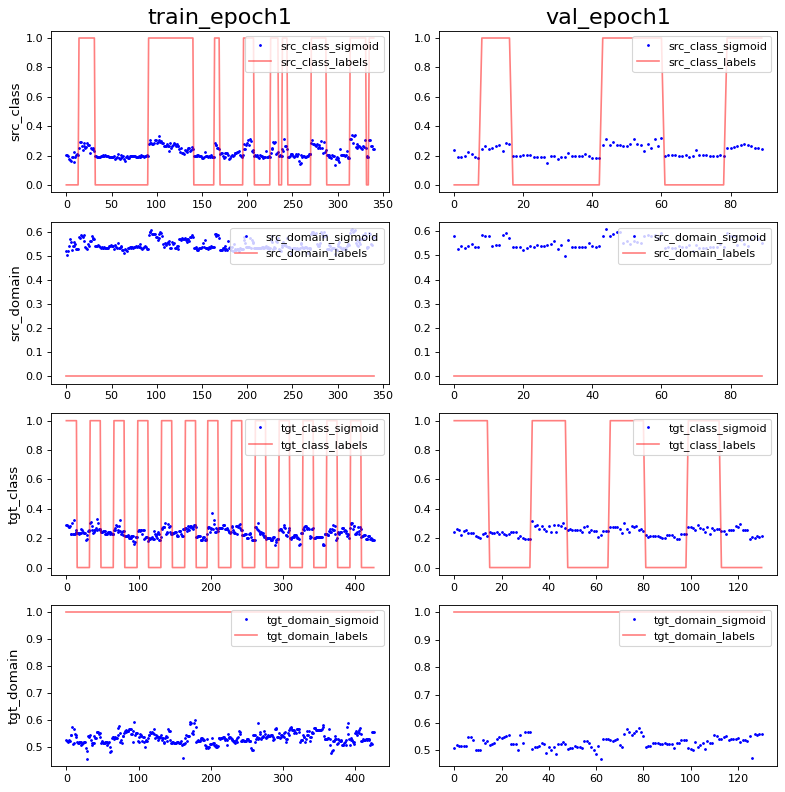

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: 4.1392116e-09 0.98952854
PCA var: [19.400002 30.500002 39.300003 46.200005 51.400005 55.300007 58.500008
 61.500008 64.200005 66.600006]
show standardize mean and std: 0.0 0.9824855
PCA var: [22.1      33.9      45.100002 54.600002 60.000004 65.200005 69.00001
 72.600006 75.40001  77.80001 ]


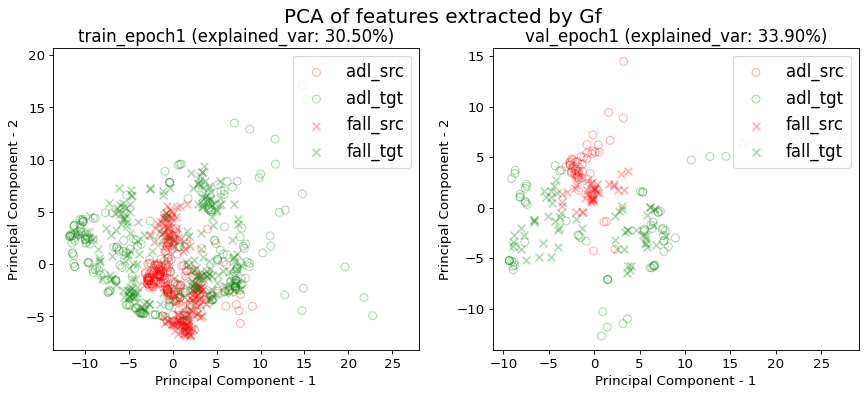

---------------Exporting model performance---------------
show df_performance


,i_CV,train_src_class_loss,train_tgt_class_loss,train_src_domain_loss,train_tgt_domain_loss,train_src_class_acc,train_tgt_class_acc,train_domain_acc,val_src_class_loss,val_tgt_class_loss,val_src_domain_loss,val_tgt_domain_loss,val_src_class_acc,val_tgt_class_acc,val_domain_acc
0,0.000000,0.006624,0.010218,0.013249,0.009763,0.942529,0.600000,0.549053,0.002977,0.005105,0.004356,0.004525,0.982353,0.613636,0.367550
1,1.000000,0.003928,0.009261,0.011931,0.010362,0.923754,0.750000,0.598621,0.009839,0.007699,0.008084,0.004564,0.577778,0.549618,0.687783
mean,0.500000,0.005276,0.009740,0.012590,0.010063,0.933141,0.675000,0.573837,0.006408,0.006402,0.006220,0.004544,0.780065,0.581627,0.527666
std,0.707107,0.001906,0.000677,0.000932,0.000423,0.013276,0.106066,0.035049,0.004852,0.001835,0.002637,0.000028,0.286078,0.045268,0.226439


val_src_class_acc: 0.7801±0.2861
val_tgt_class_acc: 0.5816±0.0453
val_domain_acc: 0.5277±0.2264
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 431, 'classes_n': 2, 'model_name': 'DannModel', 'src_dataset_name': 'UMAFall', 'tgt_dataset_name': 'UPFall', 'src_sensor_loc': 'waist', 'tgt_sensor_loc': 'belt', 'date': '2020/04/09 20:07:07', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 64, 'learning_rate': 0.01, 'input_dim': (64, 3, 66), 'output_dim': 2, 'label_dim': (64,)}
val_tgt_class_acc: 0.5816±0.0453
val_domain_acc: 0.5277±0.2264
time elapsed: 00:00:36

======================  train on source, val on target(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_

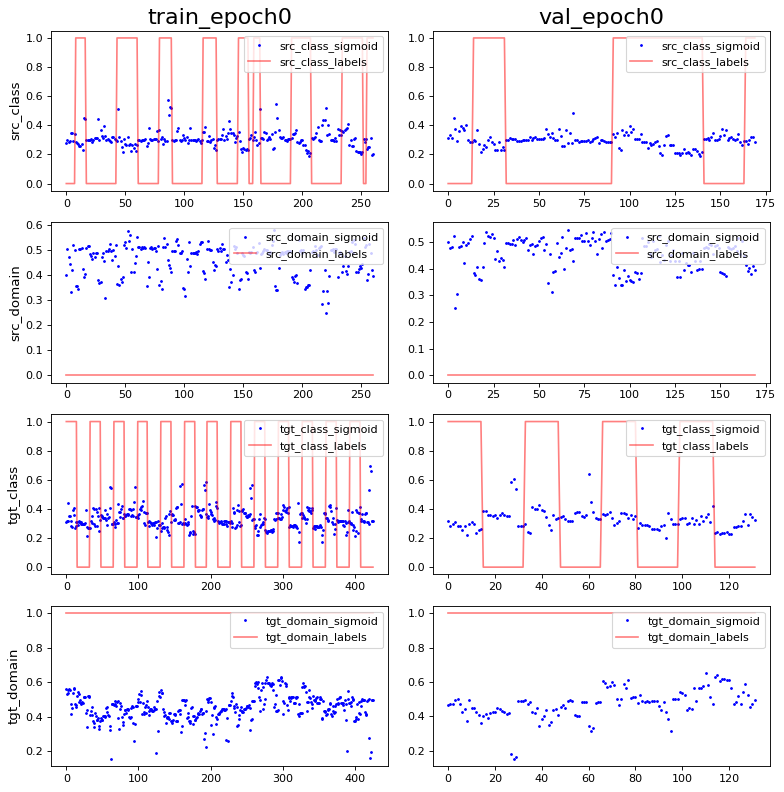

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: -2.622103e-09 0.9947781
PCA var: [20.3      34.       41.7      47.5      52.8      57.2      60.
 62.4      64.700005 66.4     ]
show standardize mean and std: 1.140339e-09 0.9921567
PCA var: [18.8      32.       40.6      46.899998 52.699997 57.199997 60.699997
 62.999996 65.2      67.299995]


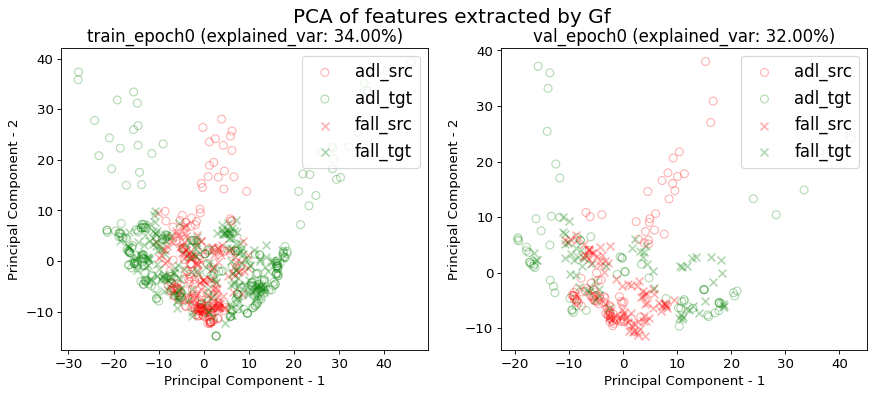

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/


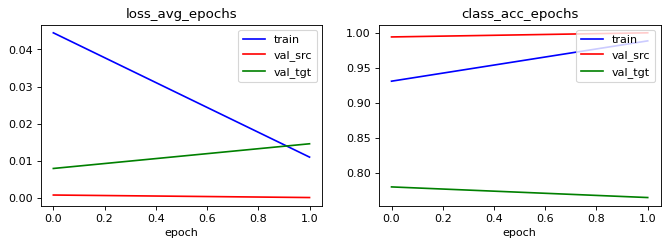

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.9923371647509579 0.5708812260536399 1.2758620689655173 0.5938697318007663
acc performance: 1.0 0.5529411764705883 0.5941176470588235 0.2411764705882353


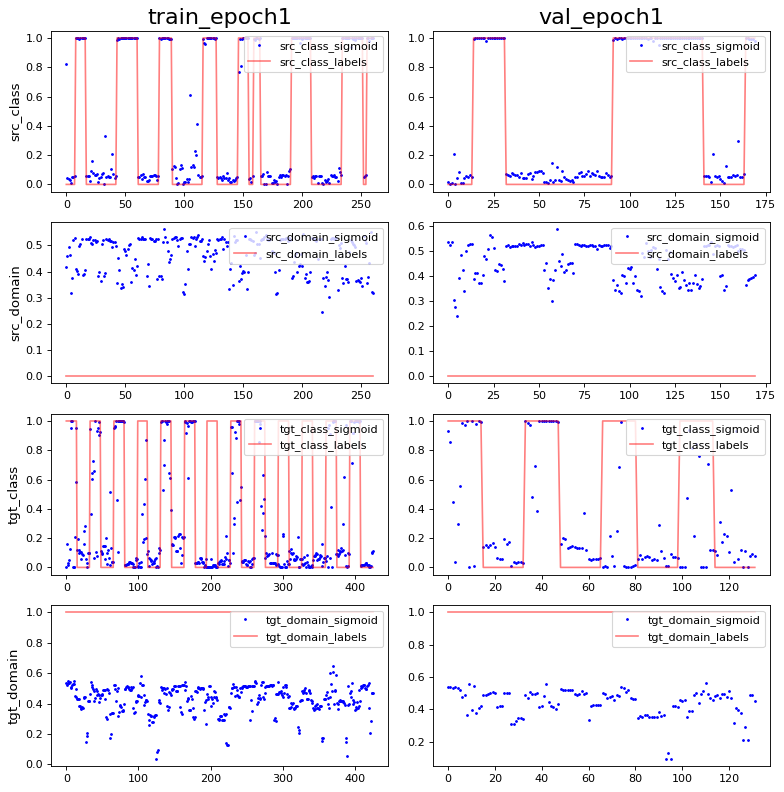

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: 1.025705e-08 0.99477804
PCA var: [35.7      49.300003 59.300003 65.700005 68.600006 70.90001  73.100006
 75.100006 76.700005 78.100006]
show standardize mean and std: -1.578931e-09 0.993905
PCA var: [30.199999 45.399998 55.199997 63.1      66.4      69.3      72.
 74.3      76.5      78.3     ]


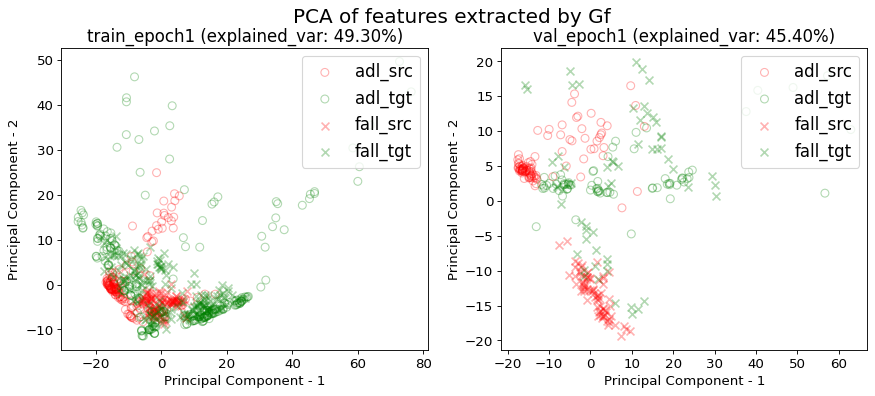

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.7536656891495601 0.7712609970674487 0.8709677419354839 0.26099706744868034
acc performance: 0.7444444444444445 0.7444444444444445 1.2 0.2777777777777778


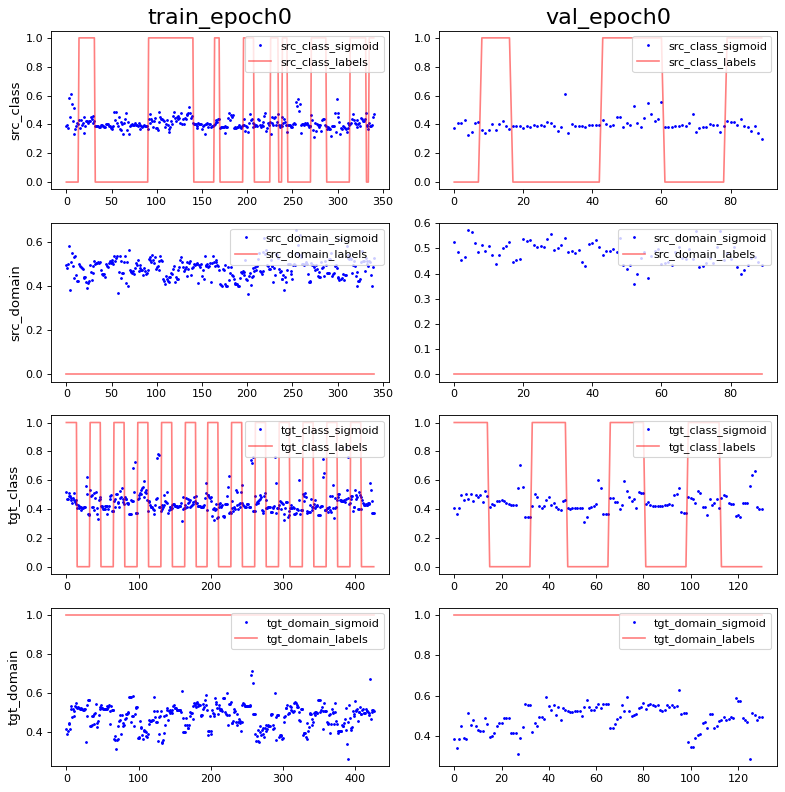

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: 1.1037897e-09 0.994778
PCA var: [18.       30.8      40.4      46.600002 52.000004 56.300003 58.800003
 61.100002 63.300003 65.200005]
show standardize mean and std: 3.8357943e-09 0.99477804
PCA var: [18.       30.8      42.9      49.600002 55.200005 59.800003 62.800003
 65.5      67.9      70.      ]


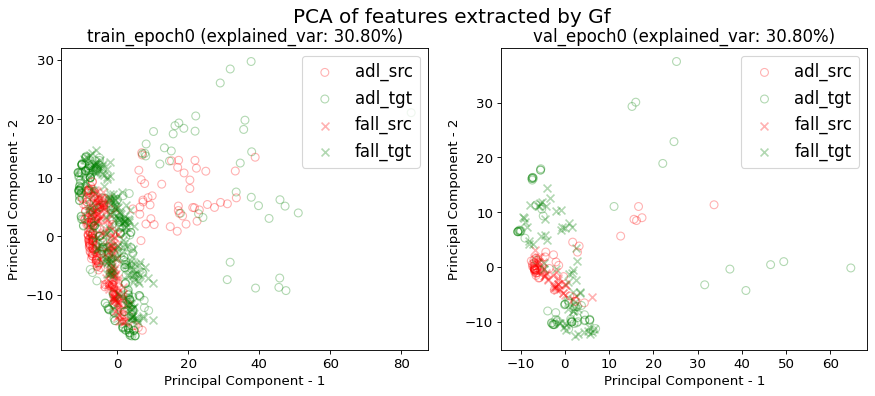

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/


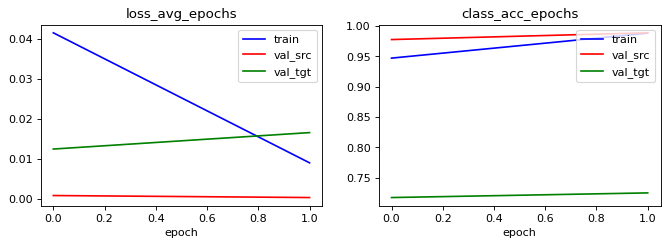

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.9794721407624634 0.9970674486803519 0.9090909090909091 0.06744868035190615
acc performance: 0.9888888888888889 1.0 1.0555555555555556 0.14444444444444443


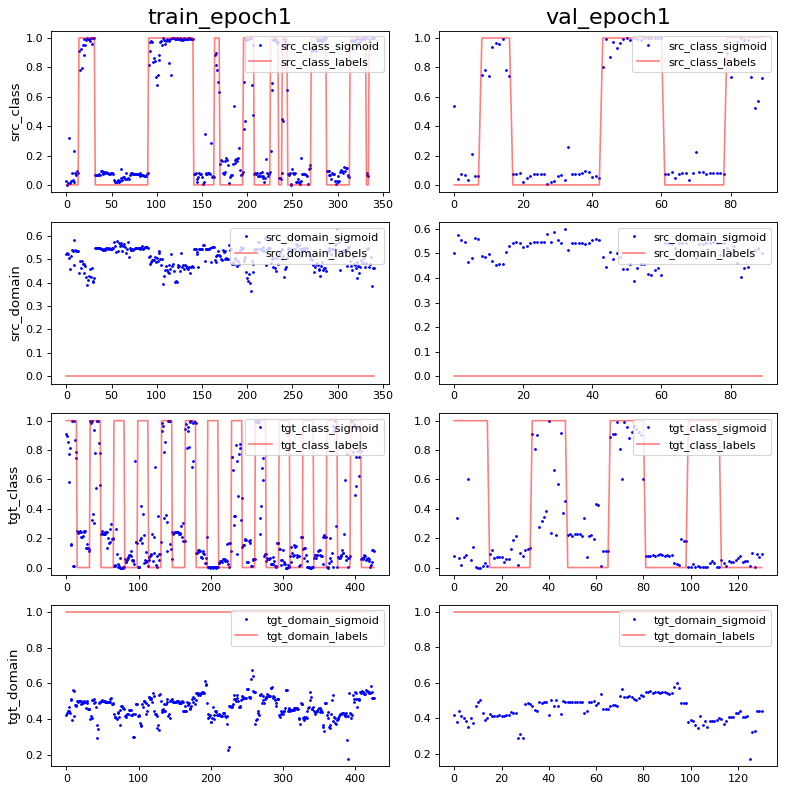

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: -1.931632e-09 0.9973925
PCA var: [40.3 52.6 63.5 67.4 70.4 72.9 75.1 76.9 78.6 80.2]
show standardize mean and std: -3.8357943e-09 0.9956503
PCA var: [48.3      59.8      67.8      71.5      74.8      77.200005 79.3
 81.3      83.       84.6     ]


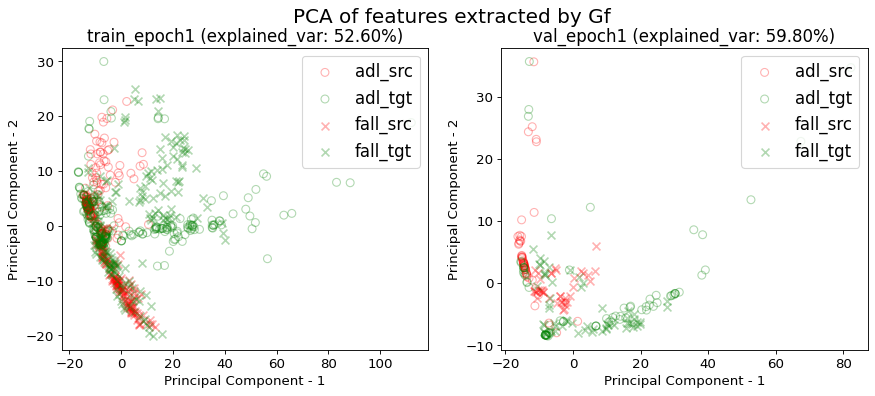

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.010939,0.988506,0.000029,1.000000,0.014542,0.765152
1,1.000000,0.009095,0.988270,0.000419,0.988889,0.016649,0.725191
mean,0.500000,0.010017,0.988388,0.000224,0.994444,0.015596,0.745171
std,0.707107,0.001304,0.000167,0.000276,0.007857,0.001489,0.028256


src val loss: 0.0002±0.0003
src val acc: 0.9944±0.0079
tgt val loss: 0.0156±0.0015
tgt val acc: 0.7452±0.0283
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 431, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UMAFall', 'num_epochs': 2, 'channel_n': 16, 'batch_size': 4, 'learning_rate': 0.01, 'sensor_loc': 'waist', 'date': '2020/04/09 20:07:21', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  train on target, val on target(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modelo

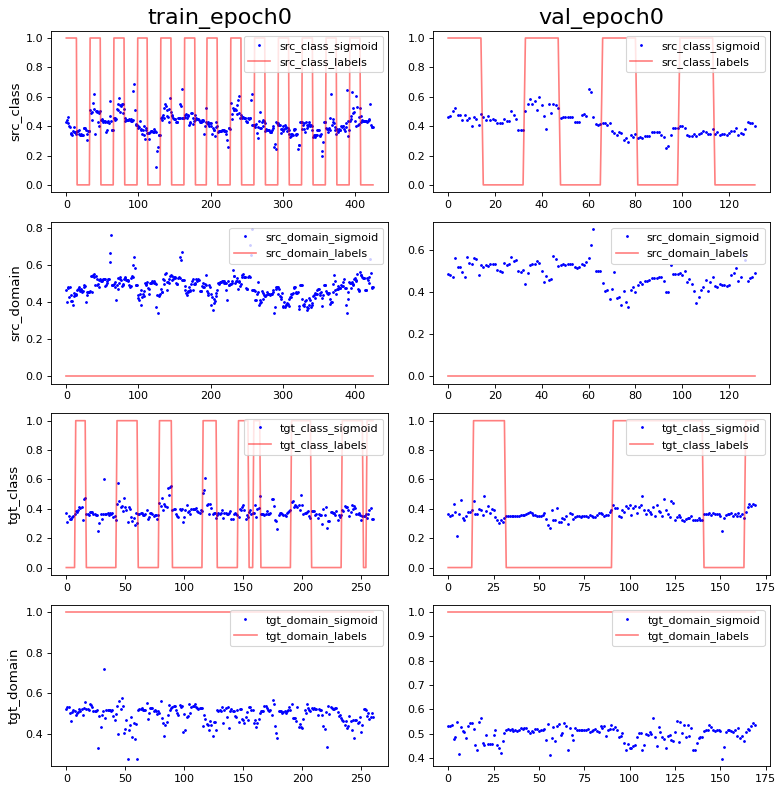

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: 1.5424136e-10 0.99739254
PCA var: [19.9      31.9      40.1      44.399998 48.399998 51.8      54.6
 57.1      59.3      61.2     ]
show standardize mean and std: -7.894655e-10 0.99390495
PCA var: [20.7      31.6      39.100002 45.4      50.600002 54.100002 57.2
 60.2      62.8      65.      ]


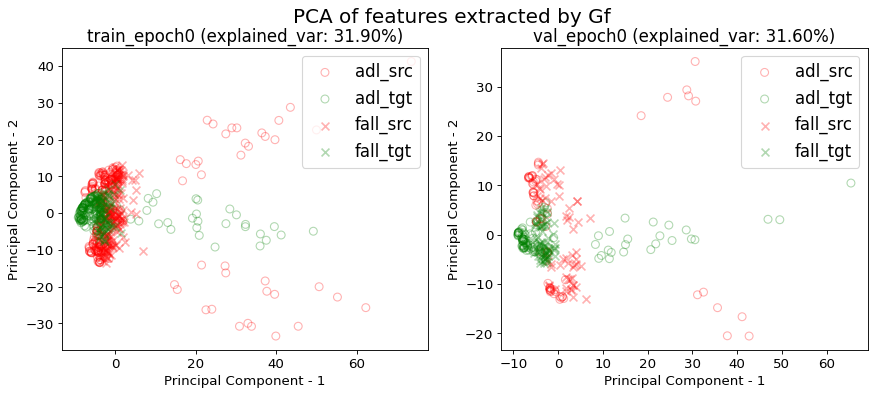

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/


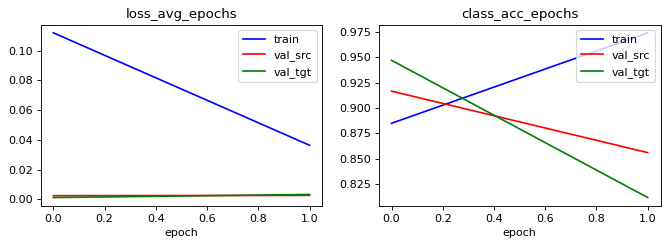

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.8568075117370892 0.9389671361502347 0.5563380281690141 0.04225352112676056
acc performance: 0.8560606060606061 0.8863636363636364 1.0454545454545454 0.030303030303030304


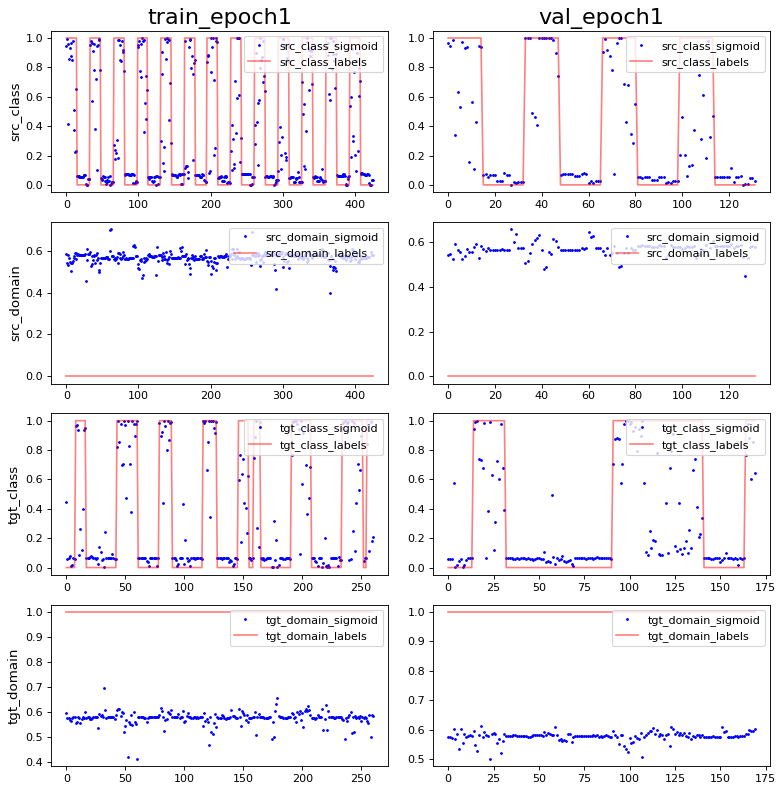

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: -1.0796896e-09 0.9921568
PCA var: [24.       37.8      45.9      52.2      56.9      60.2      62.9
 65.200005 67.3      69.200005]
show standardize mean and std: 1.9298045e-09 0.98777246
PCA var: [23.  37.8 47.8 54.5 58.7 62.3 65.7 68.2 70.6 72.9]


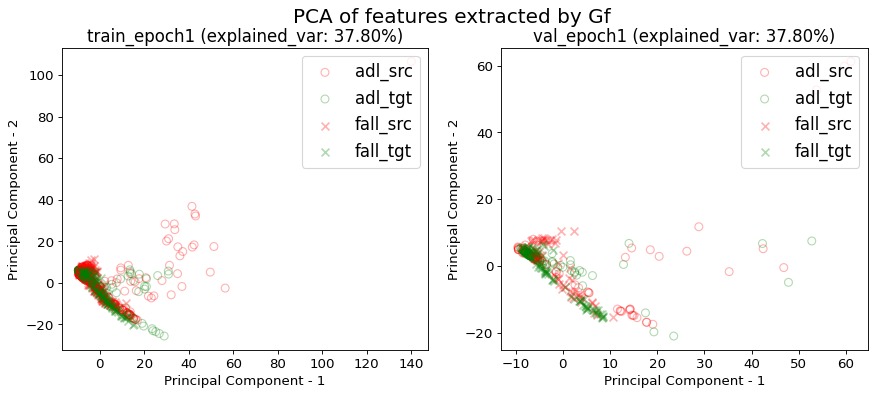

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.3793911007025761 0.08196721311475409 0.1592505854800937 0.7704918032786885
acc performance: 0.366412213740458 0.0916030534351145 0.10687022900763359 0.6641221374045801


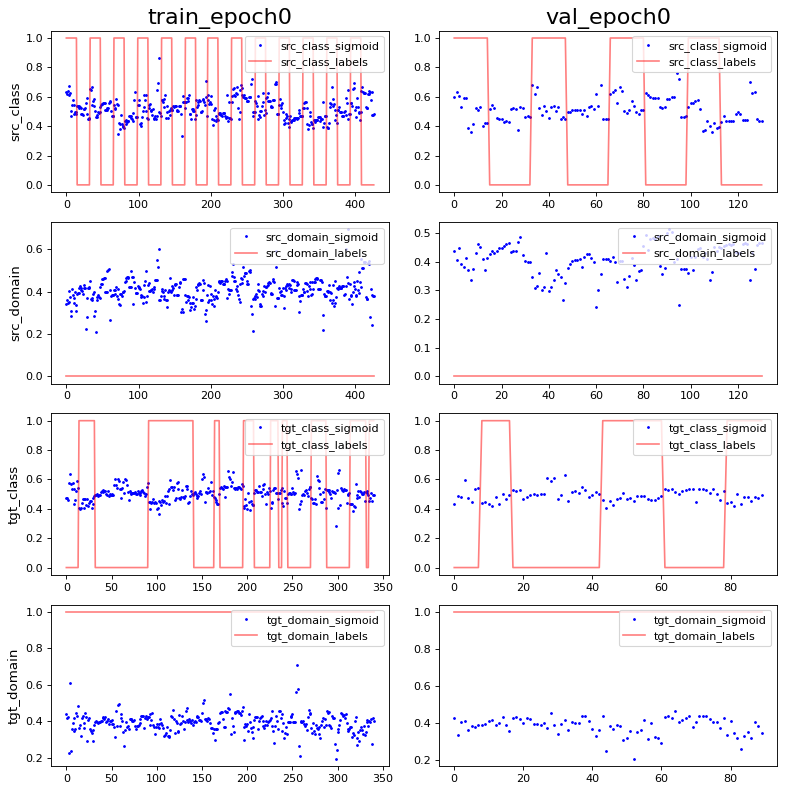

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: -8.278423e-10 0.9982623
PCA var: [20.       32.9      41.100002 46.600002 50.4      53.5      56.1
 58.399998 60.6      62.5     ]
show standardize mean and std: 3.2364513e-09 0.9973924
PCA var: [21.199999 34.7      45.5      51.5      56.5      59.8      62.7
 65.4      67.9      70.1     ]


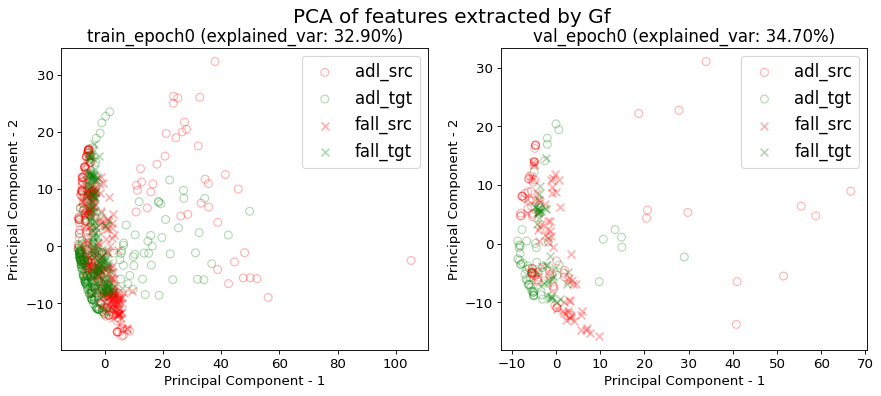

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/


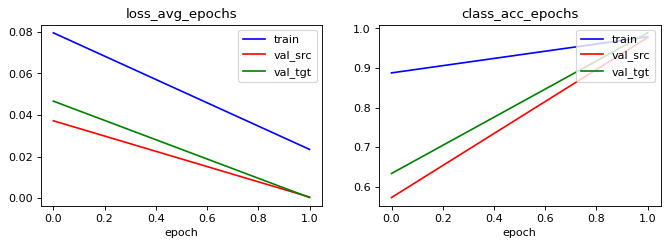

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.9625292740046838 0.07728337236533958 0.7587822014051522 0.7728337236533958
acc performance: 0.9770992366412213 0.0916030534351145 0.6793893129770993 0.6870229007633588


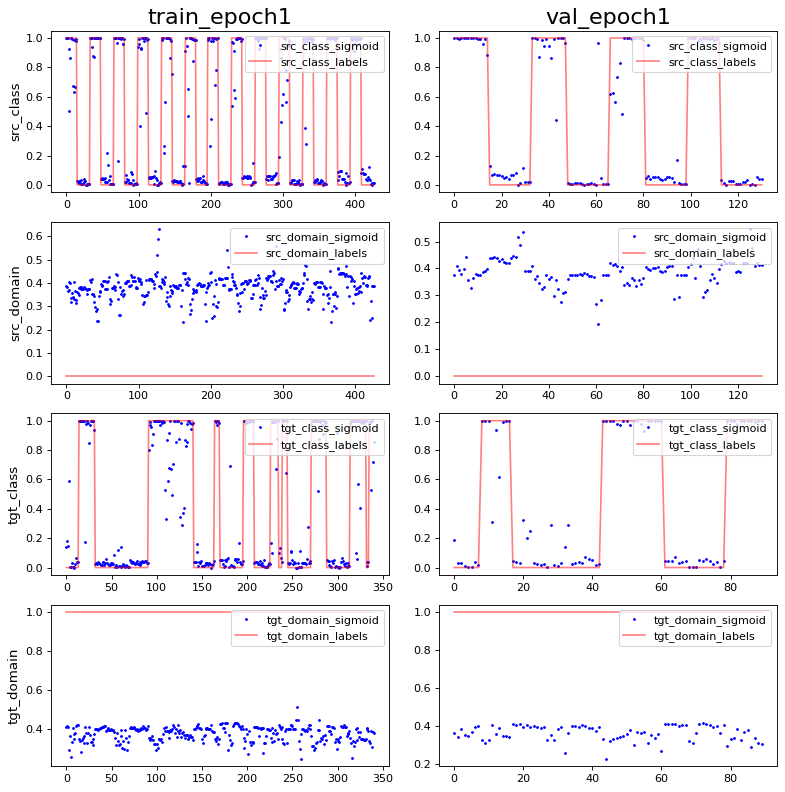

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: 1.2935035e-09 0.9947781
PCA var: [23.1 36.5 43.8 49.  53.1 56.8 60.2 62.7 64.6 66.4]
show standardize mean and std: -1.6781599e-09 0.9904054
PCA var: [25.  40.2 47.8 54.6 59.  62.7 65.5 68.  70.4 72.5]


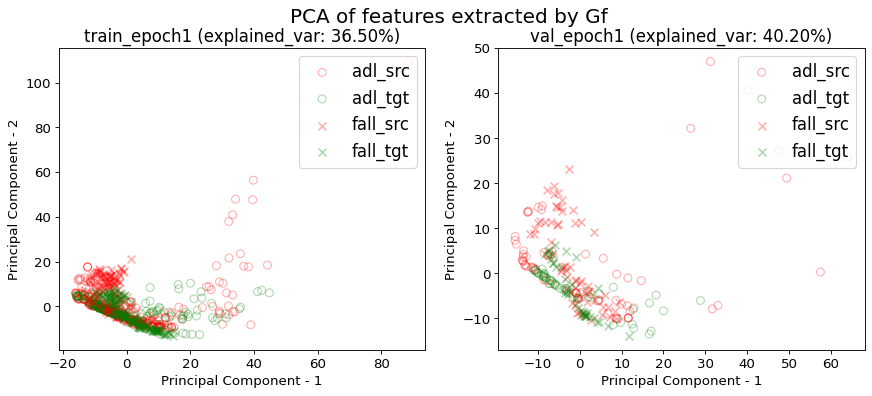

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.036322,0.974178,0.002634,0.856061,0.003255,0.811765
1,1.000000,0.023490,0.978923,0.000583,0.977099,0.000345,0.988889
mean,0.500000,0.029906,0.976551,0.001609,0.916580,0.001800,0.900327
std,0.707107,0.009074,0.003355,0.001450,0.085587,0.002058,0.125246


src val loss: 0.0016±0.0015
src val acc: 0.9166±0.0856
tgt val loss: 0.0018±0.0021
tgt val acc: 0.9003±0.1252
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UPFall', 'num_epochs': 2, 'channel_n': 16, 'batch_size': 4, 'learning_rate': 0.01, 'sensor_loc': 'belt', 'date': '2020/04/09 20:07:35', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  DANN training transferring knowledge(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_mo

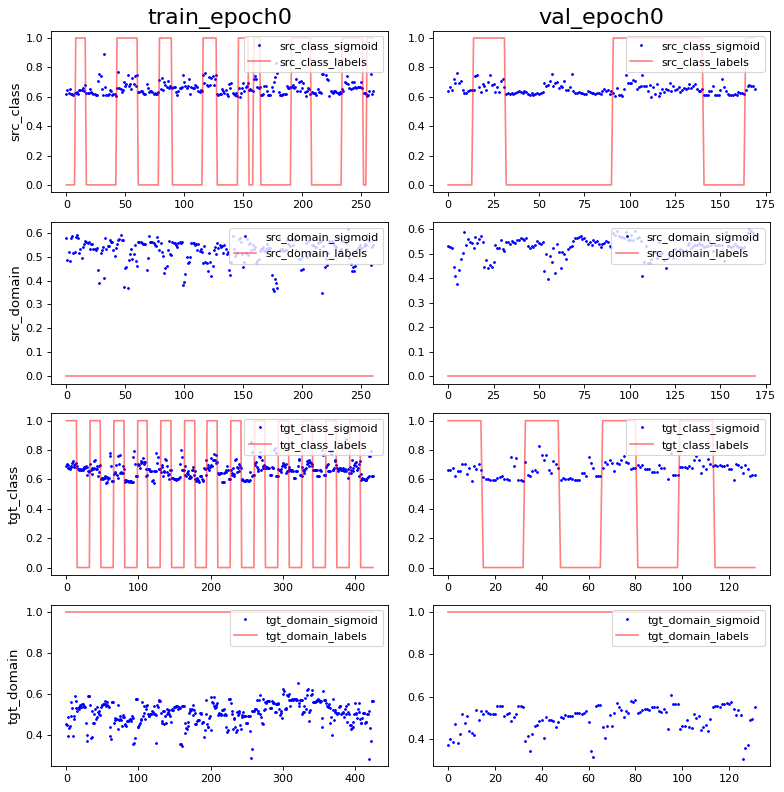

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -2.0051376e-09 0.9965218
PCA var: [21.4 36.3 43.5 49.  53.7 57.  59.8 62.2 64.4 66. ]
show standardize mean and std: -1.0526207e-09 0.9947779
PCA var: [20.1      34.300003 42.200005 47.500004 52.500004 56.800003 60.100002
 62.9      65.1      67.2     ]


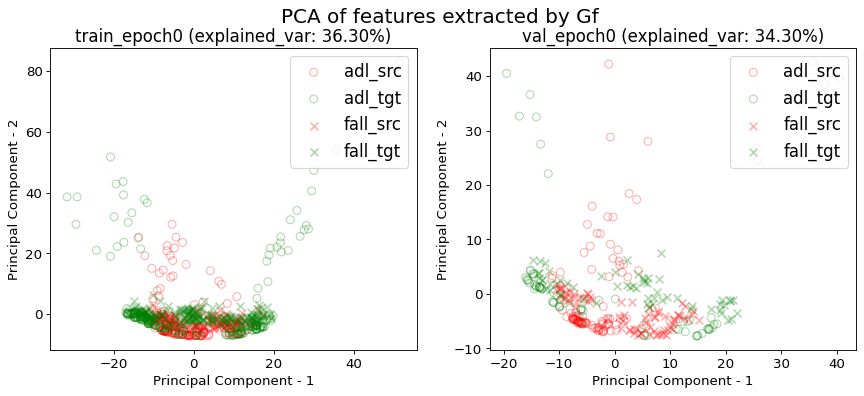

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/


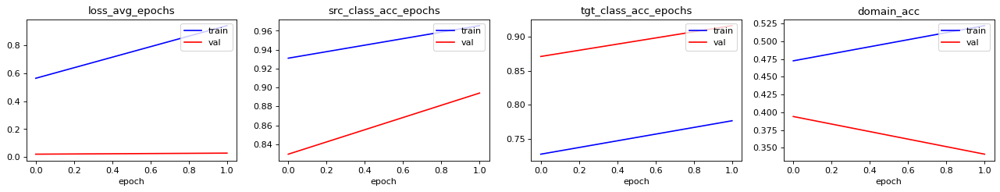

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.9501915708812261 0.06896551724137931 1.5172413793103448 1.2528735632183907
acc performance: 0.8941176470588236 0.08823529411764706 0.711764705882353 0.5176470588235295


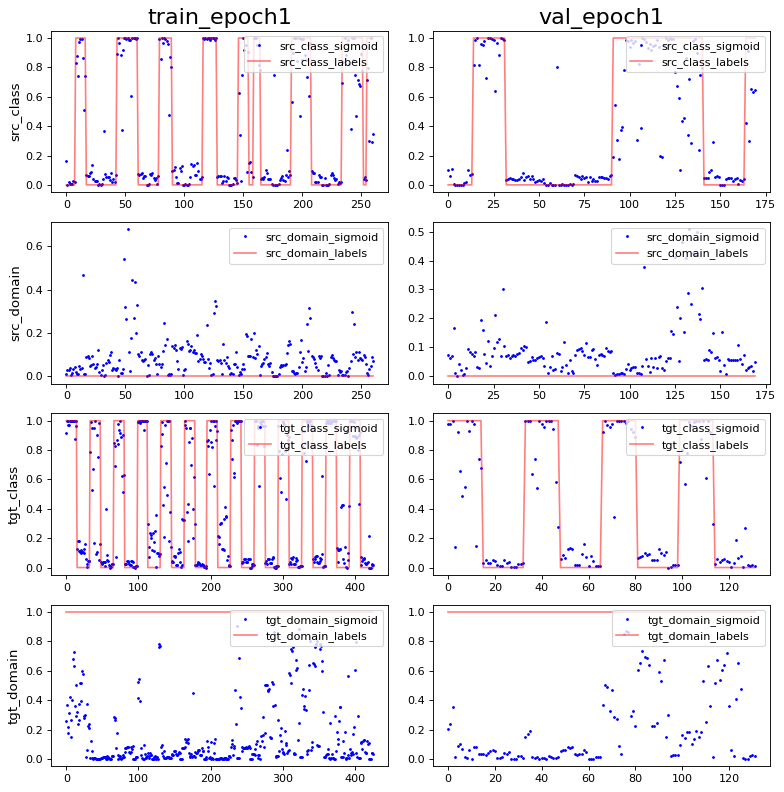

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: 3.1619478e-09 0.99999994
PCA var: [21.3      38.1      49.       55.9      61.4      64.6      67.299995
 69.399994 71.399994 73.2     ]
show standardize mean and std: 1.7543678e-10 0.9973925
PCA var: [20.3      35.5      47.2      56.800003 63.000004 67.       70.3
 72.700005 75.00001  77.00001 ]


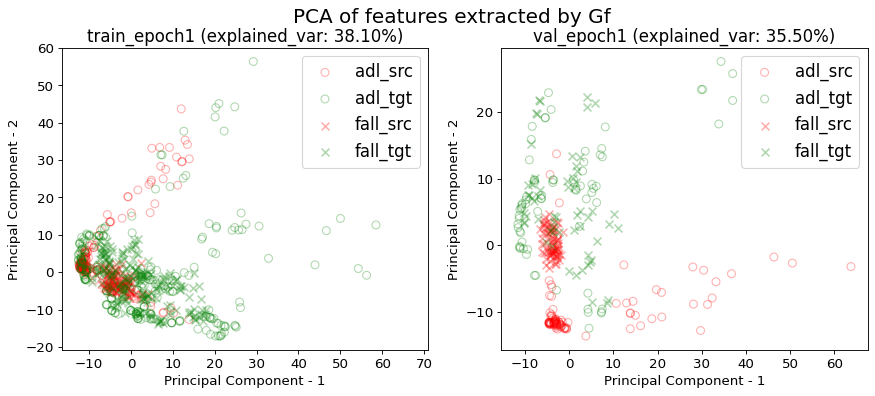

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.5630498533724341 0.9853372434017595 0.4662756598240469 0.06451612903225806
acc performance: 0.5111111111111111 0.9888888888888889 0.5555555555555556 0.022222222222222223


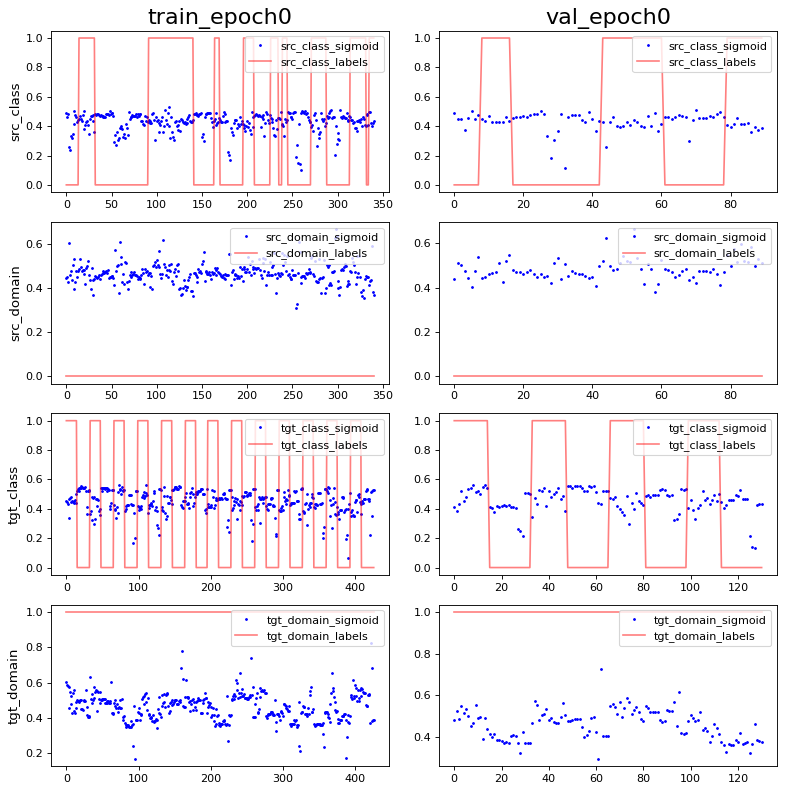

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -5.5189486e-10 0.99652165
PCA var: [24.699999 36.899998 42.1      46.399998 49.999996 53.499996 56.099995
 58.499996 60.799995 62.799995]
show standardize mean and std: 0.0 0.993905
PCA var: [25.8      40.1      45.5      50.4      54.4      58.300003 61.600002
 64.3      66.9      69.4     ]


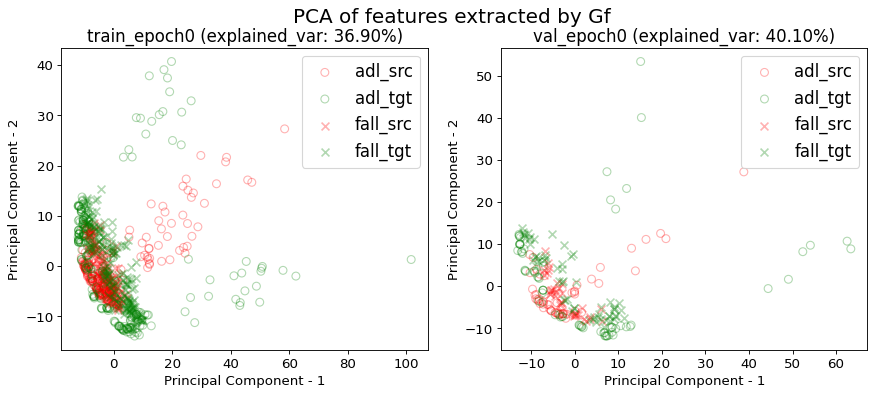

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/


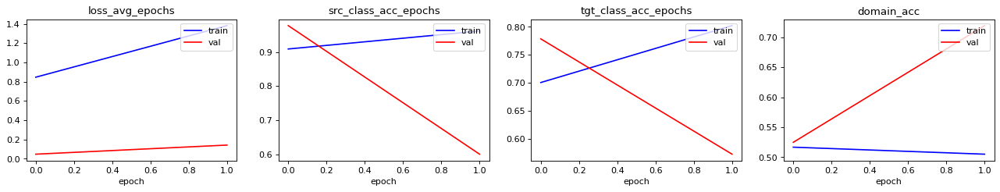

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.592375366568915 0.8328445747800587 0.6862170087976539 0.5073313782991202
acc performance: 0.6 0.9666666666666667 0.8333333333333334 0.8


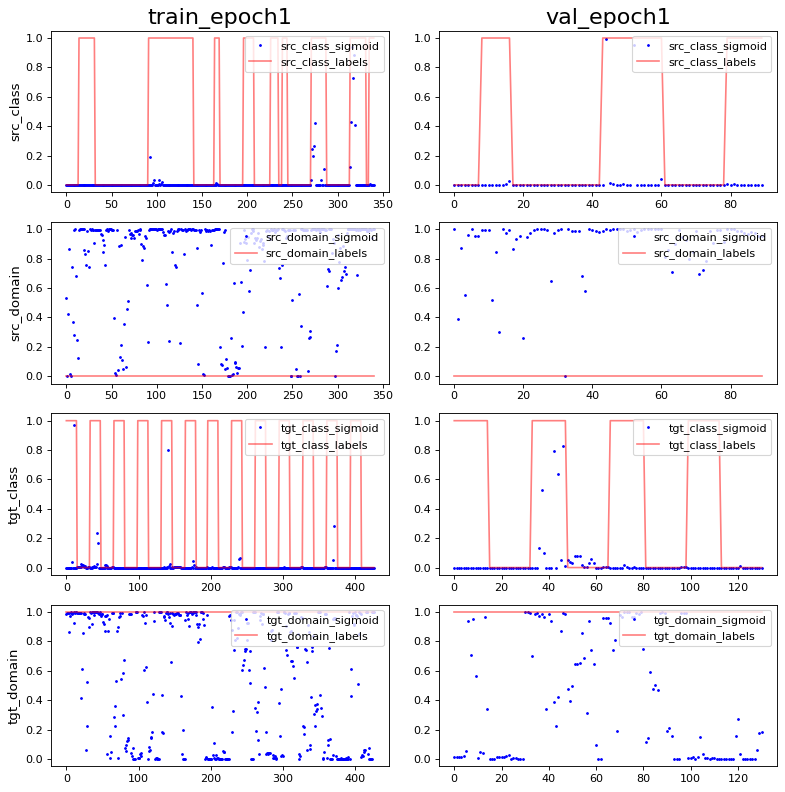

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: 1.1037897e-09 0.9973924
PCA var: [34.1 47.  56.  62.4 66.5 70.  72.4 74.4 76.1 77.7]
show standardize mean and std: -1.9178972e-09 0.99477804
PCA var: [37.3 50.1 59.1 65.9 70.  73.2 75.7 77.7 79.6 81.1]


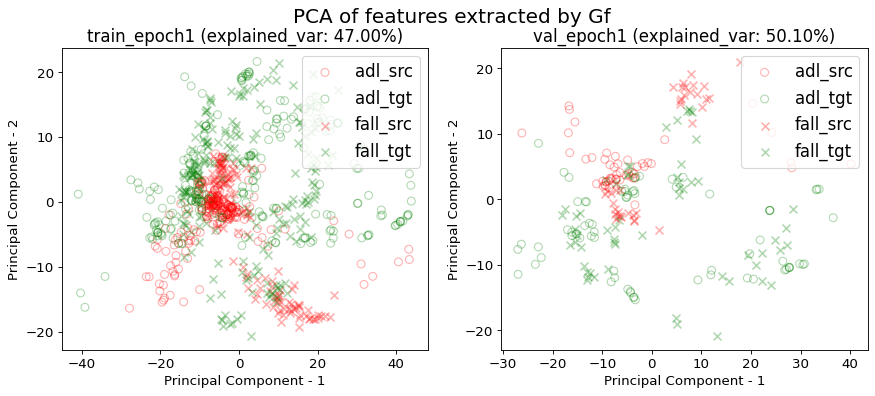

---------------Exporting model performance---------------
show df_performance


,i_CV,train_src_class_loss,train_tgt_class_loss,train_src_domain_loss,train_tgt_domain_loss,train_src_class_acc,train_tgt_class_acc,train_domain_acc,val_src_class_loss,val_tgt_class_loss,val_src_domain_loss,val_tgt_domain_loss,val_src_class_acc,val_tgt_class_acc,val_domain_acc
0,0.000000,0.022388,0.281416,0.453760,0.467175,0.965517,0.776515,0.521905,0.001442,0.001502,0.019230,0.007070,0.894118,0.916667,0.341060
1,1.000000,0.047475,0.499797,0.599731,0.734947,0.961877,0.802326,0.505109,0.116035,0.125243,0.002122,0.023872,0.600000,0.572519,0.719457
mean,0.500000,0.034932,0.390607,0.526746,0.601061,0.963697,0.789420,0.513507,0.058739,0.063373,0.010676,0.015471,0.747059,0.744593,0.530258
std,0.707107,0.017739,0.154418,0.103217,0.189344,0.002574,0.018251,0.011876,0.081030,0.087498,0.012097,0.011881,0.207973,0.243349,0.267567


val_src_class_acc: 0.7471±0.2080
val_tgt_class_acc: 0.7446±0.2433
val_domain_acc: 0.5303±0.2676
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 431, 'classes_n': 2, 'model_name': 'DannModel', 'src_dataset_name': 'UMAFall', 'tgt_dataset_name': 'UPFall', 'src_sensor_loc': 'waist', 'tgt_sensor_loc': 'belt', 'date': '2020/04/09 20:07:52', 'num_epochs': 2, 'channel_n': 16, 'batch_size': 4, 'learning_rate': 0.01, 'input_dim': (4, 3, 66), 'output_dim': 2, 'label_dim': (4,)}
val_tgt_class_acc: 0.7446±0.2433
val_domain_acc: 0.5303±0.2676
time elapsed: 00:00:44

======================  train on source, val on target(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_to

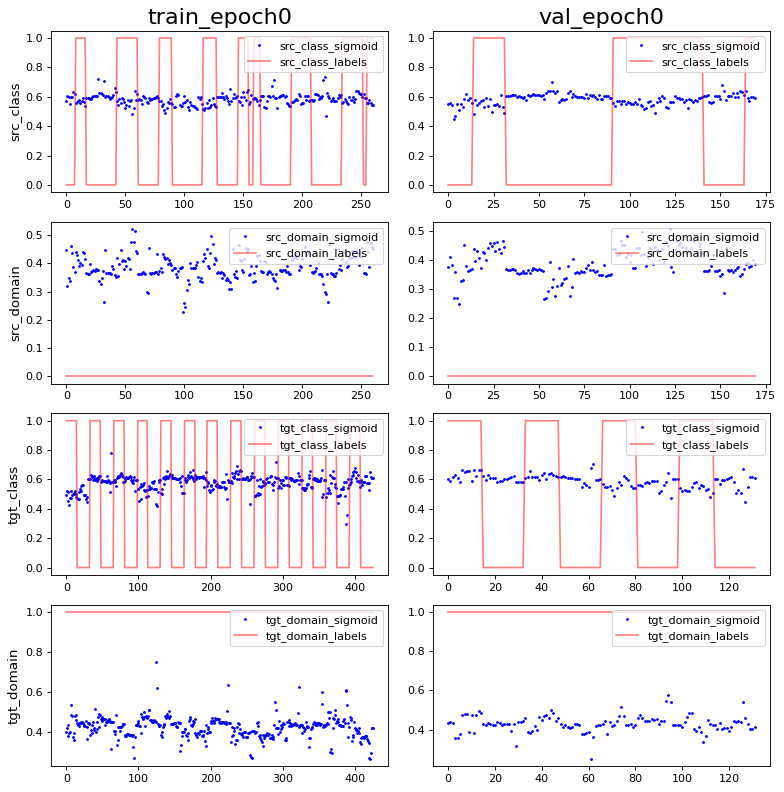

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: 7.7120677e-10 0.9973924
PCA var: [20.7      32.4      41.       45.6      49.5      53.       55.6
 57.899998 59.8      61.6     ]
show standardize mean and std: -7.894655e-10 0.996086
PCA var: [20.7      32.1      40.3      46.399998 51.399998 54.899998 57.999996
 60.899998 63.3      65.6     ]


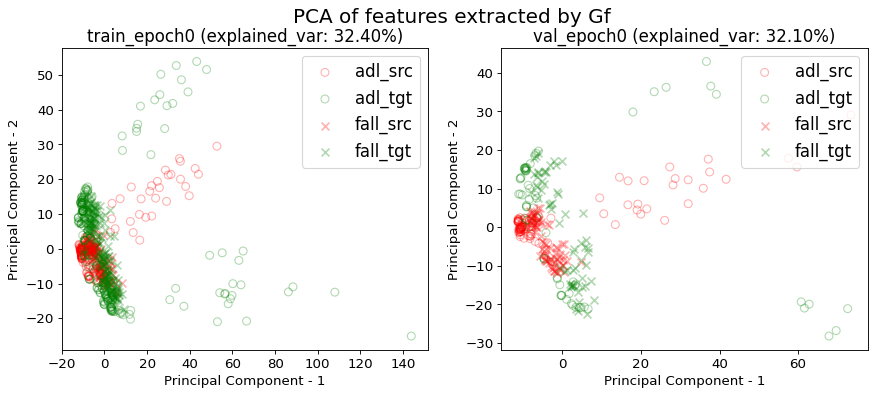

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/


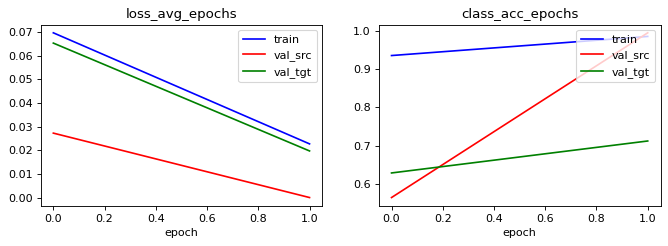

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.9846743295019157 0.09578544061302682 1.1455938697318007 1.5363984674329503
acc performance: 0.9941176470588236 0.10588235294117647 0.5529411764705883 0.7411764705882353


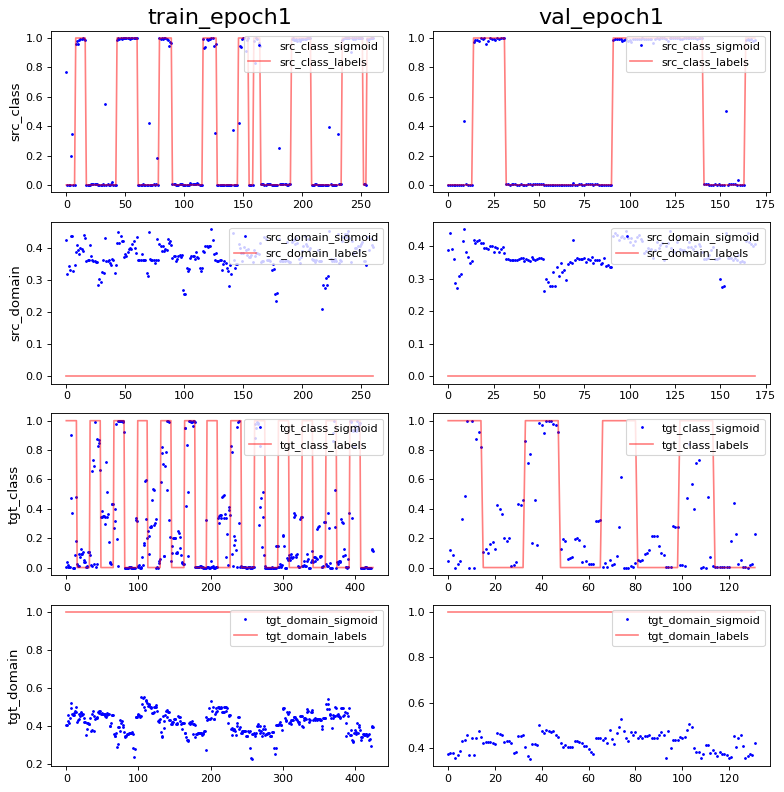

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: -2.7763445e-09 0.9864534
PCA var: [29.699999 46.9      56.300003 61.500004 64.3      66.600006 68.600006
 70.50001  72.100006 73.600006]
show standardize mean and std: 7.017471e-09 0.9776141
PCA var: [25.8      44.4      56.       63.       66.2      69.       71.8
 74.100006 75.90001  77.50001 ]


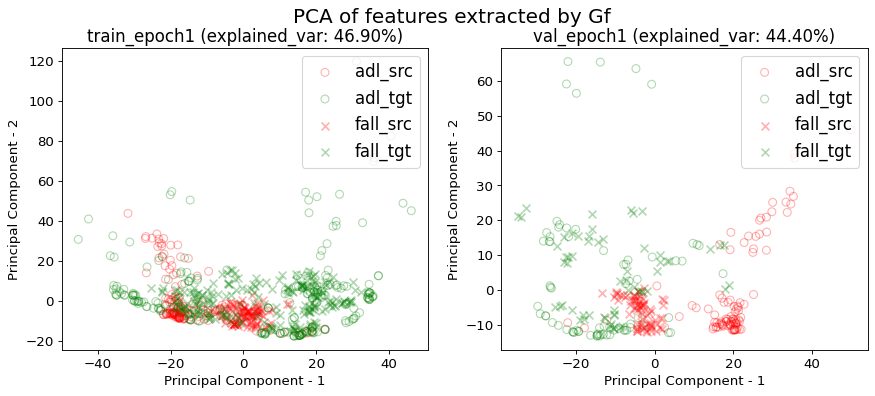

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.44281524926686217 1.0 0.5982404692082112 0.06744868035190615
acc performance: 0.43333333333333335 0.9888888888888889 0.6777777777777778 0.1


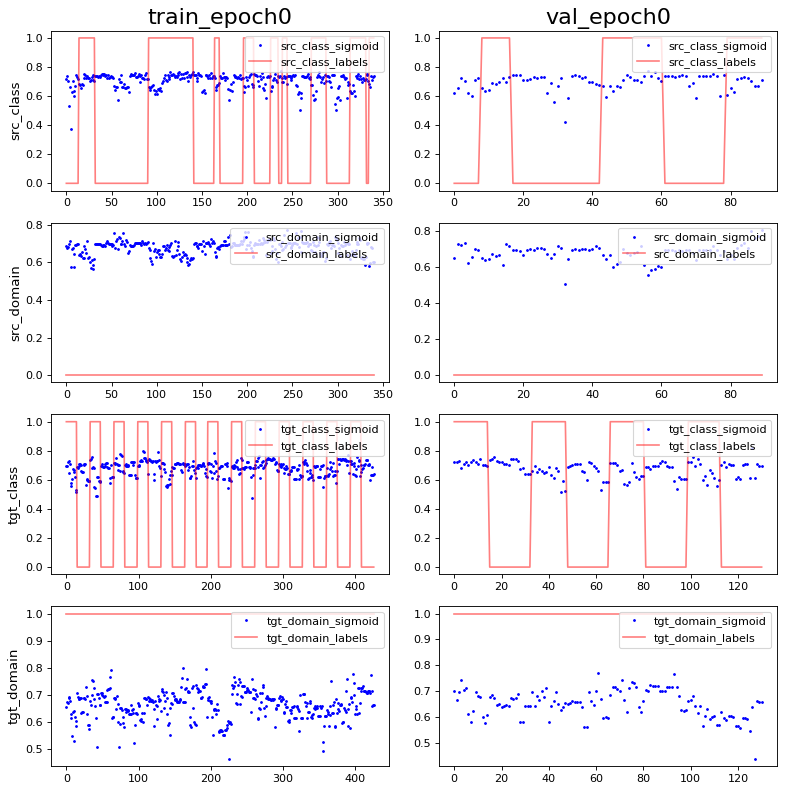

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: -6.8986856e-09 0.9943417
PCA var: [17.3      29.099998 37.8      44.       49.4      52.7      55.9
 58.2      60.2      62.100002]
show standardize mean and std: 6.892443e-10 0.98952854
PCA var: [18.099998 30.8      41.399998 48.1      52.899998 56.699997 60.199997
 62.899998 65.399994 67.899994]


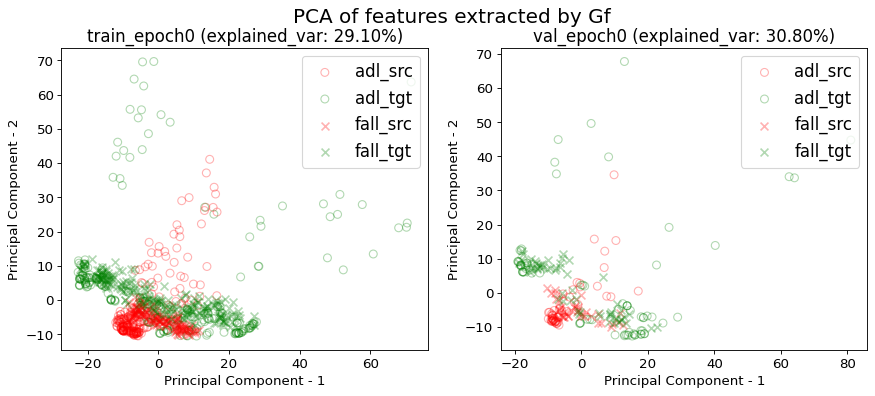

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/


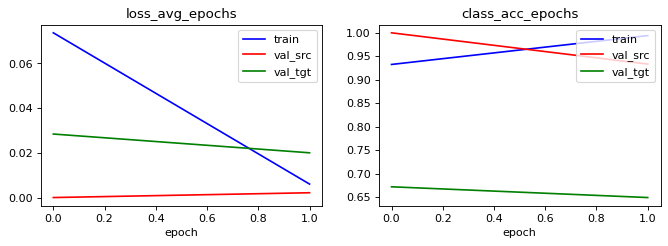

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.967741935483871 0.9941348973607038 0.8504398826979472 0.19648093841642228
acc performance: 0.9333333333333333 0.9888888888888889 0.9444444444444444 0.28888888888888886


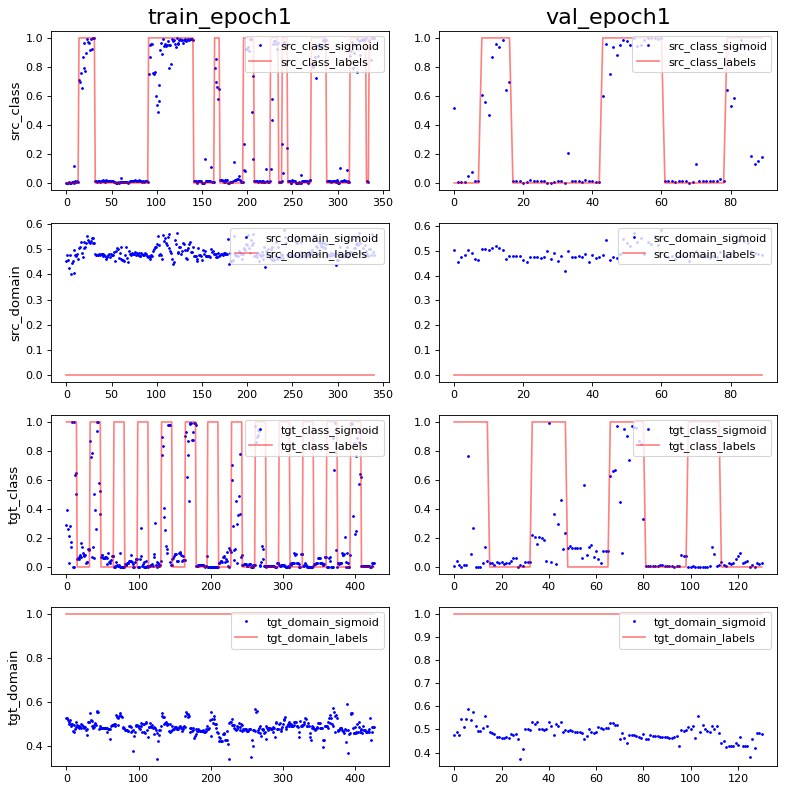

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: -8.278423e-10 0.9917191
PCA var: [33.7 48.4 59.5 64.8 67.4 69.5 71.4 73.3 75.  76.5]
show standardize mean and std: 2.3973714e-09 0.9890898
PCA var: [40.3      56.699997 65.1      69.9      72.5      74.7      76.7
 78.6      80.1      81.6     ]


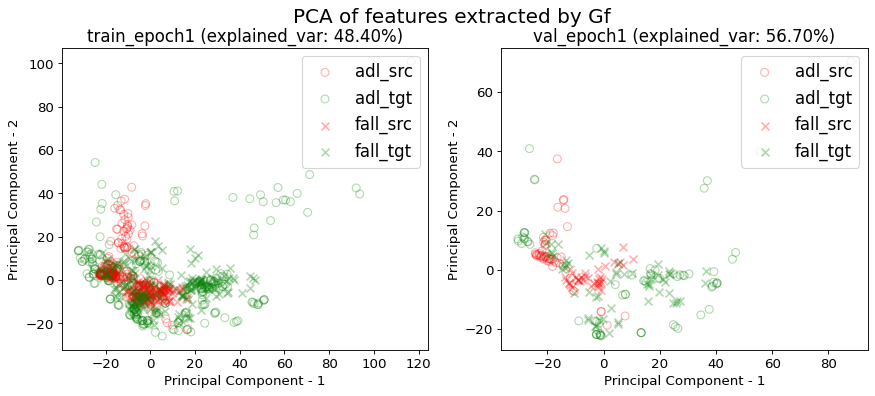

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.022708,0.984674,0.000049,0.994118,0.019722,0.712121
1,1.000000,0.006178,0.994135,0.002305,0.933333,0.020138,0.648855
mean,0.500000,0.014443,0.989405,0.001177,0.963725,0.019930,0.680488
std,0.707107,0.011688,0.006690,0.001595,0.042981,0.000294,0.044736


src val loss: 0.0012±0.0016
src val acc: 0.9637±0.0430
tgt val loss: 0.0199±0.0003
tgt val acc: 0.6805±0.0447
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 431, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UMAFall', 'num_epochs': 2, 'channel_n': 32, 'batch_size': 4, 'learning_rate': 0.01, 'sensor_loc': 'waist', 'date': '2020/04/09 20:08:05', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  train on target, val on target(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_model

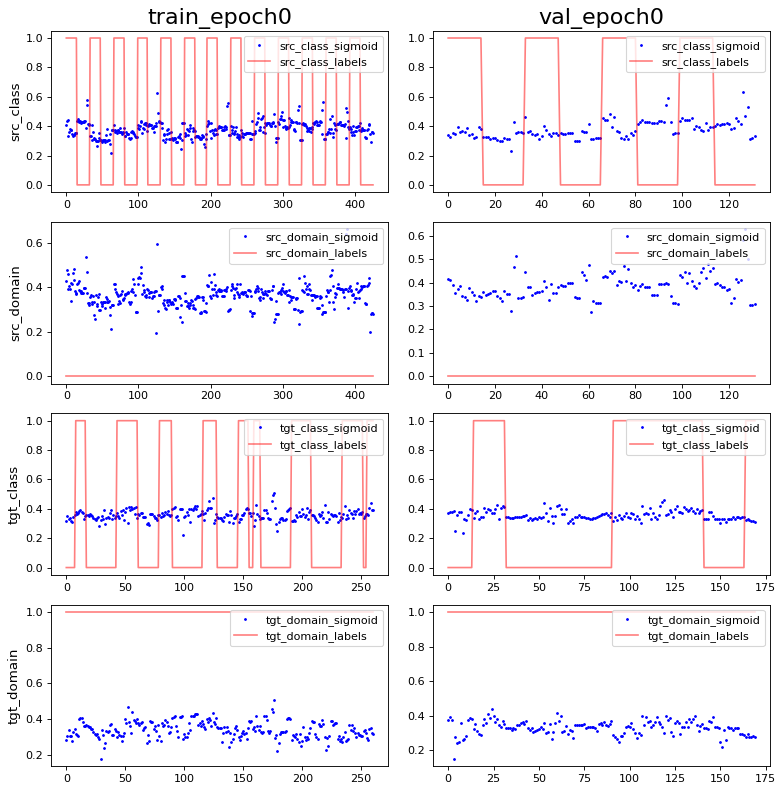

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: 1.5424135e-09 0.99695706
PCA var: [19.6      32.6      41.399998 46.8      50.899998 54.399998 57.1
 59.3      61.3      63.      ]
show standardize mean and std: 4.3859194e-11 0.99477804
PCA var: [18.199999 31.       38.7      45.3      50.7      54.8      58.2
 61.       63.5      65.9     ]


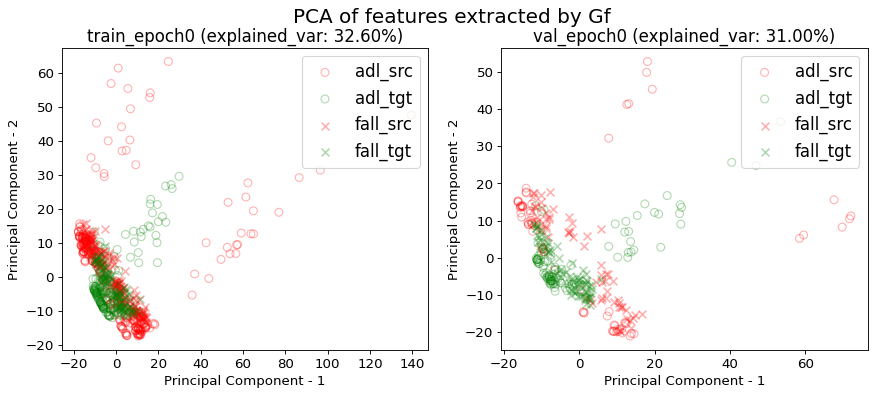

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/


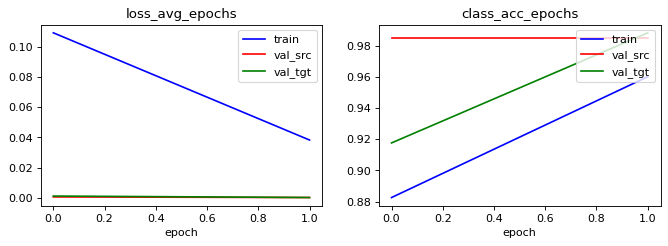

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.9929577464788732 0.035211267605633804 0.5892018779342723 0.607981220657277
acc performance: 0.9848484848484849 0.045454545454545456 1.2727272727272727 1.2727272727272727


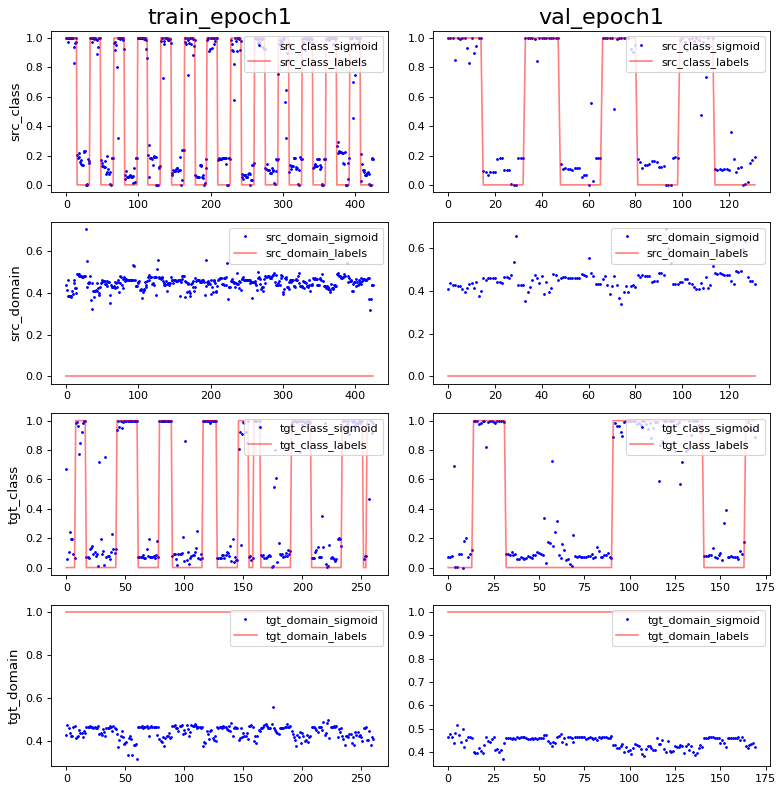

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: -3.084827e-10 0.98115927
PCA var: [28.099998 41.6      50.5      57.6      61.8      64.7      67.1
 69.2      71.2      72.899994]
show standardize mean and std: 6.3595834e-10 0.9780578
PCA var: [27.4      39.9      49.100002 56.600002 60.7      64.3      67.200005
 69.700005 72.200005 74.3     ]


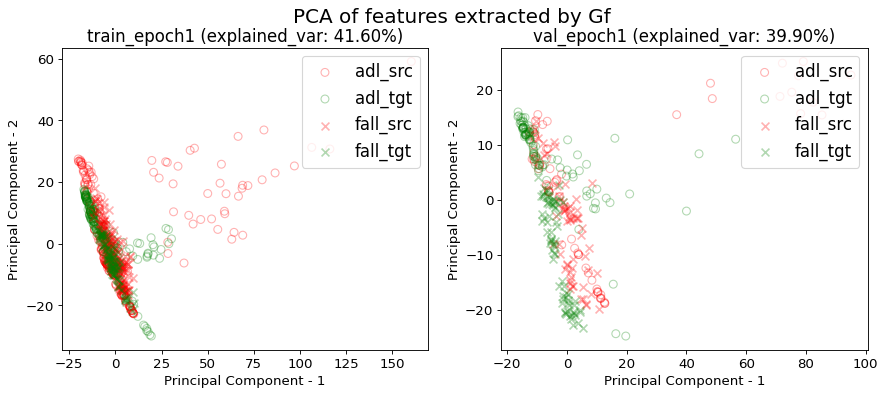

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.6416861826697893 0.0 0.5339578454332553 0.7985948477751756
acc performance: 0.6412213740458015 0.0 0.48091603053435117 0.6870229007633588


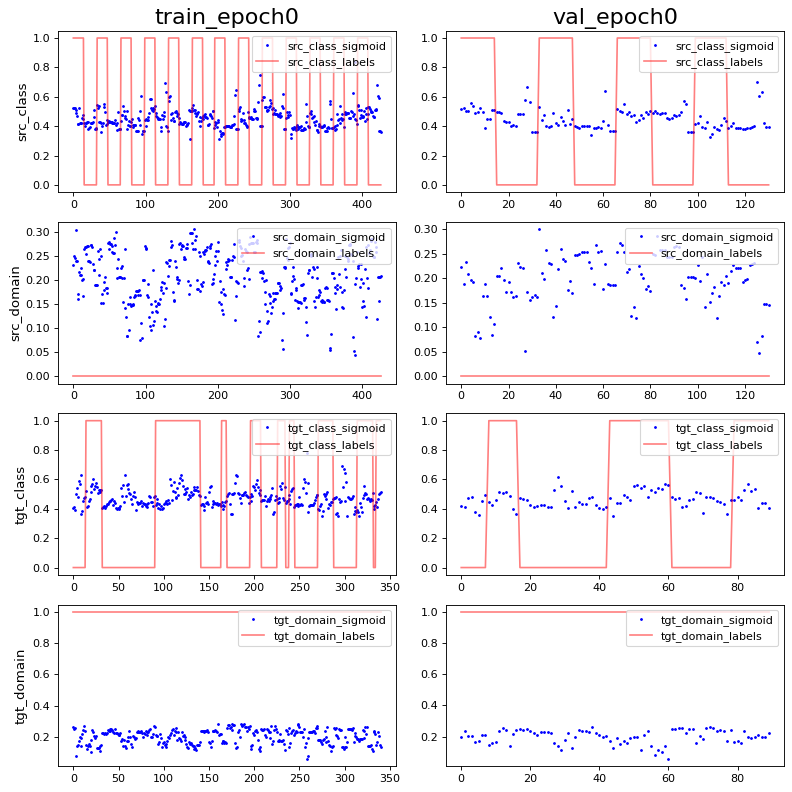

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: 1.7936583e-09 0.9965217
PCA var: [19.1      29.       37.9      43.300003 47.000004 50.100002 52.7
 55.       57.1      59.      ]
show standardize mean and std: -9.589486e-10 0.9939051
PCA var: [20.5      32.1      40.8      46.1      50.699997 54.399998 57.899998
 60.6      63.199997 65.399994]


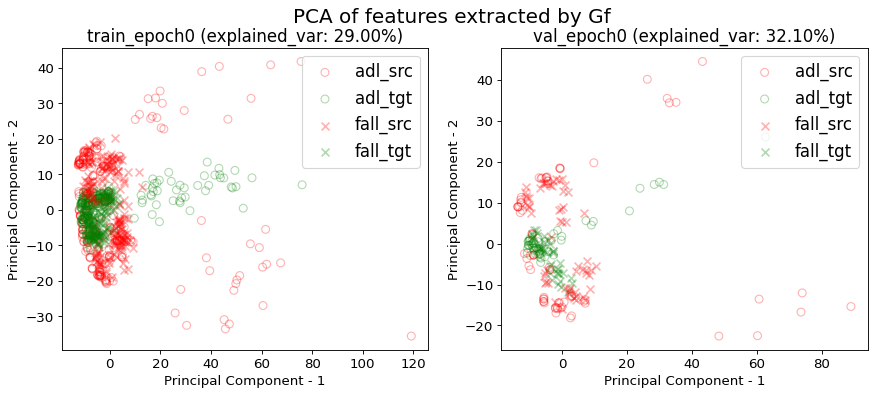

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/


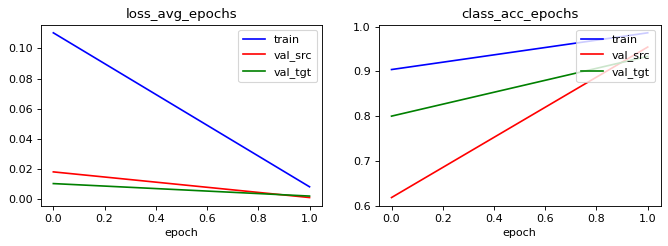

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.9625292740046838 0.6627634660421545 0.7564402810304449 0.18032786885245902
acc performance: 0.9541984732824428 0.5648854961832062 0.6412213740458015 0.09923664122137404


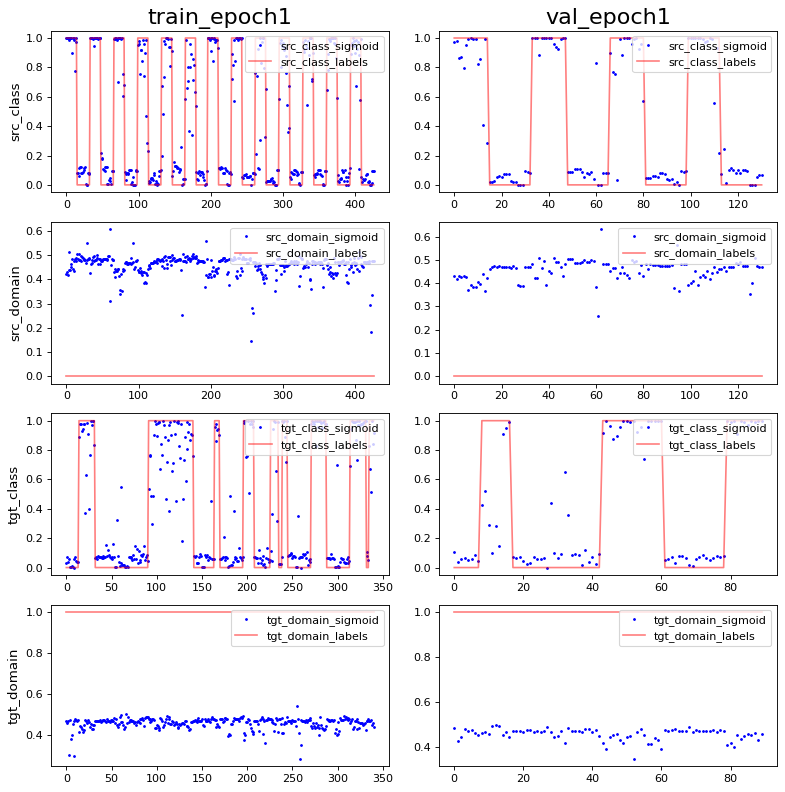

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: -5.5189484e-09 0.95878613
PCA var: [32.5      39.7      45.4      50.       53.4      56.4      59.100002
 61.500004 63.700005 65.700005]
show standardize mean and std: 1.5582914e-09 0.95606613
PCA var: [34.7      43.4      50.300003 55.600002 59.9      63.100002 65.9
 68.5      71.       73.4     ]


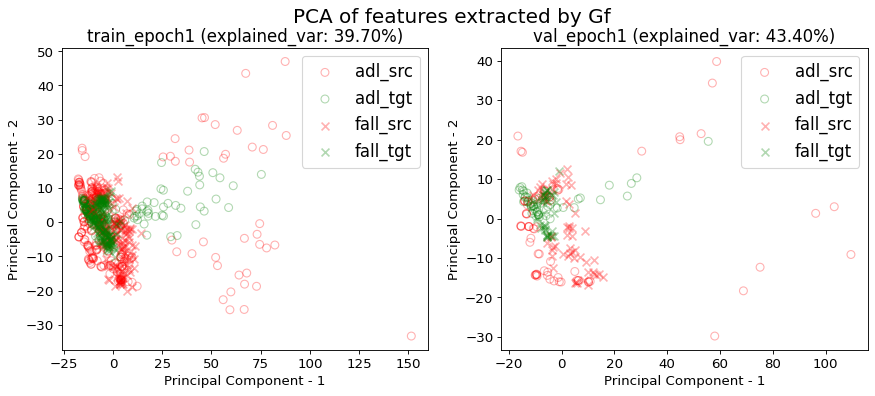

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.038317,0.960094,0.000241,0.984848,0.000261,0.988235
1,1.000000,0.008202,0.985948,0.001080,0.954198,0.002059,0.933333
mean,0.500000,0.023259,0.973021,0.000660,0.969523,0.001160,0.960784
std,0.707107,0.021295,0.018282,0.000593,0.021673,0.001271,0.038822


src val loss: 0.0007±0.0006
src val acc: 0.9695±0.0217
tgt val loss: 0.0012±0.0013
tgt val acc: 0.9608±0.0388
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UPFall', 'num_epochs': 2, 'channel_n': 32, 'batch_size': 4, 'learning_rate': 0.01, 'sensor_loc': 'belt', 'date': '2020/04/09 20:08:20', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  DANN training transferring knowledge(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_m

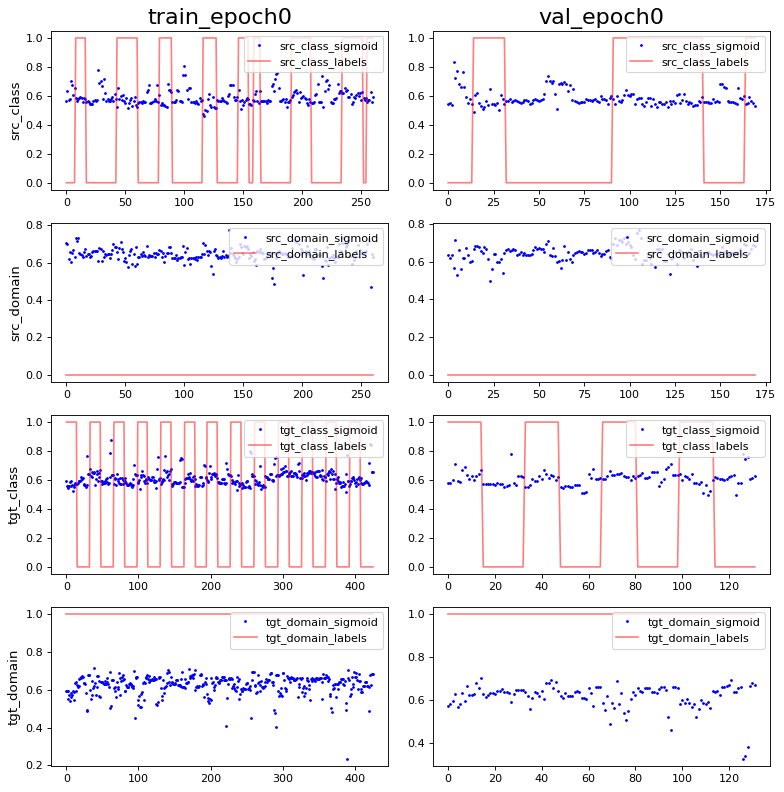

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -4.781482e-09 0.9982624
PCA var: [17.1      28.6      38.       43.7      48.3      51.1      53.6
 55.899998 57.999996 59.999996]
show standardize mean and std: -6.578879e-10 0.9965217
PCA var: [17.6      28.2      37.3      42.9      48.100002 51.9      55.100002
 57.9      60.5      62.8     ]


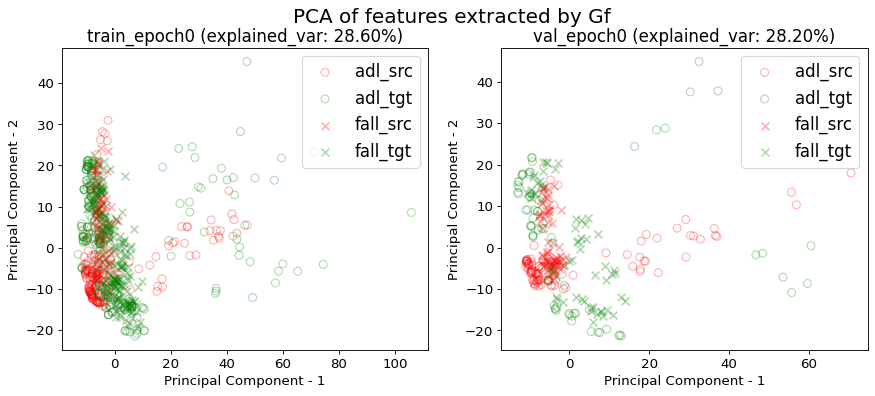

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/


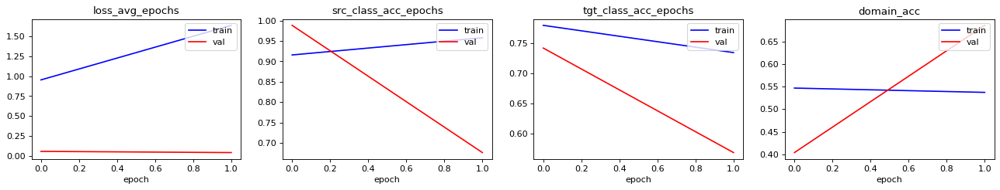

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.7241379310344828 0.5670498084291188 0.9042145593869731 1.1494252873563218
acc performance: 0.6764705882352942 0.5823529411764706 0.4411764705882353 0.6352941176470588


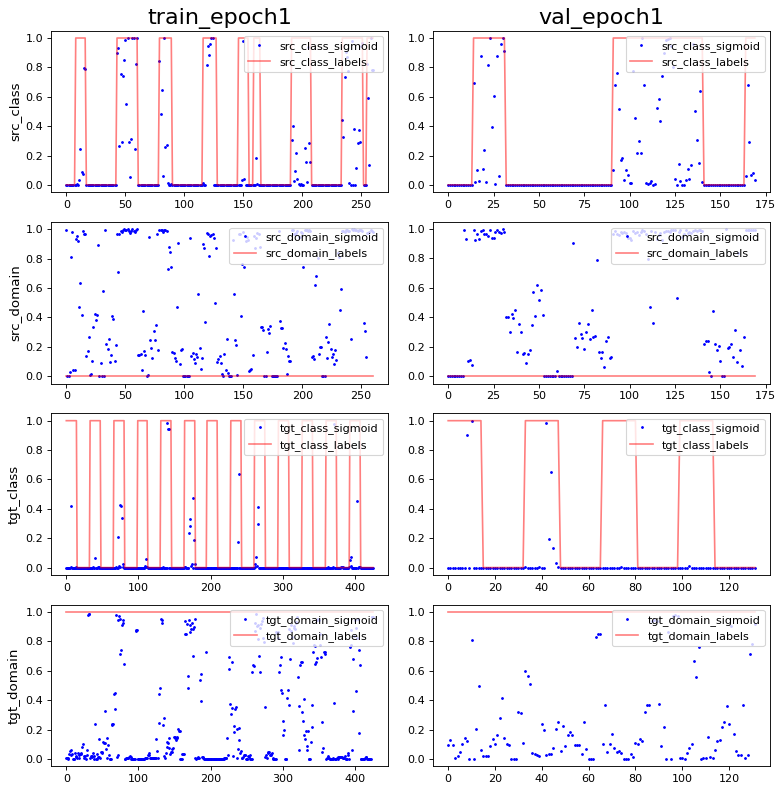

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: 2.390741e-09 0.9973925
PCA var: [30.199999 47.1      55.6      63.199997 66.1      68.7      71.2
 73.399994 75.399994 77.09999 ]
show standardize mean and std: -2.017523e-09 0.9952142
PCA var: [28.099998 44.3      53.8      61.9      66.1      69.799995 73.2
 76.       78.1      79.6     ]


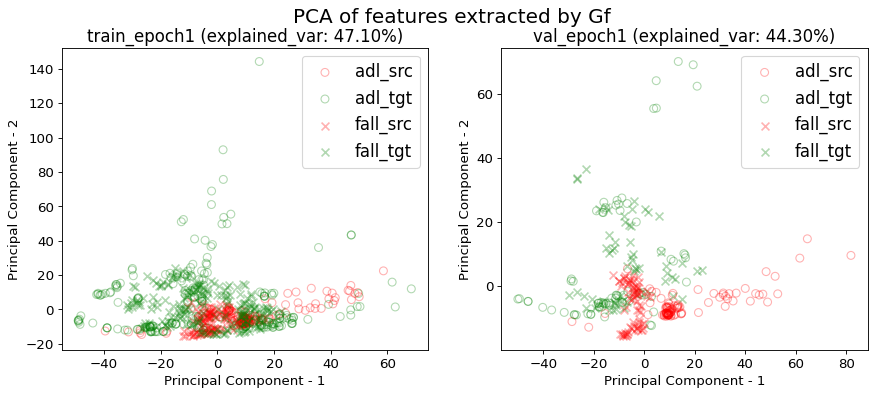

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.17302052785923755 0.8709677419354839 0.5249266862170088 0.2287390029325513
acc performance: 0.17777777777777778 0.8777777777777778 0.5555555555555556 0.35555555555555557


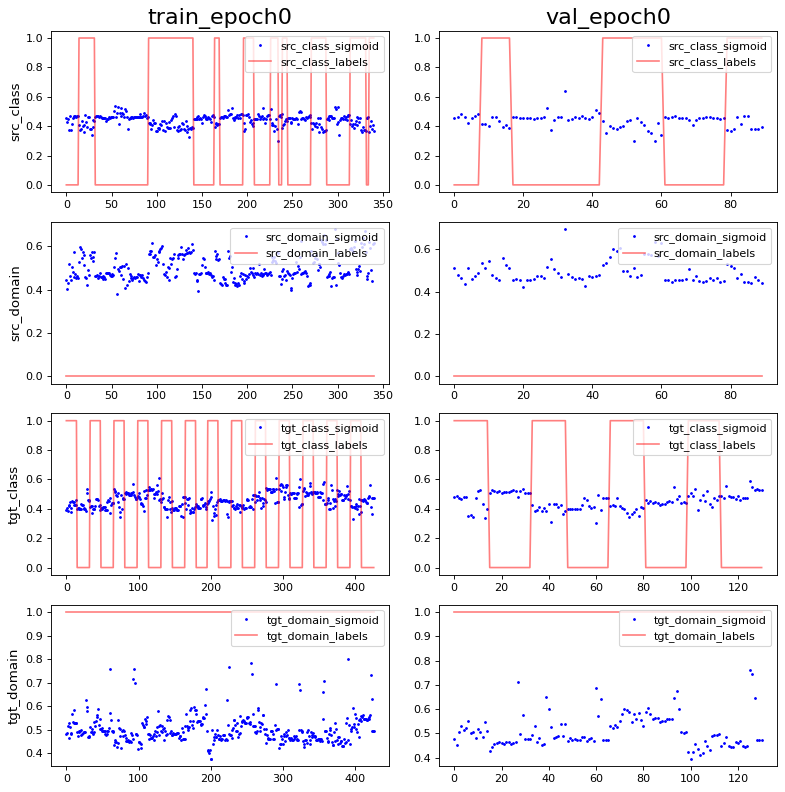

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -2.7594743e-10 0.99782765
PCA var: [16.300001 29.000002 36.7      42.600002 48.300003 51.200005 53.800003
 56.100002 58.000004 59.700005]
show standardize mean and std: 3.596057e-10 0.9956502
PCA var: [18.7      32.6      41.399998 47.899998 52.6      56.199997 59.199997
 61.799995 64.2      66.399994]


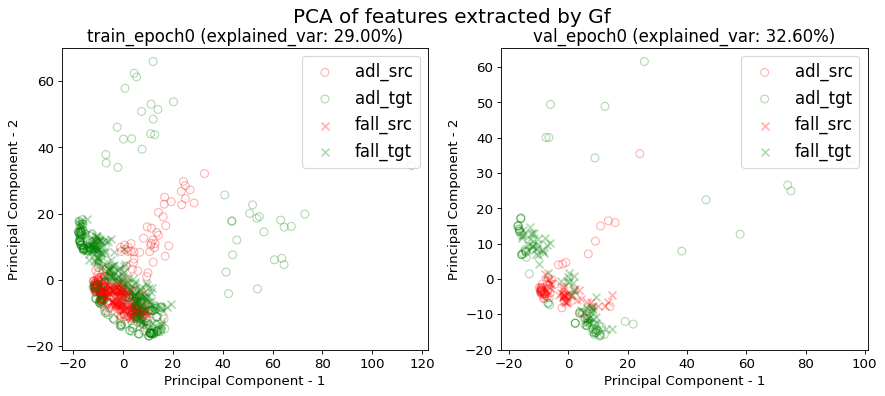

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/


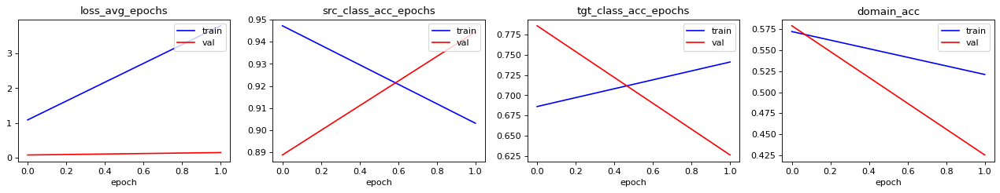

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.9648093841642229 1.0 0.8504398826979472 0.06158357771260997
acc performance: 0.9444444444444444 1.0 0.9111111111111111 0.044444444444444446


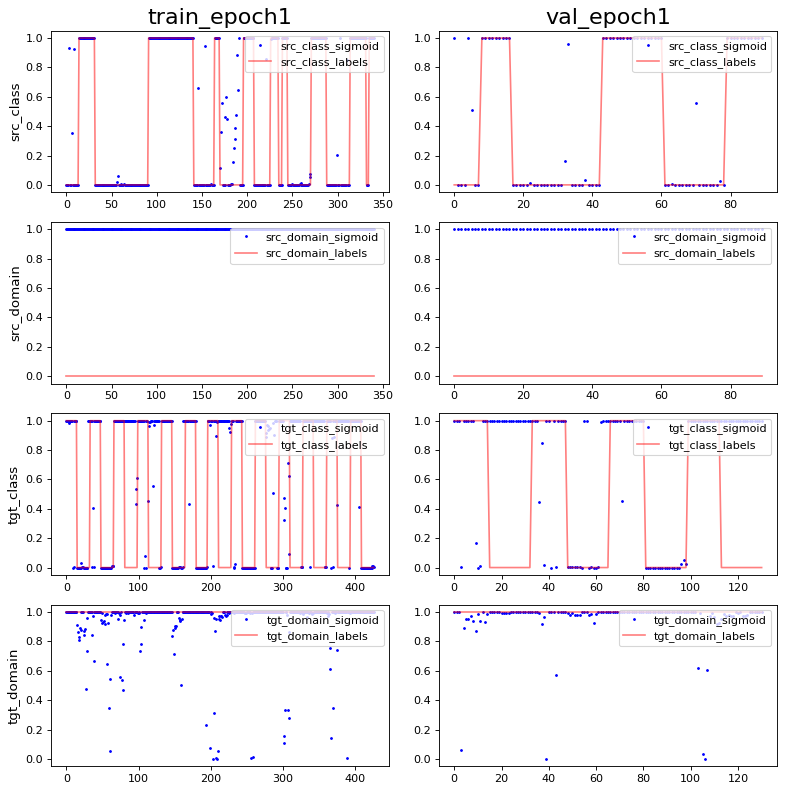

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -1.5177108e-09 0.9943415
PCA var: [31.400002 46.600002 55.600002 62.000004 66.3      69.200005 71.00001
 72.700005 74.3      75.700005]
show standardize mean and std: -4.9146114e-09 0.9934683
PCA var: [36.3      52.4      59.100002 65.4      69.8      72.8      75.100006
 77.200005 79.00001  80.700005]


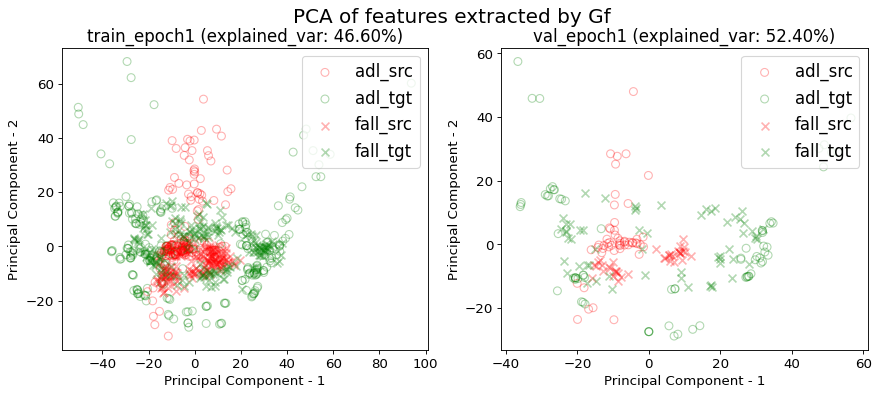

---------------Exporting model performance---------------
show df_performance


,i_CV,train_src_class_loss,train_tgt_class_loss,train_src_domain_loss,train_tgt_domain_loss,train_src_class_acc,train_tgt_class_acc,train_domain_acc,val_src_class_loss,val_tgt_class_loss,val_src_domain_loss,val_tgt_domain_loss,val_src_class_acc,val_tgt_class_acc,val_domain_acc
0,0.000000,0.086014,1.400325,0.775671,0.773833,0.957854,0.734848,0.537143,0.012931,0.130010,0.024542,0.006543,0.676471,0.568182,0.685430
1,1.000000,0.258897,1.487739,1.899373,1.637053,0.903226,0.741279,0.521168,0.004637,0.083061,0.000000,0.145772,0.944444,0.625954,0.425339
mean,0.500000,0.172456,1.444032,1.337522,1.205443,0.930540,0.738064,0.529155,0.008784,0.106535,0.012271,0.076157,0.810458,0.597068,0.555385
std,0.707107,0.122247,0.061811,0.794578,0.610389,0.038628,0.004547,0.011296,0.005865,0.033198,0.017354,0.098450,0.189486,0.040851,0.183912


val_src_class_acc: 0.8105±0.1895
val_tgt_class_acc: 0.5971±0.0409
val_domain_acc: 0.5554±0.1839
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 431, 'classes_n': 2, 'model_name': 'DannModel', 'src_dataset_name': 'UMAFall', 'tgt_dataset_name': 'UPFall', 'src_sensor_loc': 'waist', 'tgt_sensor_loc': 'belt', 'date': '2020/04/09 20:08:35', 'num_epochs': 2, 'channel_n': 32, 'batch_size': 4, 'learning_rate': 0.01, 'input_dim': (4, 3, 66), 'output_dim': 2, 'label_dim': (4,)}
val_tgt_class_acc: 0.5971±0.0409
val_domain_acc: 0.5554±0.1839
time elapsed: 00:00:43

======================  train on source, val on target(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_to

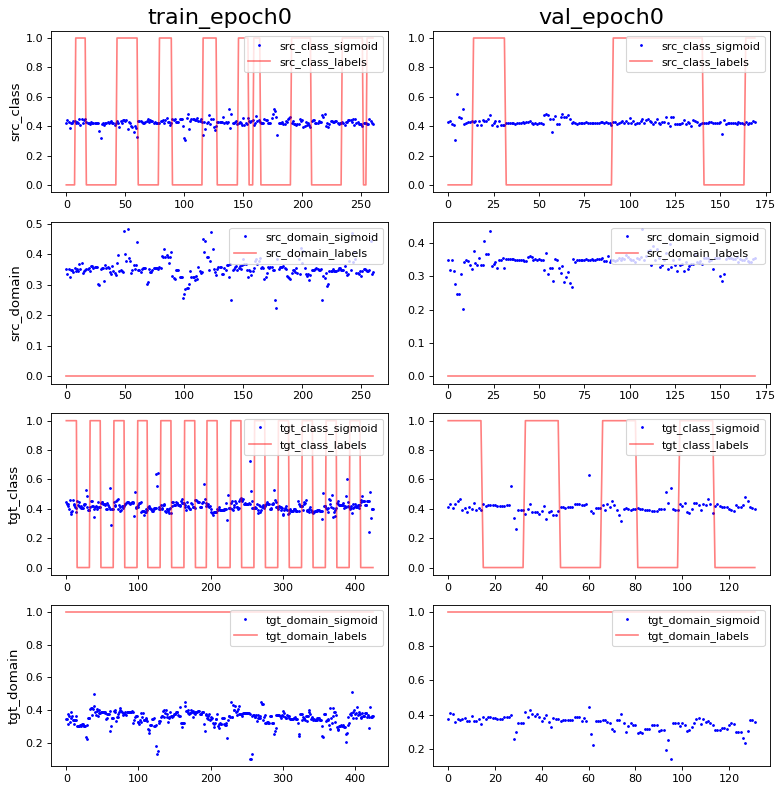

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: -6.169654e-10 0.9965218
PCA var: [34.6      46.199997 51.499996 56.599995 59.999996 62.899998 65.5
 67.8      70.       71.9     ]
show standardize mean and std: -1.4034942e-09 0.9965218
PCA var: [34.4      44.300003 50.500004 55.600002 59.600002 63.500004 66.8
 69.3      71.600006 73.700005]


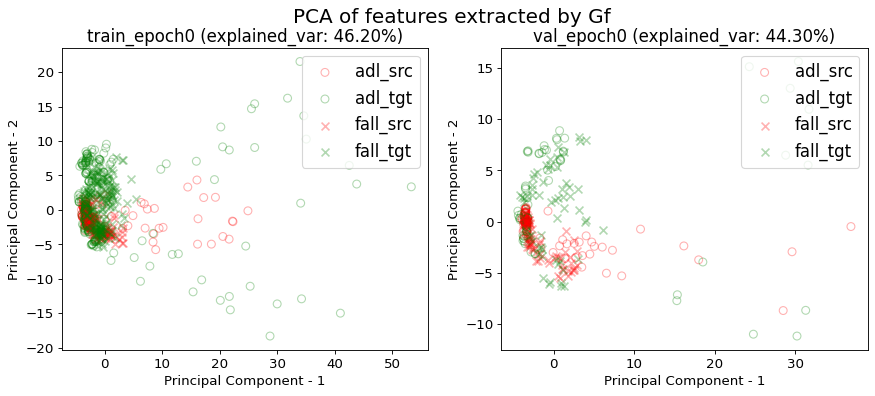

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/


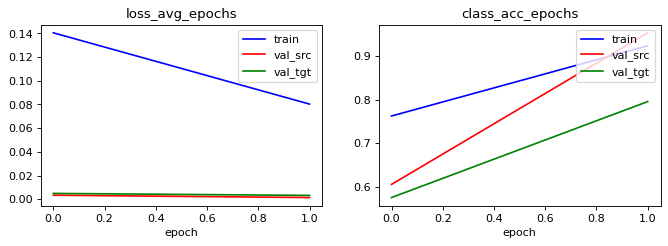

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.9655172413793104 0.10727969348659004 1.2567049808429118 1.421455938697318
acc performance: 0.9529411764705882 0.03529411764705882 0.6176470588235294 0.6882352941176471


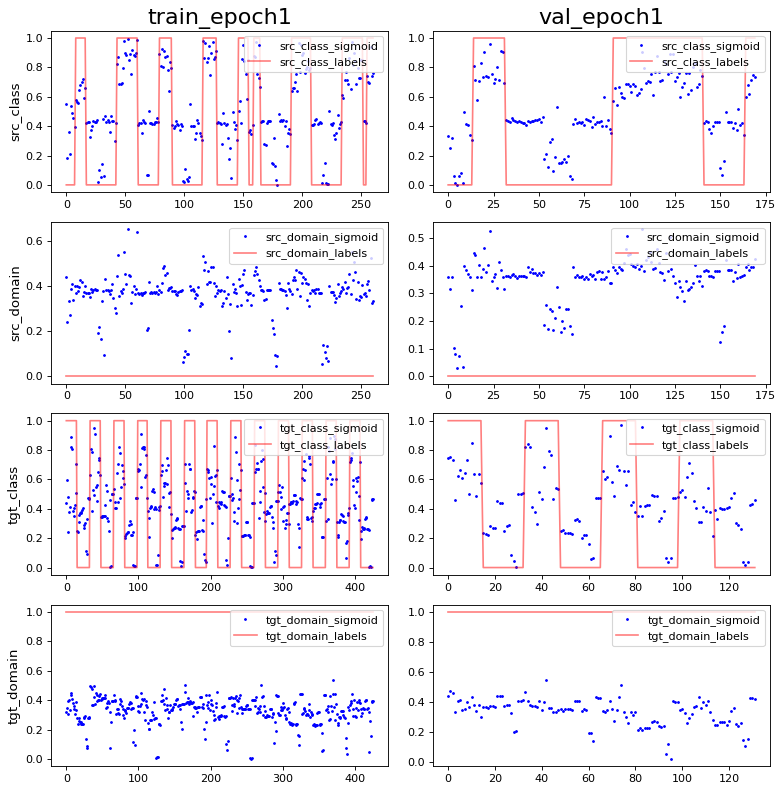

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: 3.3933099e-09 1.0
PCA var: [37.       54.7      59.4      63.2      66.6      69.4      71.700005
 73.8      75.5      77.      ]
show standardize mean and std: 4.2104826e-09 1.0
PCA var: [36.199997 52.6      58.5      62.6      66.1      69.1      71.7
 73.899994 75.99999  77.99999 ]


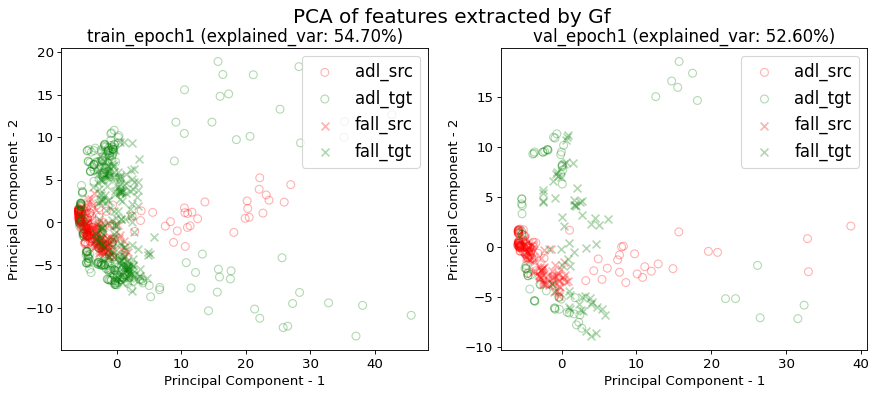

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.5806451612903226 0.0 0.6832844574780058 1.252199413489736
acc performance: 0.6 0.0 0.8 1.4555555555555555


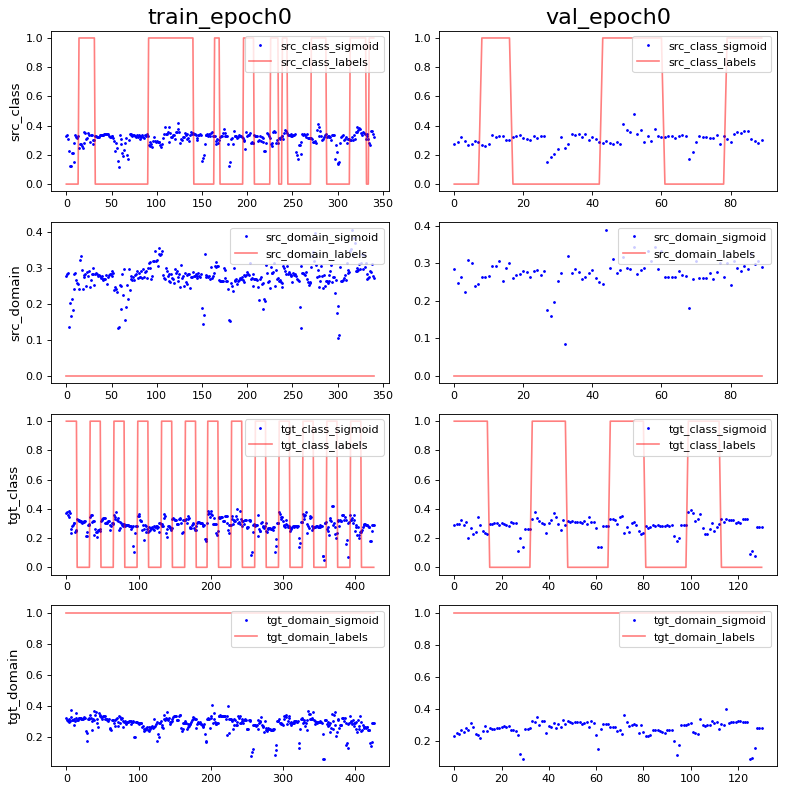

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: 1.6556846e-09 0.99303126
PCA var: [22.       36.9      45.4      52.100002 57.2      60.8      63.899998
 66.799995 68.99999  70.99999 ]
show standardize mean and std: 1.9178972e-09 0.98952854
PCA var: [23.9 38.  47.8 55.8 62.8 66.3 69.4 71.9 74.1 76.2]


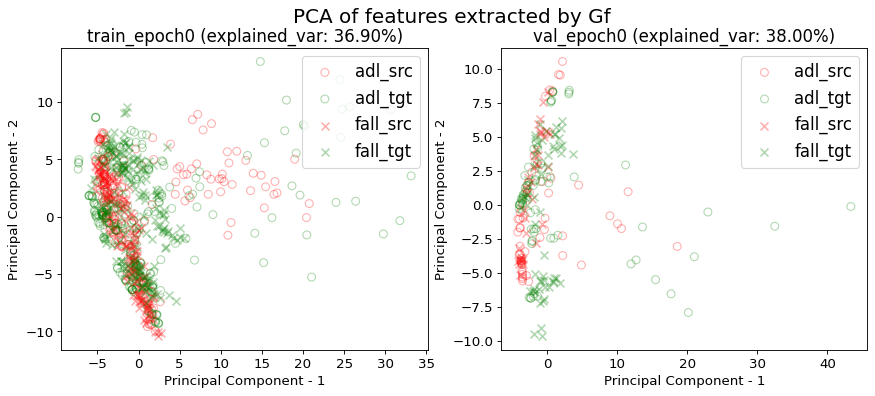

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/


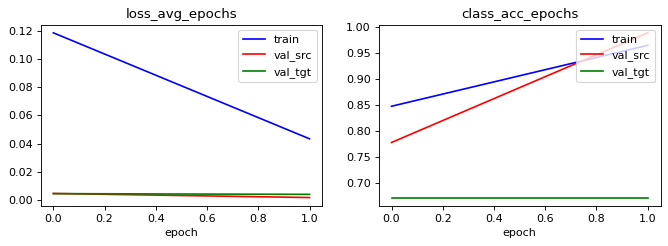

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.9882697947214076 0.03225806451612903 0.8387096774193549 1.0703812316715542
acc performance: 0.9888888888888889 0.03333333333333333 0.9777777777777777 1.3222222222222222


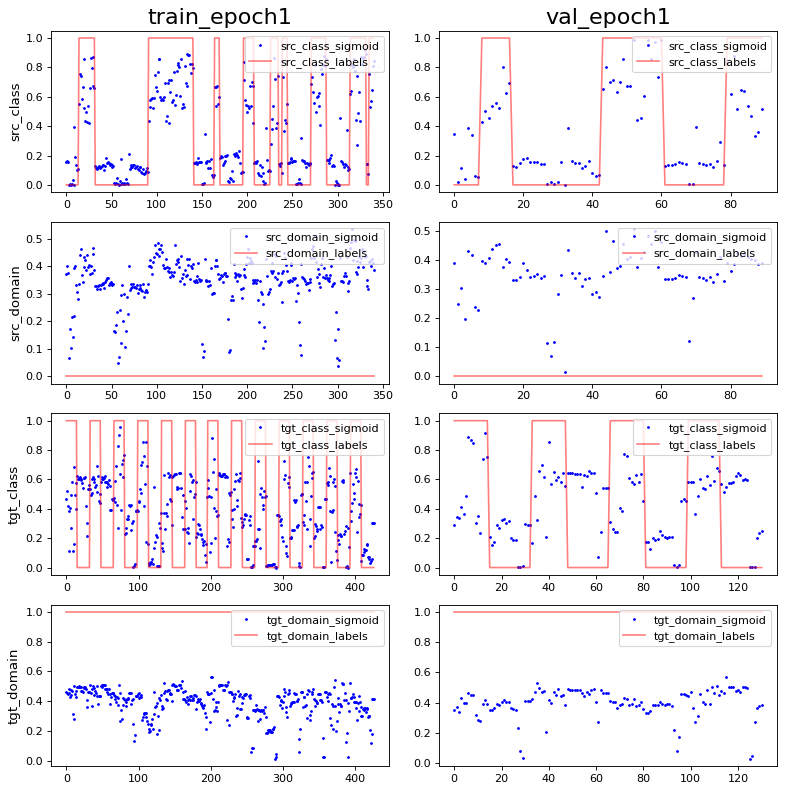

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: 4.967054e-09 0.99303126
PCA var: [31.600002 44.4      52.100002 57.800003 62.600002 67.       70.
 72.6      74.5      76.4     ]
show standardize mean and std: 0.0 0.98952854
PCA var: [31.600002 48.2      56.5      62.5      67.2      71.2      74.399994
 77.2      79.799995 81.899994]


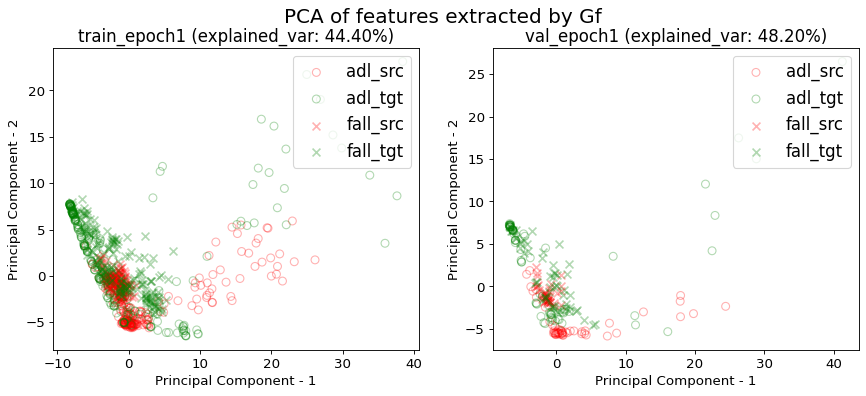

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.080322,0.923372,0.001416,0.952941,0.003206,0.795455
1,1.000000,0.043337,0.964809,0.001678,0.988889,0.003931,0.671756
mean,0.500000,0.061830,0.944091,0.001547,0.970915,0.003569,0.733605
std,0.707107,0.026152,0.029301,0.000185,0.025419,0.000513,0.087468


src val loss: 0.0015±0.0002
src val acc: 0.9709±0.0254
tgt val loss: 0.0036±0.0005
tgt val acc: 0.7336±0.0875
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 431, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UMAFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.001, 'sensor_loc': 'waist', 'date': '2020/04/09 20:08:49', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  train on target, val on target(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modelout

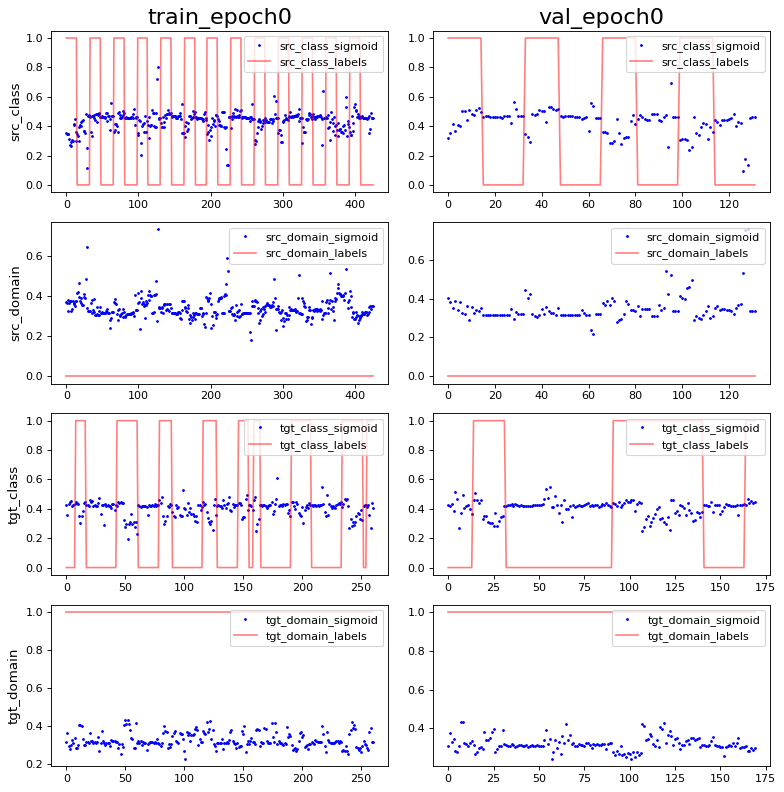

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: 2.1593791e-09 0.9965217
PCA var: [29.800001 44.5      51.       56.4      60.300003 64.200005 67.600006
 70.200005 72.3      74.200005]
show standardize mean and std: -2.8069884e-09 0.9965217
PCA var: [25.7      42.4      50.7      56.4      60.9      65.200005 68.8
 71.3      73.5      75.6     ]


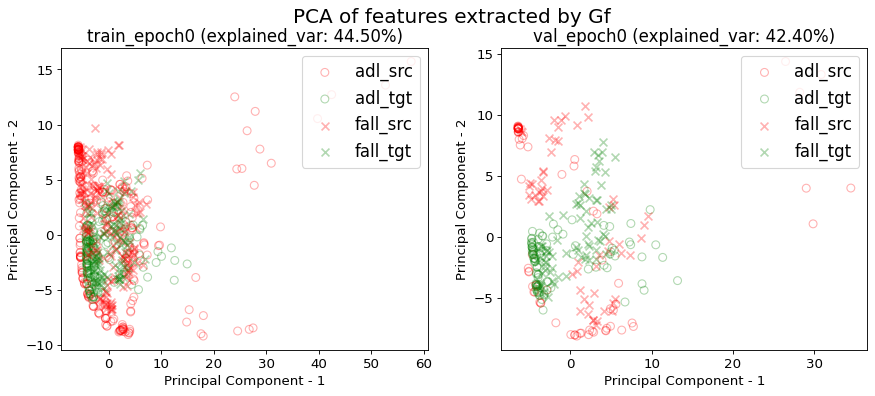

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/


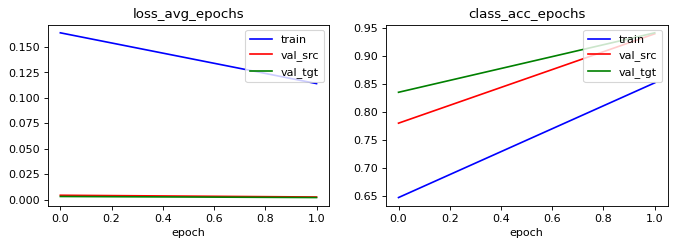

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.9671361502347418 0.3474178403755869 0.5892018779342723 0.5
acc performance: 0.9393939393939394 0.3712121212121212 1.2121212121212122 1.0378787878787878


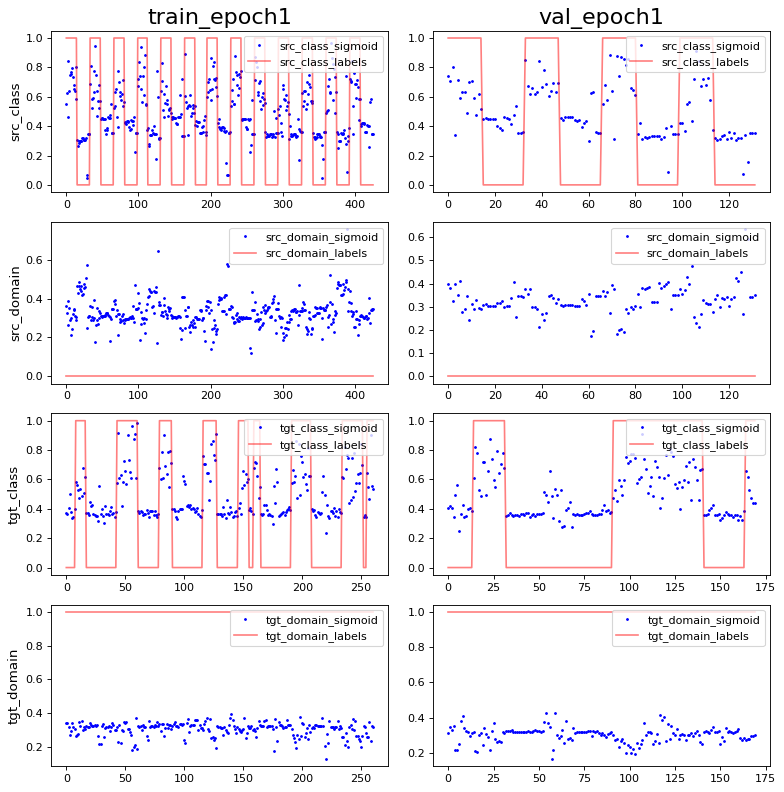

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: -5.321327e-09 0.9965218
PCA var: [33.899998 49.1      55.6      59.899998 63.899998 67.1      69.7
 72.       74.1      75.9     ]
show standardize mean and std: -1.1227954e-08 0.9965218
PCA var: [30.000002 47.       53.3      58.7      63.5      67.       70.3
 73.3      75.5      77.2     ]


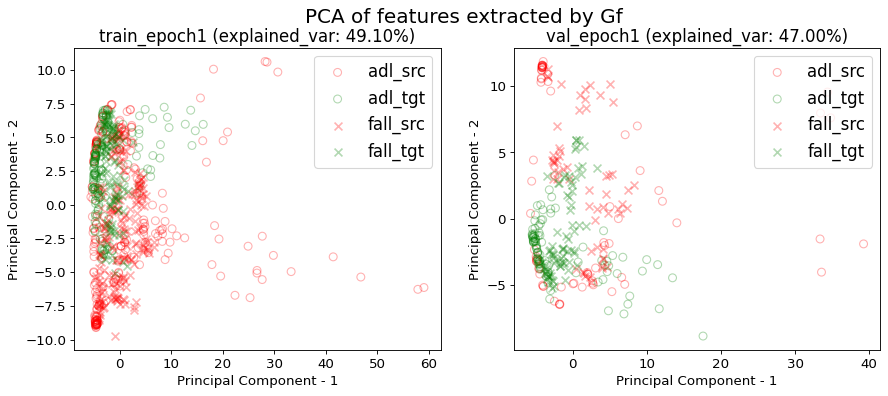

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.5409836065573771 0.0 0.46604215456674475 0.7985948477751756
acc performance: 0.5419847328244275 0.0 0.3969465648854962 0.6870229007633588


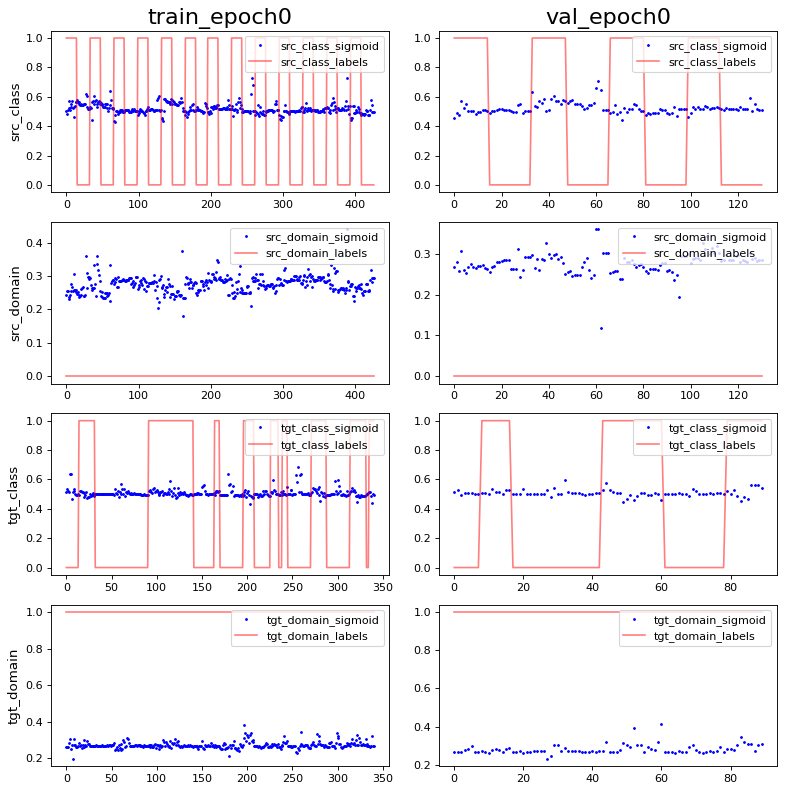

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: 0.0 0.9965217
PCA var: [25.9      35.6      43.       47.6      51.8      55.3      58.1
 60.899998 63.499996 65.7     ]
show standardize mean and std: -4.794743e-09 0.9965218
PCA var: [25.       37.       45.7      52.3      58.3      62.399998 66.1
 69.5      72.4      74.9     ]


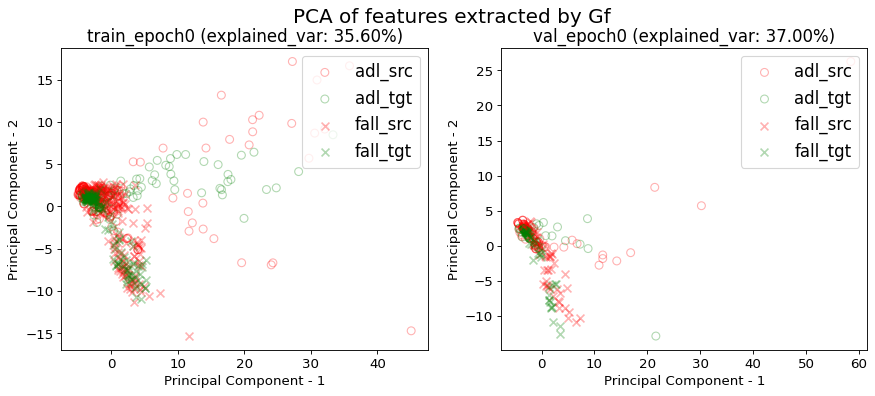

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/


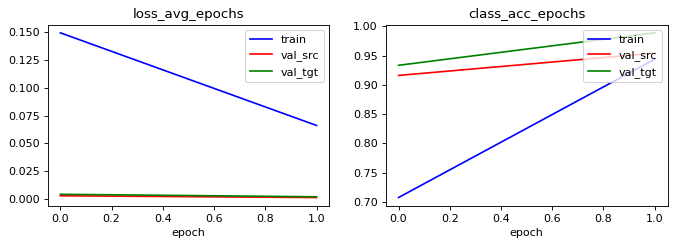

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.9648711943793911 0.00702576112412178 0.7142857142857143 0.7962529274004684
acc performance: 0.9541984732824428 0.0 0.6793893129770993 0.6870229007633588


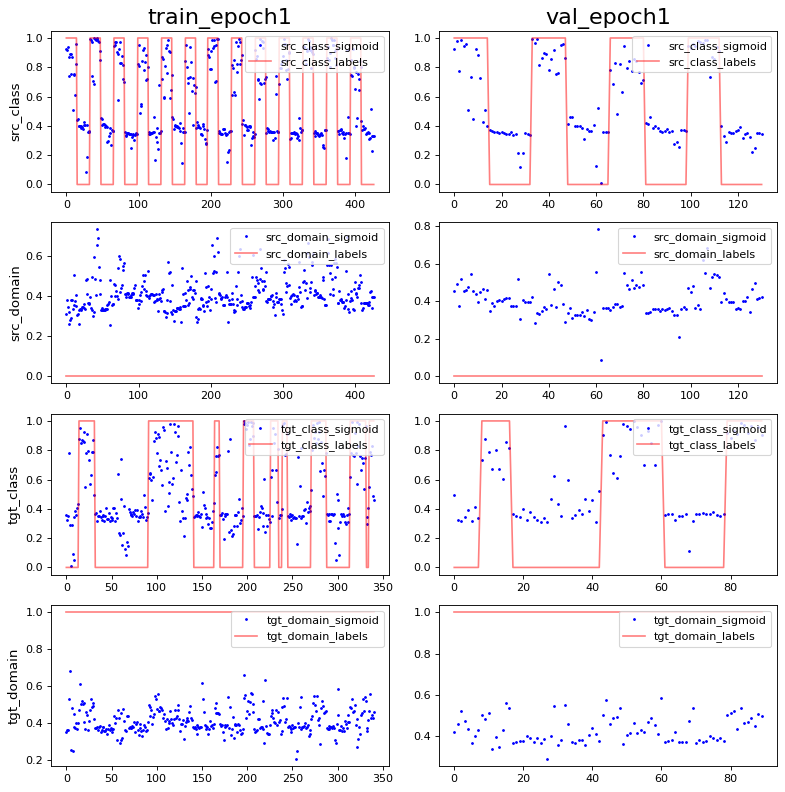

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: -2.345553e-09 1.0
PCA var: [32.       41.8      49.       54.8      58.899998 62.399998 65.5
 68.5      70.7      72.799995]
show standardize mean and std: 0.0 1.0
PCA var: [28.099998 39.399998 48.       55.       60.       64.       67.9
 71.3      74.200005 76.50001 ]


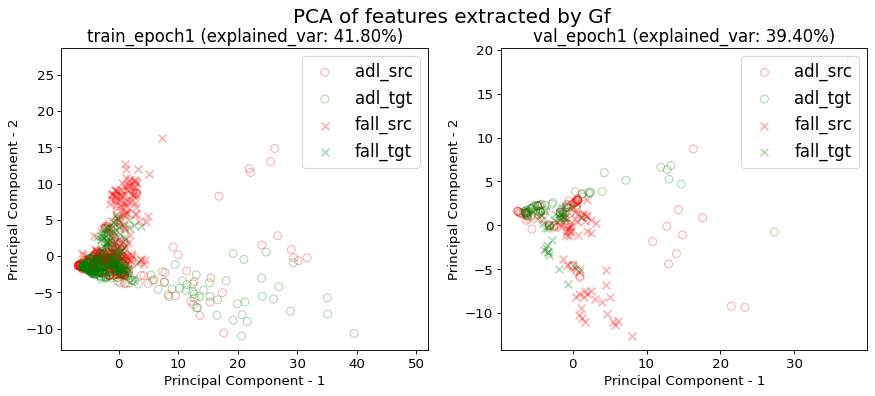

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.114090,0.852113,0.002523,0.939394,0.002001,0.941176
1,1.000000,0.066109,0.943794,0.001227,0.954198,0.001911,0.988889
mean,0.500000,0.090099,0.897953,0.001875,0.946796,0.001956,0.965033
std,0.707107,0.033927,0.064828,0.000916,0.010468,0.000063,0.033738


src val loss: 0.0019±0.0009
src val acc: 0.9468±0.0105
tgt val loss: 0.0020±0.0001
tgt val acc: 0.9650±0.0337
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UPFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.001, 'sensor_loc': 'belt', 'date': '2020/04/09 20:09:03', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  DANN training transferring knowledge(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_mode

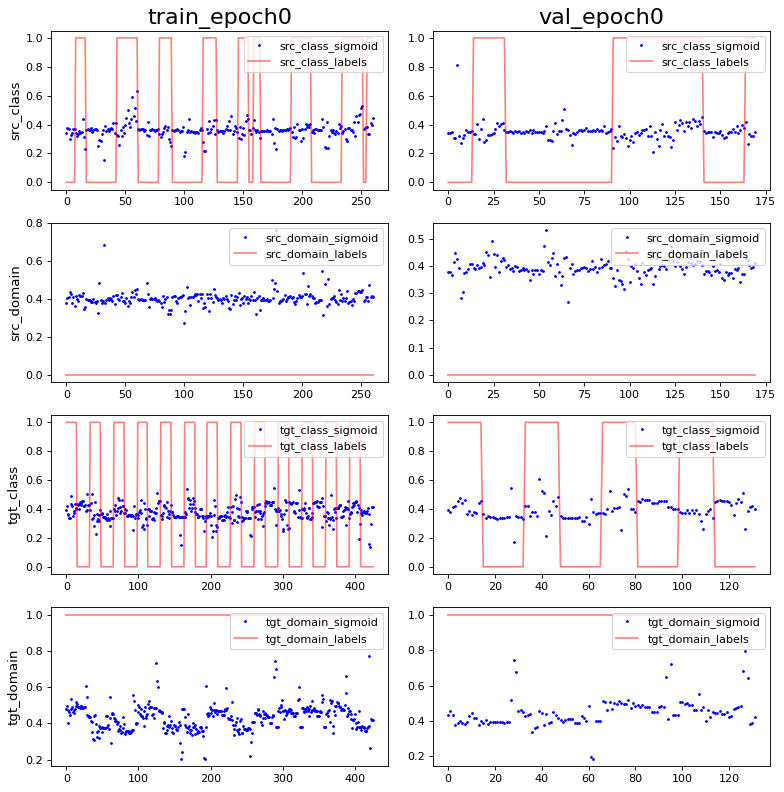

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: 3.084827e-10 0.9999999
PCA var: [30.7      40.9      47.100002 52.9      57.600002 61.4      64.5
 67.3      69.600006 71.40001 ]
show standardize mean and std: -2.8069884e-09 1.0
PCA var: [29.499998 38.399998 45.199997 50.999996 55.399998 59.699997 63.6
 67.1      69.6      72.      ]


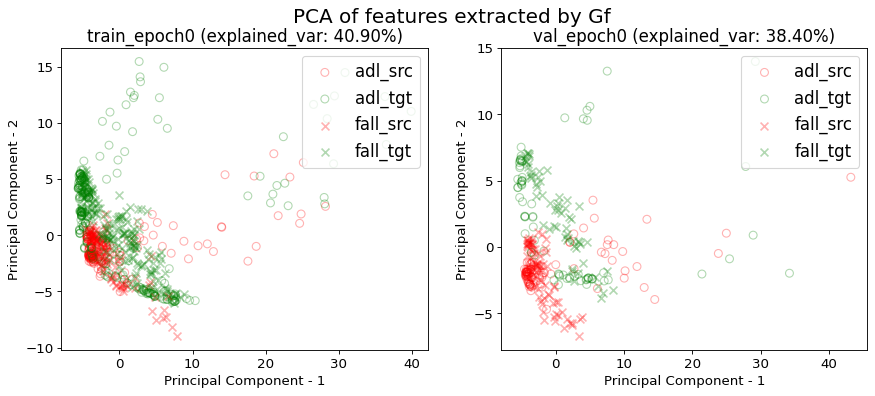

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/


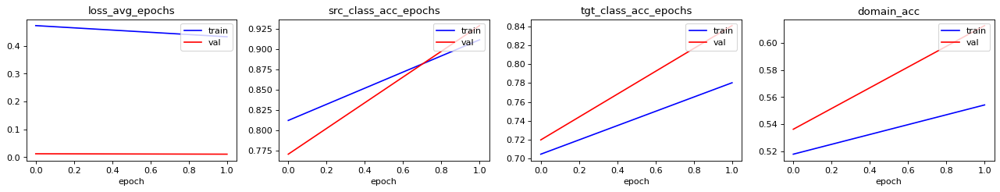

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.9731800766283525 0.524904214559387 1.3908045977011494 1.318007662835249
acc performance: 0.9294117647058824 0.4764705882352941 0.6529411764705882 0.611764705882353


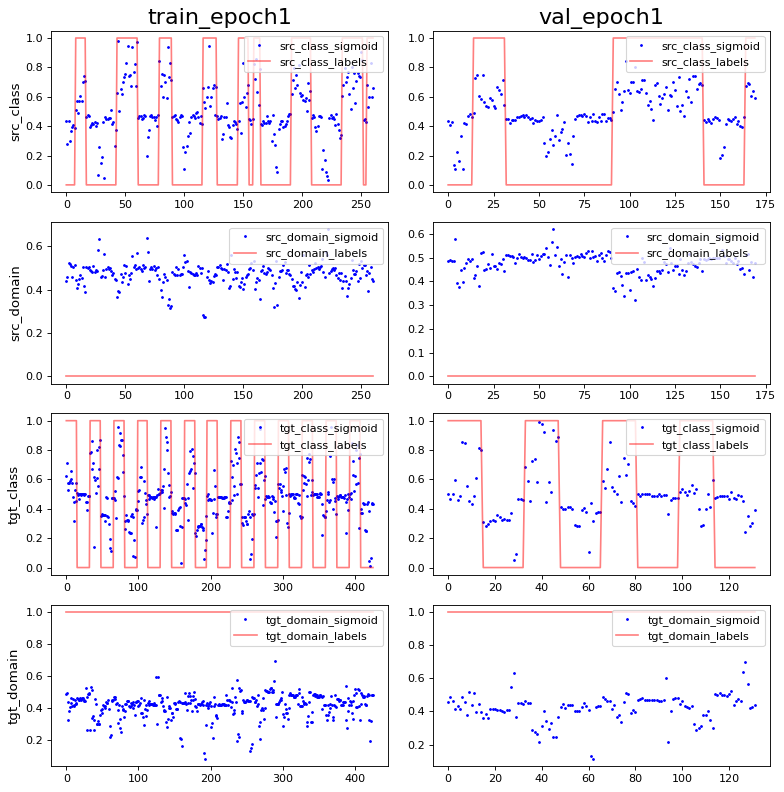

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: 6.7866197e-09 0.99999994
PCA var: [31.5      41.7      48.       53.8      58.5      62.       65.
 67.4      69.700005 71.700005]
show standardize mean and std: -4.2104826e-09 1.0
PCA var: [30.000002 39.100002 46.300003 52.500004 57.400005 61.500004 65.3
 68.5      71.1      73.299995]


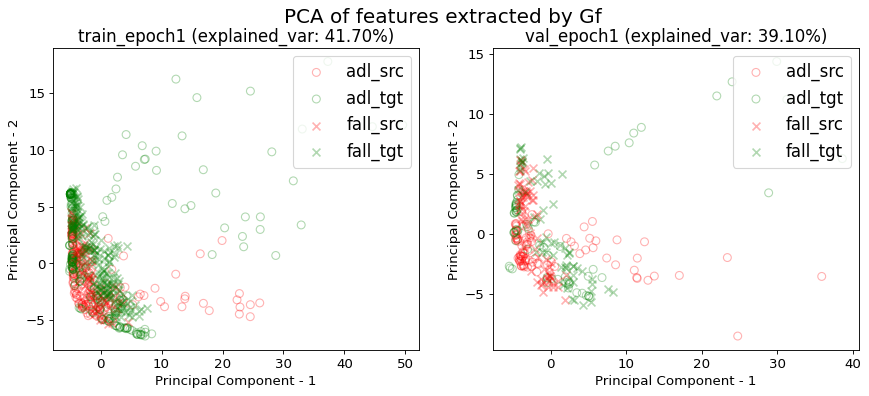

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.533724340175953 0.9384164222873901 0.5835777126099707 0.09970674486803519
acc performance: 0.5666666666666667 0.9111111111111111 0.6 0.1


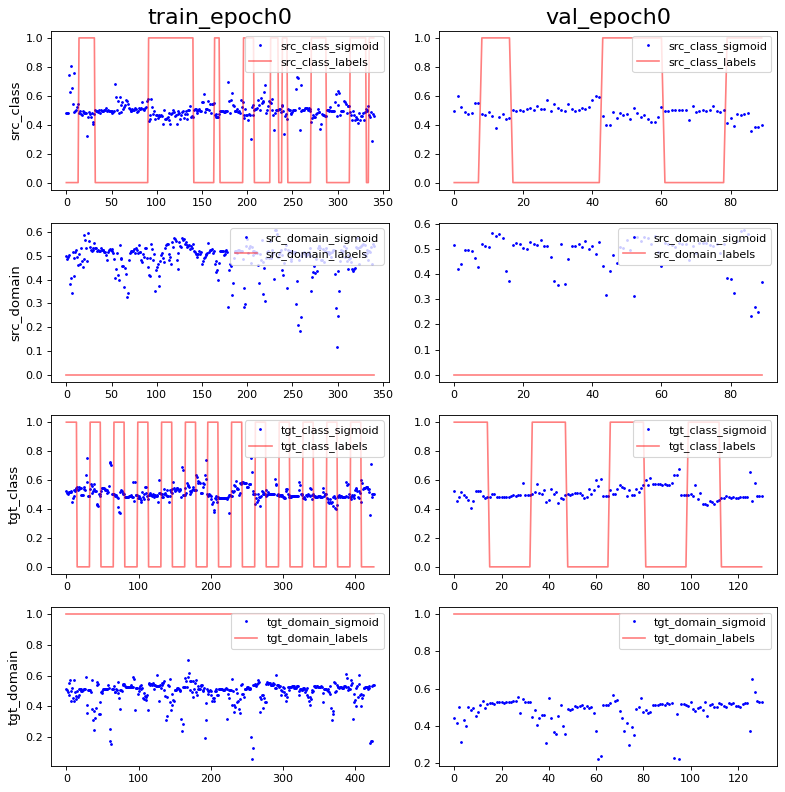

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -1.1037897e-09 1.0
PCA var: [38.2      44.3      49.5      53.7      57.       60.2      63.
 65.6      67.9      69.700005]
show standardize mean and std: 0.0 1.0
PCA var: [37.3      45.6      53.       57.9      62.7      66.3      69.200005
 71.600006 73.90001  76.00001 ]


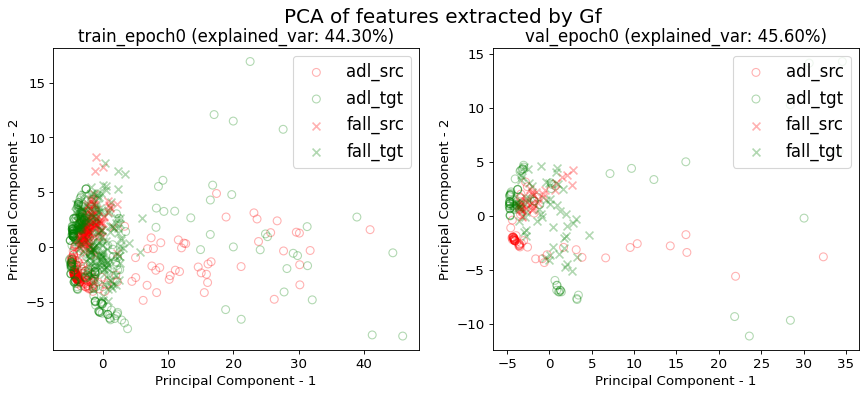

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/


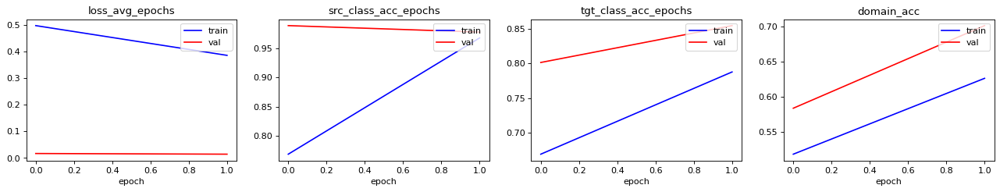

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.9912023460410557 0.5278592375366569 1.0439882697947214 0.9296187683284457
acc performance: 0.9777777777777777 0.5888888888888889 1.2444444444444445 1.1333333333333333


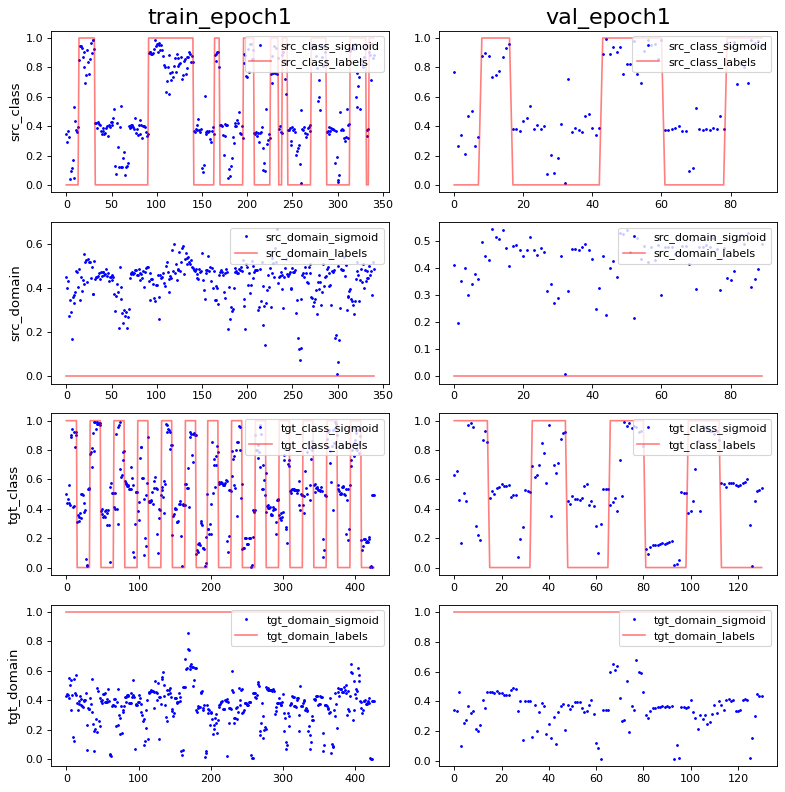

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: 0.0 1.0
PCA var: [37.2      50.3      56.899998 61.1      65.       68.3      71.3
 73.700005 75.600006 77.200005]
show standardize mean and std: 0.0 1.0
PCA var: [38.5 53.5 61.3 66.1 70.4 73.5 76.3 78.8 81.  82.8]


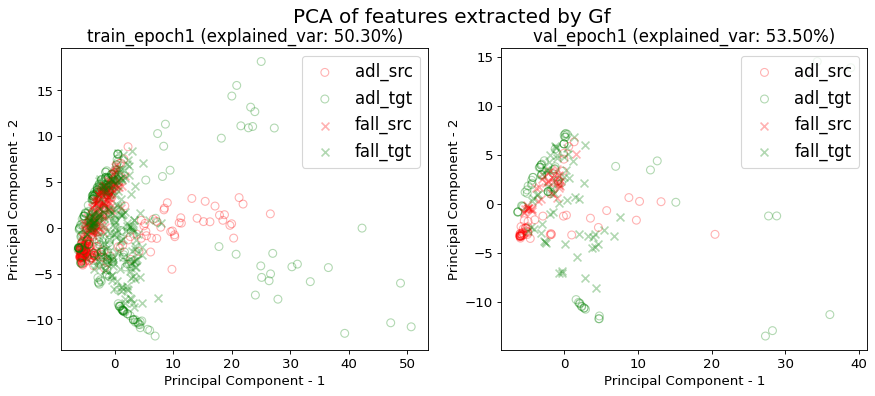

---------------Exporting model performance---------------
show df_performance


,i_CV,train_src_class_loss,train_tgt_class_loss,train_src_domain_loss,train_tgt_domain_loss,train_src_class_acc,train_tgt_class_acc,train_domain_acc,val_src_class_loss,val_tgt_class_loss,val_src_domain_loss,val_tgt_domain_loss,val_src_class_acc,val_tgt_class_acc,val_domain_acc
0,0.000000,0.084259,0.130169,0.173885,0.174558,0.911877,0.780303,0.554286,0.002164,0.003401,0.004172,0.004750,0.929412,0.840909,0.612583
1,1.000000,0.054570,0.121764,0.156976,0.174649,0.967742,0.787791,0.626277,0.001618,0.003826,0.008851,0.003869,0.977778,0.854962,0.701357
mean,0.500000,0.069415,0.125966,0.165430,0.174603,0.939810,0.784047,0.590282,0.001891,0.003614,0.006512,0.004310,0.953595,0.847935,0.656970
std,0.707107,0.020994,0.005943,0.011956,0.000064,0.039502,0.005295,0.050906,0.000386,0.000300,0.003309,0.000623,0.034200,0.009937,0.062773


val_src_class_acc: 0.9536±0.0342
val_tgt_class_acc: 0.8479±0.0099
val_domain_acc: 0.6570±0.0628
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 431, 'classes_n': 2, 'model_name': 'DannModel', 'src_dataset_name': 'UMAFall', 'tgt_dataset_name': 'UPFall', 'src_sensor_loc': 'waist', 'tgt_sensor_loc': 'belt', 'date': '2020/04/09 20:09:19', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.001, 'input_dim': (4, 3, 66), 'output_dim': 2, 'label_dim': (4,)}
val_tgt_class_acc: 0.8479±0.0099
val_domain_acc: 0.6570±0.0628
time elapsed: 00:00:43

======================  train on source, val on target(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_to

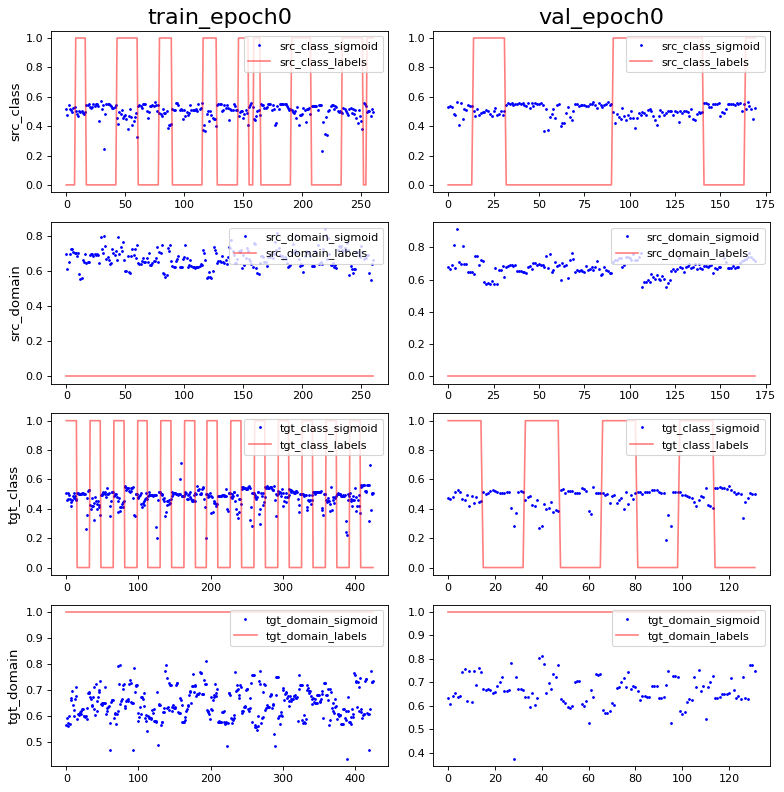

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: 1.2339308e-09 1.0
PCA var: [24.9 35.3 44.  49.9 54.5 58.7 62.3 64.9 67.3 69.3]
show standardize mean and std: -5.2631033e-10 0.99999994
PCA var: [23.1      33.6      41.199997 46.399998 50.899998 54.699997 58.1
 61.       63.7      66.1     ]


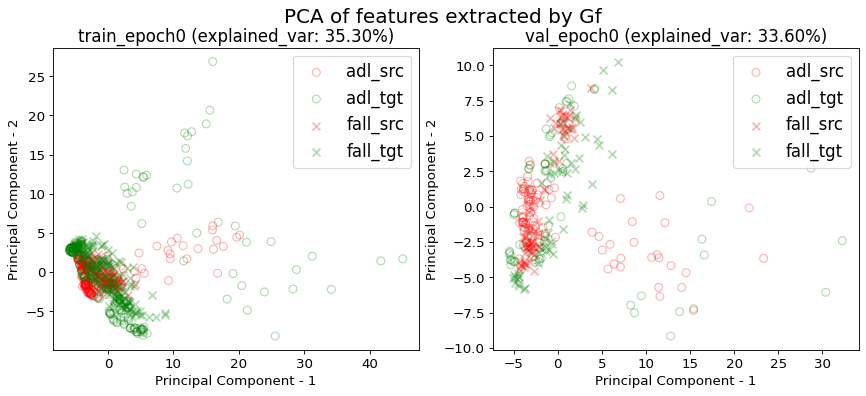

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/


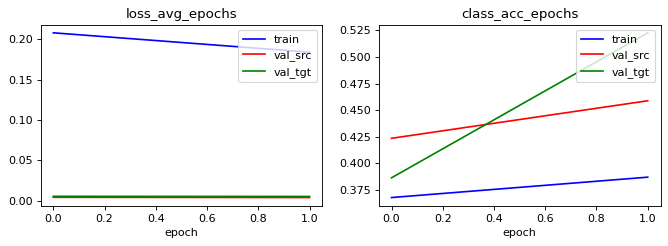

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.4942528735632184 0.9578544061302682 0.8505747126436781 0.2988505747126437
acc performance: 0.4588235294117647 0.9823529411764705 0.40588235294117647 0.07058823529411765


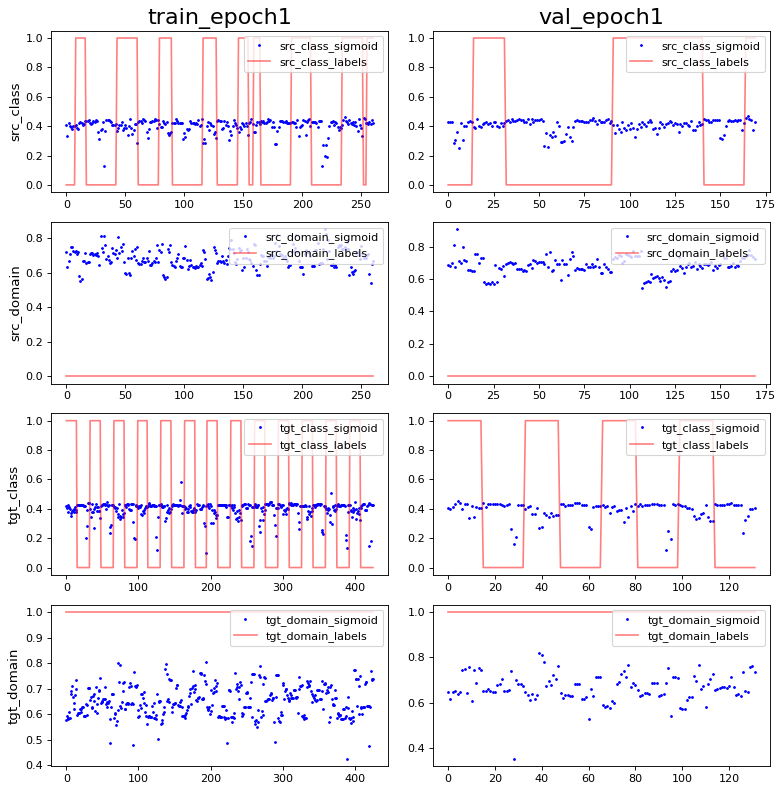

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: 0.0 1.0
PCA var: [25.       34.5      43.6      49.399998 54.3      58.2      61.8
 64.4      66.9      69.      ]
show standardize mean and std: -3.5087355e-10 0.99999994
PCA var: [22.6 33.5 40.2 46.3 50.7 54.5 57.7 60.7 63.4 65.9]


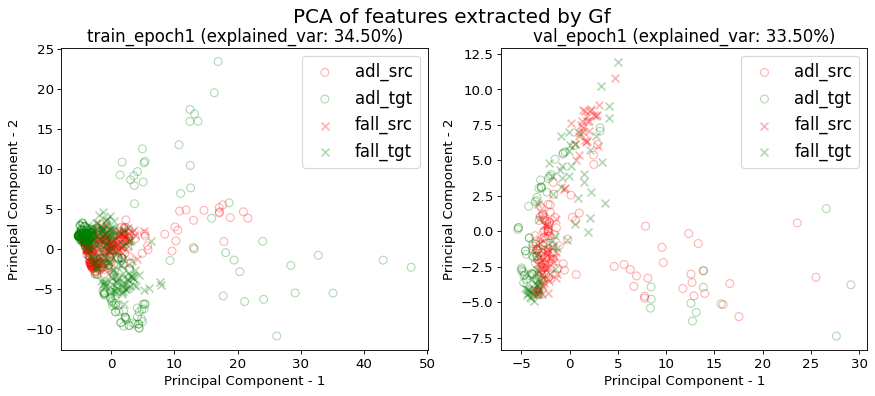

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.41642228739002934 0.008797653958944282 0.5718475073313783 1.2434017595307918
acc performance: 0.4222222222222222 0.011111111111111112 0.6555555555555556 1.4444444444444444


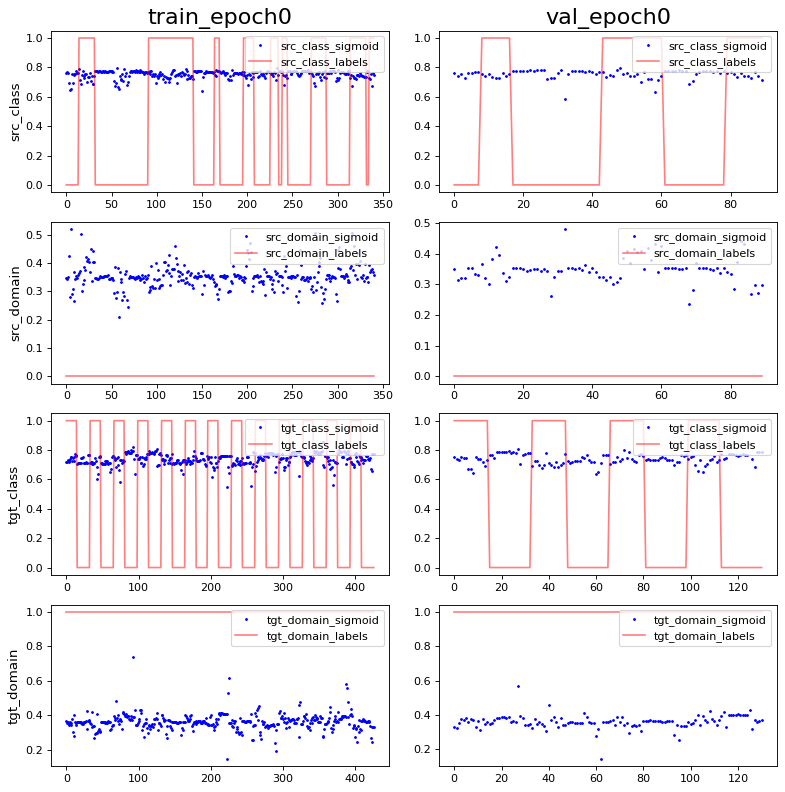

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: -2.7594743e-10 0.9965217
PCA var: [28.5      38.1      45.1      50.899998 54.899998 58.3      61.3
 64.       66.2      68.299995]
show standardize mean and std: -4.794743e-09 0.9965218
PCA var: [33.199997 44.199997 50.699997 56.399998 61.399998 65.899994 69.899994
 72.59999  74.899994 76.899994]


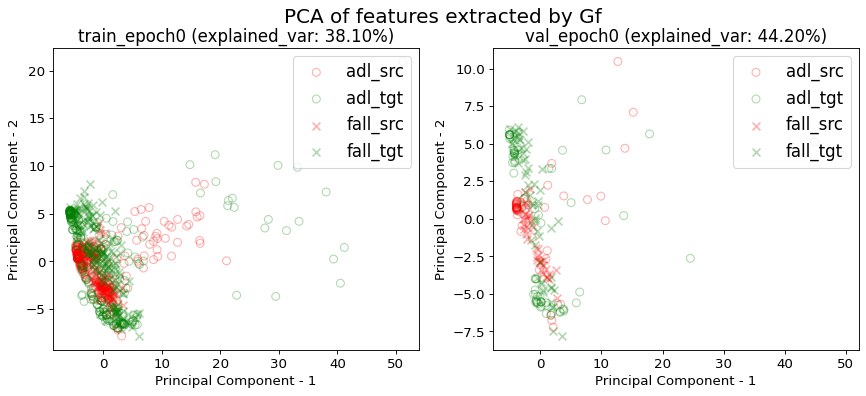

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/


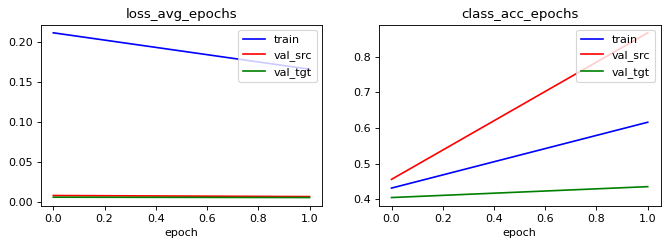

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.9325513196480938 0.002932551319648094 0.6539589442815249 1.249266862170088
acc performance: 0.8666666666666667 0.011111111111111112 0.6333333333333333 1.4555555555555555


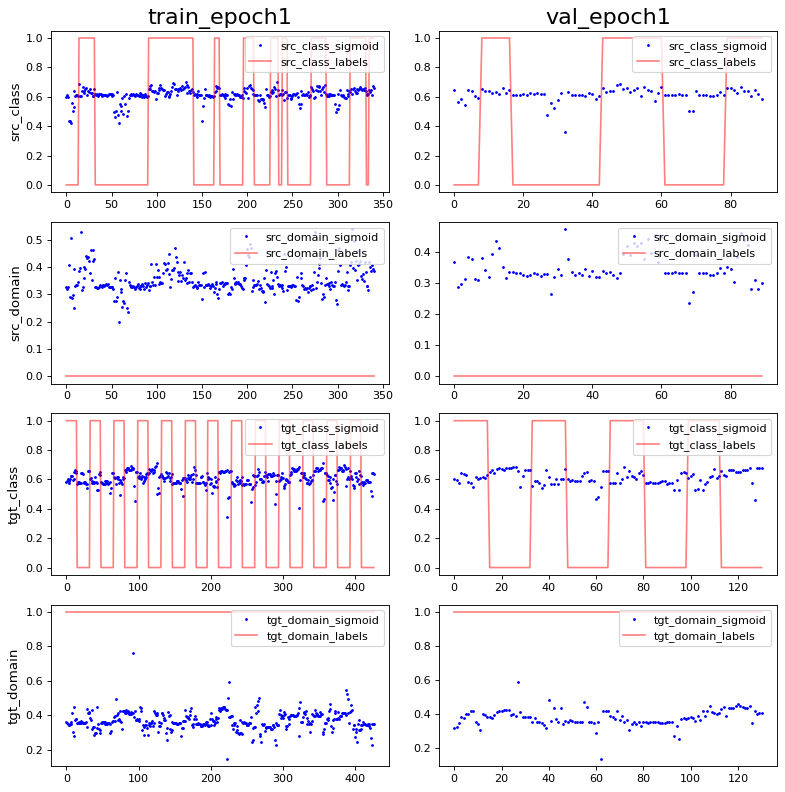

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: 2.2075795e-09 0.9965218
PCA var: [27.1      37.4      44.300003 50.500004 54.700005 58.300003 61.200005
 63.800003 66.200005 68.4     ]
show standardize mean and std: 9.589486e-10 0.9965218
PCA var: [30.899998 44.6      51.3      56.7      61.4      66.       69.8
 72.600006 75.00001  77.30001 ]


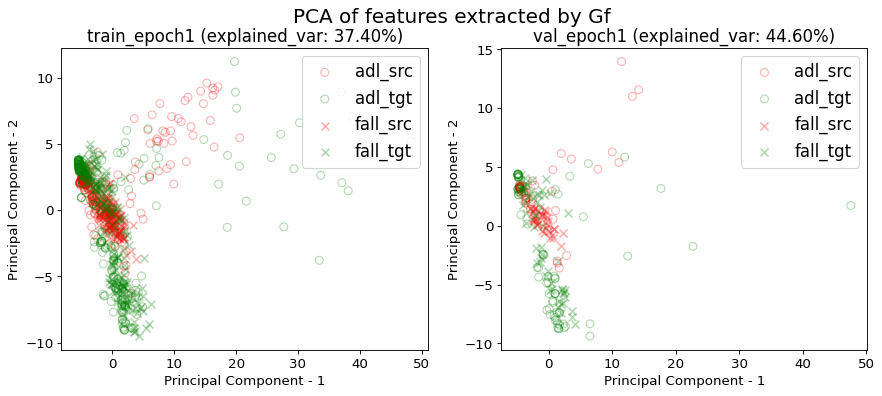

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.183934,0.386973,0.003983,0.458824,0.005327,0.522727
1,1.000000,0.165982,0.615836,0.006663,0.866667,0.005479,0.435115
mean,0.500000,0.174958,0.501404,0.005323,0.662745,0.005403,0.478921
std,0.707107,0.012694,0.161830,0.001895,0.288389,0.000108,0.061952


src val loss: 0.0053±0.0019
src val acc: 0.6627±0.2884
tgt val loss: 0.0054±0.0001
tgt val acc: 0.4789±0.0620
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 431, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UMAFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.0001, 'sensor_loc': 'waist', 'date': '2020/04/09 20:09:32', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  train on target, val on target(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modelou

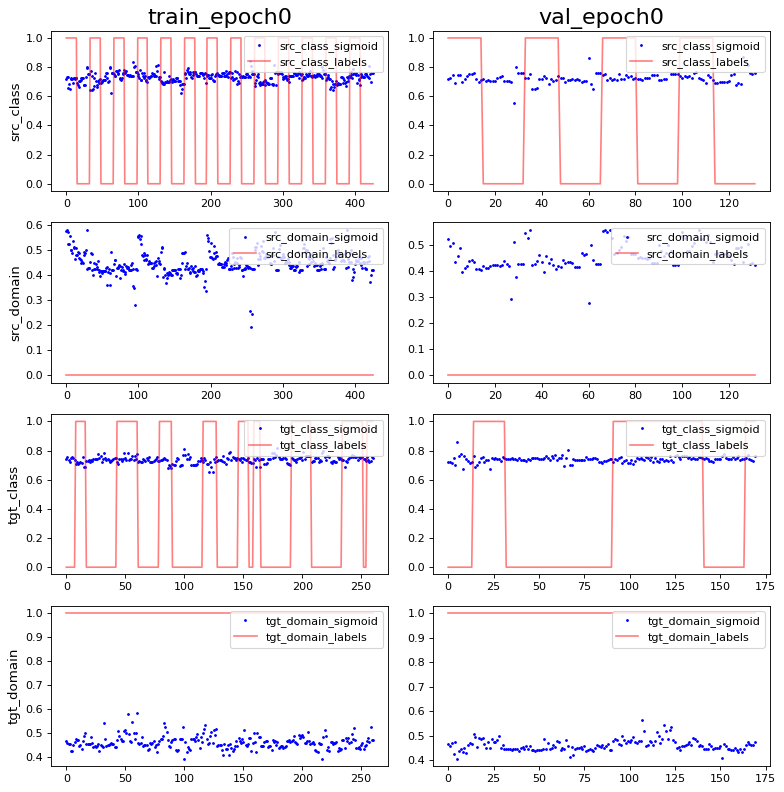

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: 1.1568102e-09 0.9999999
PCA var: [26.199999 41.399998 52.299995 57.399994 60.999992 64.09999  66.79999
 69.09999  70.99999  72.799995]
show standardize mean and std: 3.0701437e-09 0.99303126
PCA var: [26.699999 41.       52.4      58.600002 63.9      67.9      71.
 73.2      75.2      77.      ]


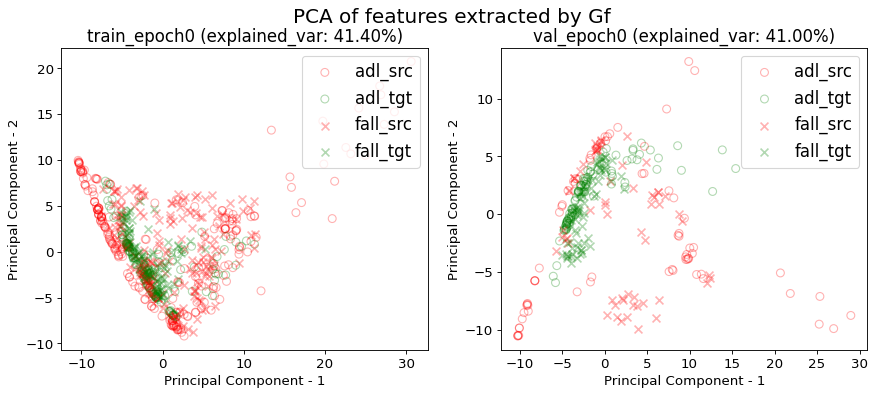

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/


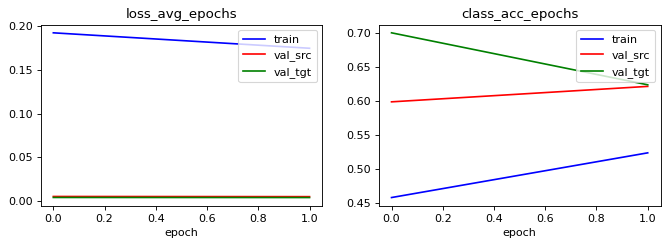

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.6009389671361502 0.01643192488262911 0.40375586854460094 0.6126760563380281
acc performance: 0.6212121212121212 0.007575757575757576 0.803030303030303 1.2878787878787878


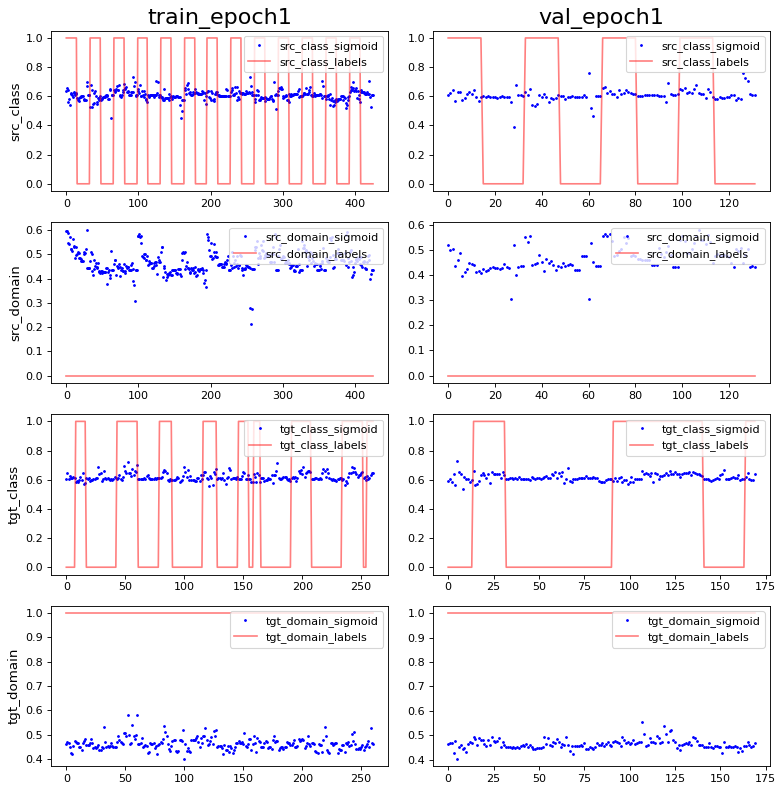

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: 1.0700494e-09 1.0
PCA var: [29.499998 45.1      55.399998 60.6      63.8      66.5      68.8
 70.8      72.700005 74.3     ]
show standardize mean and std: -7.017471e-10 0.99303126
PCA var: [31.600002 46.300003 57.100002 62.600002 66.9      70.       72.2
 74.299995 76.2      78.      ]


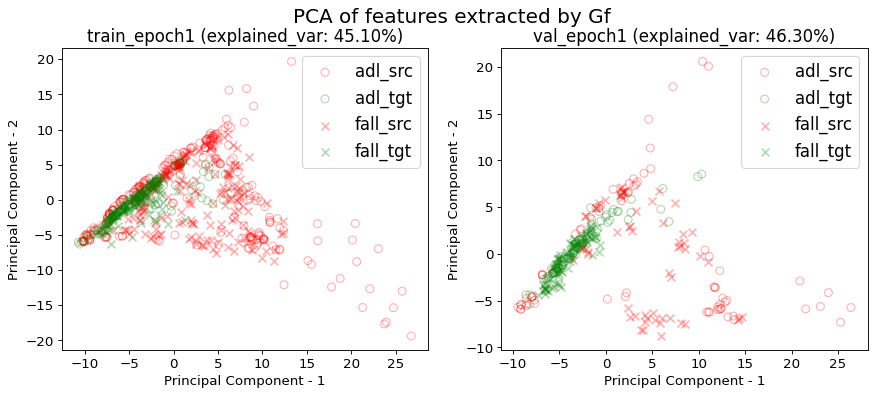

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.5362997658079626 0.12177985948477751 0.46604215456674475 0.7775175644028103
acc performance: 0.549618320610687 0.11450381679389313 0.3969465648854962 0.6641221374045801


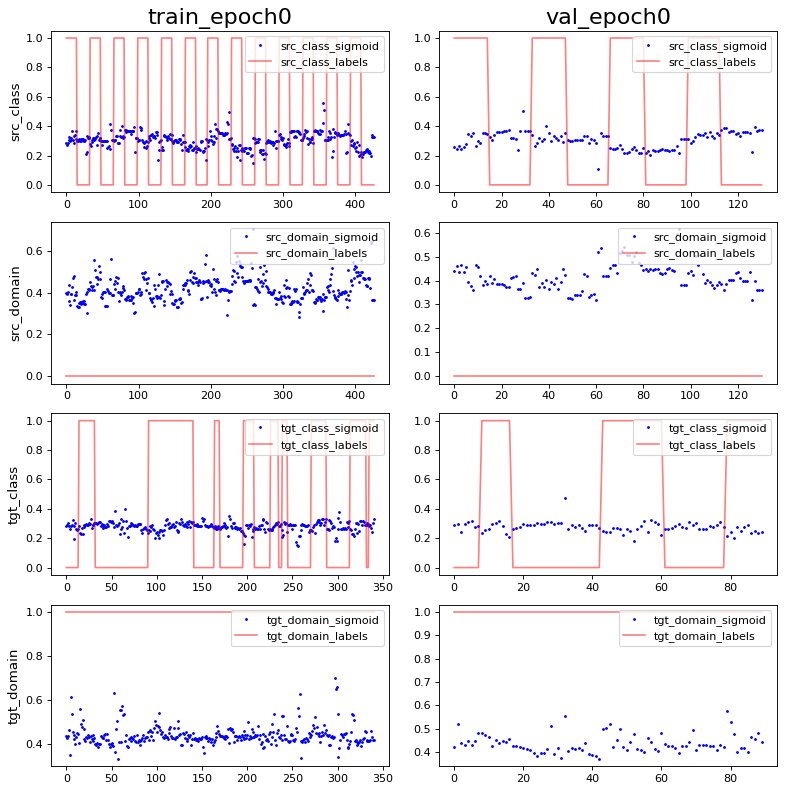

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: 5.5189486e-10 1.0
PCA var: [20.900002 36.       45.6      51.399998 55.6      59.1      62.1
 64.799995 66.99999  68.99999 ]
show standardize mean and std: 0.0 0.99303126
PCA var: [24.6      40.2      51.1      57.899998 61.999996 65.7      69.1
 72.1      74.7      77.1     ]


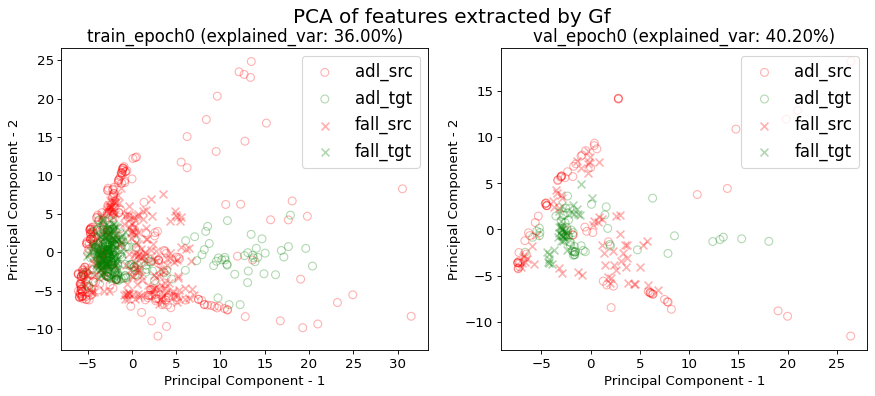

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/


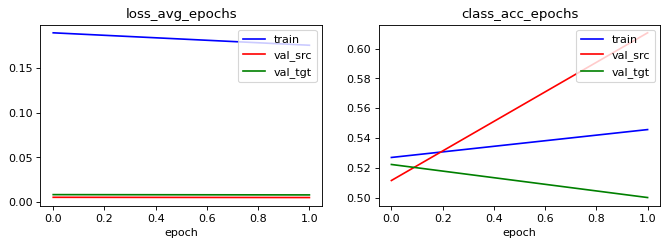

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.594847775175644 0.1522248243559719 0.41217798594847777 0.7868852459016393
acc performance: 0.6106870229007634 0.17557251908396945 0.3435114503816794 0.6717557251908397


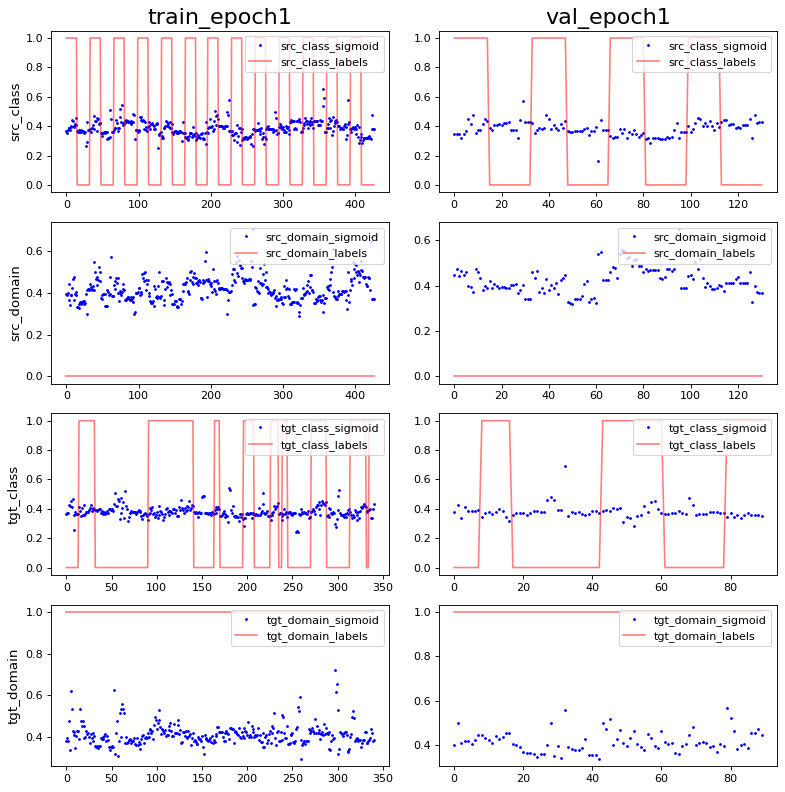

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: -1.0348029e-09 1.0
PCA var: [20.800001 37.5      47.3      52.399998 56.499996 60.199997 63.299995
 65.899994 68.299995 70.2     ]
show standardize mean and std: 2.0377657e-09 0.99303126
PCA var: [22.7      40.9      51.7      58.100002 62.000004 65.5      68.8
 71.9      74.4      76.6     ]


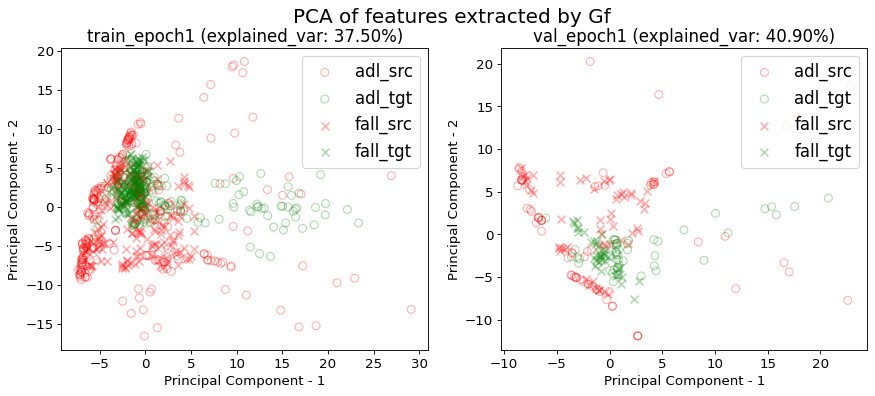

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.174608,0.523474,0.004955,0.621212,0.003933,0.623529
1,1.000000,0.175607,0.545667,0.005180,0.610687,0.008135,0.500000
mean,0.500000,0.175107,0.534571,0.005068,0.615950,0.006034,0.561765
std,0.707107,0.000707,0.015693,0.000159,0.007442,0.002971,0.087348


src val loss: 0.0051±0.0002
src val acc: 0.6159±0.0074
tgt val loss: 0.0060±0.0030
tgt val acc: 0.5618±0.0873
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UPFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.0001, 'sensor_loc': 'belt', 'date': '2020/04/09 20:09:47', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  DANN training transferring knowledge(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_mod

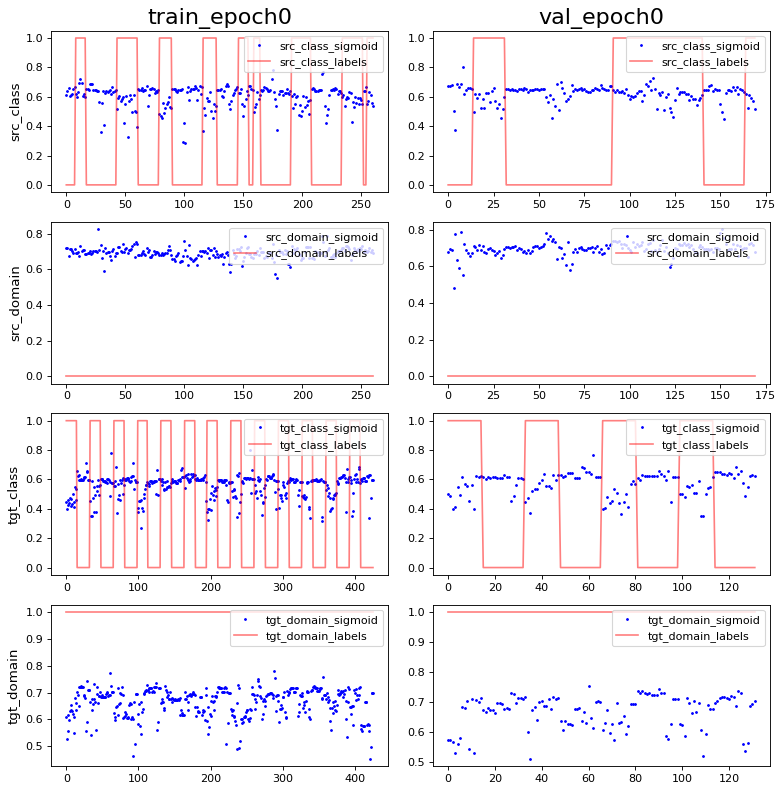

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -1.5424135e-09 0.98952854
PCA var: [24.8 37.  45.2 51.  55.  58.5 61.7 64.4 67.  69.1]
show standardize mean and std: -1.4034942e-09 0.98952854
PCA var: [26.6      36.1      43.899998 50.399998 55.699997 60.399998 63.899998
 67.1      69.6      71.7     ]


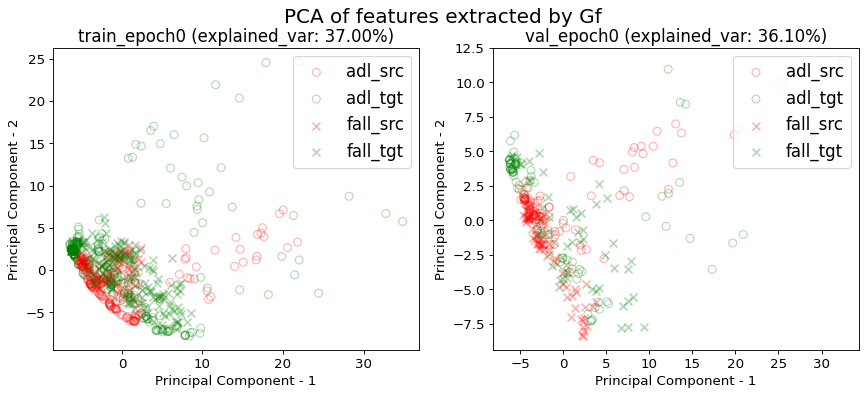

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/


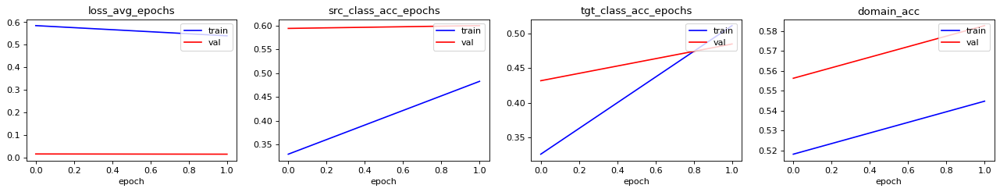

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.6206896551724138 0.9080459770114943 0.8314176245210728 0.48659003831417624
acc performance: 0.6 0.9 0.3764705882352941 0.13529411764705881


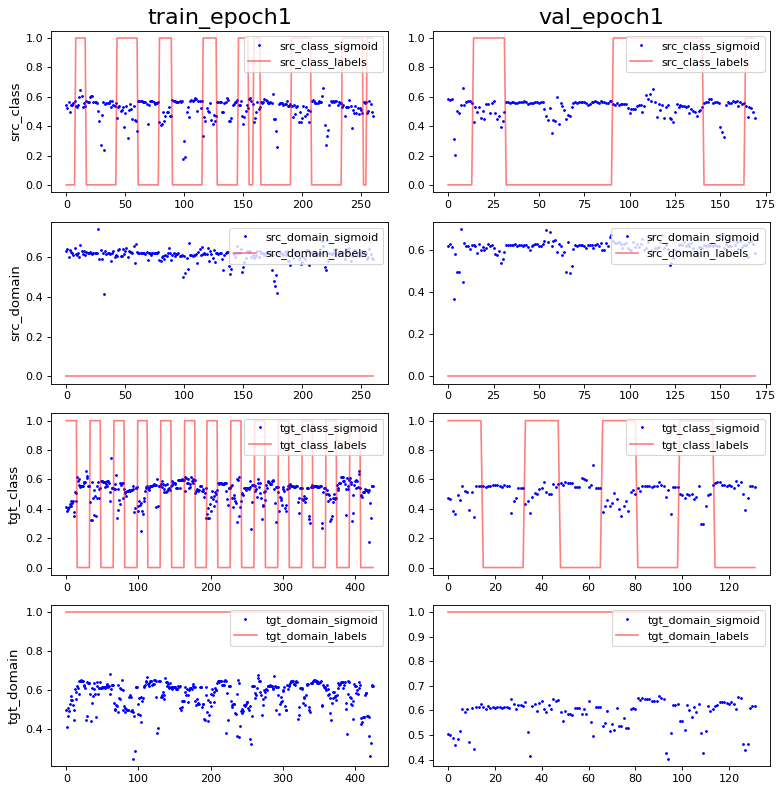

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: 1.3881722e-09 0.98952854
PCA var: [26.499998 38.8      48.       54.       58.       61.3      64.4
 66.9      69.3      71.3     ]
show standardize mean and std: 1.4034942e-09 0.98952854
PCA var: [27.4 40.  47.5 53.6 58.5 62.4 65.9 68.6 71.  73.2]


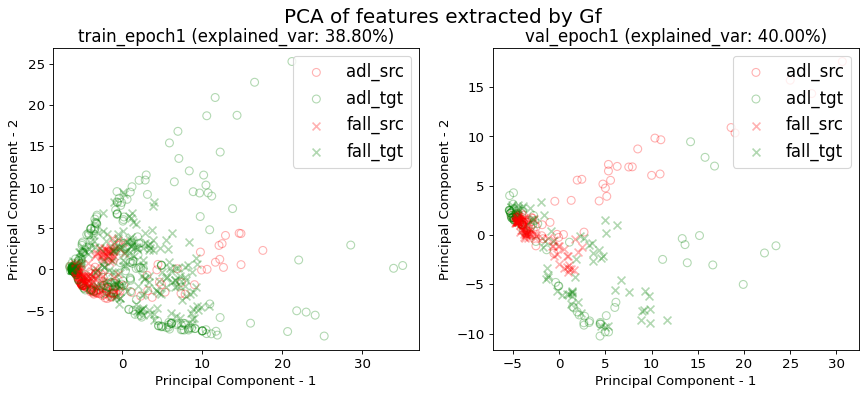

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.5835777126099707 1.0 0.6803519061583577 0.02932551319648094
acc performance: 0.5777777777777777 1.0 0.8 0.022222222222222223


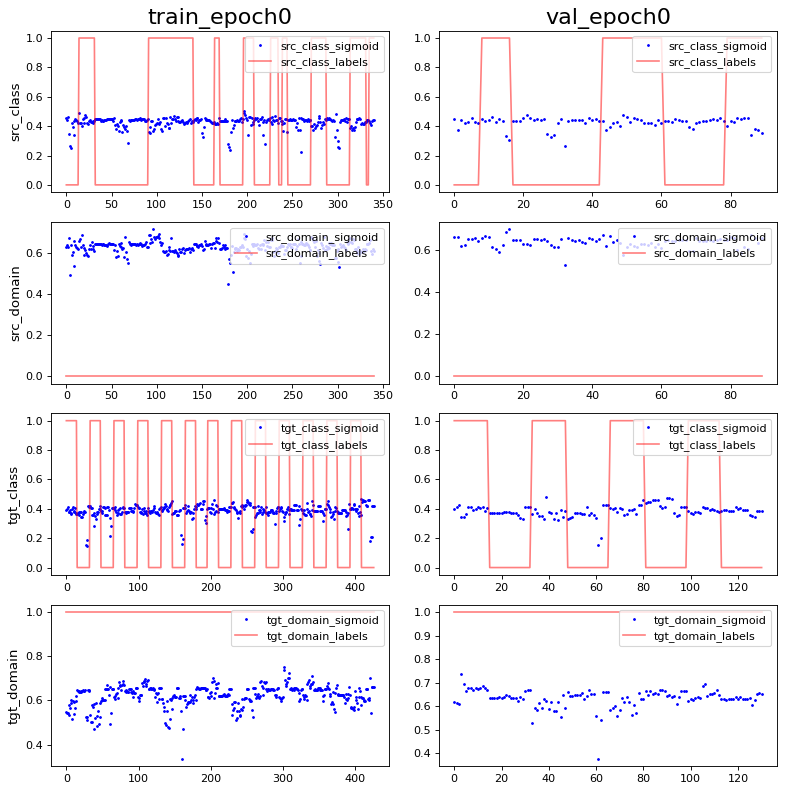

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -1.6556846e-09 0.98952854
PCA var: [22.8      36.       45.5      52.8      58.4      62.       64.7
 67.2      69.299995 71.1     ]
show standardize mean and std: -9.589486e-10 0.98952854
PCA var: [26.199999 40.5      47.9      54.300003 60.000004 64.200005 67.9
 71.1      74.       76.5     ]


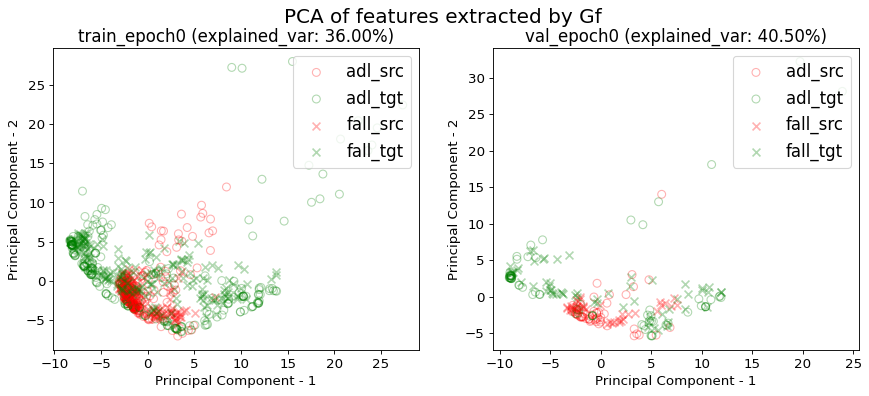

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/


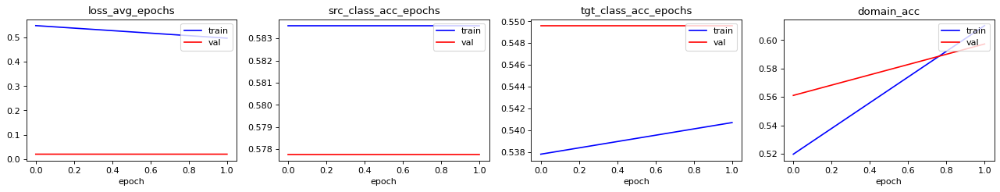

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.5865102639296188 0.873900293255132 0.6803519061583577 0.5043988269794721
acc performance: 0.5777777777777777 0.9 0.8 0.5666666666666667


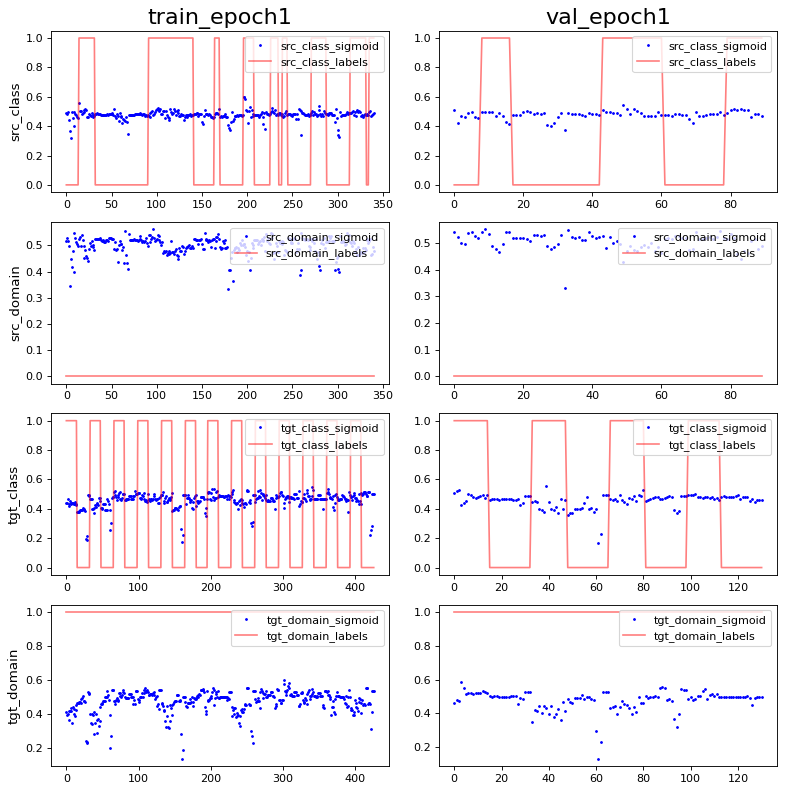

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -2.483527e-09 0.98952854
PCA var: [28.2      39.8      50.1      56.399998 60.1      63.3      65.9
 68.1      70.1      71.7     ]
show standardize mean and std: 2.8768457e-09 0.98952854
PCA var: [29.9      41.6      53.       58.7      63.100002 66.8      70.100006
 73.00001  75.40001  77.70001 ]


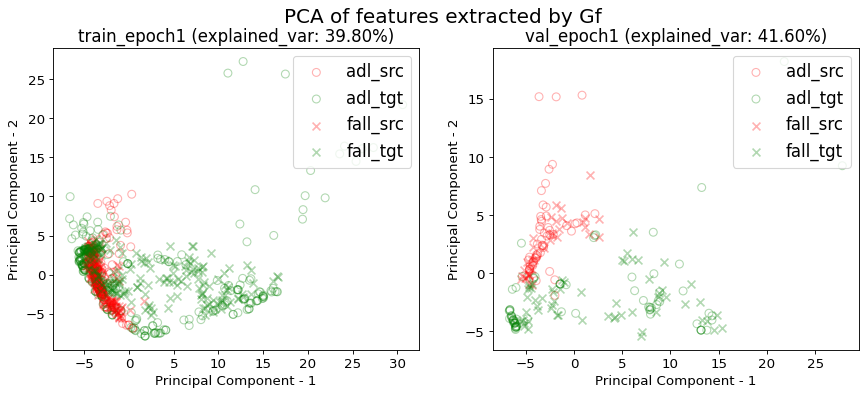

---------------Exporting model performance---------------
show df_performance


,i_CV,train_src_class_loss,train_tgt_class_loss,train_src_domain_loss,train_tgt_domain_loss,train_src_class_acc,train_tgt_class_acc,train_domain_acc,val_src_class_loss,val_tgt_class_loss,val_src_domain_loss,val_tgt_domain_loss,val_src_class_acc,val_tgt_class_acc,val_domain_acc
0,0.000000,0.169930,0.193223,0.134991,0.234710,0.482759,0.511364,0.544762,0.003890,0.005603,0.002917,0.007274,0.600000,0.484848,0.582781
1,1.000000,0.174278,0.187530,0.134364,0.189611,0.583578,0.540698,0.610219,0.007710,0.005686,0.006649,0.005078,0.577778,0.549618,0.597285
mean,0.500000,0.172104,0.190377,0.134677,0.212161,0.533168,0.526031,0.577490,0.005800,0.005645,0.004783,0.006176,0.588889,0.517233,0.590033
std,0.707107,0.003074,0.004025,0.000443,0.031890,0.071290,0.020742,0.046285,0.002701,0.000059,0.002639,0.001553,0.015713,0.045799,0.010256


val_src_class_acc: 0.5889±0.0157
val_tgt_class_acc: 0.5172±0.0458
val_domain_acc: 0.5900±0.0103
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 431, 'classes_n': 2, 'model_name': 'DannModel', 'src_dataset_name': 'UMAFall', 'tgt_dataset_name': 'UPFall', 'src_sensor_loc': 'waist', 'tgt_sensor_loc': 'belt', 'date': '2020/04/09 20:10:03', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.0001, 'input_dim': (4, 3, 66), 'output_dim': 2, 'label_dim': (4,)}
val_tgt_class_acc: 0.5172±0.0458
val_domain_acc: 0.5900±0.0103
time elapsed: 00:00:44

======================  train on source, val on target(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_t

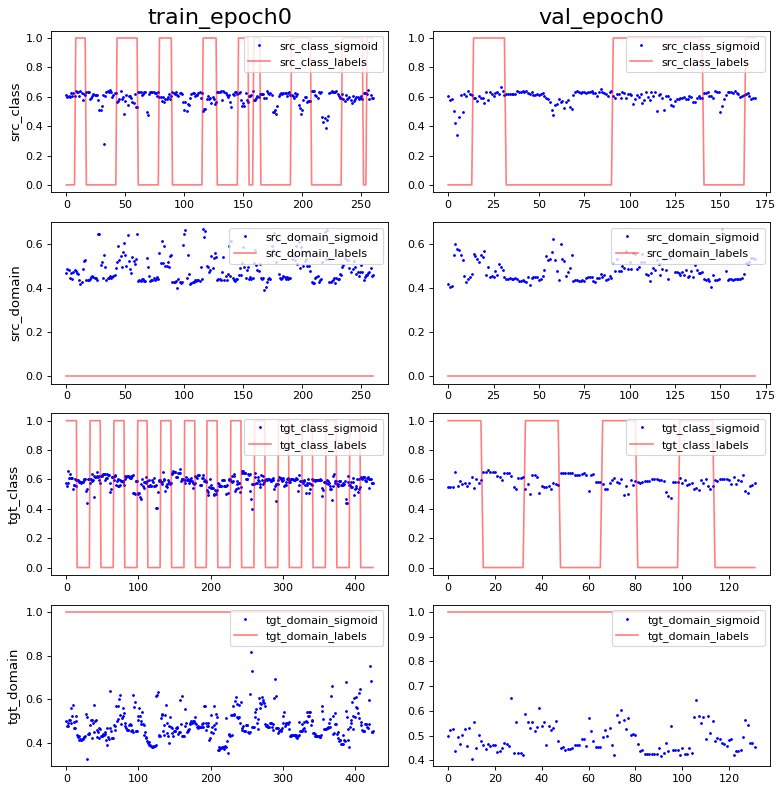

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: 1.0796896e-09 0.99390507
PCA var: [17.800001 28.7      37.9      44.600002 48.800003 52.600002 55.4
 58.       60.1      62.      ]
show standardize mean and std: -1.4034942e-09 0.9930313
PCA var: [17.7      28.100002 37.4      43.5      48.4      52.800003 55.9
 58.9      61.4      63.7     ]


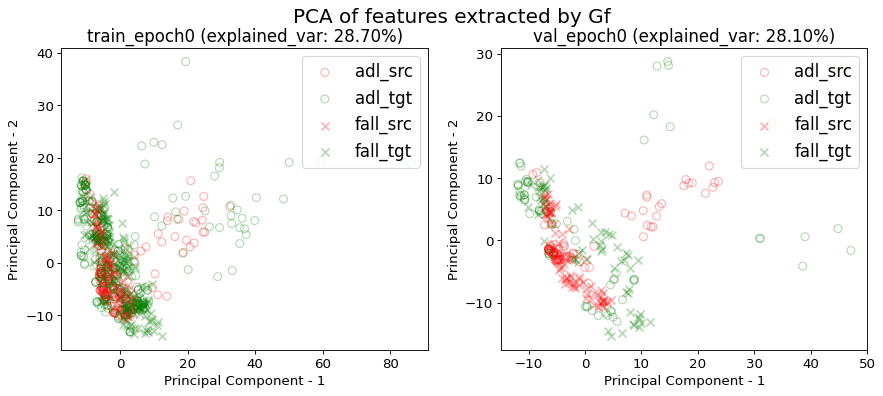

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/


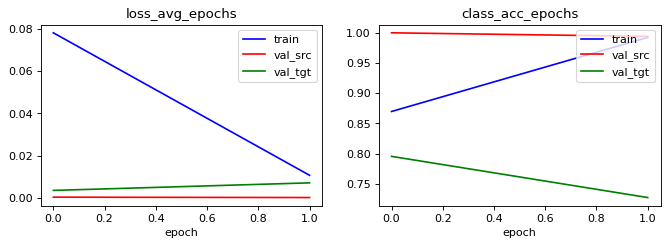

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.9885057471264368 0.28735632183908044 1.1532567049808429 1.4521072796934866
acc performance: 0.9941176470588236 0.24705882352941178 0.5647058823529412 0.6823529411764706


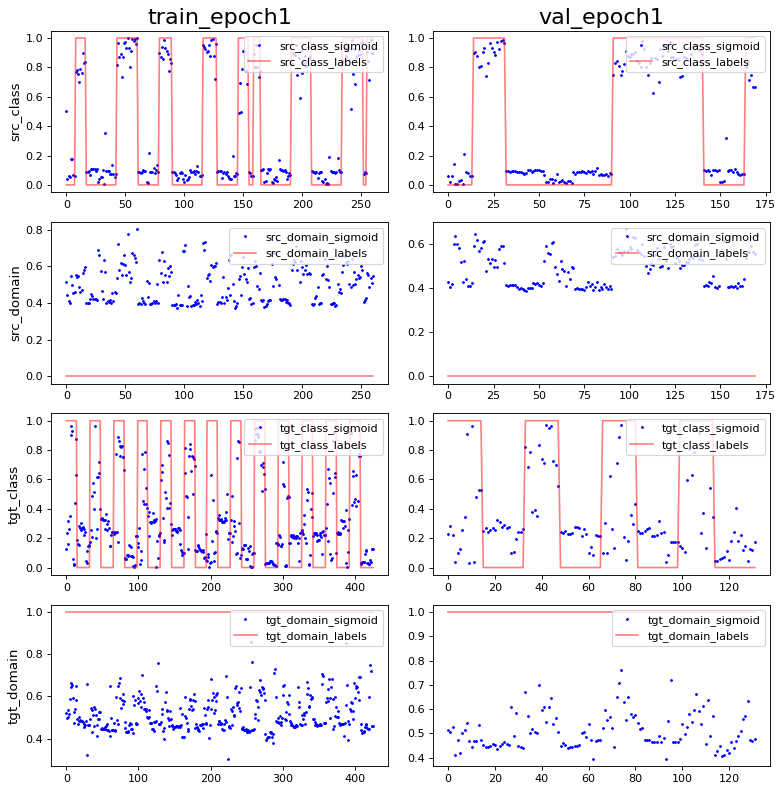

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: 8.868878e-10 0.9930313
PCA var: [19.1 34.7 45.3 52.7 58.2 61.5 64.1 66.2 68.  69.5]
show standardize mean and std: 3.5087355e-10 0.9930313
PCA var: [18.       32.7      43.4      52.100002 58.000004 61.500004 64.4
 66.9      69.       71.      ]


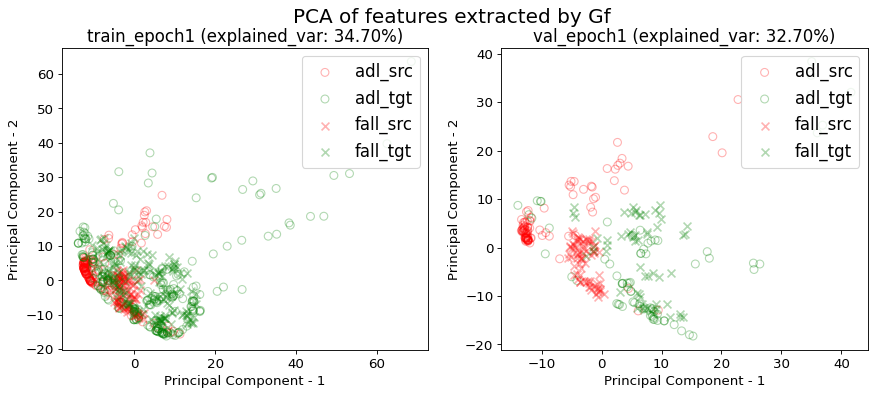

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.3313782991202346 0.0 0.375366568914956 1.2434017595307918
acc performance: 0.3111111111111111 0.0 0.4666666666666667 1.4333333333333333


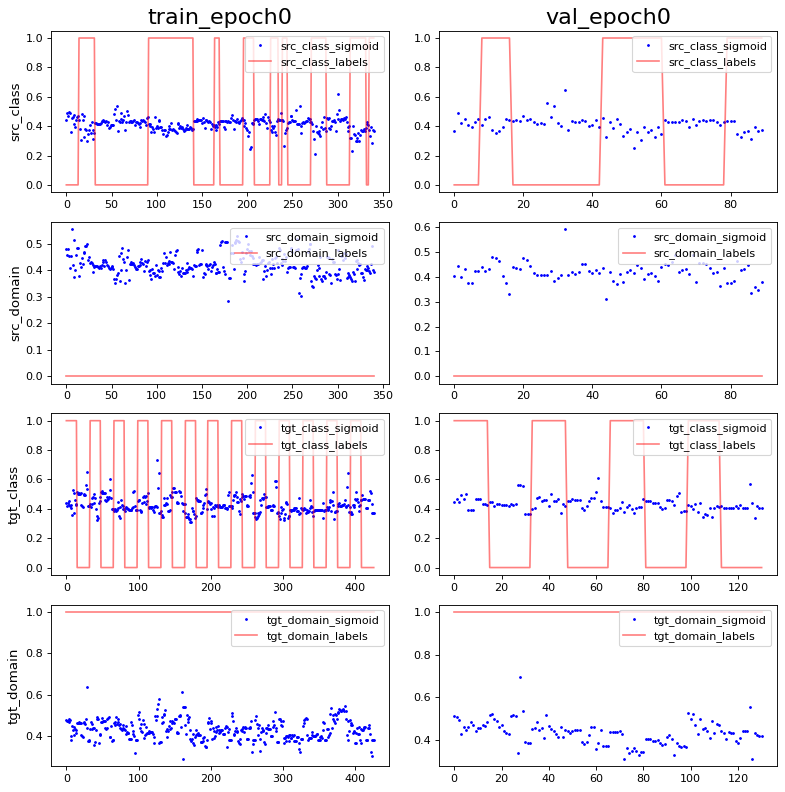

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: 4.5531325e-09 0.99565023
PCA var: [18.7      29.7      39.7      45.8      50.399998 54.1      57.1
 59.3      61.399998 63.199997]
show standardize mean and std: 0.0 0.99390507
PCA var: [22.300001 34.5      44.7      50.100002 55.000004 59.100002 62.2
 64.7      67.2      69.399994]


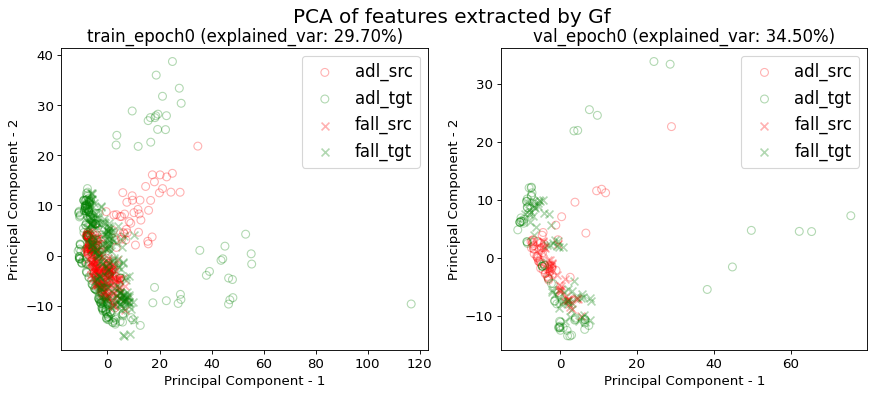

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/


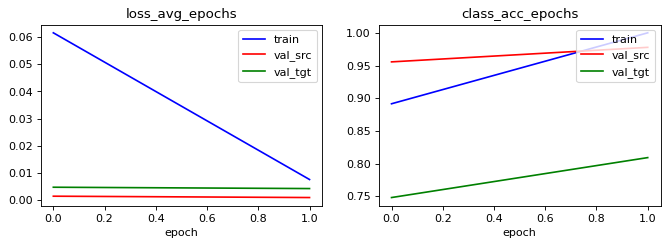

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
acc performance: 0.9970674486803519 0.017595307917888565 0.9442815249266863 1.0058651026392962
acc performance: 0.9777777777777777 0.022222222222222223 1.1777777777777778 1.0333333333333334


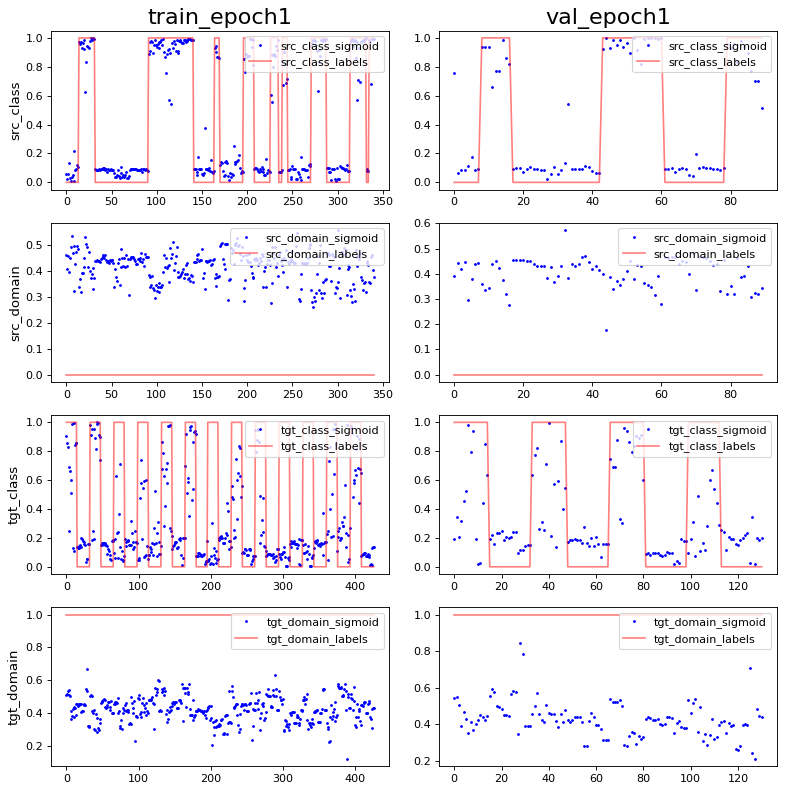

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/source/
show standardize mean and std: -6.8986855e-10 0.99565035
PCA var: [28.5      42.4      52.100002 59.600002 63.100002 66.200005 68.200005
 70.100006 71.700005 73.00001 ]
show standardize mean and std: 0.0 0.9965218
PCA var: [33.899998 48.899998 57.299995 64.1      67.9      71.200005 73.50001
 75.40001  77.30001  78.90001 ]


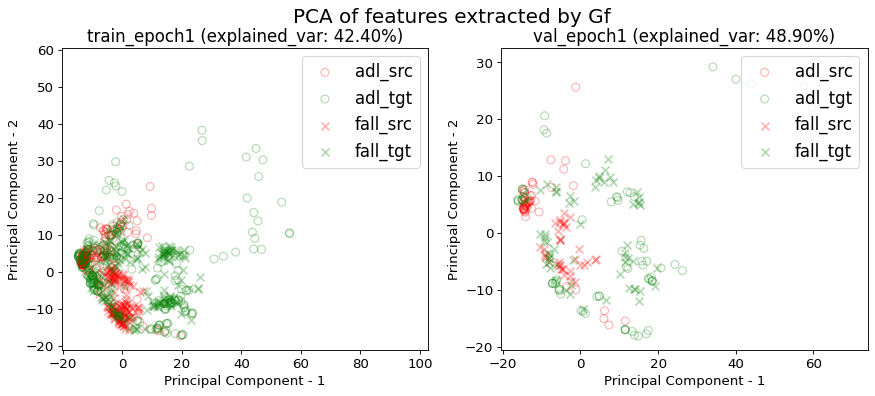

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.010798,0.992337,0.000279,0.994118,0.007216,0.727273
1,1.000000,0.007503,1.000000,0.000850,0.977778,0.004164,0.809160
mean,0.500000,0.009150,0.996169,0.000564,0.985948,0.005690,0.768217
std,0.707107,0.002330,0.005418,0.000403,0.011554,0.002158,0.057903


src val loss: 0.0006±0.0004
src val acc: 0.9859±0.0116
tgt val loss: 0.0057±0.0022
tgt val acc: 0.7682±0.0579
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 431, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UMAFall', 'num_epochs': 2, 'channel_n': 16, 'batch_size': 4, 'learning_rate': 0.001, 'sensor_loc': 'waist', 'date': '2020/04/09 20:10:17', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  train on target, val on target(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_model

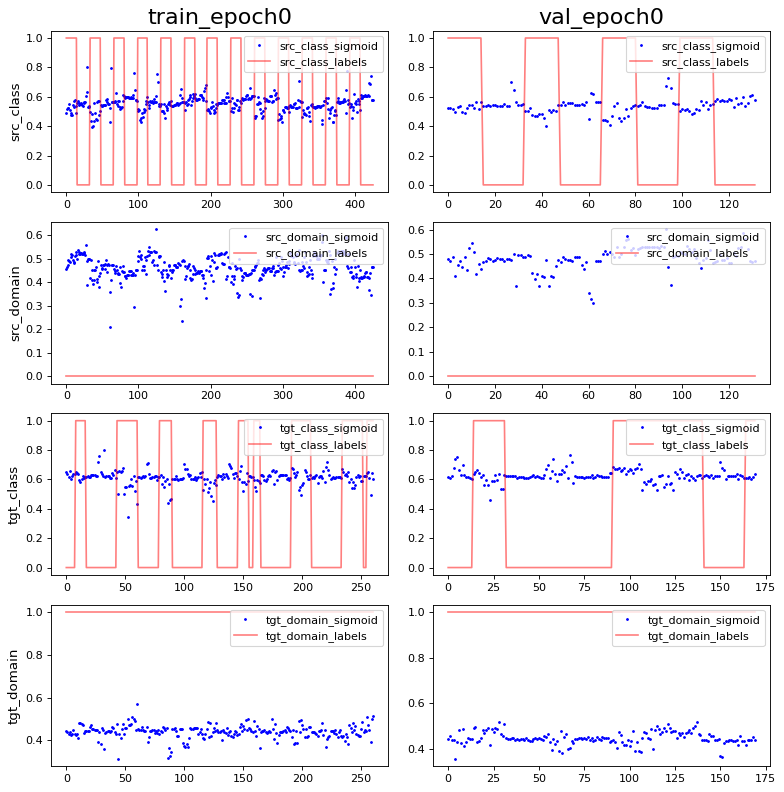

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: -6.362456e-10 0.99565023
PCA var: [17.7      31.300001 41.4      47.600002 51.9      55.800003 58.800003
 60.9      62.800003 64.600006]
show standardize mean and std: -3.2455805e-09 0.9947781
PCA var: [17.2      31.       41.1      47.399998 52.6      55.8      58.7
 61.4      63.800003 65.9     ]


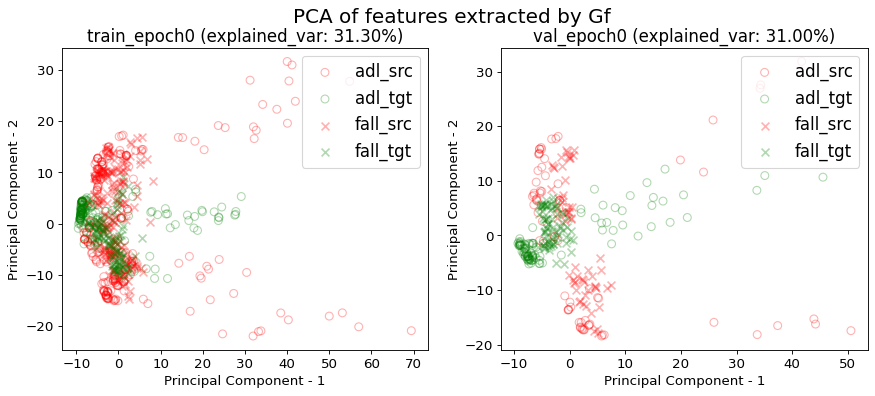

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/


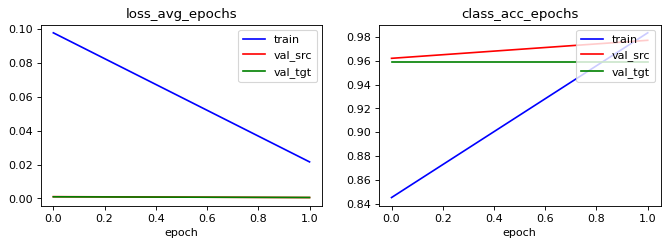

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.9953051643192489 0.5774647887323944 0.5985915492957746 0.2887323943661972
acc performance: 0.9772727272727273 0.5909090909090909 1.2348484848484849 0.5454545454545454


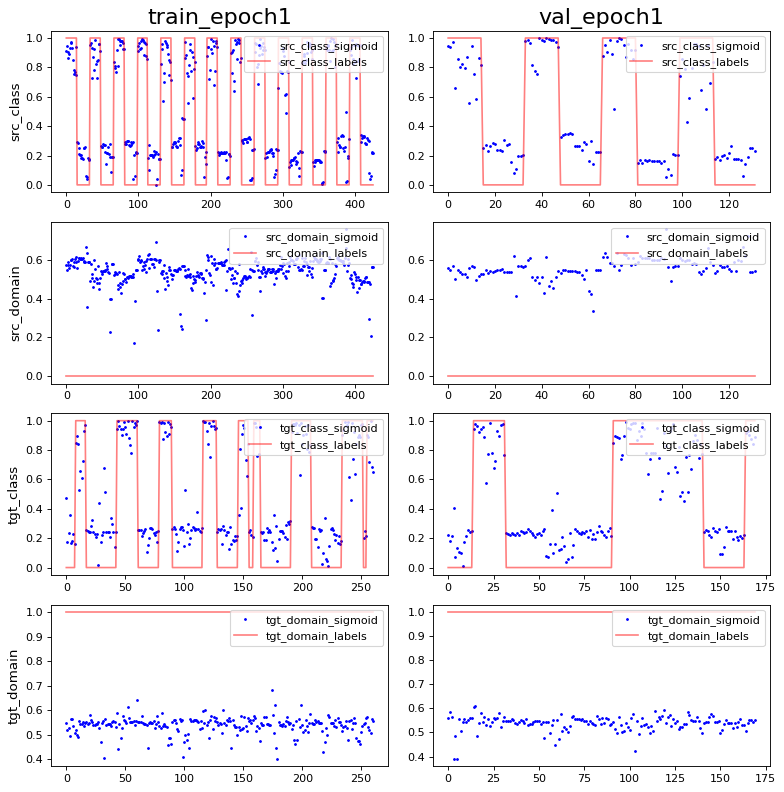

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: 1.3110515e-09 0.9965216
PCA var: [25.5 36.3 45.6 51.3 56.6 59.5 62.  64.1 65.9 67.6]
show standardize mean and std: -3.859609e-09 0.9965218
PCA var: [24.6      36.8      45.7      52.3      56.8      59.899998 62.999996
 65.6      67.9      69.9     ]


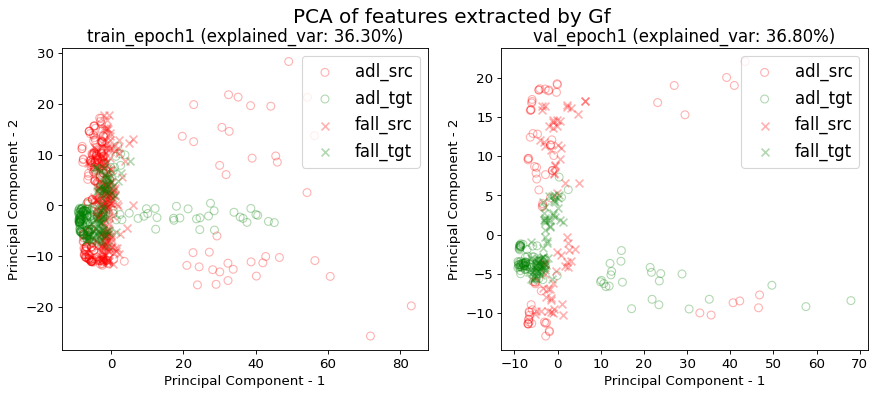

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.4613583138173302 1.0 0.3325526932084309 0.0
acc performance: 0.4580152671755725 1.0 0.2900763358778626 0.0


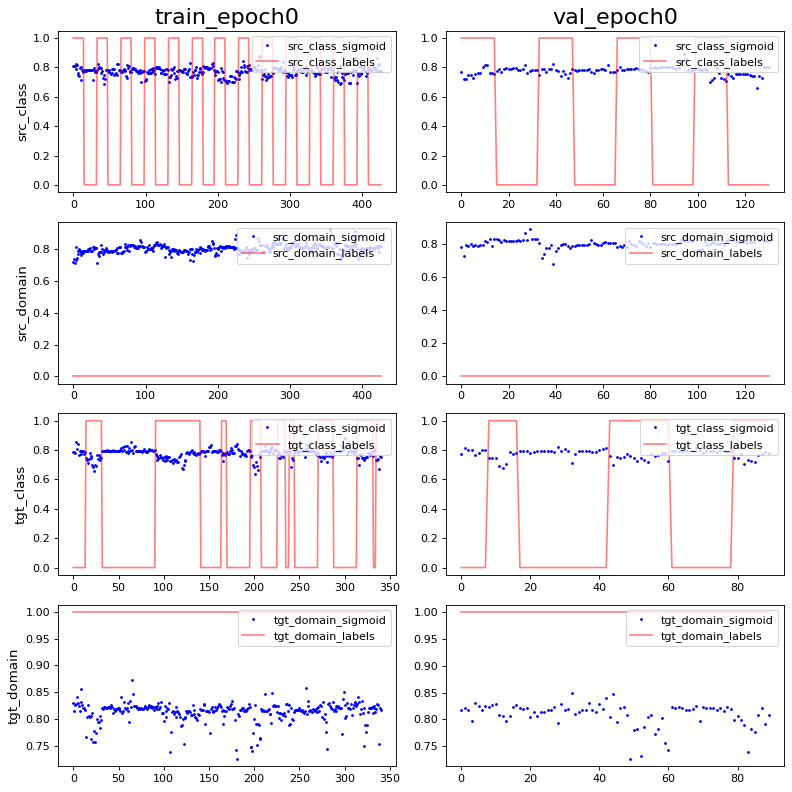

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: 2.483527e-09 0.993905
PCA var: [16.4      31.699999 39.8      45.       49.2      52.7      55.4
 57.600002 59.500004 61.400005]
show standardize mean and std: 3.596057e-09 0.99303126
PCA var: [20.5      36.2      43.5      49.1      53.699997 57.1      60.399998
 63.3      65.7      67.899994]


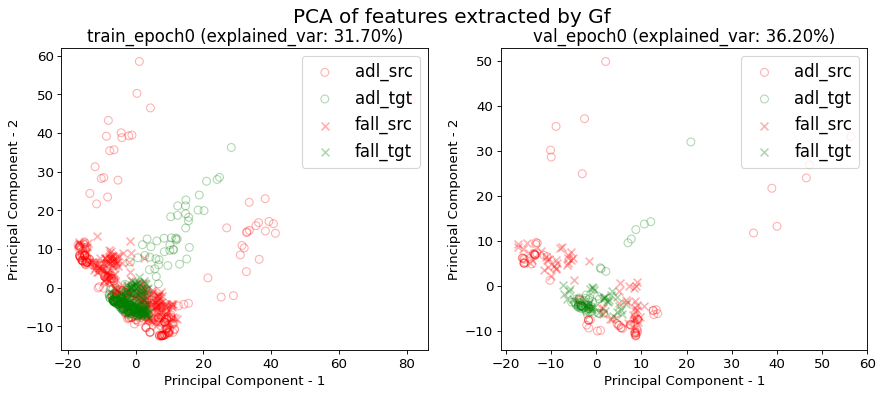

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/


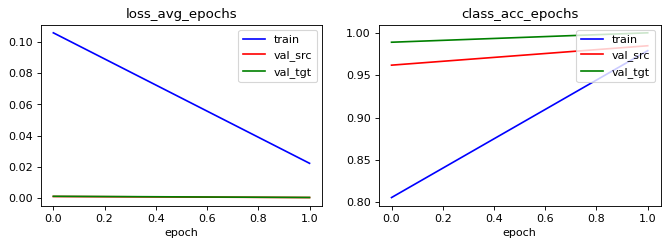

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
acc performance: 0.9929742388758782 0.8126463700234192 0.775175644028103 0.18501170960187355
acc performance: 0.9847328244274809 0.8091603053435115 0.6870229007633588 0.16793893129770993


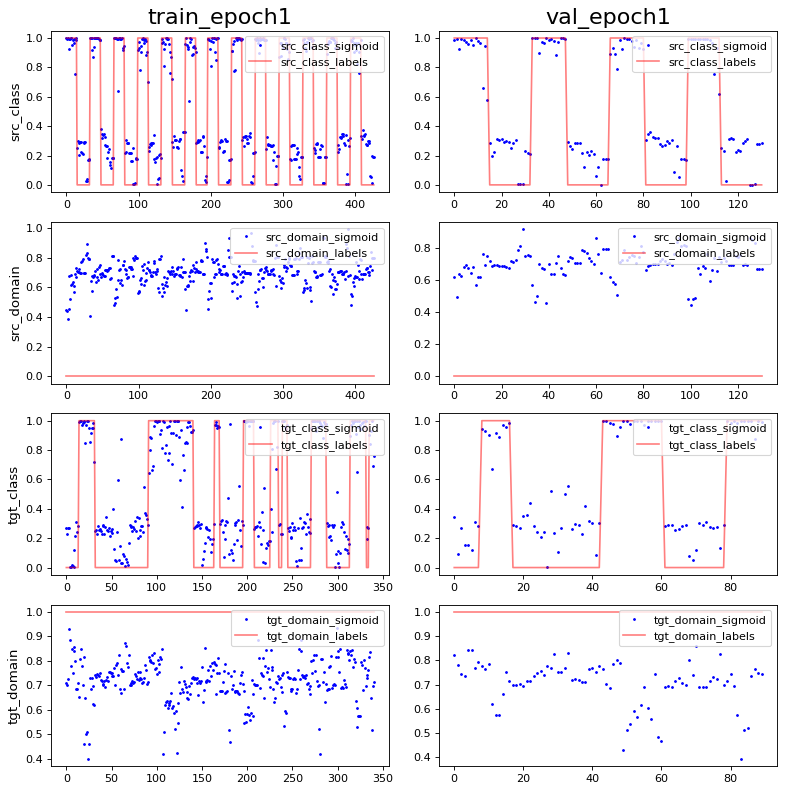

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/target/
show standardize mean and std: -3.1733955e-09 0.9965218
PCA var: [27.8      38.       45.2      50.800003 54.800003 57.800003 60.200005
 62.200005 64.100006 65.90001 ]
show standardize mean and std: -1.4384228e-09 0.9965218
PCA var: [28.3      38.3      46.699997 53.499996 57.499996 60.899998 64.1
 66.7      69.1      71.299995]


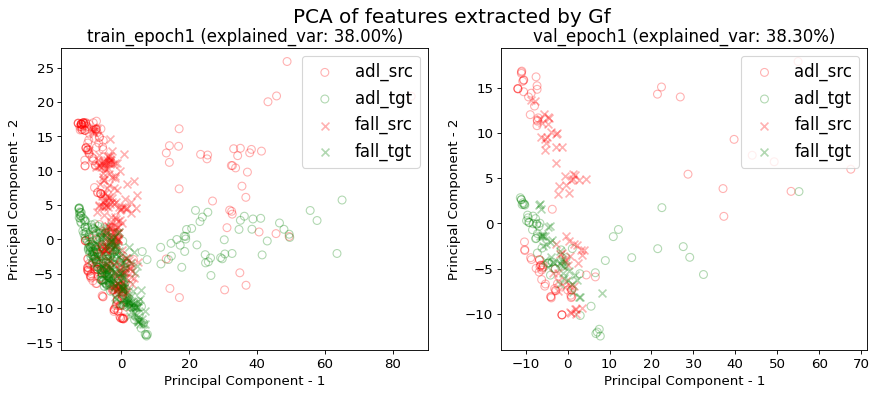

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.021609,0.983568,0.000542,0.977273,0.000570,0.958824
1,1.000000,0.022286,0.978923,0.000338,0.984733,0.000382,1.000000
mean,0.500000,0.021948,0.981245,0.000440,0.981003,0.000476,0.979412
std,0.707107,0.000479,0.003285,0.000144,0.005275,0.000133,0.029116


src val loss: 0.0004±0.0001
src val acc: 0.9810±0.0053
tgt val loss: 0.0005±0.0001
tgt val acc: 0.9794±0.0291
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UPFall', 'num_epochs': 2, 'channel_n': 16, 'batch_size': 4, 'learning_rate': 0.001, 'sensor_loc': 'belt', 'date': '2020/04/09 20:10:31', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  DANN training transferring knowledge(source=UMAFall_waist to target=UPFall_belt)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (261, 3, 66)
val_data shape: (170, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_m

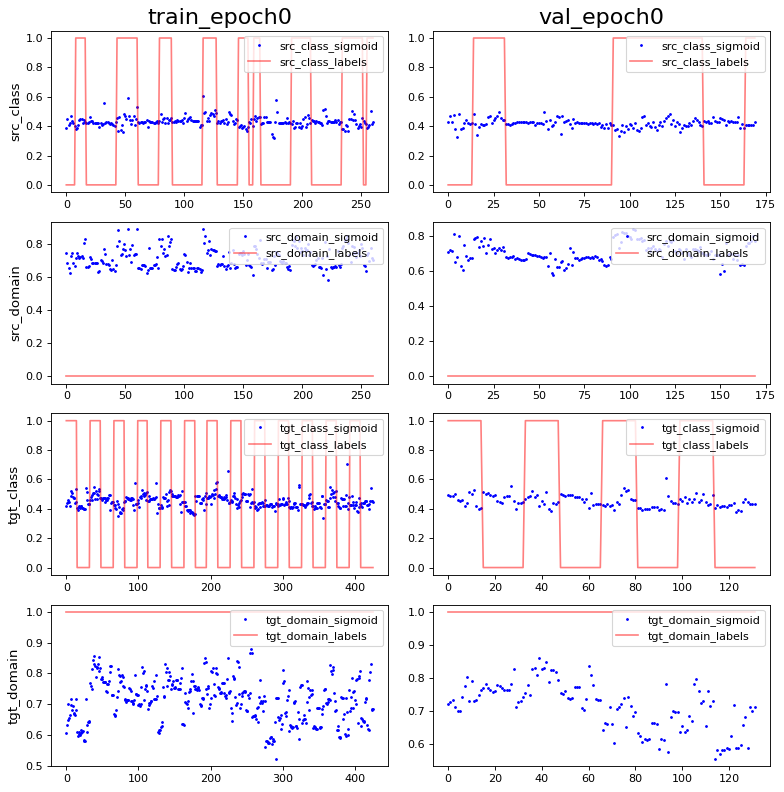

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: 2.3136204e-09 0.9956502
PCA var: [19.300001 33.300003 42.200005 46.900005 51.000004 54.200005 57.000004
 59.800003 61.9      63.800003]
show standardize mean and std: -9.649023e-10 0.993905
PCA var: [20.900002 34.9      42.5      48.6      53.       56.5      59.3
 61.899998 64.2      66.1     ]


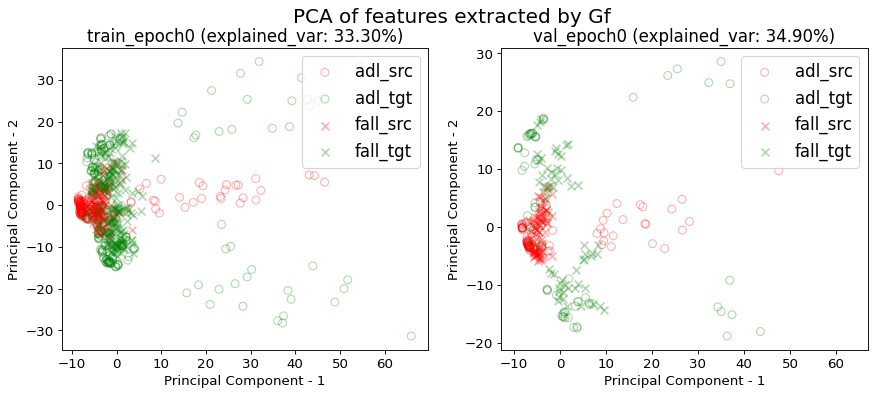

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/


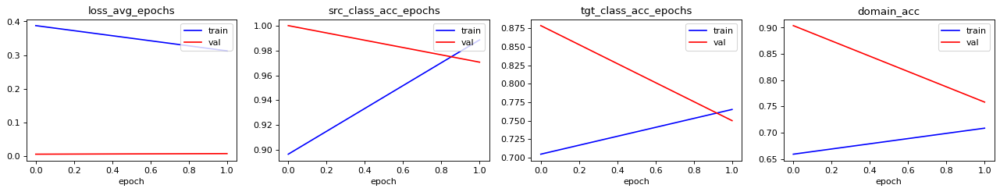

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.9846743295019157 0.5517241379310345 1.21455938697318 1.3946360153256705
acc performance: 0.9705882352941176 0.6235294117647059 0.5823529411764706 0.7235294117647059


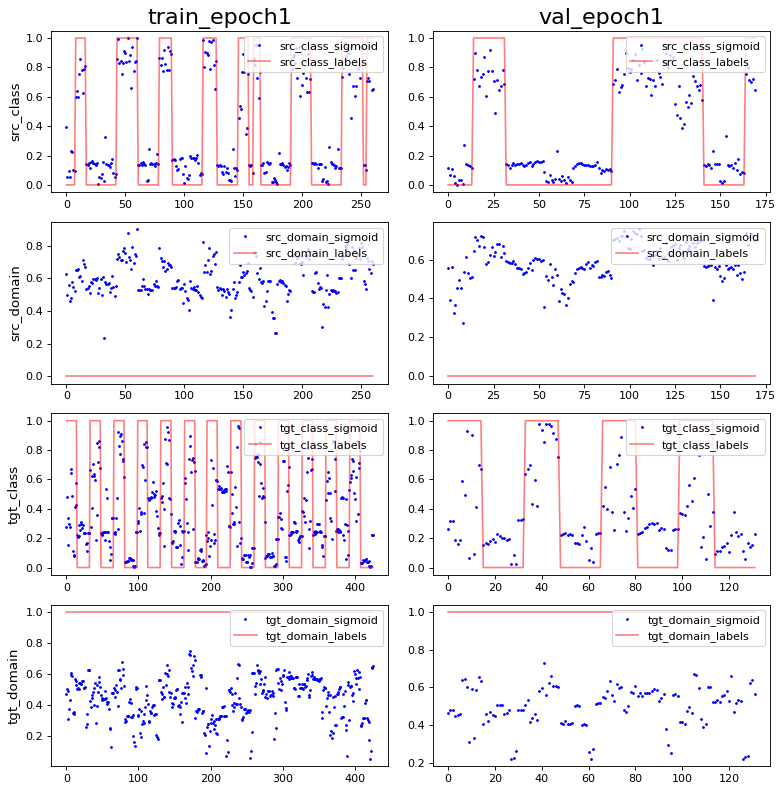

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: -7.7120677e-10 0.99477804
PCA var: [24.3 38.  45.6 51.1 55.3 59.1 61.8 64.2 66.1 67.9]
show standardize mean and std: -3.6841723e-09 0.994778
PCA var: [26.6      37.800003 45.500004 51.300003 55.500004 59.500004 62.600002
 65.5      67.8      69.700005]


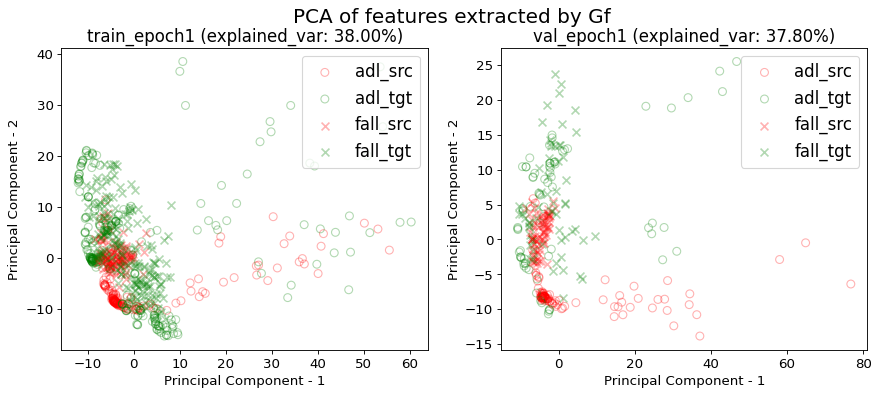

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (341, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.6950146627565983 0.10850439882697947 0.6862170087976539 1.0586510263929618
acc performance: 0.6666666666666666 0.13333333333333333 0.7777777777777778 1.0777777777777777


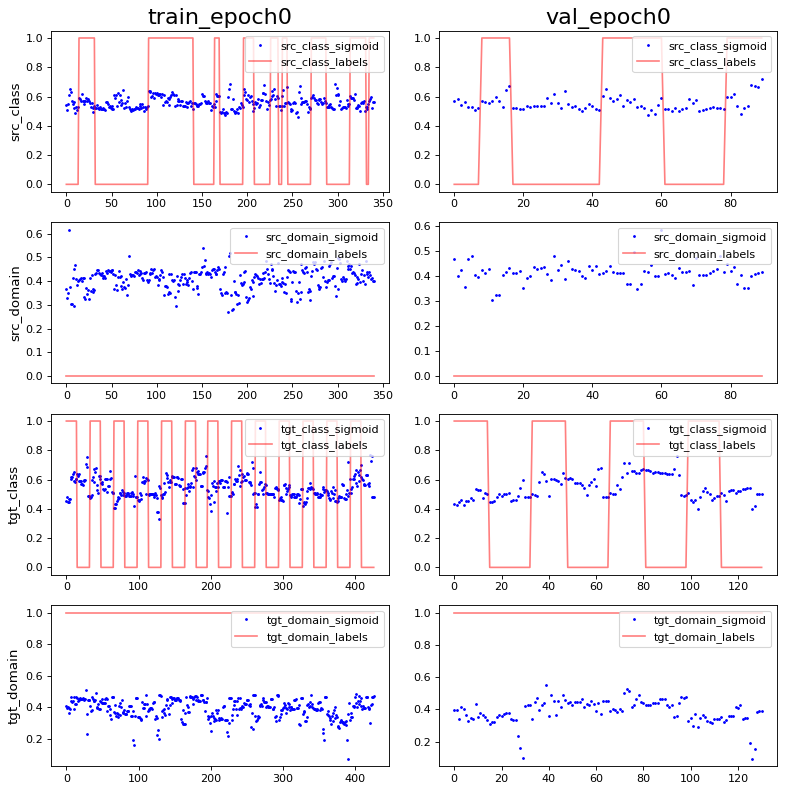

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: 4.967054e-09 0.9982624
PCA var: [19.300001 32.9      39.600002 45.200005 49.200005 52.500004 55.000004
 57.300003 59.4      61.4     ]
show standardize mean and std: 0.0 0.9973924
PCA var: [20.7      36.800003 44.4      50.       54.7      58.5      61.4
 64.1      66.5      68.8     ]


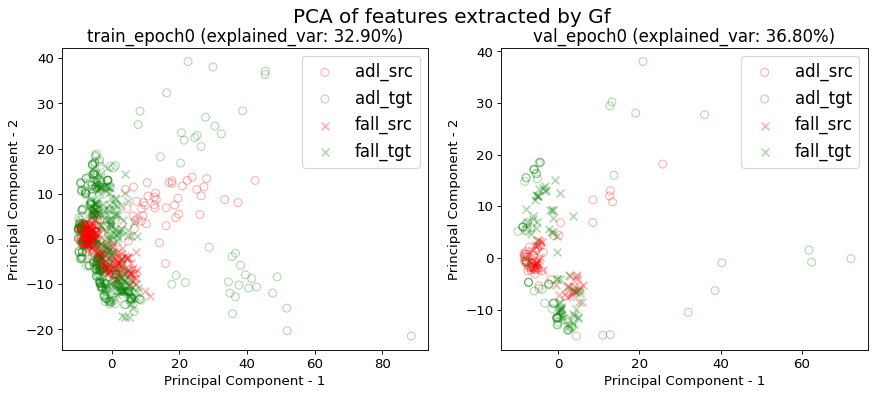

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/


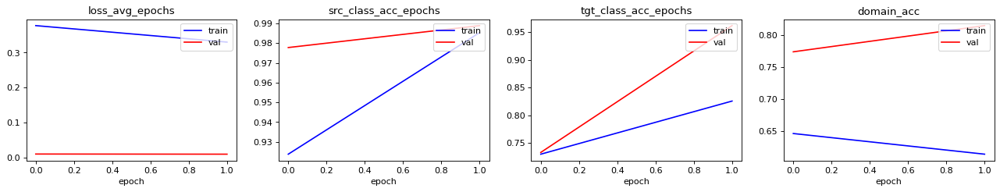

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
acc performance: 0.9912023460410557 0.7536656891495601 1.155425219941349 0.9442815249266863
acc performance: 0.9888888888888889 0.7333333333333333 1.4 1.2666666666666666


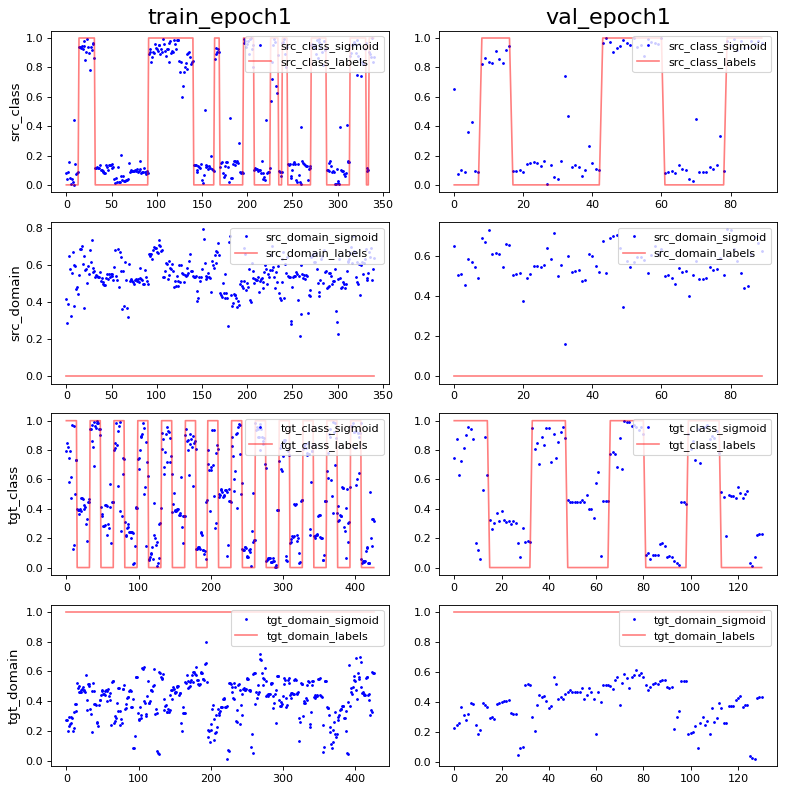

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/dann/
show standardize mean and std: 0.0 0.9956503
PCA var: [25.6      38.300003 47.200005 52.800003 57.200005 60.000004 62.300003
 64.3      66.100006 67.8     ]
show standardize mean and std: 3.8357943e-09 0.9930313
PCA var: [29.300001 44.100002 54.200005 60.100006 64.00001  67.30001  69.90001
 72.100006 74.100006 76.00001 ]


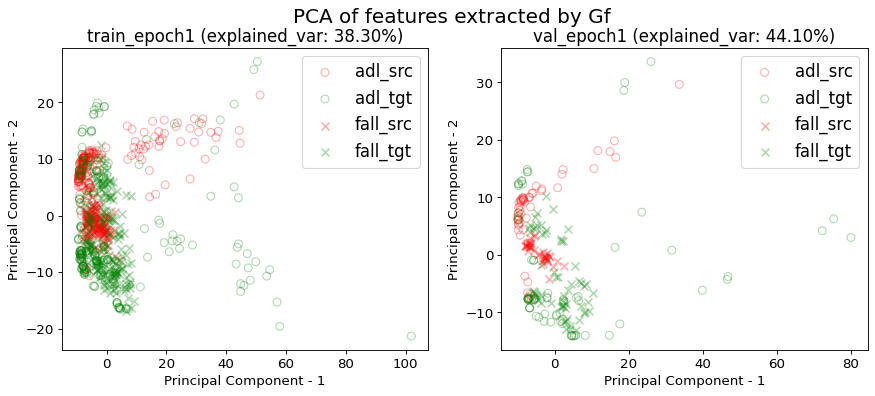

---------------Exporting model performance---------------
show df_performance


,i_CV,train_src_class_loss,train_tgt_class_loss,train_src_domain_loss,train_tgt_domain_loss,train_src_class_acc,train_tgt_class_acc,train_domain_acc,val_src_class_loss,val_tgt_class_loss,val_src_domain_loss,val_tgt_domain_loss,val_src_class_acc,val_tgt_class_acc,val_domain_acc
0,0.000000,0.020294,0.127989,0.140662,0.151763,0.988506,0.765152,0.708571,0.000600,0.004696,0.004206,0.003239,0.970588,0.750000,0.758278
1,1.000000,0.013264,0.104010,0.154735,0.162168,0.985337,0.825581,0.614599,0.000430,0.001746,0.006097,0.003496,0.988889,0.961832,0.814480
mean,0.500000,0.016779,0.116000,0.147699,0.156966,0.986921,0.795366,0.661585,0.000515,0.003221,0.005152,0.003367,0.979739,0.855916,0.786379
std,0.707107,0.004971,0.016956,0.009951,0.007357,0.002240,0.042730,0.066449,0.000121,0.002086,0.001337,0.000182,0.012941,0.149788,0.039740


val_src_class_acc: 0.9797±0.0129
val_tgt_class_acc: 0.8559±0.1498
val_domain_acc: 0.7864±0.0397
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 431, 'classes_n': 2, 'model_name': 'DannModel', 'src_dataset_name': 'UMAFall', 'tgt_dataset_name': 'UPFall', 'src_sensor_loc': 'waist', 'tgt_sensor_loc': 'belt', 'date': '2020/04/09 20:10:48', 'num_epochs': 2, 'channel_n': 16, 'batch_size': 4, 'learning_rate': 0.001, 'input_dim': (4, 3, 66), 'output_dim': 2, 'label_dim': (4,)}
val_tgt_class_acc: 0.8559±0.1498
val_domain_acc: 0.7864±0.0397
time elapsed: 00:00:44


,HP_i0,HP_i1,HP_i2,HP_i3,HP_i3_1,HP_i4,HP_i5,HP_i5_1,HP_i6,HP_optimal
channel_n,4,4,4,16,4,32,4,4,4,16
batch_size,16,4,64,4,4,4,4,4,4,4
learning_rate,0.01,0.01,0.01,0.01,0.01,0.01,0.001,0.01,0.0001,0.001
source,0.662±0.047,0.700±0.101,0.548±0.003,0.745±0.028,0.700±0.101,0.680±0.045,0.734±0.087,0.700±0.101,0.479±0.062,0.768±0.058
DANN,0.677±0.133,0.738±0.015,0.582±0.045,0.745±0.243,0.738±0.015,0.597±0.041,0.848±0.010,0.738±0.015,0.517±0.046,0.856±0.150
target,0.962±0.000,0.970±0.022,0.548±0.003,0.917±0.086,0.970±0.022,0.970±0.022,0.947±0.010,0.970±0.022,0.616±0.007,0.981±0.005
domain,0.425±0.058,0.659±0.126,0.528±0.226,0.530±0.268,0.659±0.126,0.555±0.184,0.657±0.063,0.659±0.126,0.590±0.010,0.786±0.040
time_elapsed,38.1804,40.4061,36.3318,44.1438,40.4061,43.8906,43.3445,40.4061,44.3163,44.4666
num_params,748,748,748,4132,748,11332,748,748,748,4132


df_outputdir for stage2 df_performance_table_agg: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UMAFall_waist_UPFall_belt/HP_search/
outputdir for stage2 ('UPFall_wrist', 'UMAFall_ankle') output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/
HP df_performance_table_agg saved at /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/HP_search/

======================  train on source, val on target(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data

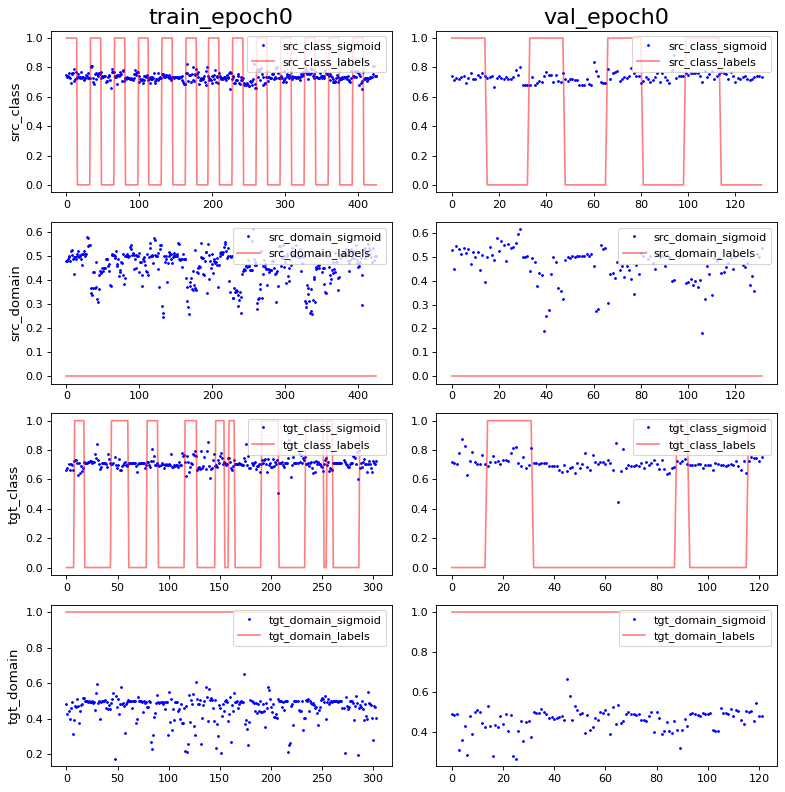

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: -2.9031182e-09 0.9895285
PCA var: [24.4      33.3      39.399998 44.399998 47.999996 51.299995 54.399994
 56.699993 58.79999  60.79999 ]
show standardize mean and std: 4.1718037e-10 0.98952854
PCA var: [21.       31.9      40.4      46.5      50.9      54.4      57.4
 60.2      62.9      65.200005]


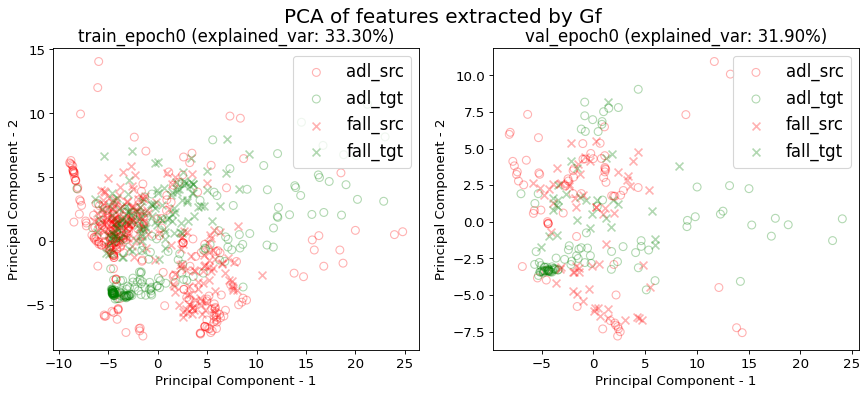

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/


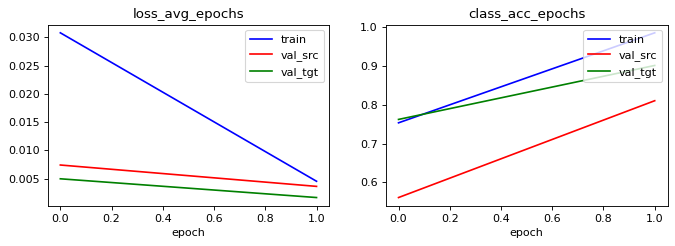

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.9765258215962441 0.7511737089201878 0.5868544600938967 0.07746478873239436
acc performance: 0.8106060606060606 0.803030303030303 0.8333333333333334 0.12121212121212122


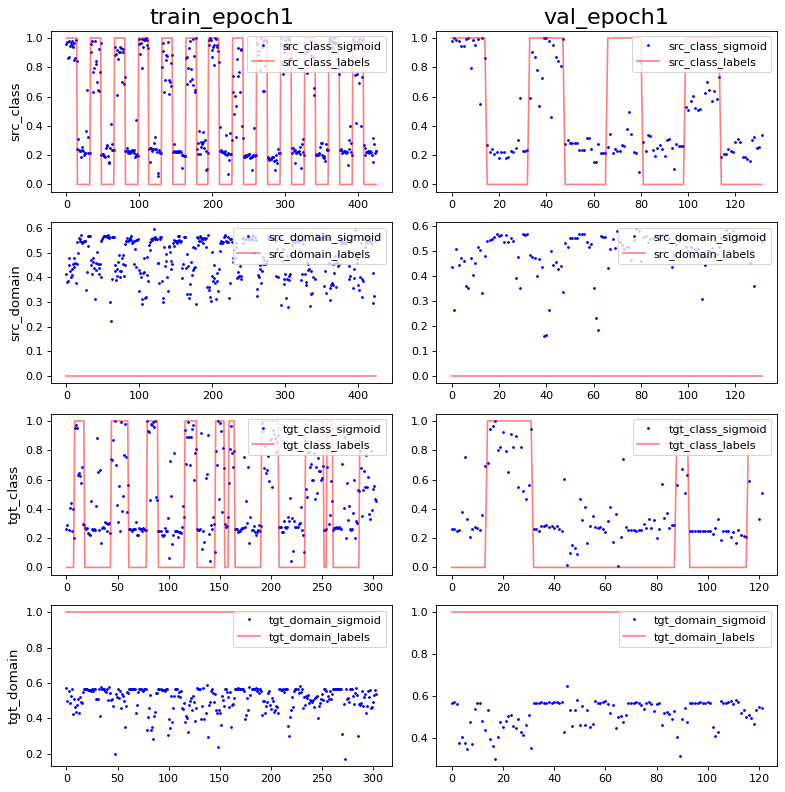

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: 3.6288977e-10 0.99999994
PCA var: [27.000002 39.300003 46.9      51.100002 54.7      57.7      60.4
 62.9      65.1      67.1     ]
show standardize mean and std: -1.6687215e-09 0.99999994
PCA var: [28.099998 39.8      46.6      51.399998 55.6      59.3      62.399998
 65.1      67.5      69.7     ]


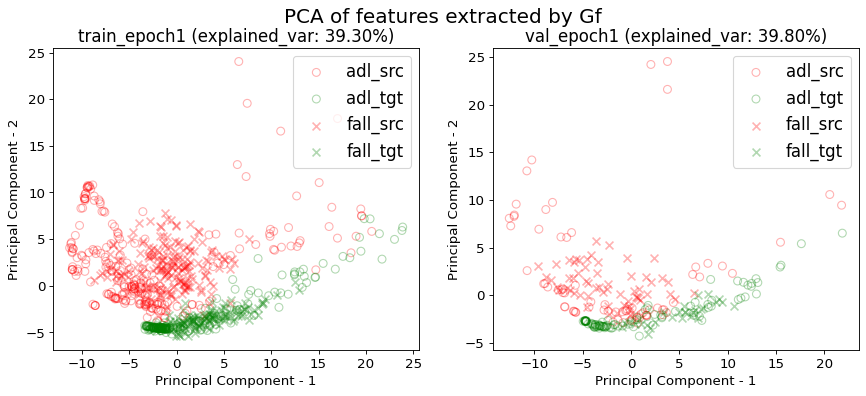

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.6370023419203747 0.9836065573770492 0.39344262295081966 0.00936768149882904
acc performance: 0.6259541984732825 0.9923664122137404 0.24427480916030533 0.0


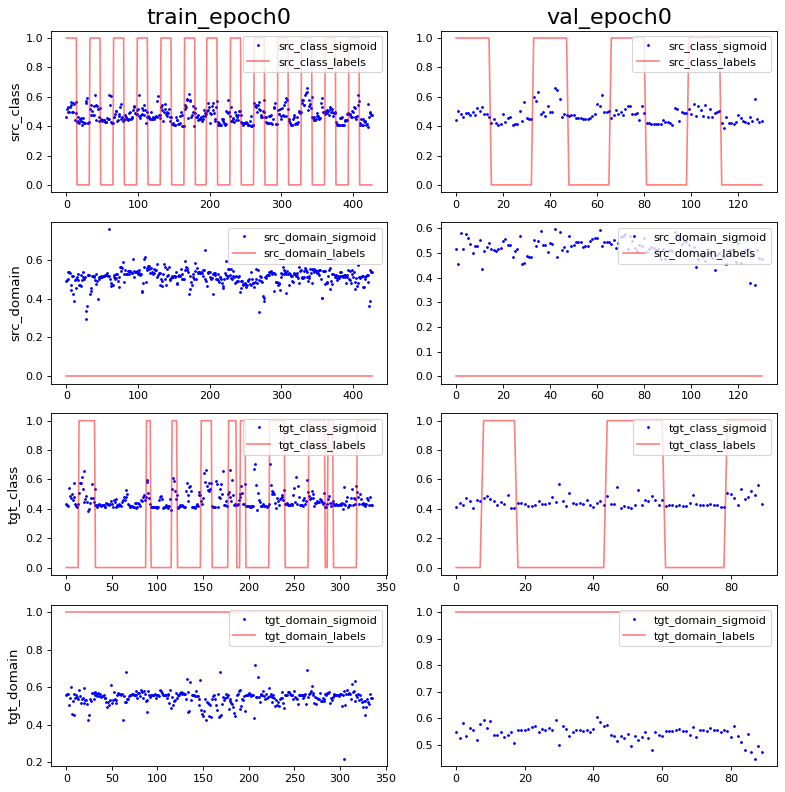

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: 5.5551147e-10 0.9930313
PCA var: [16.4 27.5 35.6 42.5 46.3 49.2 51.5 53.7 55.8 57.8]
show standardize mean and std: 3.8357943e-09 0.99303126
PCA var: [16.300001 29.400002 39.100002 48.2      53.5      56.4      59.
 61.4      63.7      65.7     ]


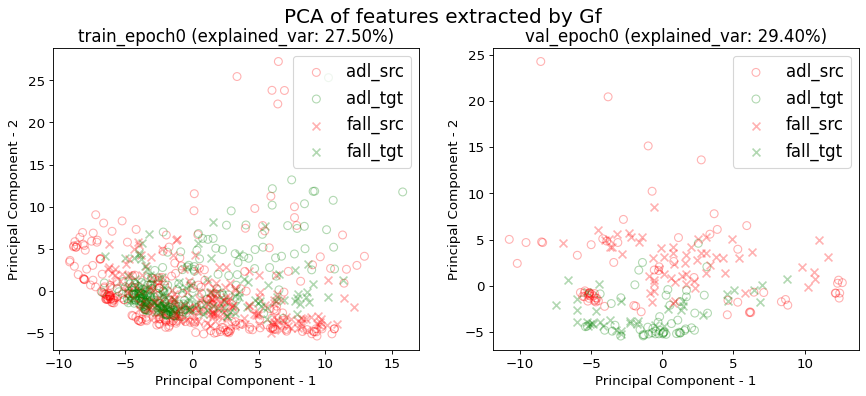

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/


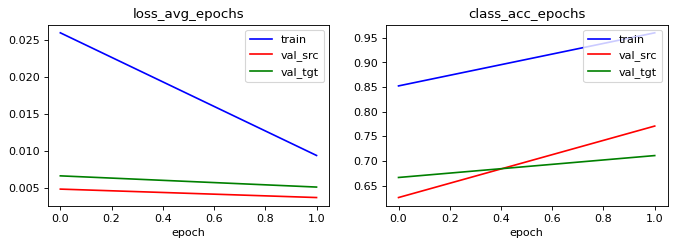

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.8032786885245902 0.9812646370023419 0.6557377049180327 0.07728337236533958
acc performance: 0.7709923664122137 1.0 0.48854961832061067 0.05343511450381679


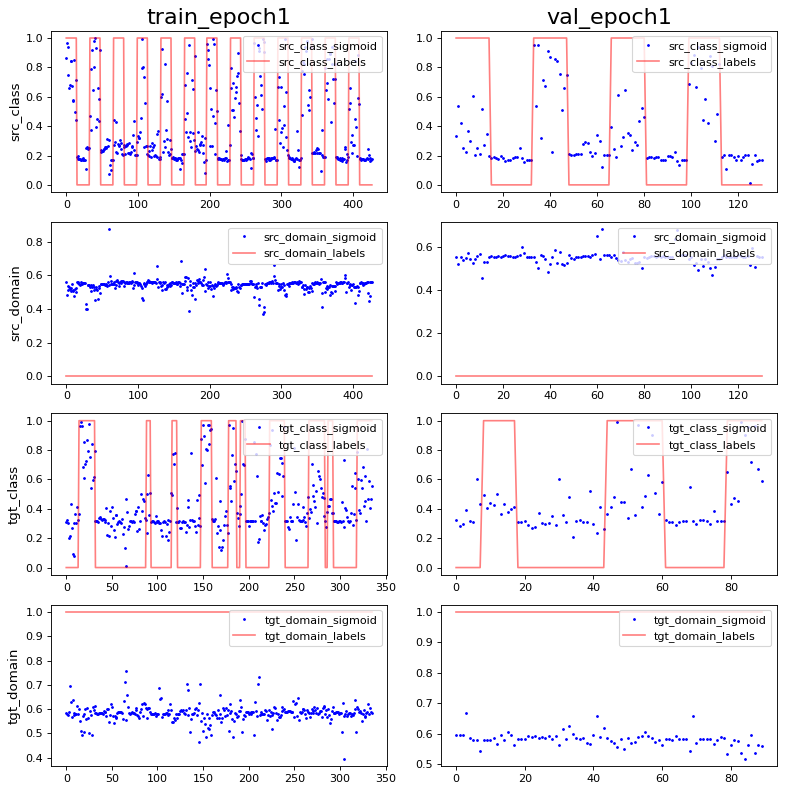

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: 1.6665345e-09 0.9930313
PCA var: [34.8      47.699997 52.1      56.3      59.5      62.1      64.6
 66.799995 68.799995 70.7     ]
show standardize mean and std: -1.9178972e-09 0.99303126
PCA var: [35.       50.9      56.800003 61.4      65.6      69.2      72.
 74.2      76.2      78.1     ]


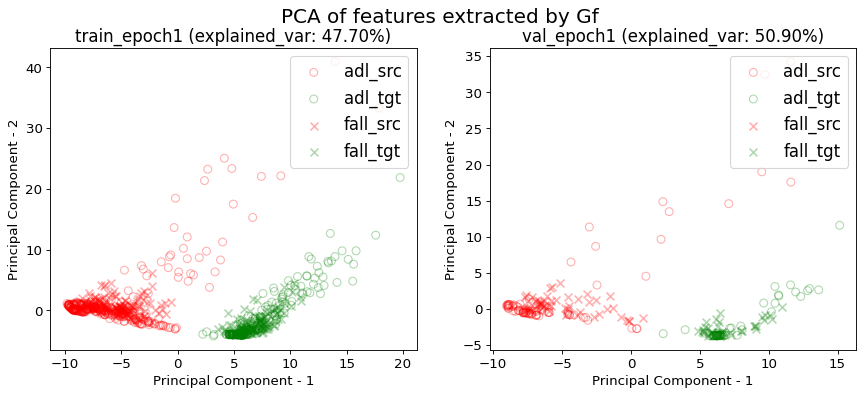

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.004534,0.985915,0.003629,0.810606,0.001655,0.901639
1,1.000000,0.009366,0.960187,0.003657,0.770992,0.005078,0.711111
mean,0.500000,0.006950,0.973051,0.003643,0.790799,0.003366,0.806375
std,0.707107,0.003416,0.018193,0.000019,0.028011,0.002420,0.134724


src val loss: 0.0036±0.0000
src val acc: 0.7908±0.0280
tgt val loss: 0.0034±0.0024
tgt val acc: 0.8064±0.1347
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UPFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 16, 'learning_rate': 0.01, 'sensor_loc': 'wrist', 'date': '2020/04/09 20:11:00', 'input_dim': (16, 3, 66), 'output_dim': (16,)}

======================  train on target, val on target(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modelo

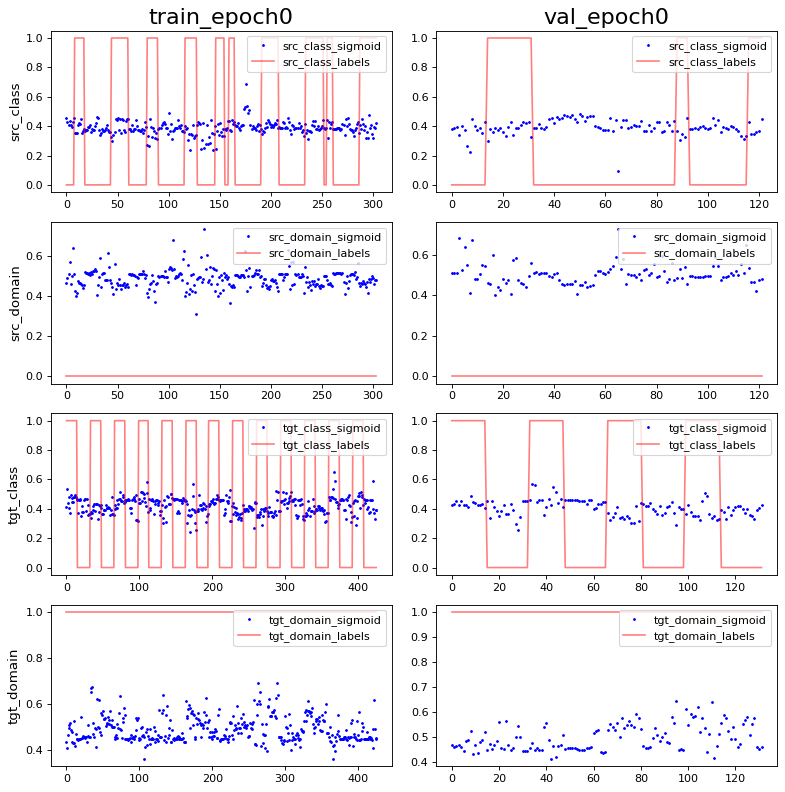

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: -2.9031183e-10 0.9965218
PCA var: [21.3      31.099998 40.199997 45.399998 49.6      53.3      56.399998
 58.699997 60.899998 62.899998]
show standardize mean and std: 2.5030822e-09 0.9965218
PCA var: [23.4      35.4      42.4      48.       52.1      55.899998 59.1
 61.699997 63.999996 66.1     ]


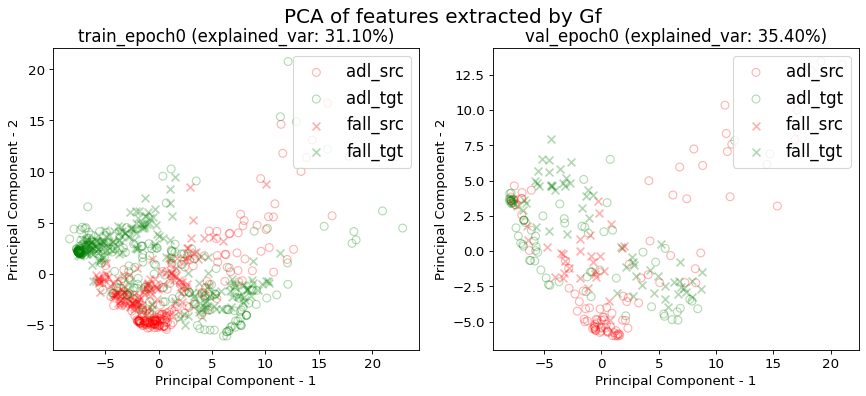

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/


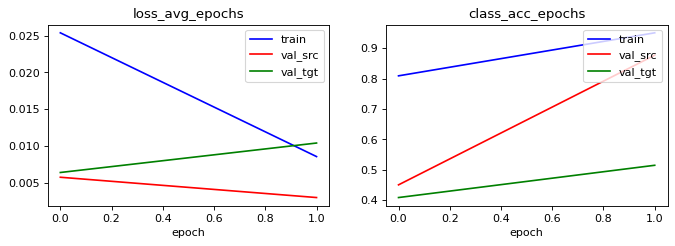

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.9506578947368421 0.7598684210526315 0.6875 0.6611842105263158
acc performance: 0.8770491803278688 0.7868852459016393 0.5573770491803278 0.5


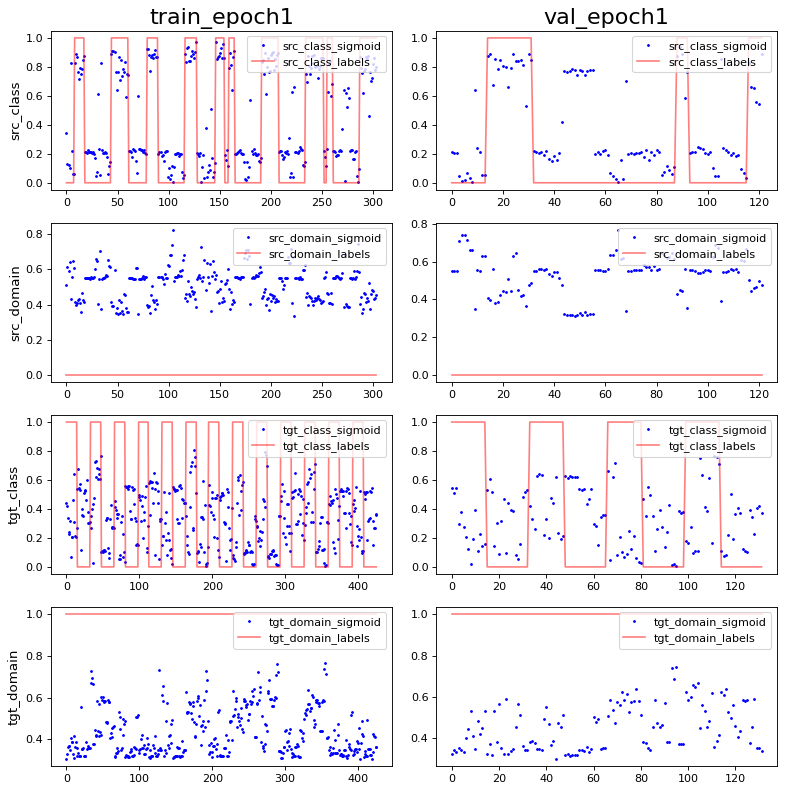

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 0.0 0.9965218
PCA var: [39.       56.       65.       70.1      73.799995 75.899994 77.49999
 78.899994 80.09999  81.19999 ]
show standardize mean and std: 2.5030822e-09 0.98952854
PCA var: [38.5      57.800003 66.3      71.8      76.100006 79.100006 80.90001
 82.600006 83.90001  85.20001 ]


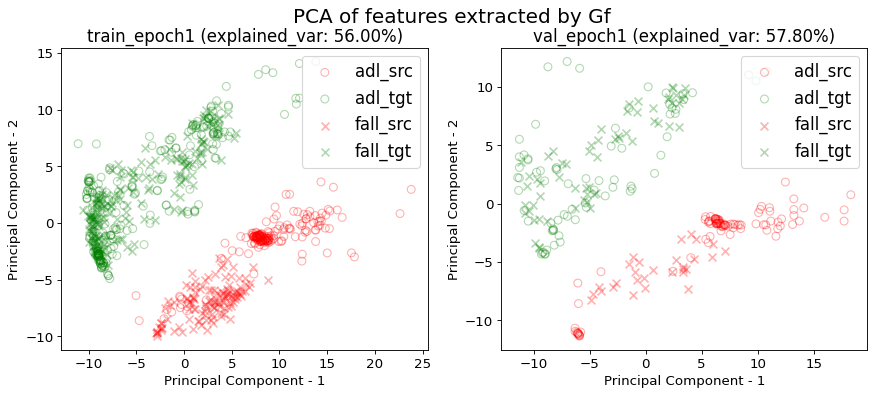

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.3333333333333333 0.011904761904761904 0.33035714285714285 1.25
acc performance: 0.36666666666666664 0.0 0.2 1.4444444444444444


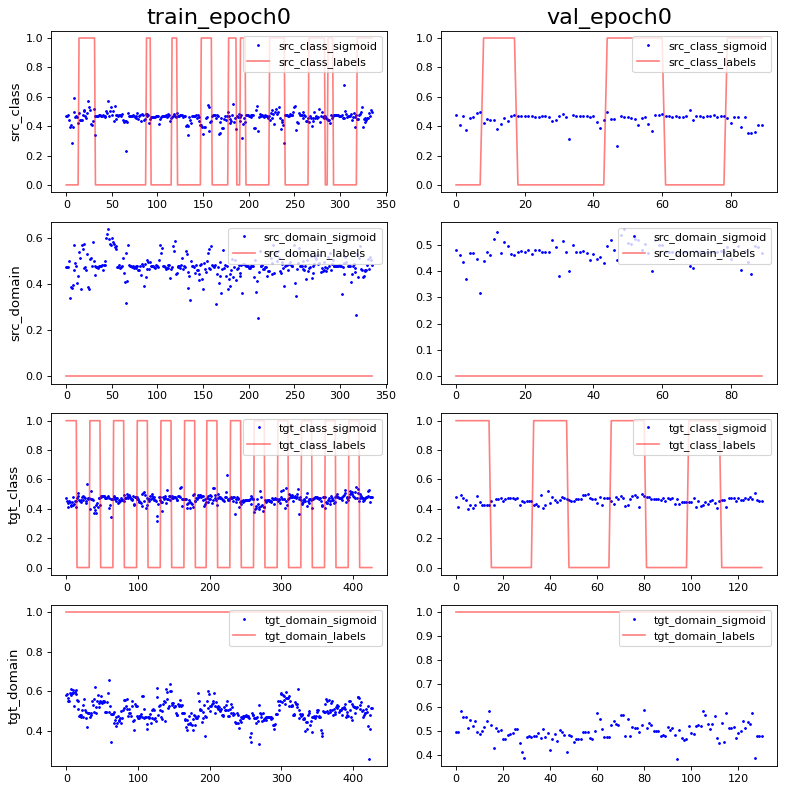

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 4.166336e-09 0.9965218
PCA var: [24.1      40.6      47.3      52.1      55.399998 57.999996 60.399998
 62.499996 64.299995 65.899994]
show standardize mean and std: 9.589486e-10 0.9965218
PCA var: [21.4      38.8      48.199997 53.299995 57.599995 60.699993 63.399994
 65.899994 68.2      70.1     ]


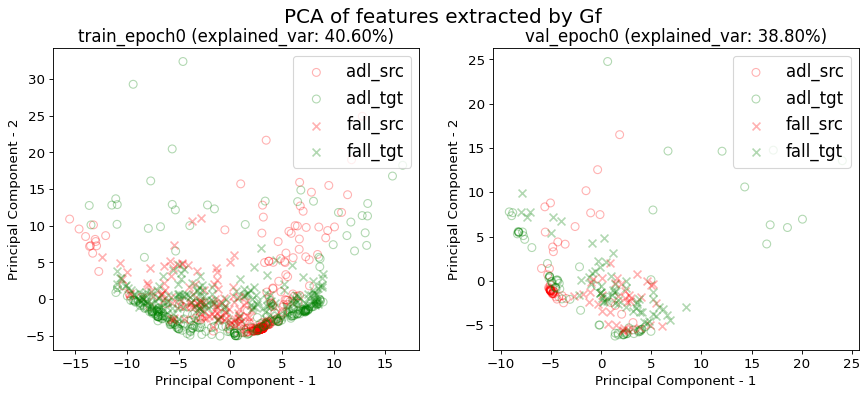

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/


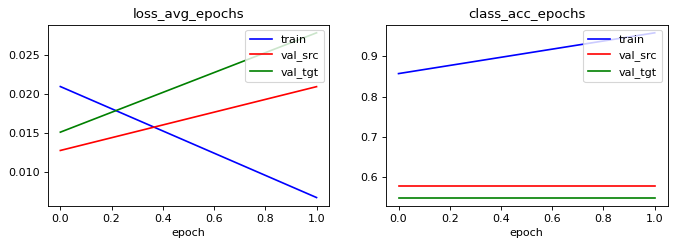

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.6607142857142857 0.017857142857142856 0.6904761904761905 1.1994047619047619
acc performance: 0.5777777777777777 0.0 0.8 1.3666666666666667


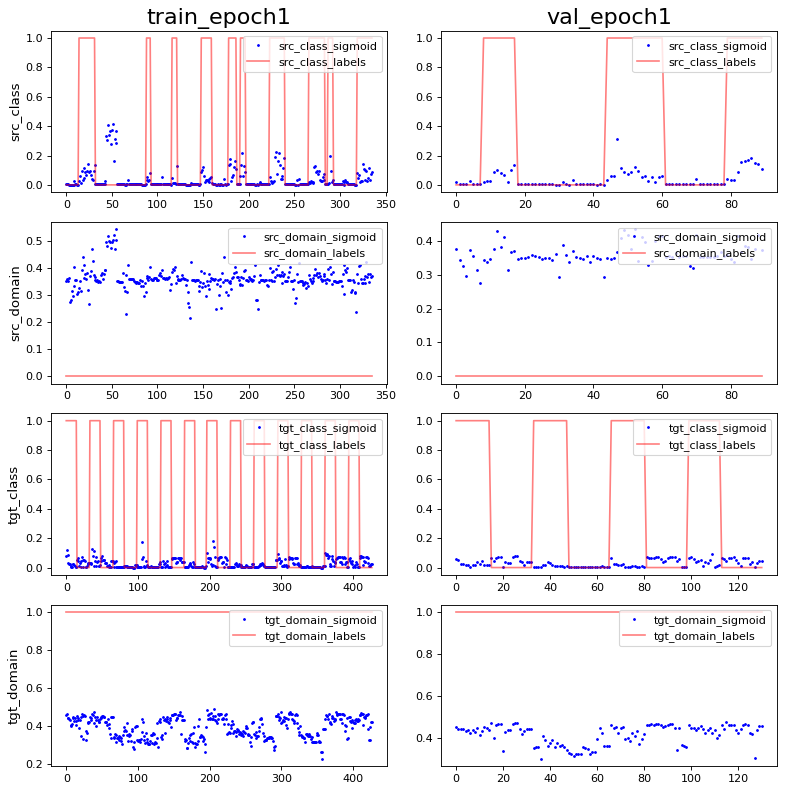

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: -1.1110229e-09 0.98952854
PCA var: [37.4 51.  57.2 62.2 65.  67.6 69.6 71.4 73.  74.6]
show standardize mean and std: 0.0 0.9718253
PCA var: [39.7      54.4      61.100002 66.600006 69.700005 72.200005 74.3
 76.3      77.9      79.4     ]


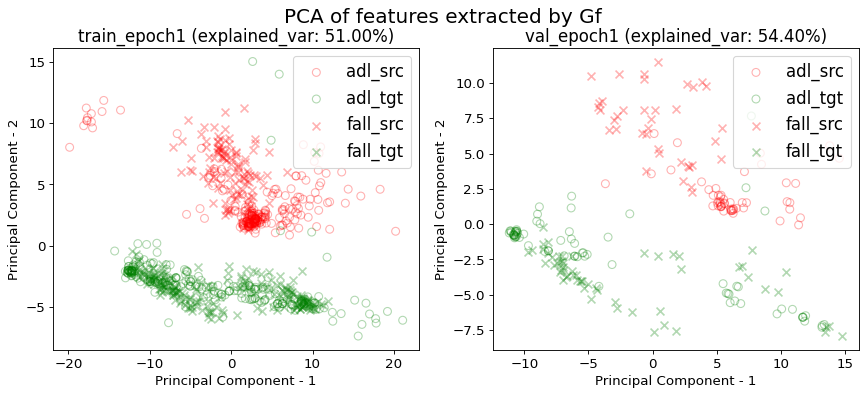

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.008538,0.950658,0.002956,0.877049,0.010385,0.515152
1,1.000000,0.006692,0.958333,0.020919,0.577778,0.027828,0.549618
mean,0.500000,0.007615,0.954496,0.011937,0.727413,0.019106,0.532385
std,0.707107,0.001306,0.005427,0.012702,0.211617,0.012334,0.024372


src val loss: 0.0119±0.0127
src val acc: 0.7274±0.2116
tgt val loss: 0.0191±0.0123
tgt val acc: 0.5324±0.0244
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 426, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UMAFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 16, 'learning_rate': 0.01, 'sensor_loc': 'ankle', 'date': '2020/04/09 20:11:12', 'input_dim': (16, 3, 66), 'output_dim': (16,)}

======================  DANN training transferring knowledge(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2

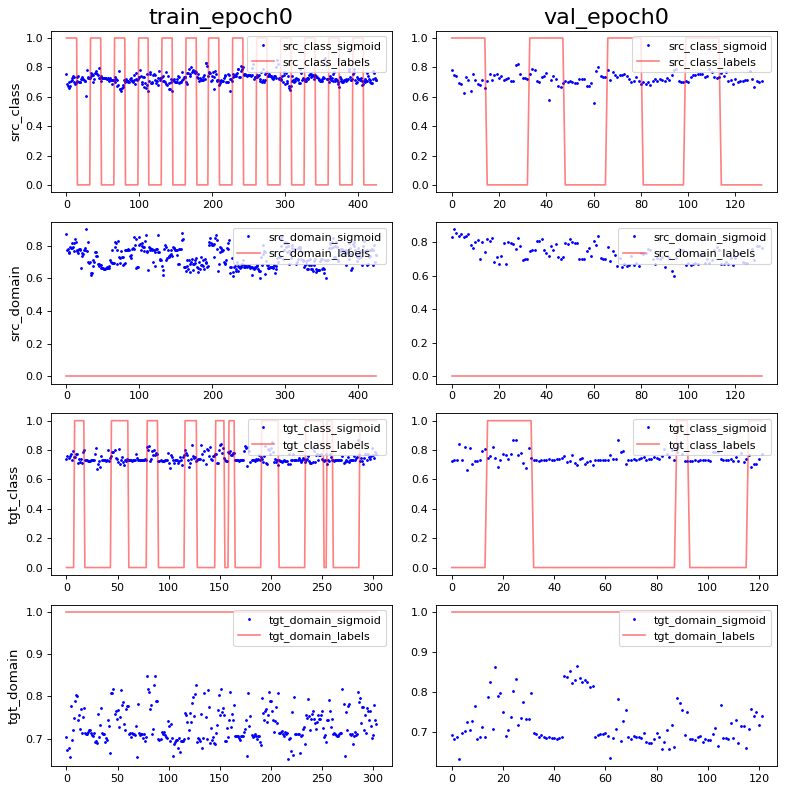

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: -4.0643653e-09 1.0
PCA var: [20.1      36.8      42.8      47.5      51.2      54.8      57.3
 59.6      61.699997 63.399998]
show standardize mean and std: 3.337443e-09 0.9965218
PCA var: [21.699999 37.8      46.5      51.8      55.8      58.899998 61.699997
 64.2      66.399994 68.399994]


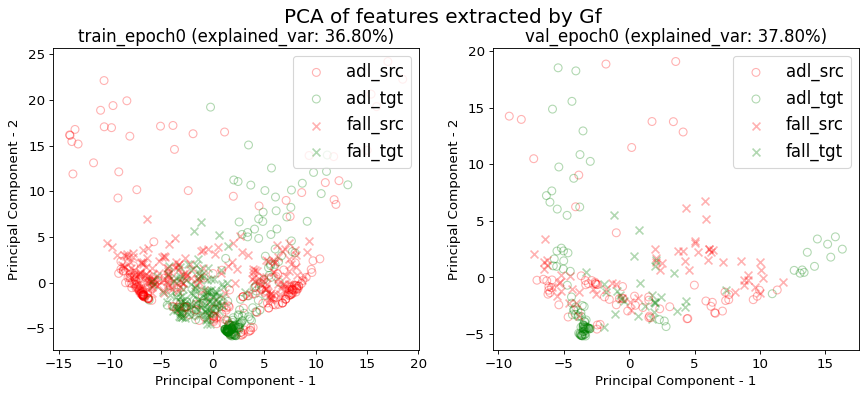

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/


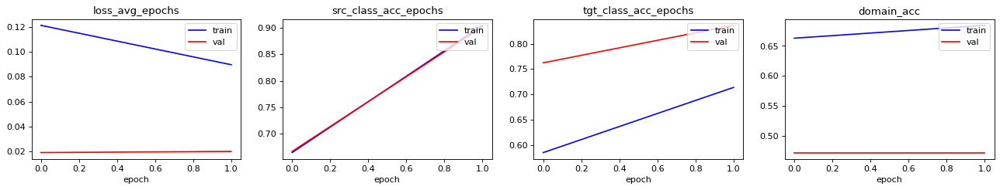

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.9366197183098591 0.33098591549295775 0.45774647887323944 0.3286384976525822
acc performance: 0.9015151515151515 0.4318181818181818 0.7727272727272727 0.4772727272727273


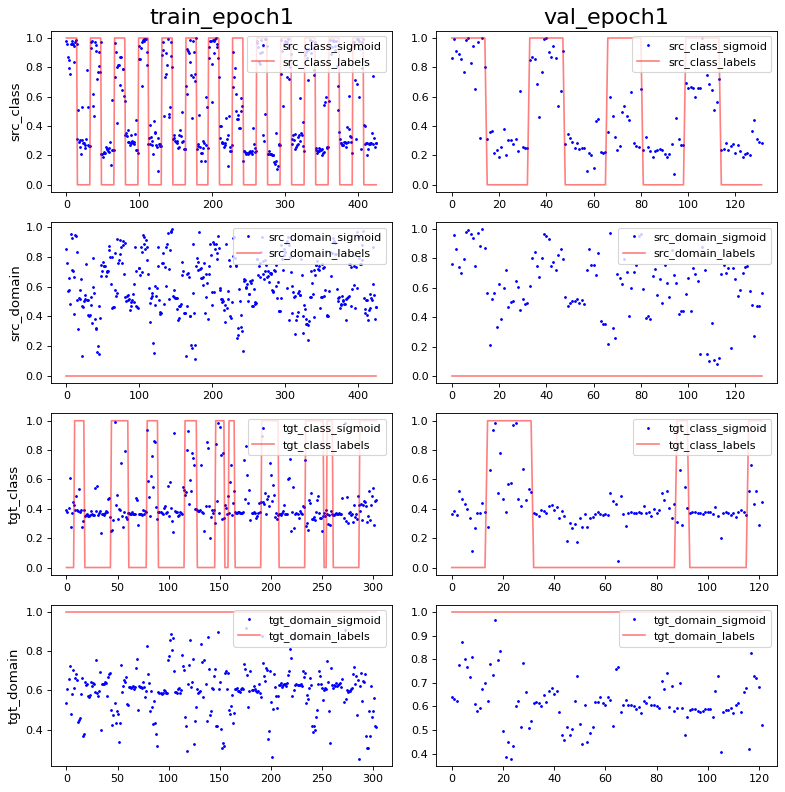

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: -2.3224946e-09 1.0
PCA var: [66.2      72.1      76.7      79.2      81.299995 82.7      84.
 85.2      86.1      86.9     ]
show standardize mean and std: 0.0 0.99999994
PCA var: [56.1      65.       73.1      75.7      78.2      80.2      81.899994
 83.399994 84.59999  85.69999 ]


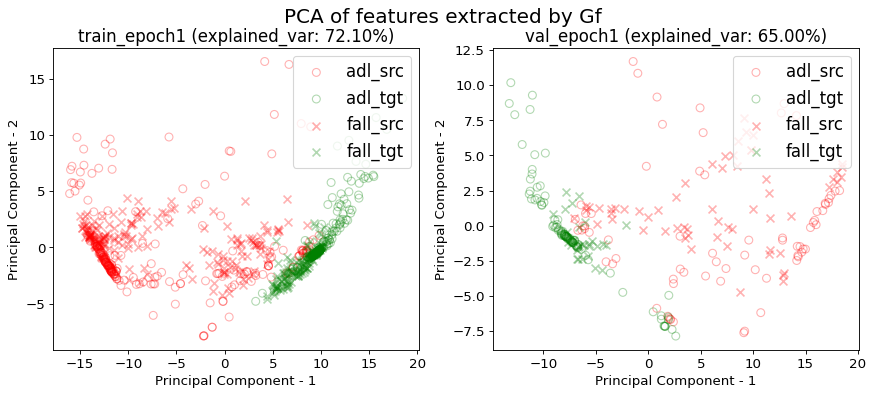

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.5433255269320844 1.0 0.5199063231850117 0.0
acc performance: 0.549618320610687 1.0 0.3969465648854962 0.0


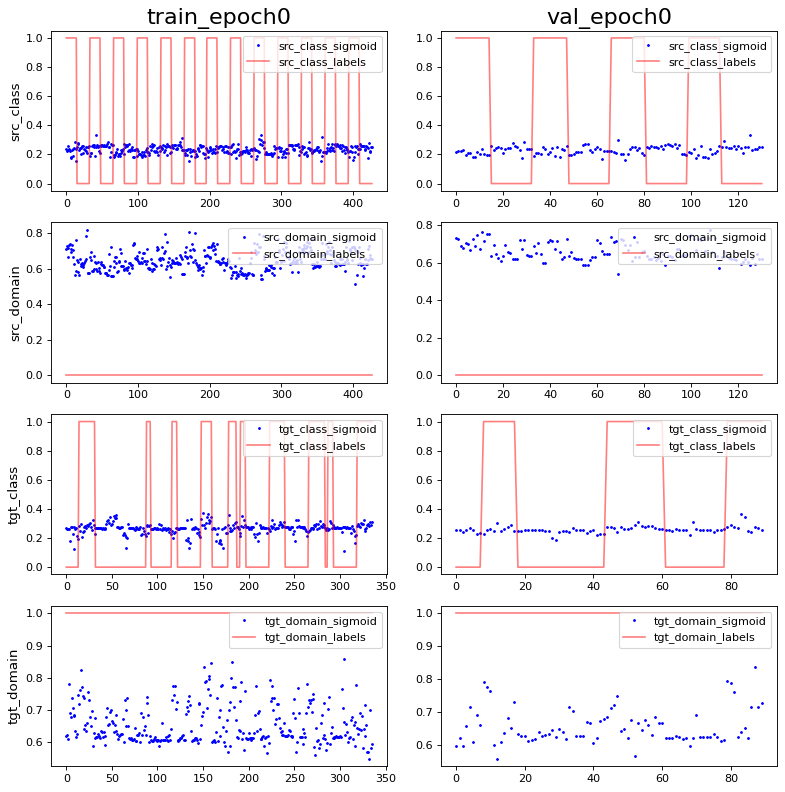

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 2.7775574e-10 0.9965217
PCA var: [27.2      41.300003 48.500004 53.200005 56.600006 59.500008 61.600006
 63.500008 65.100006 66.600006]
show standardize mean and std: -1.9178972e-09 0.99303126
PCA var: [23.4      35.6      44.899998 51.6      57.       60.9      63.7
 66.3      68.5      70.5     ]


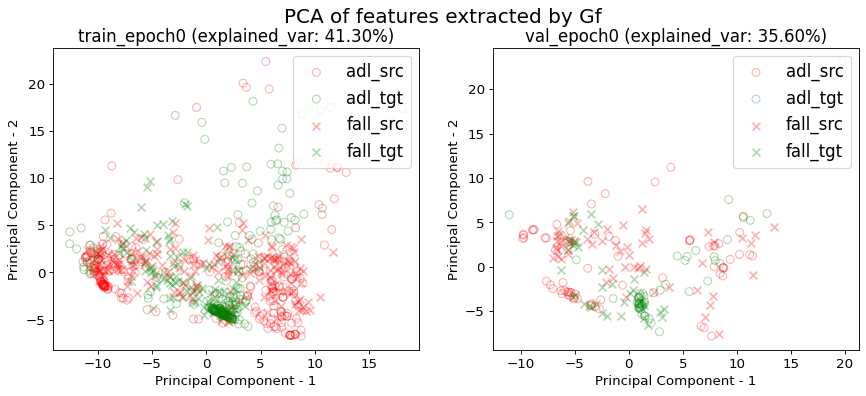

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/


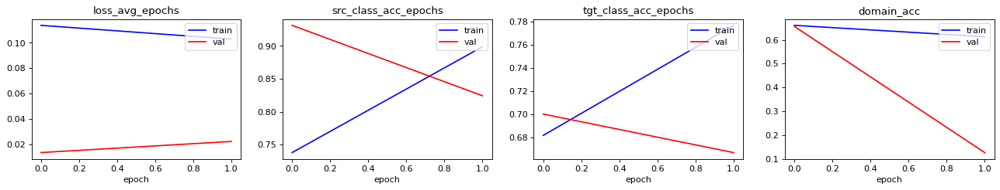

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.8266978922716628 0.17096018735362997 0.5550351288056206 0.07259953161592506
acc performance: 0.8244274809160306 0.13740458015267176 0.4580152671755725 0.07633587786259542


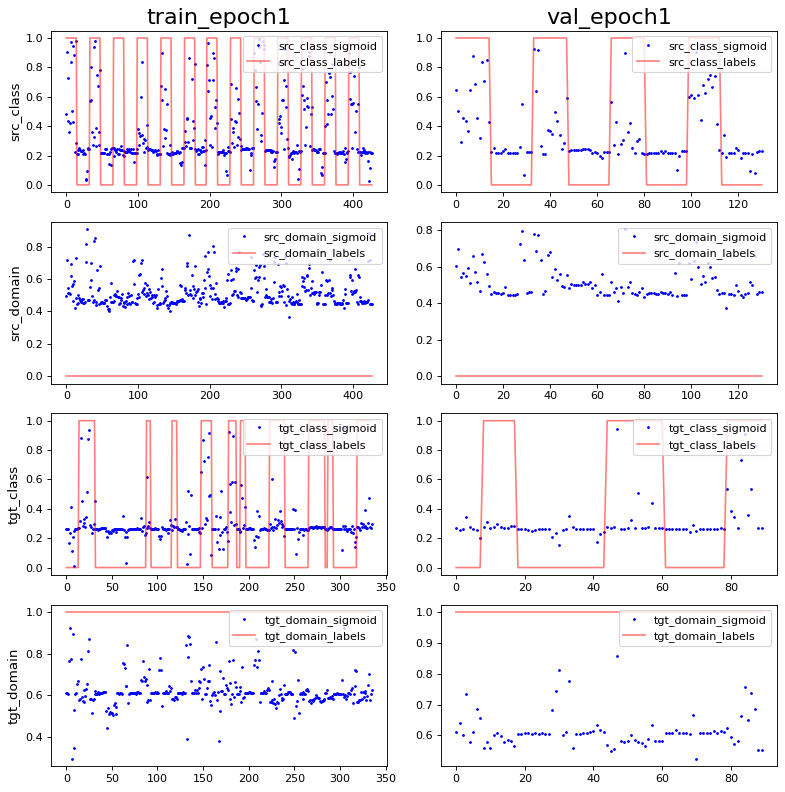

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 3.4025078e-09 0.9965218
PCA var: [21.       38.       43.6      48.1      51.699997 54.999996 58.099995
 60.899994 63.399994 65.59999 ]
show standardize mean and std: 4.794743e-09 0.99303126
PCA var: [25.099998 42.699997 50.399998 56.899998 62.1      67.       70.2
 72.899994 75.399994 77.59999 ]


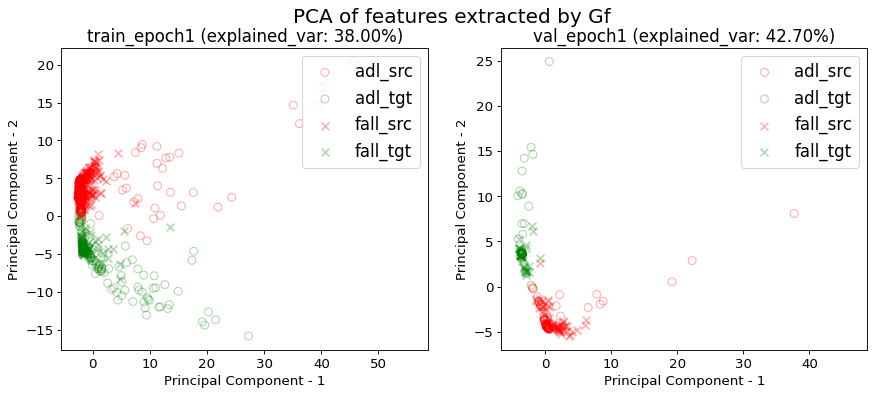

---------------Exporting model performance---------------
show df_performance


,i_CV,train_src_class_loss,train_tgt_class_loss,train_src_domain_loss,train_tgt_domain_loss,train_src_class_acc,train_tgt_class_acc,train_domain_acc,val_src_class_loss,val_tgt_class_loss,val_src_domain_loss,val_tgt_domain_loss,val_src_class_acc,val_tgt_class_acc,val_domain_acc
0,0.000000,0.017387,0.036863,0.038944,0.033326,0.904605,0.713816,0.684211,0.002543,0.002965,0.011121,0.006448,0.901515,0.836066,0.472441
1,1.000000,0.017422,0.033849,0.048806,0.036694,0.898810,0.776786,0.613095,0.002984,0.007067,0.009065,0.010428,0.824427,0.666667,0.126697
mean,0.500000,0.017405,0.035356,0.043875,0.035010,0.901707,0.745301,0.648653,0.002764,0.005016,0.010093,0.008438,0.862971,0.751366,0.299569
std,0.707107,0.000024,0.002132,0.006974,0.002382,0.004098,0.044526,0.050286,0.000312,0.002900,0.001454,0.002814,0.054509,0.119783,0.244478


val_src_class_acc: 0.8630±0.0545
val_tgt_class_acc: 0.7514±0.1198
val_domain_acc: 0.2996±0.2445
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'src_dataset_name': 'UPFall', 'tgt_dataset_name': 'UMAFall', 'src_sensor_loc': 'wrist', 'tgt_sensor_loc': 'ankle', 'date': '2020/04/09 20:11:26', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 16, 'learning_rate': 0.01, 'input_dim': (16, 3, 66), 'output_dim': 2, 'label_dim': (16,)}
val_tgt_class_acc: 0.7514±0.1198
val_domain_acc: 0.2996±0.2445
time elapsed: 00:00:38

======================  train on source, val on target(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
FeatureExtracto

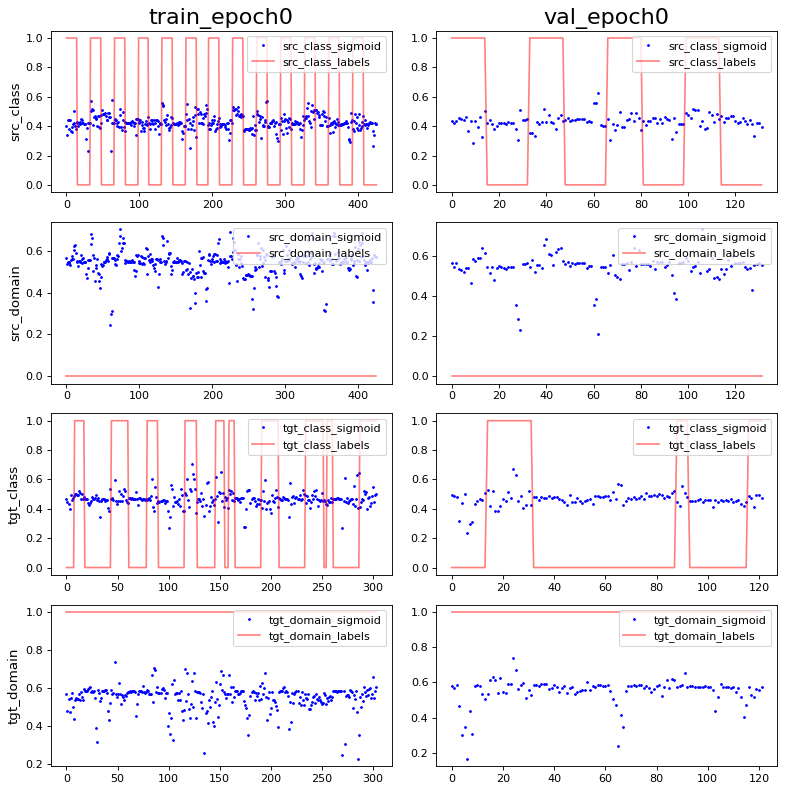

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: -4.0643653e-09 0.9965218
PCA var: [25.2 38.3 47.3 52.3 55.7 58.5 61.  63.  64.8 66.4]
show standardize mean and std: -5.0061644e-09 0.9965217
PCA var: [21.6      34.9      45.9      50.600002 54.4      57.800003 60.800003
 63.4      65.8      68.      ]


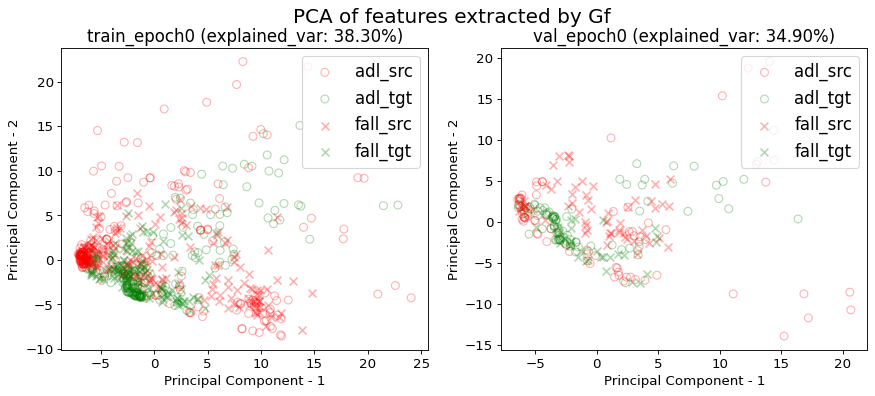

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/


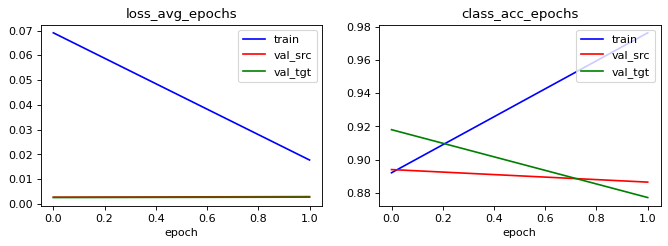

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.971830985915493 0.05868544600938967 0.5938967136150235 0.7136150234741784
acc performance: 0.8863636363636364 0.030303030303030304 0.8106060606060606 0.9242424242424242


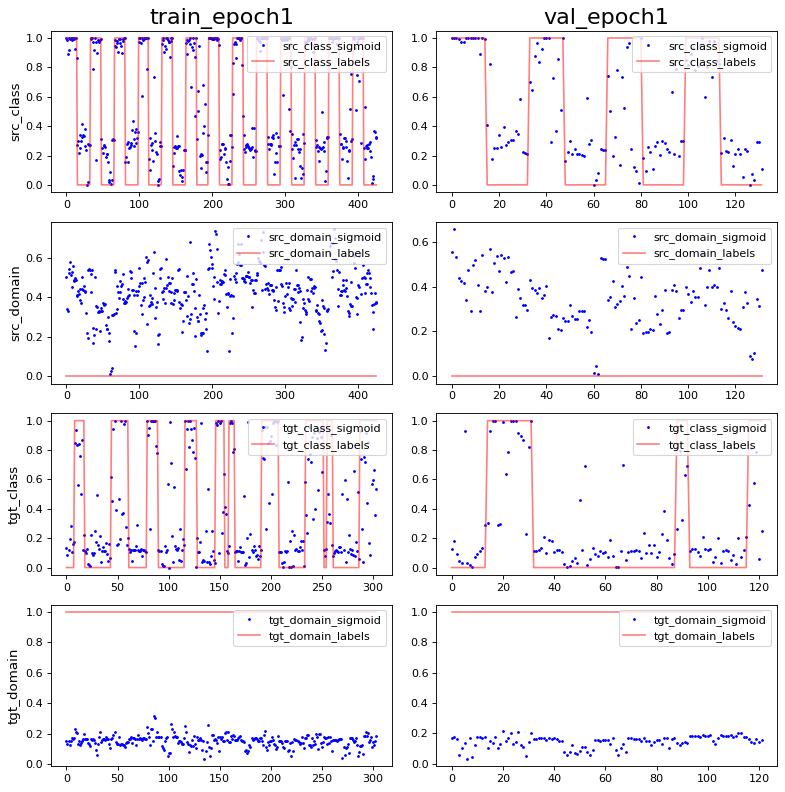

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: 4.644989e-08 1.0
PCA var: [61.1      66.799995 71.299995 74.6      76.799995 78.6      80.1
 81.4      82.6      83.7     ]
show standardize mean and std: 3.337443e-09 0.99999994
PCA var: [56.199997 64.2      69.       73.       76.2      78.899994 81.2
 83.       84.6      86.      ]


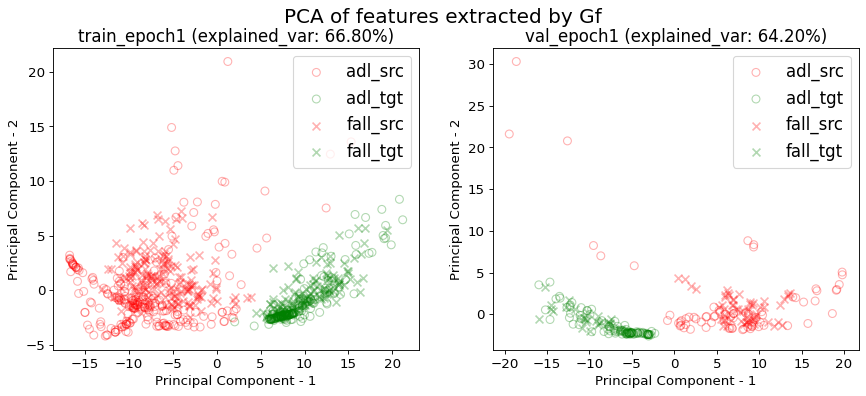

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.4566744730679157 0.4847775175644028 0.26697892271662765 0.5105386416861827
acc performance: 0.45038167938931295 0.5190839694656488 0.2900763358778626 0.4580152671755725


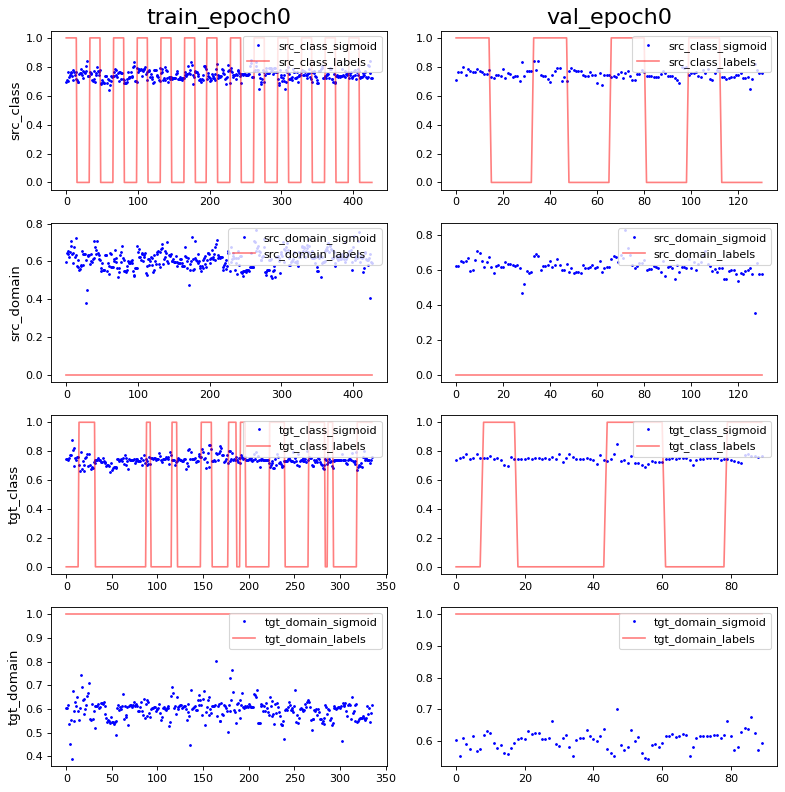

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: -1.3887787e-10 0.9965217
PCA var: [24.3 33.1 38.5 43.2 47.2 50.2 52.7 55.  57.  58.8]
show standardize mean and std: 1.9178972e-09 0.9965218
PCA var: [21.199999 30.199999 38.1      44.1      49.       53.1      56.5
 59.7      62.5      64.8     ]


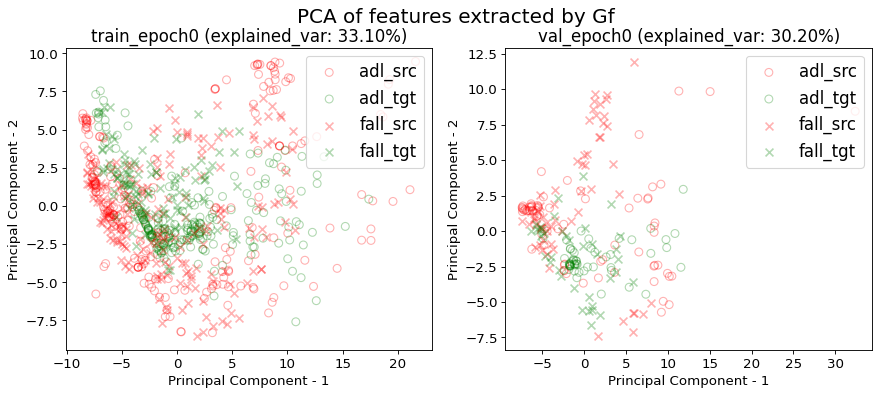

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/


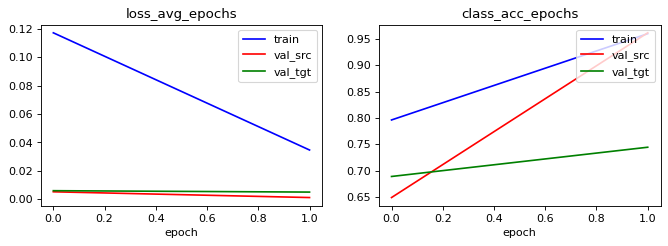

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.9601873536299765 0.5128805620608899 0.6463700234192038 0.5035128805620609
acc performance: 0.9618320610687023 0.5038167938931297 0.5114503816793893 0.4961832061068702


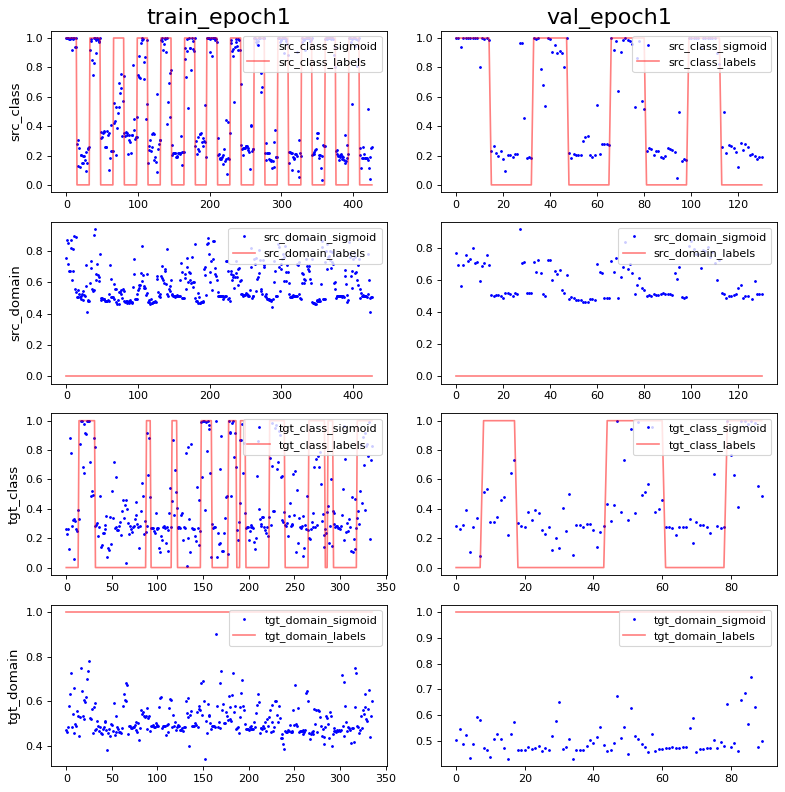

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: -5.5551147e-10 0.9965217
PCA var: [30.4      44.199997 50.6      55.5      58.2      60.7      63.
 64.9      66.700005 68.3     ]
show standardize mean and std: 3.8357943e-09 0.99303126
PCA var: [30.7      45.8      52.6      58.399998 62.199997 65.5      68.1
 70.5      72.6      74.6     ]


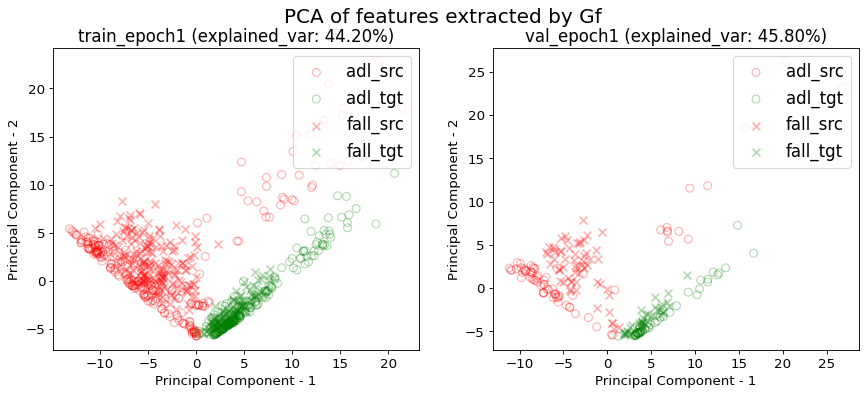

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.017762,0.976526,0.003007,0.886364,0.002785,0.877049
1,1.000000,0.034688,0.960187,0.001200,0.961832,0.005044,0.744444
mean,0.500000,0.026225,0.968357,0.002104,0.924098,0.003915,0.810747
std,0.707107,0.011968,0.011553,0.001277,0.053364,0.001597,0.093766


src val loss: 0.0021±0.0013
src val acc: 0.9241±0.0534
tgt val loss: 0.0039±0.0016
tgt val acc: 0.8107±0.0938
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UPFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.01, 'sensor_loc': 'wrist', 'date': '2020/04/09 20:11:40', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  train on target, val on target(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutp

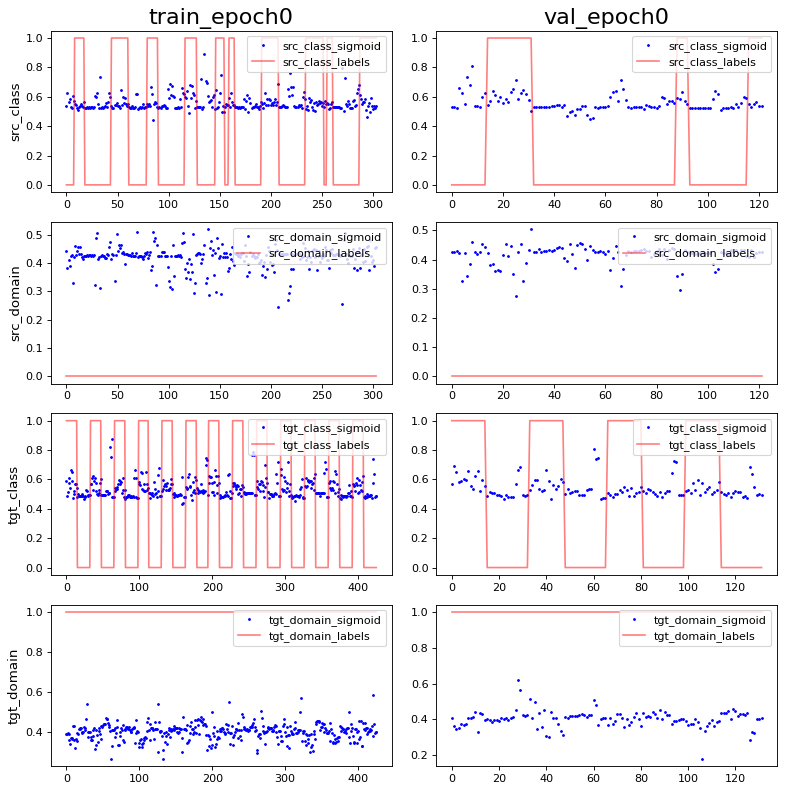

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 1.2338253e-09 0.9965218
PCA var: [27.7      35.9      40.5      44.3      47.899998 50.899998 53.399998
 55.699997 57.899998 59.899998]
show standardize mean and std: -8.3436075e-10 1.0
PCA var: [26.300001 35.       41.3      46.       50.1      53.6      56.8
 59.7      62.100002 64.3     ]


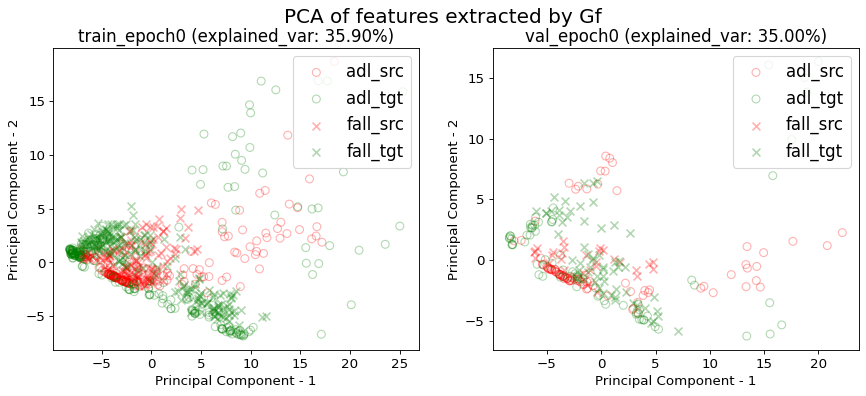

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/


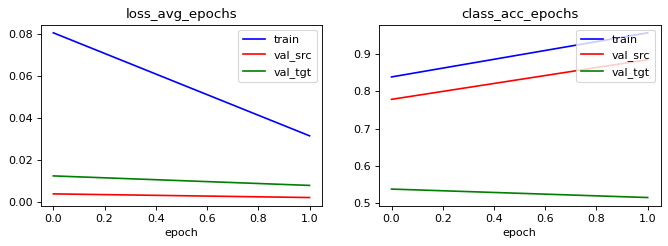

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.9605263157894737 0.0 0.9407894736842105 1.394736842105263
acc performance: 0.8852459016393442 0.0 0.5573770491803278 1.0573770491803278


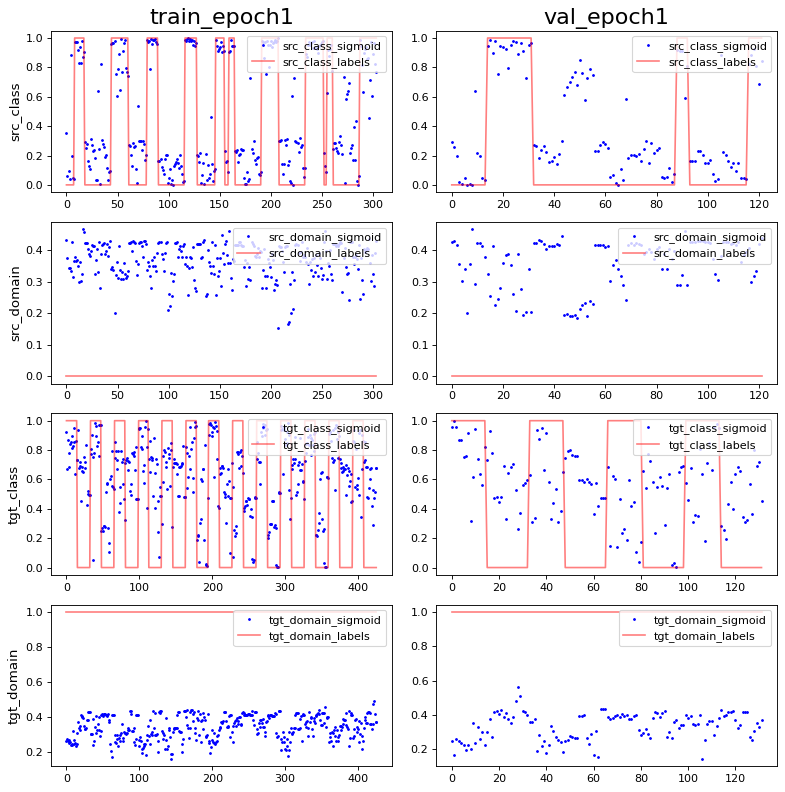

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: -5.8062366e-10 0.9965218
PCA var: [25.7      46.9      53.100002 57.7      60.9      63.7      66.
 68.1      69.9      71.6     ]
show standardize mean and std: 0.0 0.98952854
PCA var: [29.6      53.300003 58.4      62.800003 66.700005 69.9      72.3
 74.3      76.200005 77.9     ]


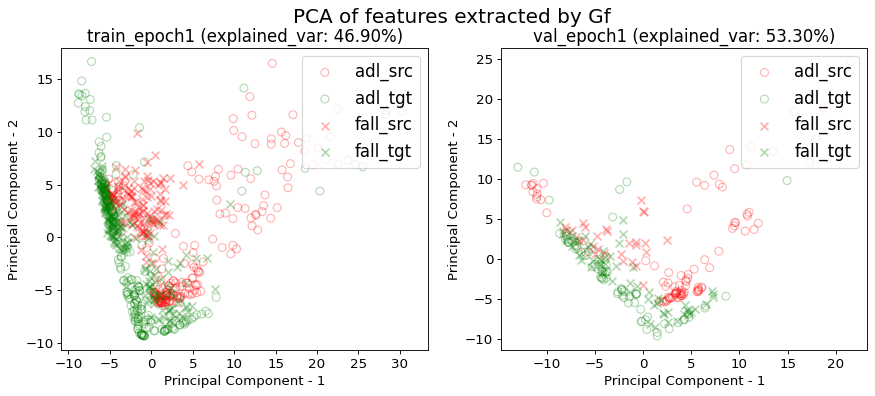

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.7261904761904762 0.01488095238095238 0.5952380952380952 1.2321428571428572
acc performance: 0.5888888888888889 0.0 0.6333333333333333 1.4444444444444444


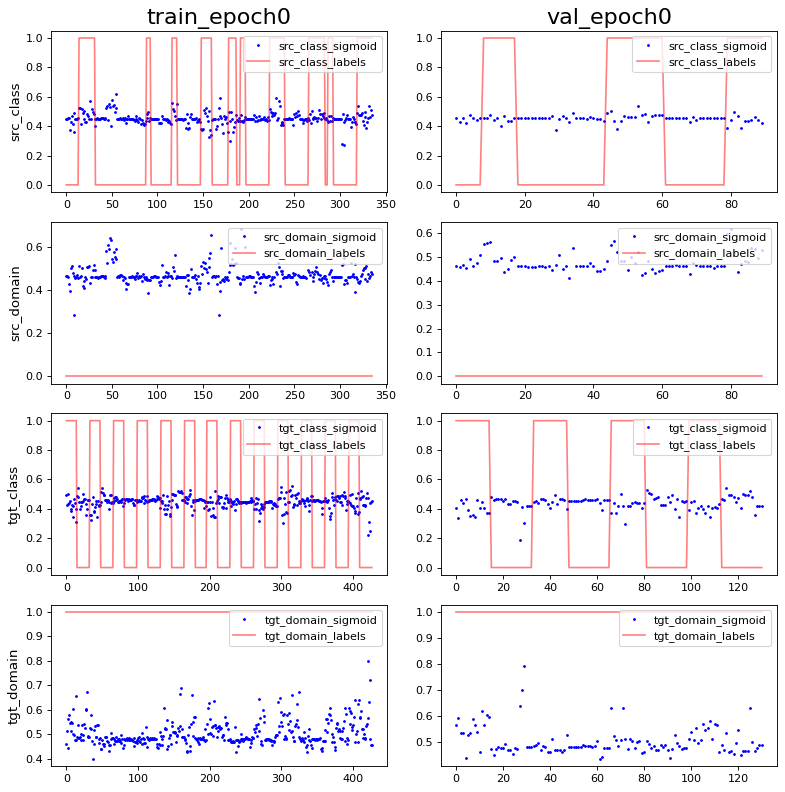

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 2.7775573e-09 0.9930313
PCA var: [21.9      32.1      40.8      45.7      49.5      52.5      55.2
 57.7      60.100002 62.2     ]
show standardize mean and std: 0.0 0.99303126
PCA var: [22.       32.4      40.7      47.4      52.100002 56.300003 59.600002
 62.500004 65.100006 67.50001 ]


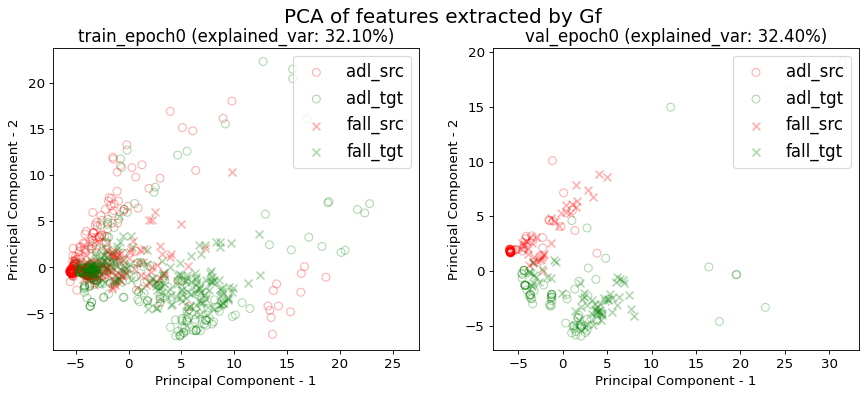

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/


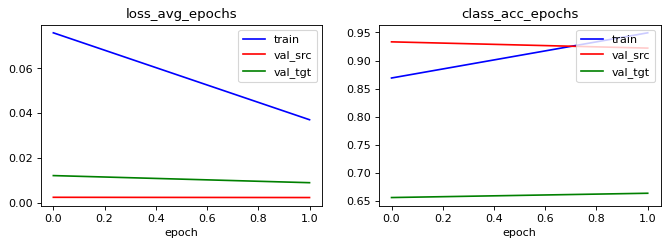

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.9732142857142857 0.14583333333333334 0.9523809523809523 0.7648809523809523
acc performance: 0.9222222222222223 0.16666666666666666 0.9666666666666667 0.7


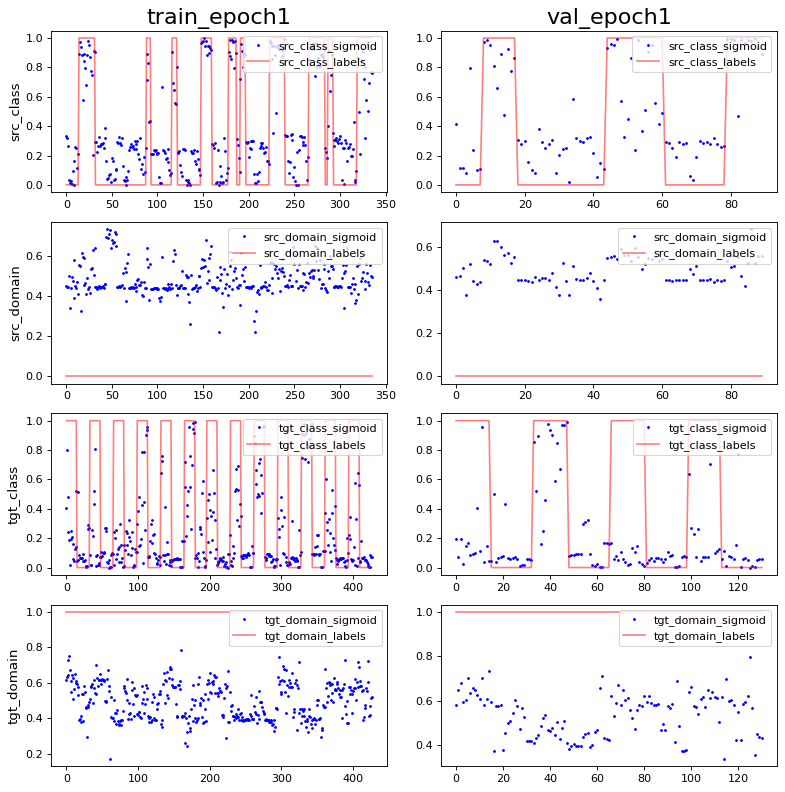

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 6.666138e-09 0.99303126
PCA var: [34.4      48.100002 54.9      59.9      62.800003 65.4      67.8
 69.9      71.8      73.600006]
show standardize mean and std: 0.0 0.99303126
PCA var: [39.1 51.6 60.  64.8 68.3 71.5 74.1 76.4 78.4 80. ]


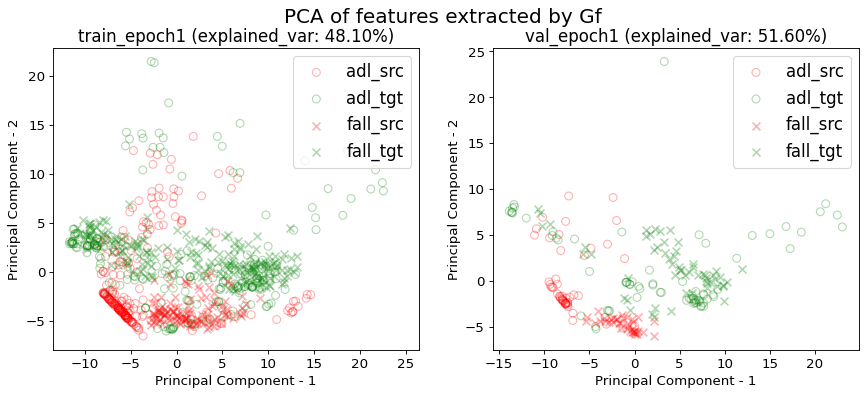

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.031469,0.957237,0.001934,0.885246,0.007740,0.515152
1,1.000000,0.037128,0.949405,0.002458,0.922222,0.009075,0.664122
mean,0.500000,0.034298,0.953321,0.002196,0.903734,0.008408,0.589637
std,0.707107,0.004001,0.005538,0.000371,0.026146,0.000944,0.105338


src val loss: 0.0022±0.0004
src val acc: 0.9037±0.0261
tgt val loss: 0.0084±0.0009
tgt val acc: 0.5896±0.1053
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 426, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UMAFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.01, 'sensor_loc': 'ankle', 'date': '2020/04/09 20:11:54', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  DANN training transferring knowledge(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_mo

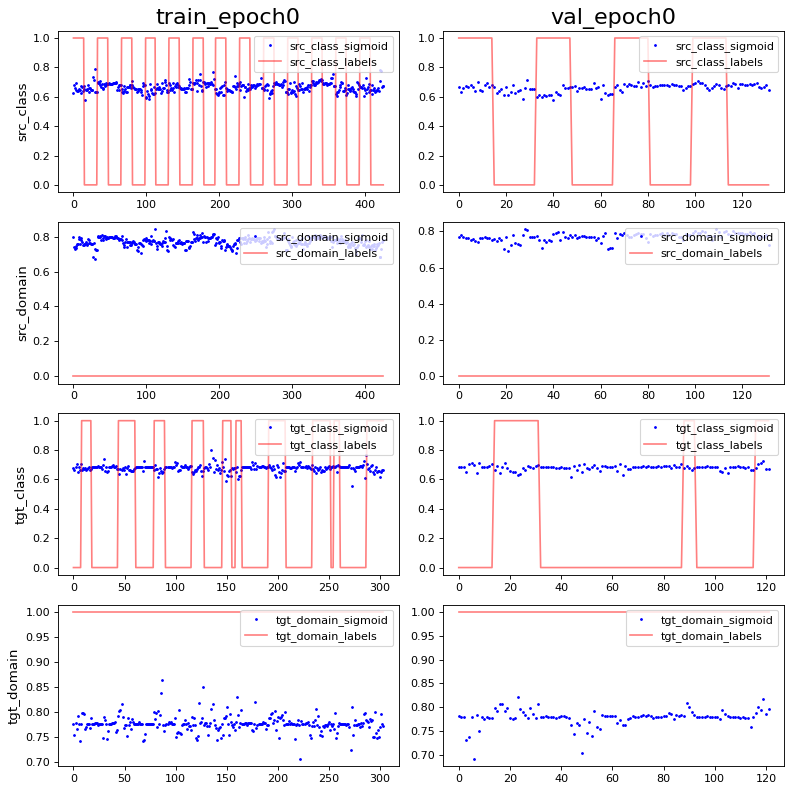

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: -2.0321826e-09 0.9965218
PCA var: [16.       26.5      33.4      37.4      41.       44.2      47.100002
 49.7      51.9      54.      ]
show standardize mean and std: -4.171804e-09 0.9930312
PCA var: [21.5      34.5      41.7      46.2      50.4      54.2      57.600002
 60.7      63.3      65.8     ]


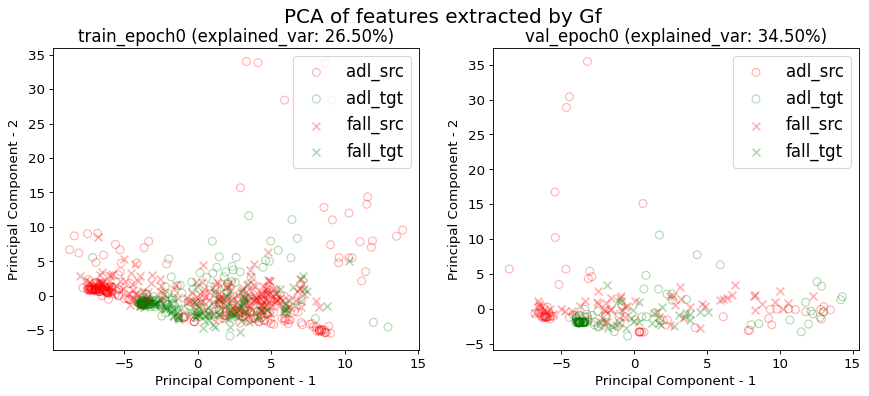

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/


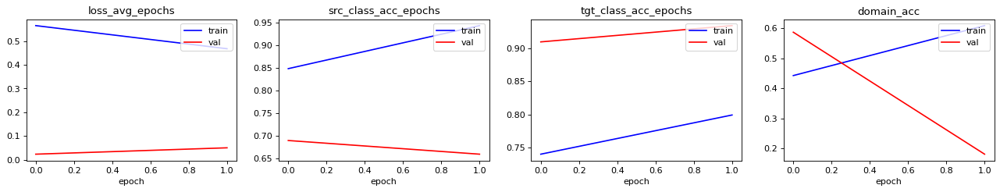

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.7723004694835681 0.2652582159624413 0.5211267605633803 0.2511737089201878
acc performance: 0.6590909090909091 0.05303030303030303 0.8636363636363636 0.29545454545454547


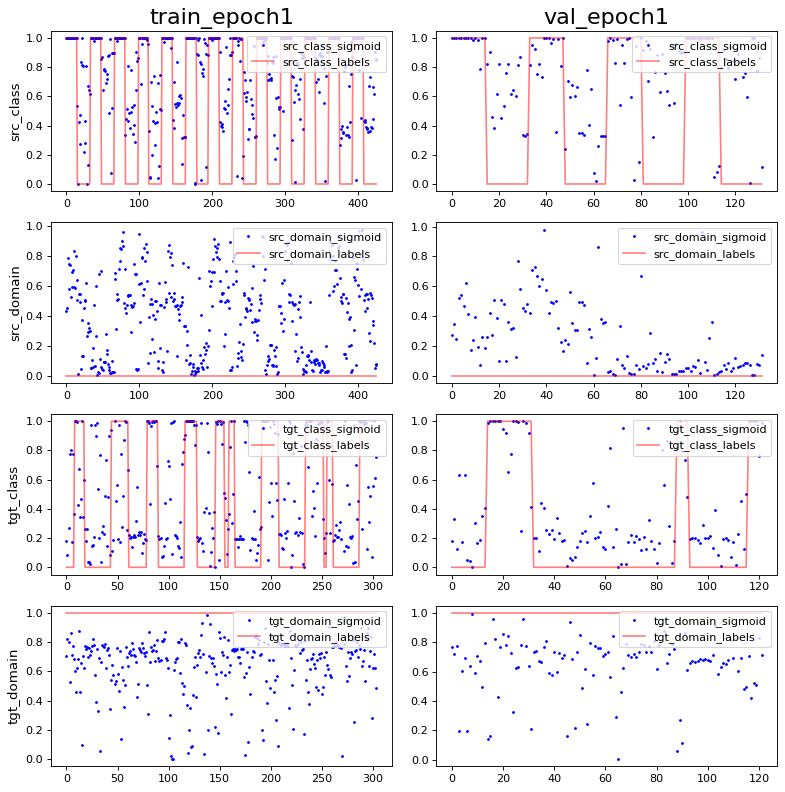

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: -5.8062366e-10 0.9965218
PCA var: [35.9      51.300003 57.4      62.600002 65.700005 68.600006 70.600006
 72.200005 73.700005 75.100006]
show standardize mean and std: -5.0061644e-09 0.99303126
PCA var: [39.3      53.5      59.3      63.8      67.4      70.200005 72.8
 75.       76.9      78.6     ]


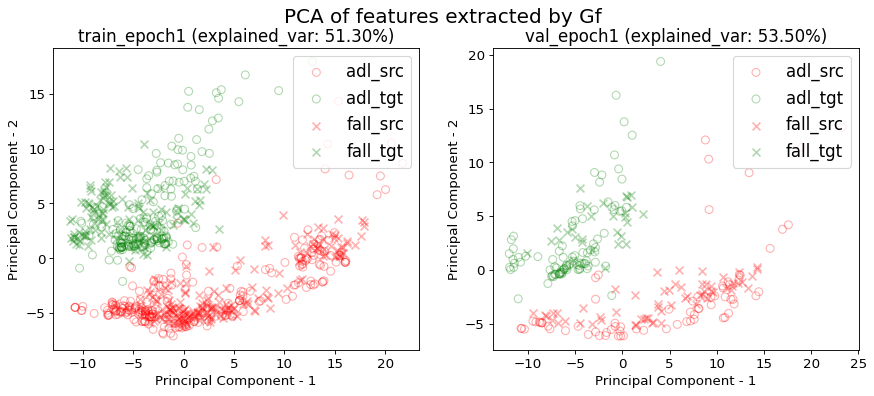

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.468384074941452 1.0 0.27634660421545665 0.0
acc performance: 0.45038167938931295 1.0 0.2900763358778626 0.0


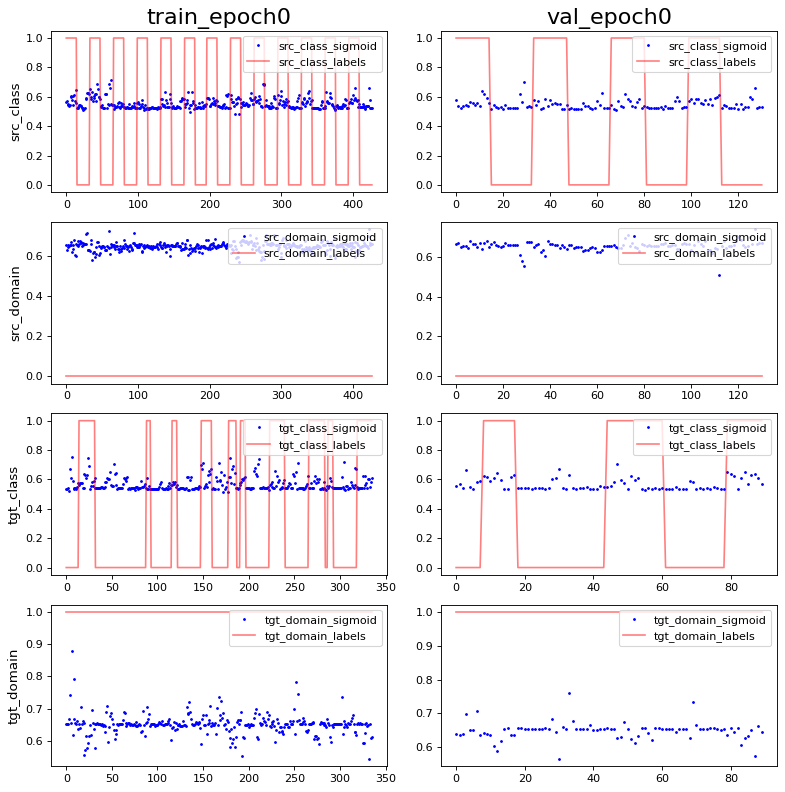

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 8.3326723e-10 0.9965218
PCA var: [19.       28.4      36.9      43.100002 48.700005 52.100006 55.200005
 57.400005 59.500004 61.400005]
show standardize mean and std: 2.3973714e-09 0.9965218
PCA var: [21.6      31.       38.8      45.699997 51.899998 56.199997 59.899998
 63.1      65.799995 68.299995]


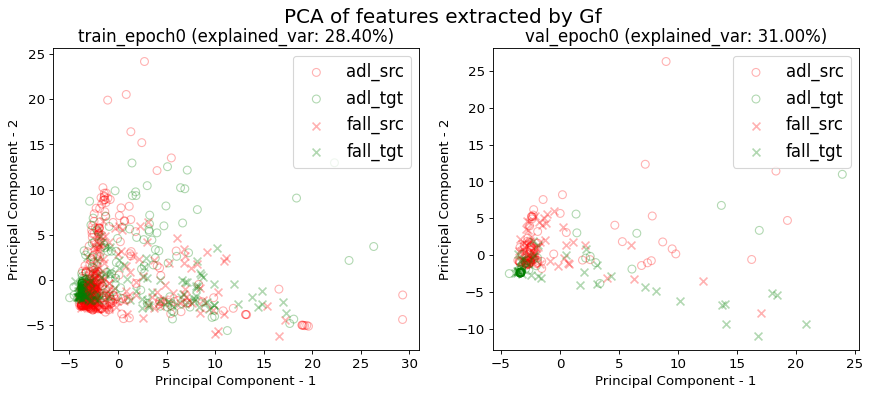

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/


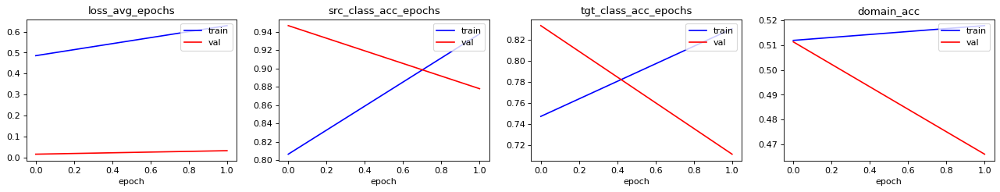

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.8641686182669789 0.11475409836065574 0.6042154566744731 0.7822014051522248
acc performance: 0.8778625954198473 0.09923664122137404 0.48854961832061067 0.6870229007633588


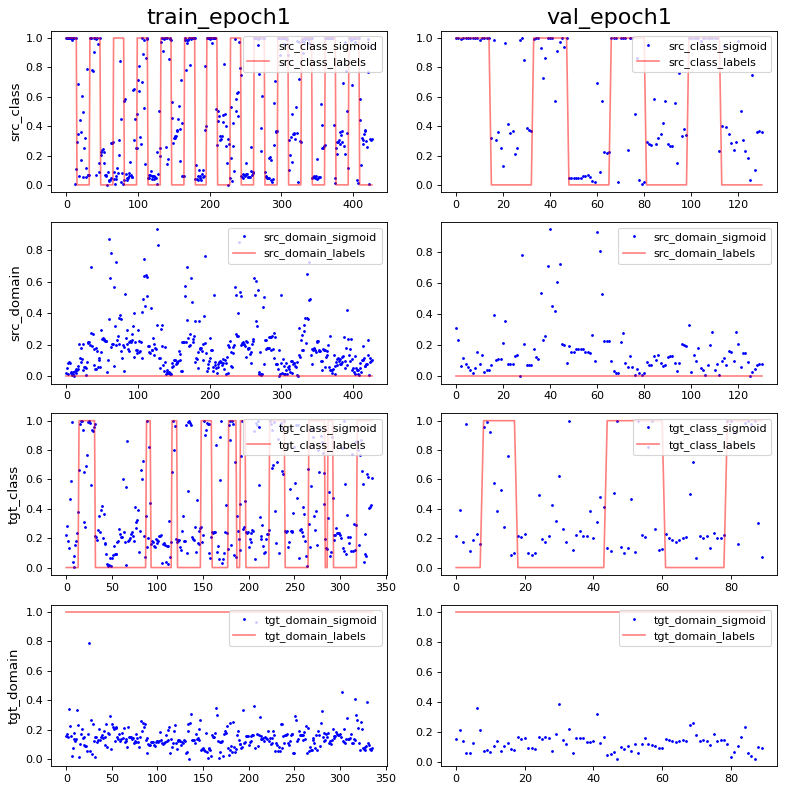

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 1.6665345e-09 1.0
PCA var: [44.7      61.4      65.4      68.3      70.8      72.9      74.700005
 76.200005 77.600006 78.90001 ]
show standardize mean and std: 1.9178972e-09 0.9965218
PCA var: [48.5      64.8      69.       71.9      74.3      76.4      78.3
 80.100006 81.8      83.200005]


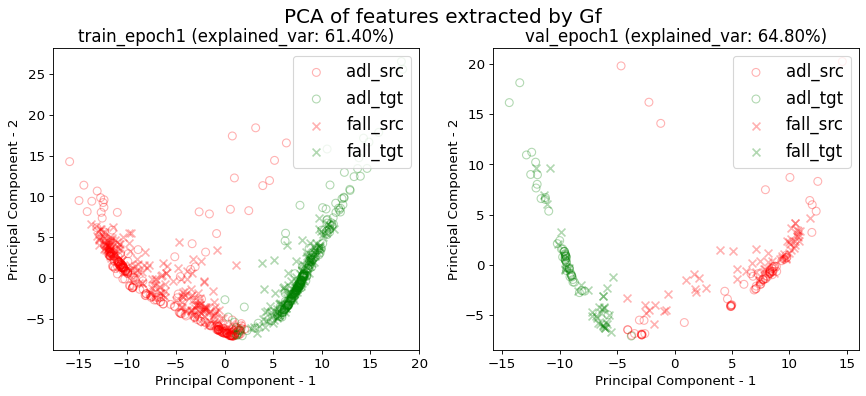

---------------Exporting model performance---------------
show df_performance


,i_CV,train_src_class_loss,train_tgt_class_loss,train_src_domain_loss,train_tgt_domain_loss,train_src_class_acc,train_tgt_class_acc,train_domain_acc,val_src_class_loss,val_tgt_class_loss,val_src_domain_loss,val_tgt_domain_loss,val_src_class_acc,val_tgt_class_acc,val_domain_acc
0,0.000000,0.059728,0.241593,0.169796,0.238359,0.944079,0.799342,0.608553,0.009547,0.001797,0.031984,0.008958,0.659091,0.934426,0.181102
1,1.000000,0.073297,0.221007,0.264732,0.290887,0.937500,0.830357,0.517857,0.005856,0.012690,0.026695,0.000629,0.877863,0.711111,0.466063
mean,0.500000,0.066512,0.231300,0.217264,0.264623,0.940789,0.814850,0.563205,0.007702,0.007244,0.029340,0.004794,0.768477,0.822769,0.323583
std,0.707107,0.009595,0.014557,0.067130,0.037142,0.004652,0.021931,0.064131,0.002610,0.007703,0.003740,0.005890,0.154695,0.157908,0.201498


val_src_class_acc: 0.7685±0.1547
val_tgt_class_acc: 0.8228±0.1579
val_domain_acc: 0.3236±0.2015
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'src_dataset_name': 'UPFall', 'tgt_dataset_name': 'UMAFall', 'src_sensor_loc': 'wrist', 'tgt_sensor_loc': 'ankle', 'date': '2020/04/09 20:12:11', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.01, 'input_dim': (4, 3, 66), 'output_dim': 2, 'label_dim': (4,)}
val_tgt_class_acc: 0.8228±0.1579
val_domain_acc: 0.3236±0.2015
time elapsed: 00:00:44

======================  train on source, val on target(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
FeatureExtractor_t

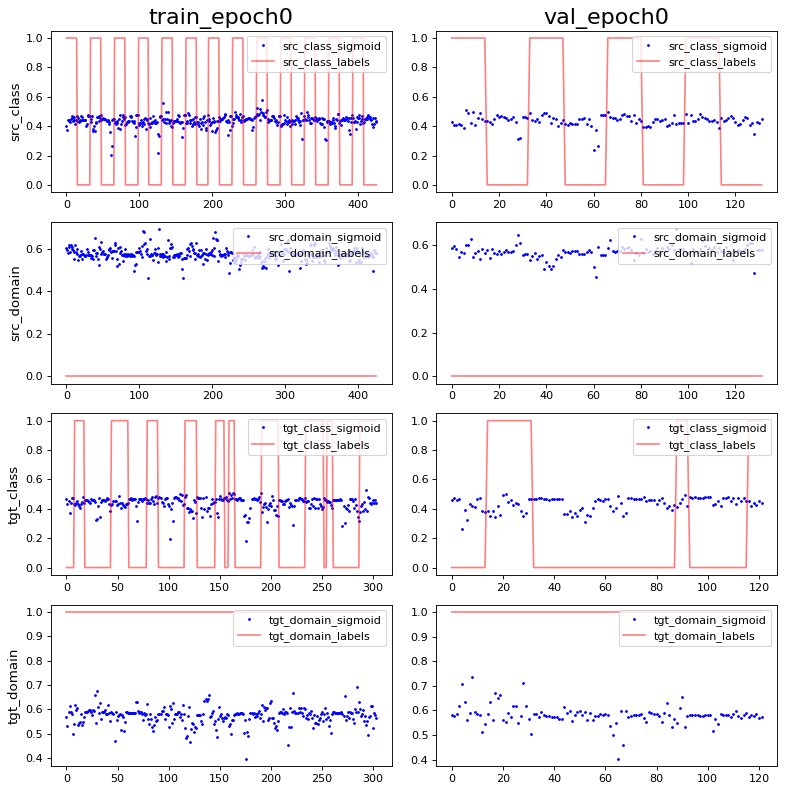

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: 3.4837417e-09 0.99303126
PCA var: [22.6      35.9      41.2      45.4      49.       51.9      54.5
 56.9      58.800003 60.600002]
show standardize mean and std: -3.337443e-09 0.99303126
PCA var: [21.3      38.3      43.9      48.100002 52.000004 55.500004 58.400005
 61.100006 63.500008 65.600006]


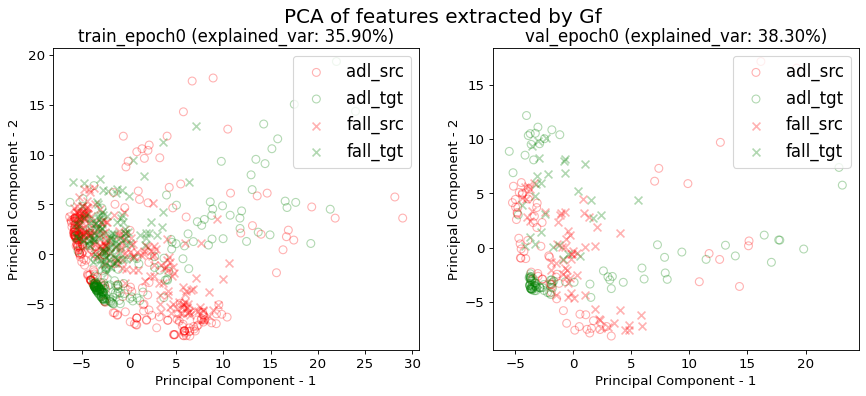

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/


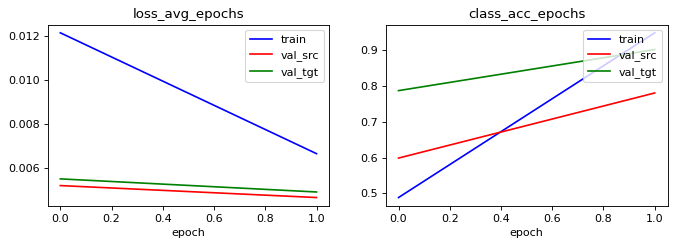

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.8873239436619719 0.028169014084507043 0.528169014084507 0.7136150234741784
acc performance: 0.7803030303030303 0.0 0.8333333333333334 0.9242424242424242


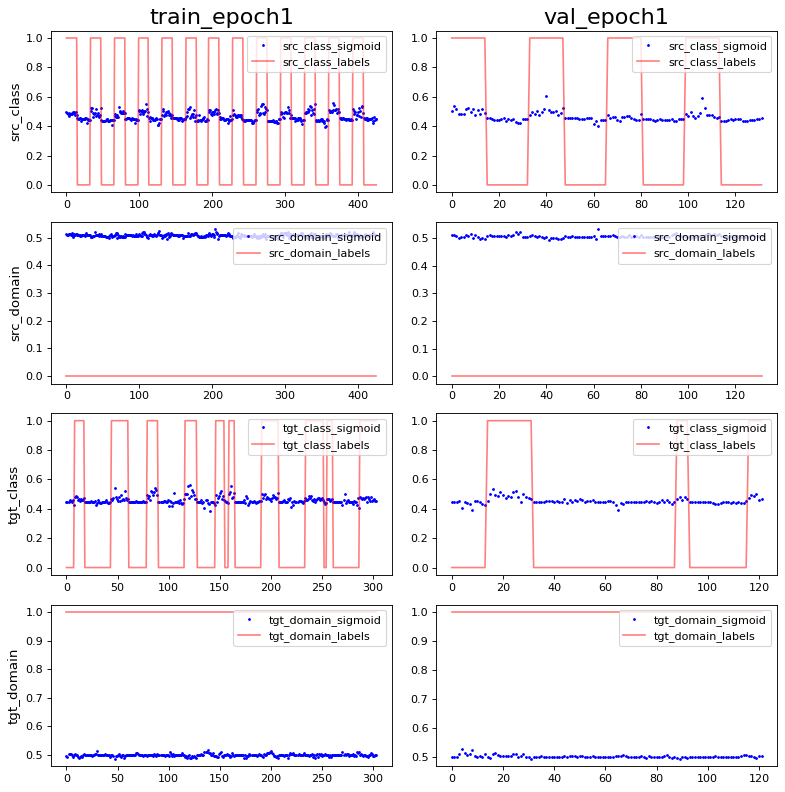

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: -7.2577955e-10 0.9166667
PCA var: [27.7      40.2      49.4      54.300003 58.200005 60.700005 63.100006
 65.3      67.200005 68.700005]
show standardize mean and std: 3.337443e-09 0.9013879
PCA var: [26.4      42.7      52.800003 58.200005 61.700005 65.00001  68.00001
 70.600006 72.700005 74.4     ]


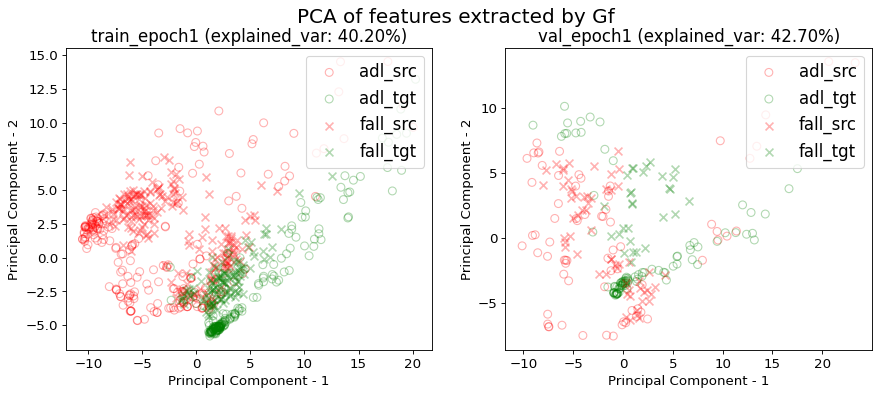

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.4566744730679157 0.8220140515222483 0.26229508196721313 0.4262295081967213
acc performance: 0.4580152671755725 0.8091603053435115 0.2900763358778626 0.31297709923664124


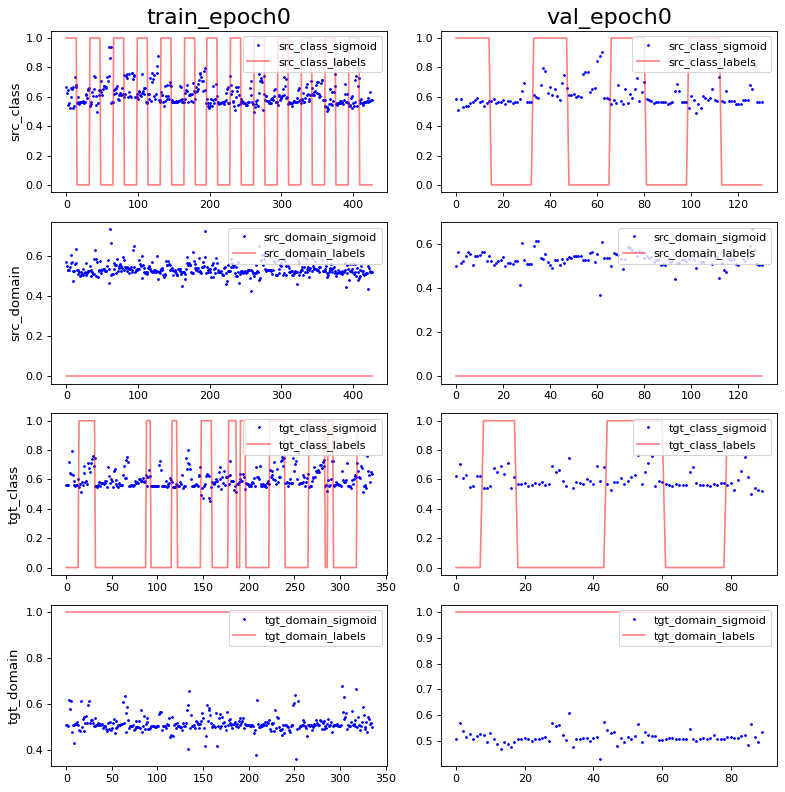

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: 5.277359e-09 1.0
PCA var: [24.1      34.6      43.3      48.1      52.199997 55.299995 57.999996
 60.199997 62.1      63.8     ]
show standardize mean and std: -1.9178972e-09 0.9965218
PCA var: [29.499998 42.3      49.5      54.1      58.3      61.8      65.2
 68.       70.3      72.3     ]


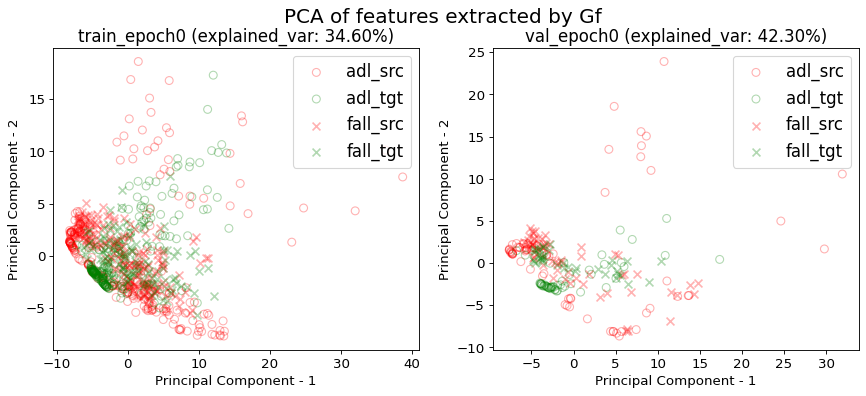

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/


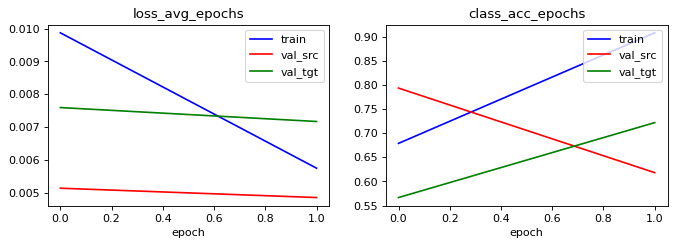

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.6229508196721312 0.297423887587822 0.5995316159250585 0.01873536299765808
acc performance: 0.6183206106870229 0.19083969465648856 0.4961832061068702 0.022900763358778626


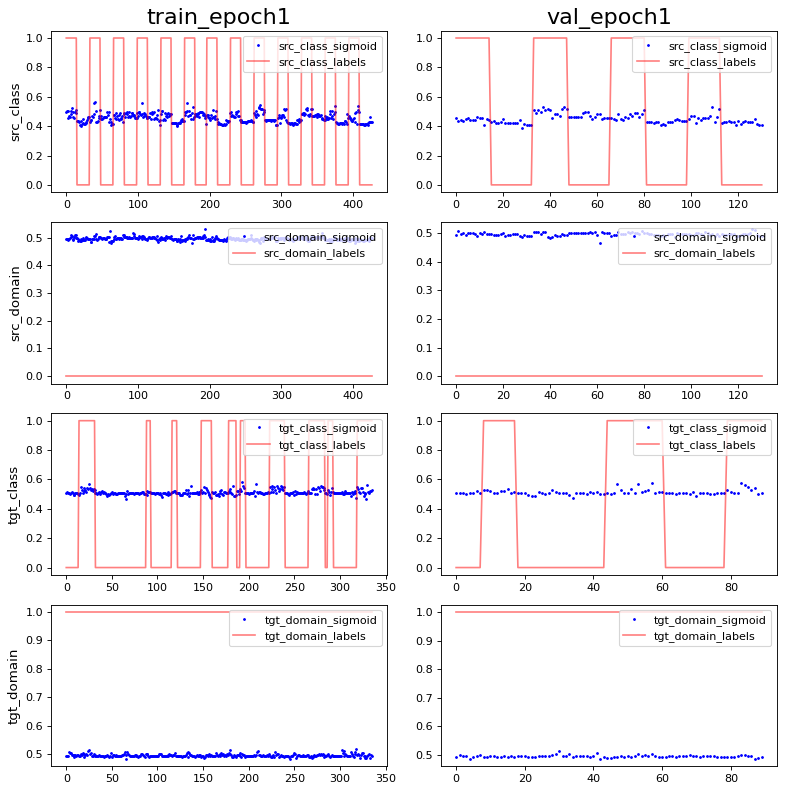

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: -6.943893e-10 0.9965218
PCA var: [37.6      49.899998 55.3      58.7      62.       64.6      67.
 69.       70.8      72.4     ]
show standardize mean and std: 1.9178972e-09 0.9965218
PCA var: [39.8      52.699997 58.899998 64.799995 69.49999  72.799995 75.799995
 78.2      80.299995 81.799995]


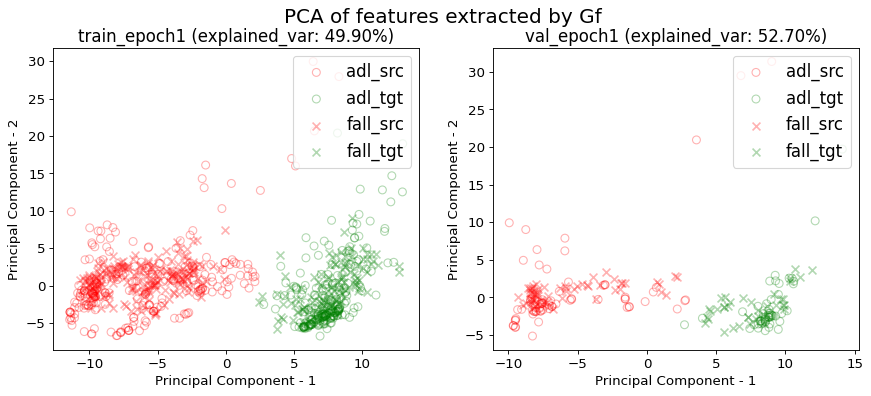

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.006653,0.948357,0.004653,0.780303,0.004907,0.901639
1,1.000000,0.005746,0.908665,0.004850,0.618321,0.007170,0.722222
mean,0.500000,0.006200,0.928511,0.004752,0.699312,0.006038,0.811931
std,0.707107,0.000641,0.028066,0.000140,0.114539,0.001600,0.126867


src val loss: 0.0048±0.0001
src val acc: 0.6993±0.1145
tgt val loss: 0.0060±0.0016
tgt val acc: 0.8119±0.1269
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UPFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 64, 'learning_rate': 0.01, 'sensor_loc': 'wrist', 'date': '2020/04/09 20:12:23', 'input_dim': (64, 3, 66), 'output_dim': (64,)}

======================  train on target, val on target(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modelo

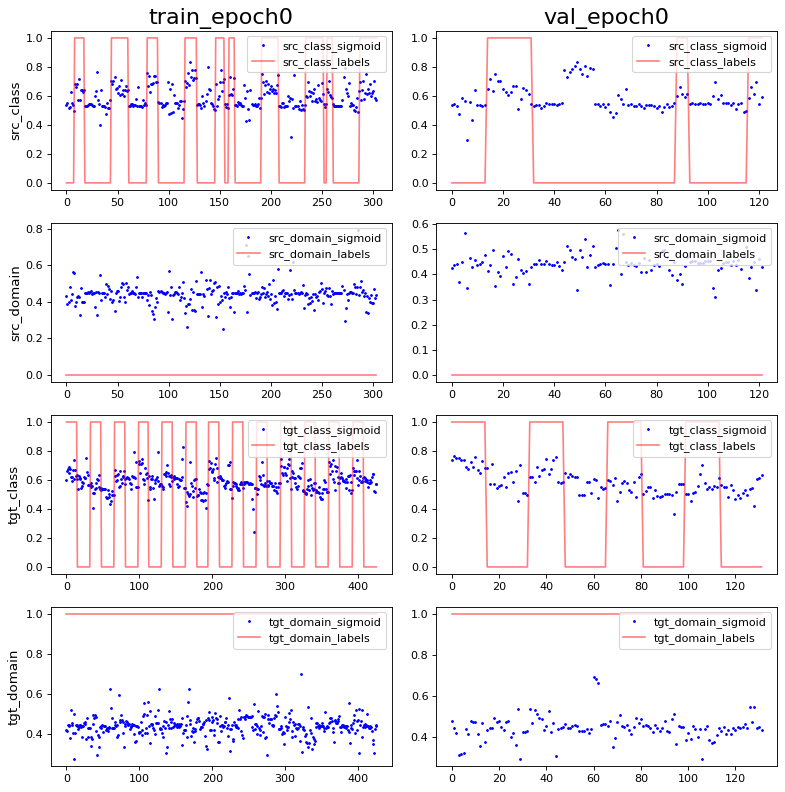

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 2.9031183e-10 0.99999994
PCA var: [26.699999 38.3      47.5      52.2      55.4      58.300003 60.600002
 62.800003 64.8      66.600006]
show standardize mean and std: -5.0061644e-09 1.0
PCA var: [30.300001 44.9      52.300003 56.9      60.300003 63.600002 66.200005
 68.600006 70.600006 72.50001 ]


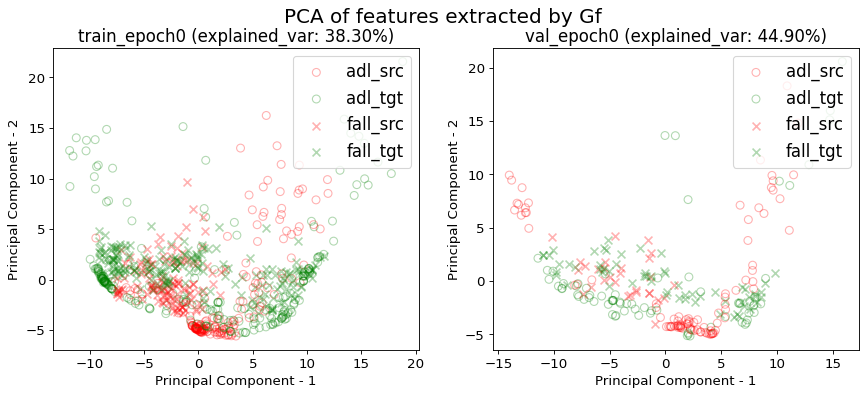

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/


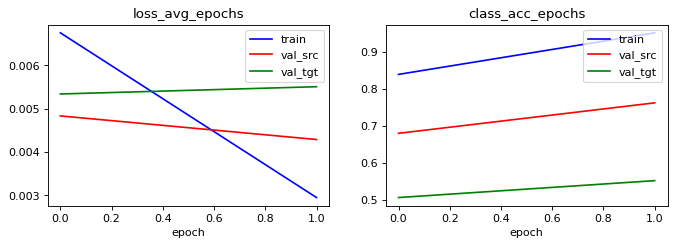

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.5953947368421053 0.0 0.7730263157894737 1.4013157894736843
acc performance: 0.7622950819672131 0.0 0.5983606557377049 1.0819672131147542


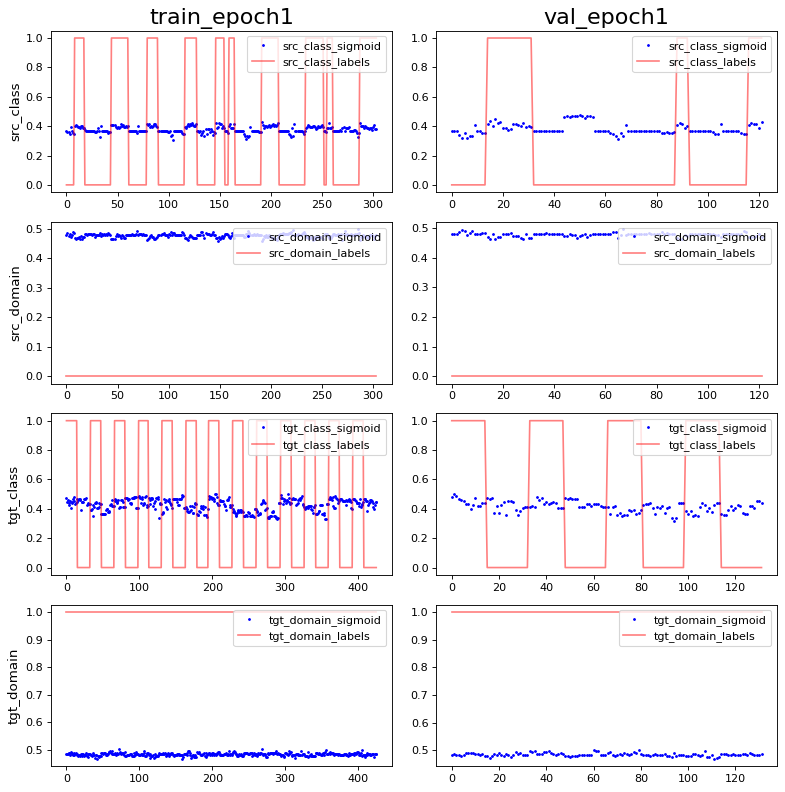

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 5.8062366e-10 0.98601323
PCA var: [27.5      40.1      46.8      51.3      54.5      57.3      59.7
 61.8      63.899998 65.799995]
show standardize mean and std: -6.674886e-09 0.9646531
PCA var: [33.399998 45.5      55.4      60.4      64.5      67.9      70.8
 73.200005 75.50001  77.600006]


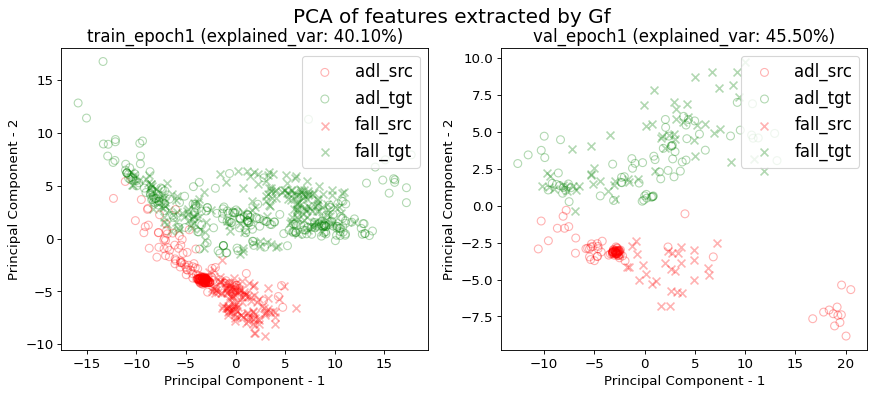

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.6488095238095238 0.9672619047619048 0.6755952380952381 0.39285714285714285
acc performance: 0.7111111111111111 0.9555555555555556 0.6222222222222222 0.5666666666666667


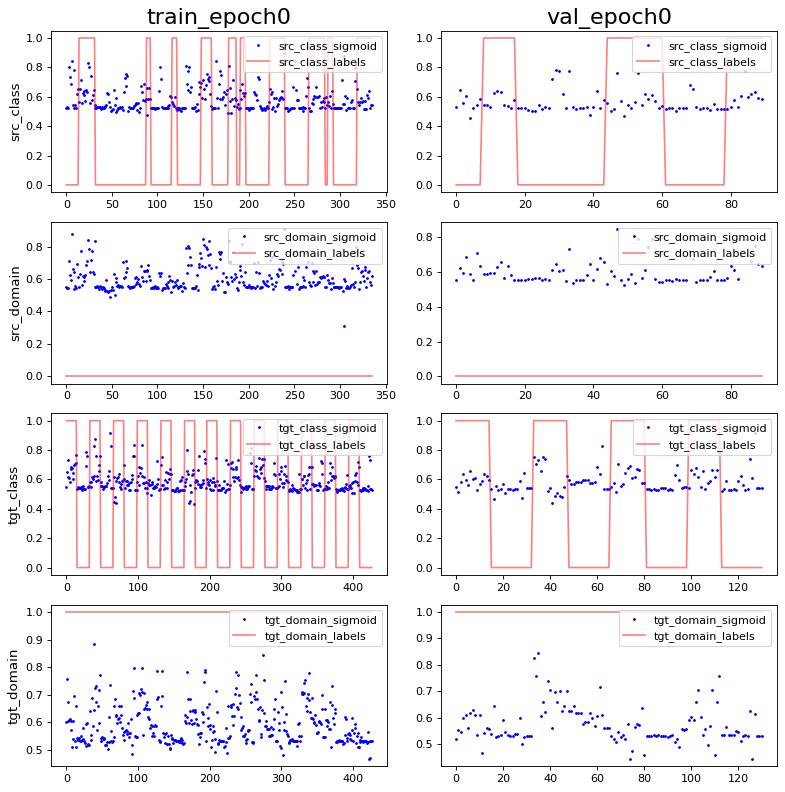

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 5.5551147e-10 1.0
PCA var: [23.4      34.8      40.       44.6      48.399998 51.699997 54.6
 57.1      59.3      61.399998]
show standardize mean and std: 0.0 1.0
PCA var: [27.5      40.1      46.6      51.3      55.3      58.899998 62.1
 64.9      67.3      69.4     ]


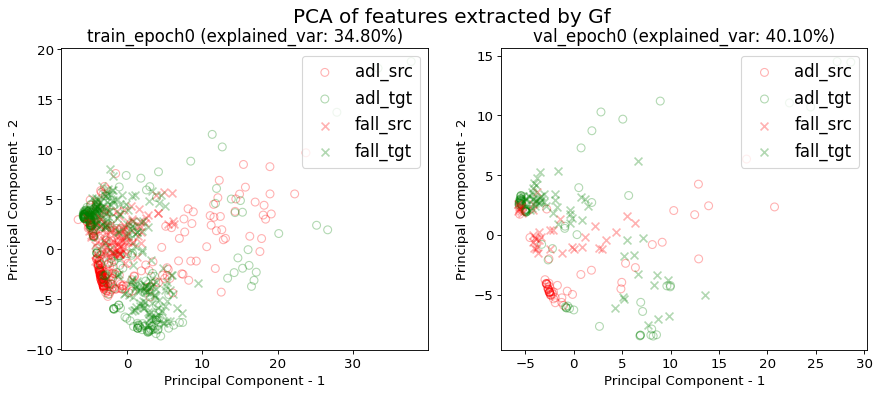

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/


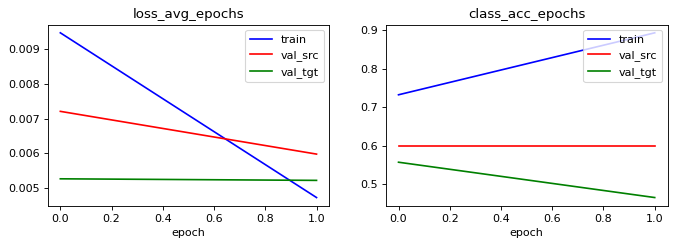

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.6517857142857143 1.0 0.5773809523809523 0.0
acc performance: 0.6 1.0 0.6777777777777778 0.0


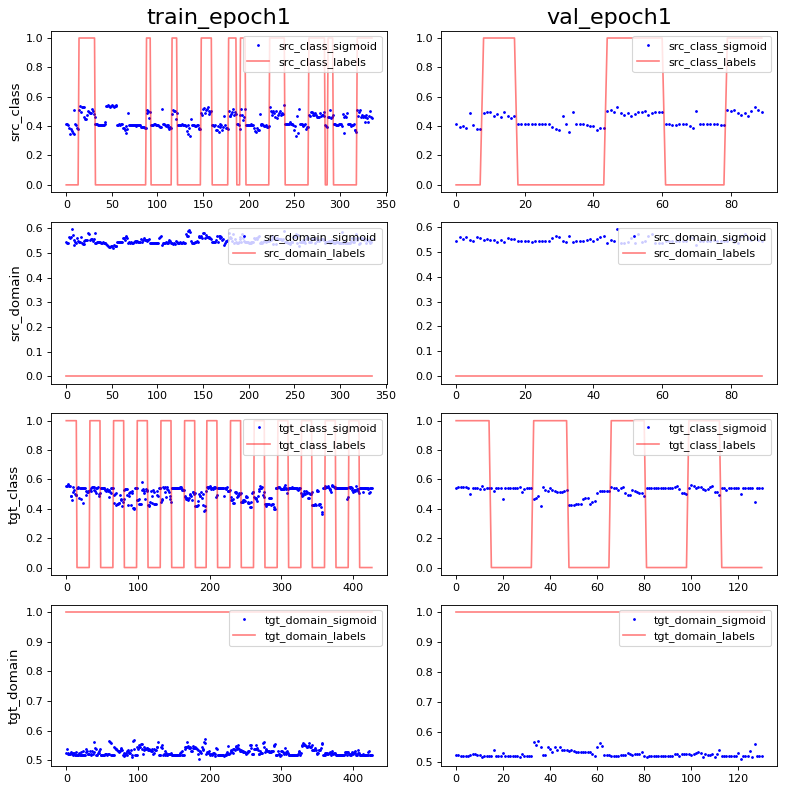

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 5.277359e-09 0.99303126
PCA var: [43.3      51.4      55.9      60.       63.2      65.7      67.899994
 69.899994 71.799995 73.399994]
show standardize mean and std: -1.9178972e-09 0.96104693
PCA var: [50.700005 59.000004 63.800003 68.200005 71.9      75.1      77.7
 79.899994 81.99999  83.799995]


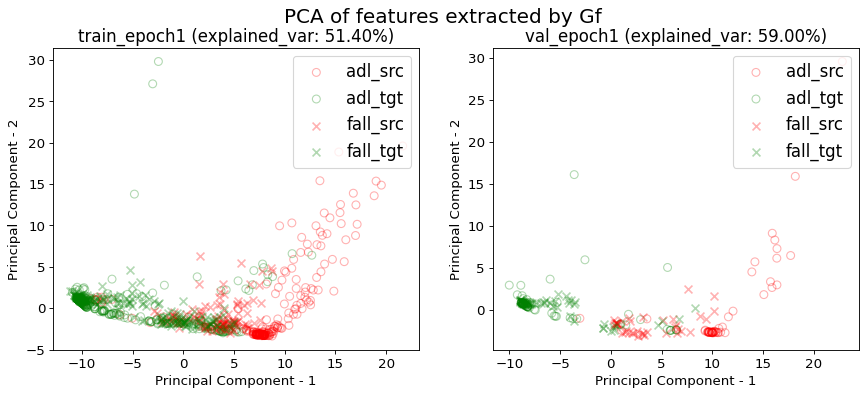

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.002951,0.950658,0.004291,0.762295,0.005509,0.553030
1,1.000000,0.004726,0.892857,0.005978,0.600000,0.005221,0.465649
mean,0.500000,0.003838,0.921758,0.005135,0.681148,0.005365,0.509340
std,0.707107,0.001255,0.040871,0.001193,0.114760,0.000204,0.061788


src val loss: 0.0051±0.0012
src val acc: 0.6811±0.1148
tgt val loss: 0.0054±0.0002
tgt val acc: 0.5093±0.0618
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 426, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UMAFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 64, 'learning_rate': 0.01, 'sensor_loc': 'ankle', 'date': '2020/04/09 20:12:34', 'input_dim': (64, 3, 66), 'output_dim': (64,)}

======================  DANN training transferring knowledge(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2

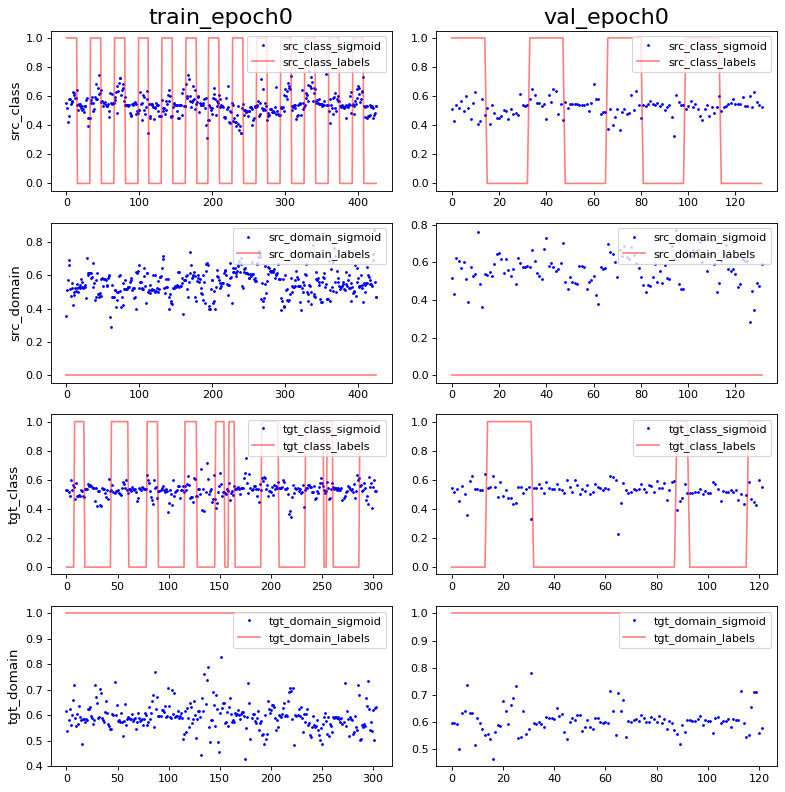

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 7.2577955e-10 1.0
PCA var: [19.5      34.3      43.3      48.6      53.6      57.399998 59.999996
 62.099995 63.799995 65.399994]
show standardize mean and std: -1.2515411e-09 1.0
PCA var: [22.300001 36.5      45.1      51.8      56.       59.       61.9
 64.5      66.9      68.9     ]


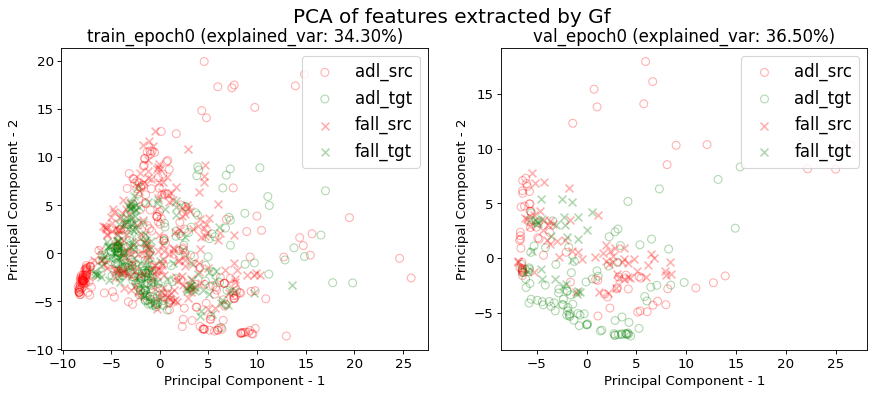

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/


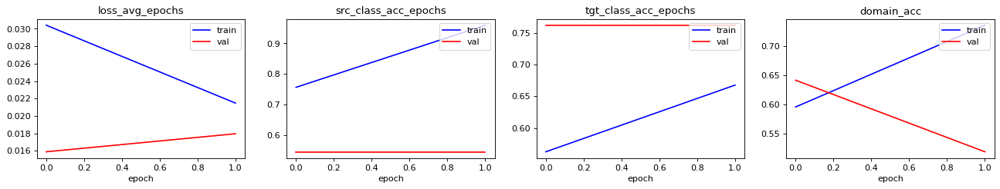

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.5446009389671361 1.0 0.42488262910798125 0.0
acc performance: 0.5454545454545454 1.0 0.7045454545454546 0.0


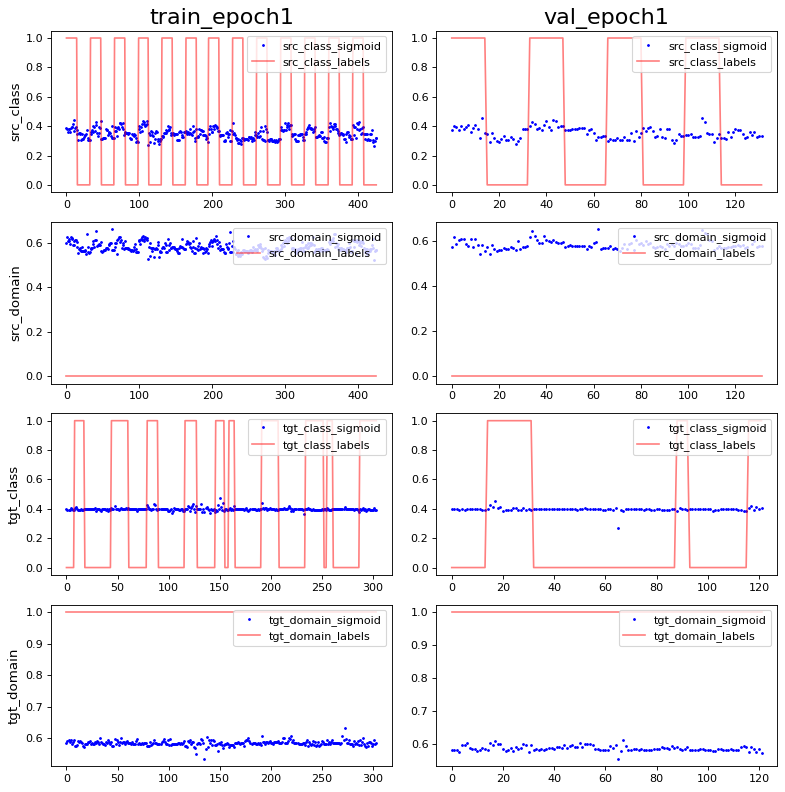

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: -1.1612473e-09 0.9354144
PCA var: [70.1      74.2      77.399994 79.299995 80.899994 82.299995 83.49999
 84.59999  85.59999  86.49999 ]
show standardize mean and std: 0.0 0.9279607
PCA var: [67.7      74.299995 77.299995 79.799995 81.899994 83.799995 85.299995
 86.6      87.799995 88.799995]


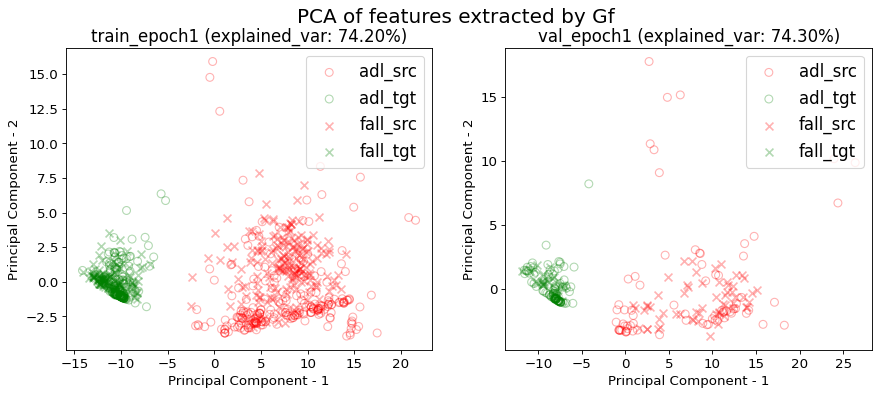

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.5386416861826698 0.13114754098360656 0.5620608899297423 0.5995316159250585
acc performance: 0.5343511450381679 0.0916030534351145 0.4122137404580153 0.6793893129770993


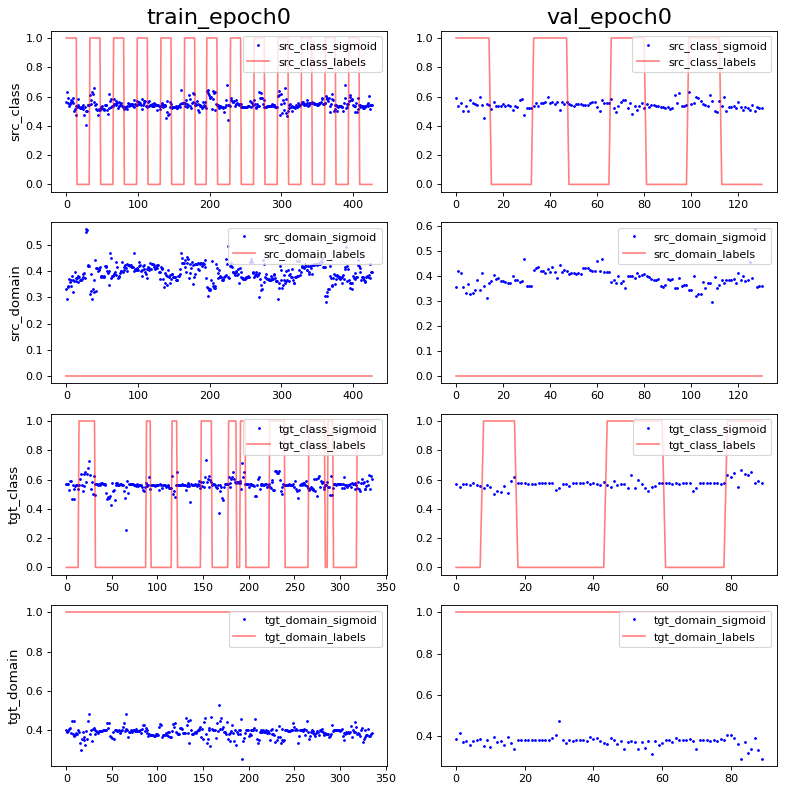

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: -2.7775573e-09 0.9965218
PCA var: [28.5      36.8      43.6      49.       53.2      56.600002 59.2
 61.5      63.6      65.4     ]
show standardize mean and std: -1.1986857e-09 0.9965218
PCA var: [25.099998 34.3      41.7      48.6      53.1      56.899998 60.3
 63.399998 66.       68.6     ]


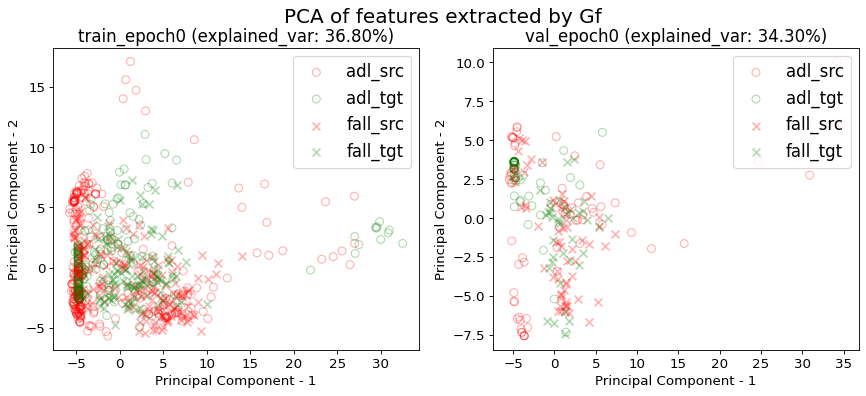

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/


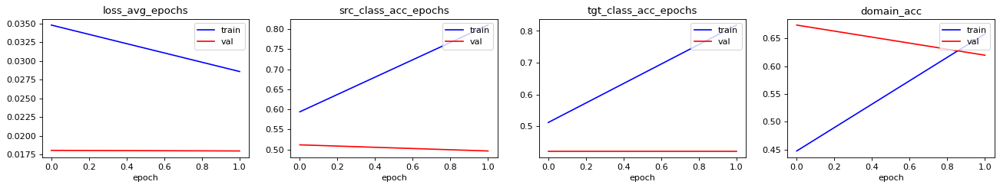

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.5269320843091335 0.8337236533957846 0.27400468384074944 0.234192037470726
acc performance: 0.4961832061068702 0.8625954198473282 0.2900763358778626 0.183206106870229


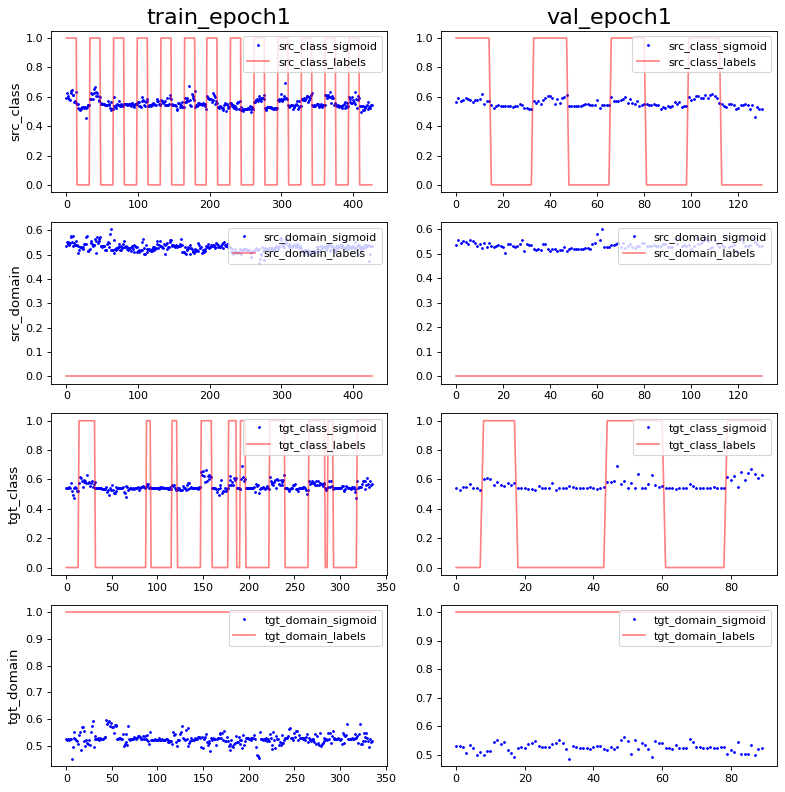

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: -6.943893e-10 0.99303126
PCA var: [20.2      36.300003 48.300003 52.9      56.600002 59.300003 61.700005
 63.700005 65.50001  67.200005]
show standardize mean and std: 1.9178972e-09 0.99303126
PCA var: [20.4      34.199997 46.199997 51.799995 56.099995 60.099995 63.299995
 66.299995 68.7      70.899994]


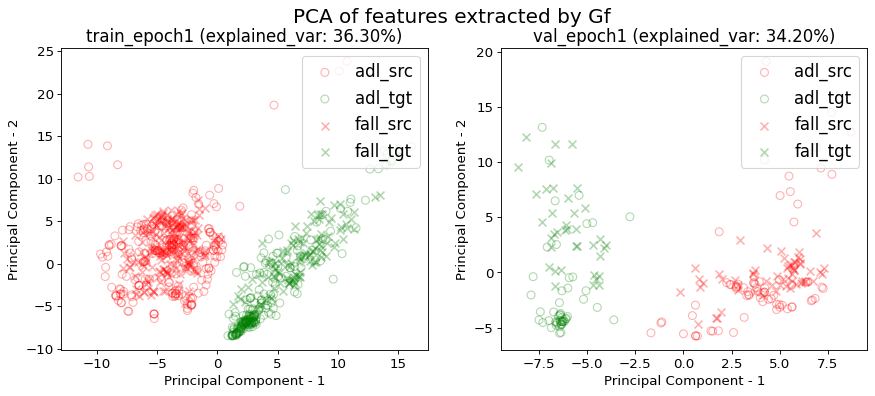

---------------Exporting model performance---------------
show df_performance


,i_CV,train_src_class_loss,train_tgt_class_loss,train_src_domain_loss,train_tgt_domain_loss,train_src_class_acc,train_tgt_class_acc,train_domain_acc,val_src_class_loss,val_tgt_class_loss,val_src_domain_loss,val_tgt_domain_loss,val_src_class_acc,val_tgt_class_acc,val_domain_acc
0,0.000000,0.004457,0.009735,0.009621,0.007401,0.959375,0.667763,0.735577,0.005678,0.004406,0.002833,0.009452,0.545455,0.762295,0.519685
1,1.000000,0.007498,0.009315,0.008728,0.012349,0.809896,0.818452,0.658333,0.005025,0.007566,0.004970,0.007960,0.496183,0.422222,0.619910
mean,0.500000,0.005978,0.009525,0.009175,0.009875,0.884635,0.743108,0.696955,0.005351,0.005986,0.003902,0.008706,0.520819,0.592259,0.569797
std,0.707107,0.002150,0.000297,0.000631,0.003499,0.105698,0.106553,0.054619,0.000461,0.002235,0.001511,0.001055,0.034840,0.240468,0.070869


val_src_class_acc: 0.5208±0.0348
val_tgt_class_acc: 0.5923±0.2405
val_domain_acc: 0.5698±0.0709
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'src_dataset_name': 'UPFall', 'tgt_dataset_name': 'UMAFall', 'src_sensor_loc': 'wrist', 'tgt_sensor_loc': 'ankle', 'date': '2020/04/09 20:12:47', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 64, 'learning_rate': 0.01, 'input_dim': (64, 3, 66), 'output_dim': 2, 'label_dim': (64,)}
val_tgt_class_acc: 0.5923±0.2405
val_domain_acc: 0.5698±0.0709
time elapsed: 00:00:35

======================  train on source, val on target(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
FeatureExtracto

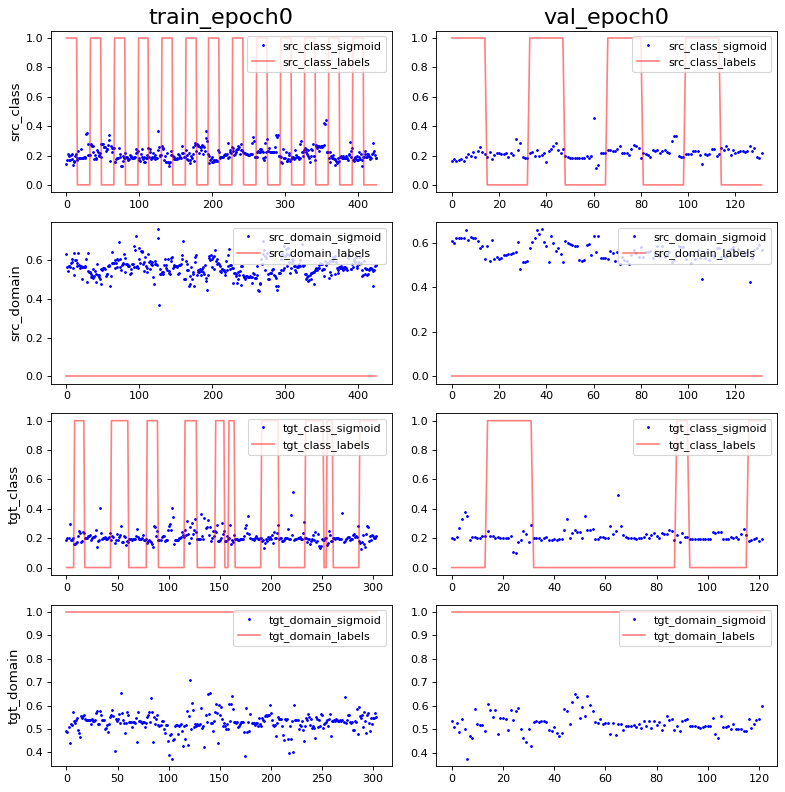

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: -1.4515591e-09 0.9930314
PCA var: [15.700001 26.5      32.5      38.       42.1      45.1      47.699997
 49.799995 51.599995 53.299995]
show standardize mean and std: -2.085902e-09 0.9912815
PCA var: [19.9      31.3      37.5      42.1      46.399998 50.1      53.3
 56.3      58.7      60.8     ]


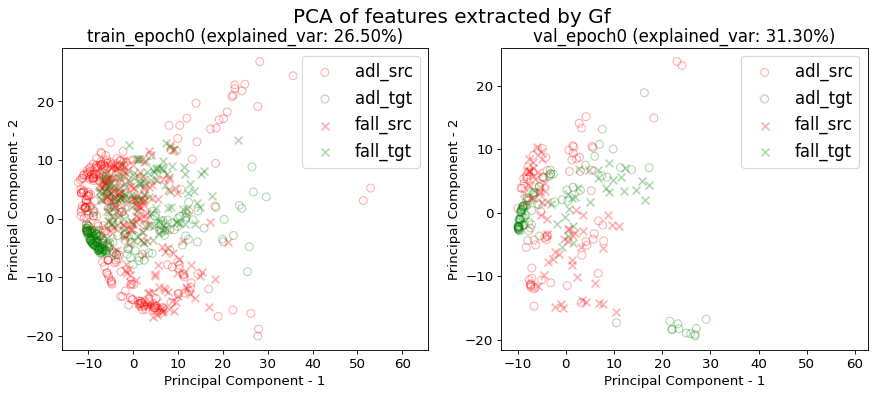

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/


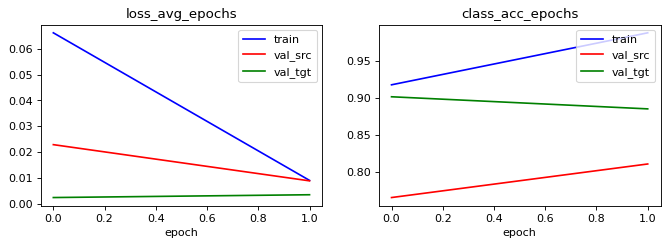

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.9671361502347418 0.1431924882629108 0.5469483568075117 0.19483568075117372
acc performance: 0.8106060606060606 0.2196969696969697 0.8181818181818182 0.24242424242424243


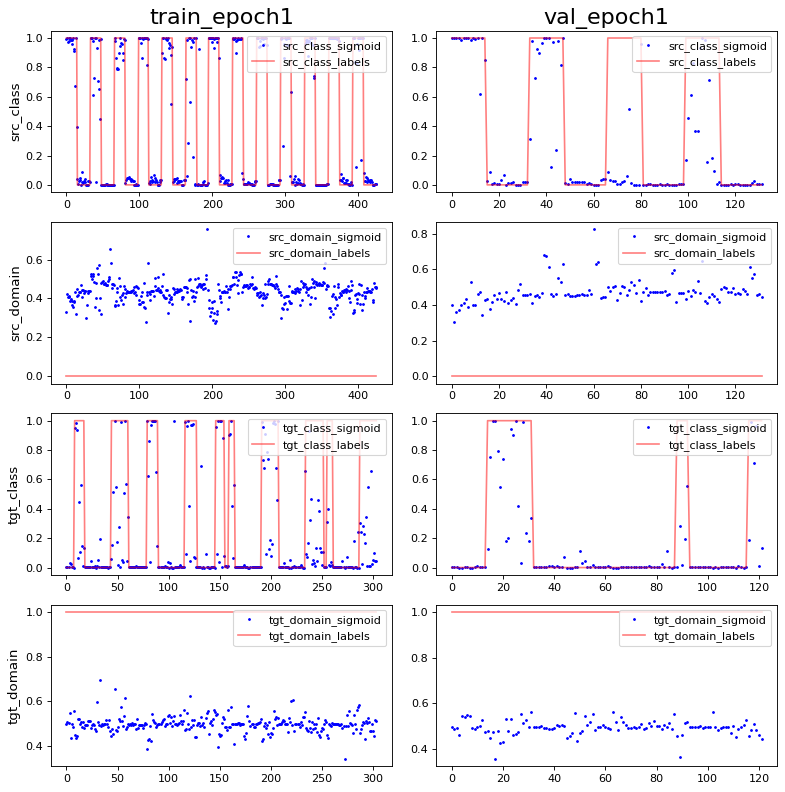

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: 7.983575e-10 0.95288306
PCA var: [33.3      45.9      52.9      58.4      62.100002 64.8      67.
 68.8      70.5      72.      ]
show standardize mean and std: -1.0429509e-08 0.95105934
PCA var: [30.1 43.7 52.2 58.7 62.3 65.7 68.7 71.  73.1 75.1]


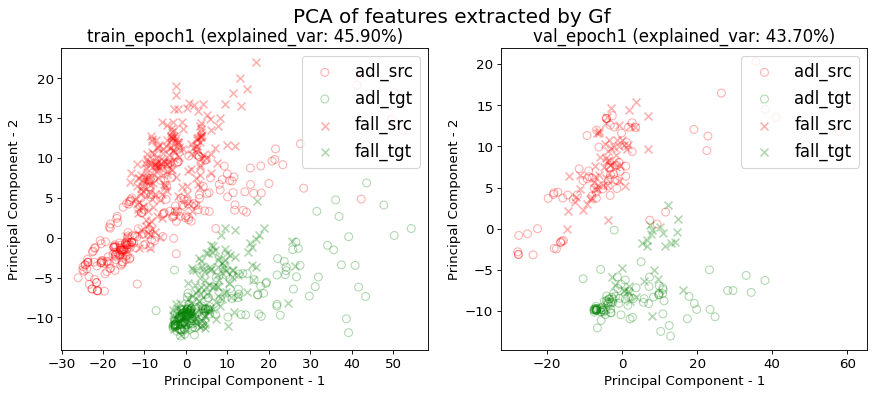

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.42857142857142855 0.0 0.2903981264637002 0.7845433255269321
acc performance: 0.40458015267175573 0.0 0.29770992366412213 0.6870229007633588


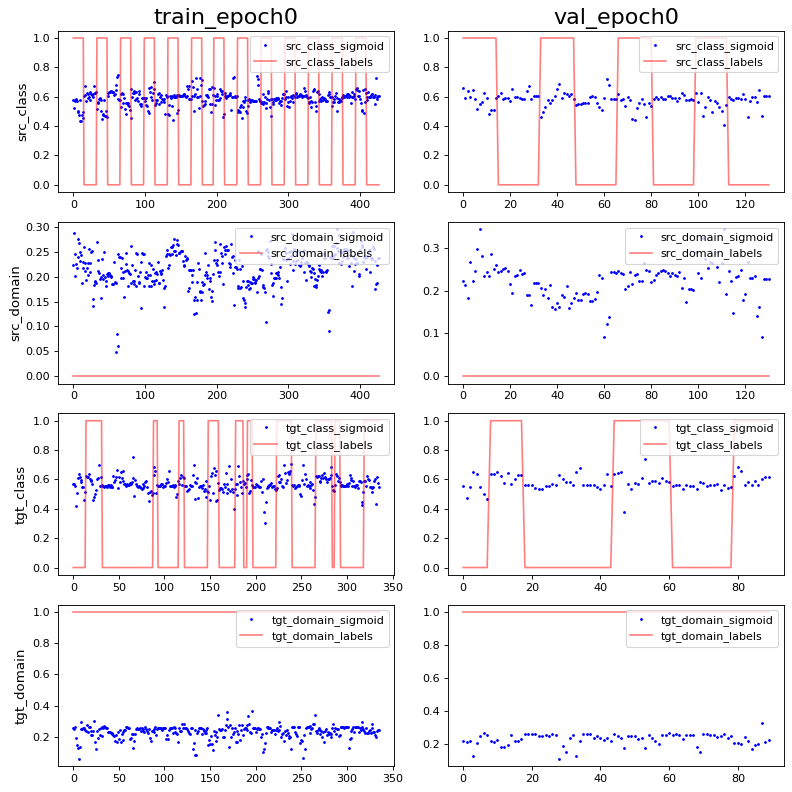

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: 8.3326723e-10 0.9930312
PCA var: [19.1      28.6      34.9      39.800003 43.4      46.       48.5
 50.7      52.600002 54.2     ]
show standardize mean and std: 0.0 0.9904054
PCA var: [21.5      30.       37.3      42.9      47.800003 51.600002 54.600002
 57.300003 59.700005 61.900005]


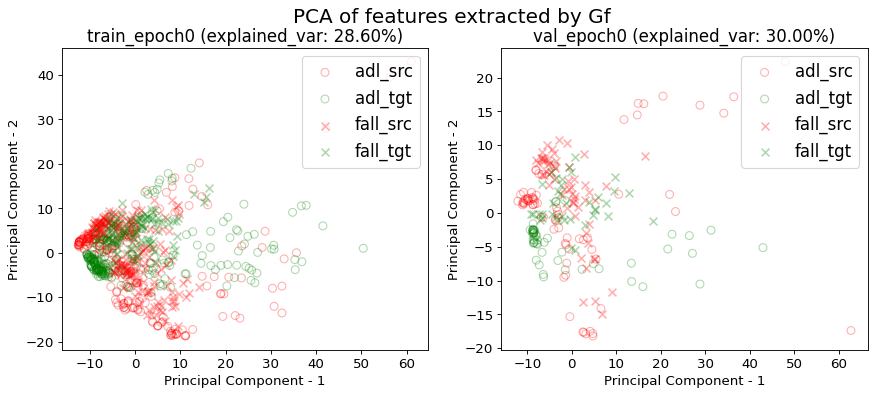

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/


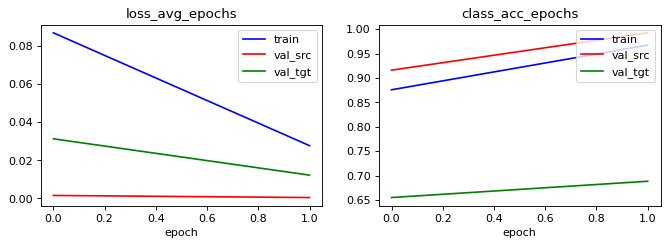

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.9765807962529274 0.00468384074941452 0.6018735362997658 0.7868852459016393
acc performance: 0.9923664122137404 0.007633587786259542 0.4732824427480916 0.6870229007633588


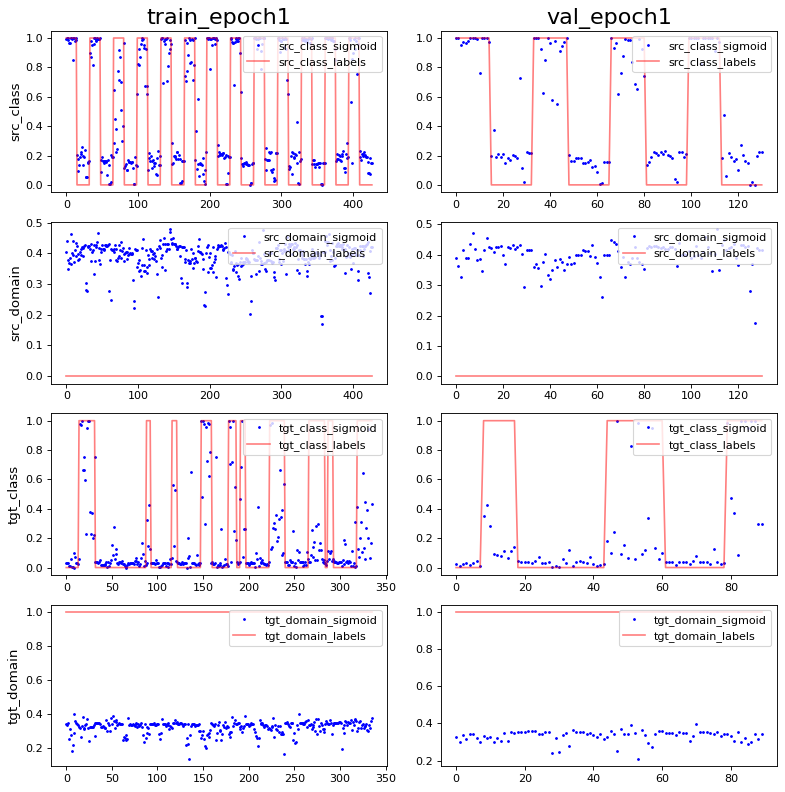

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: -1.3887787e-10 0.9762811
PCA var: [30.8      46.9      53.300003 59.000004 62.200005 64.8      67.3
 69.100006 70.50001  71.80001 ]
show standardize mean and std: 2.3973714e-09 0.9762812
PCA var: [32.2      50.7      58.2      63.600002 66.600006 69.3      71.700005
 73.8      75.600006 77.100006]


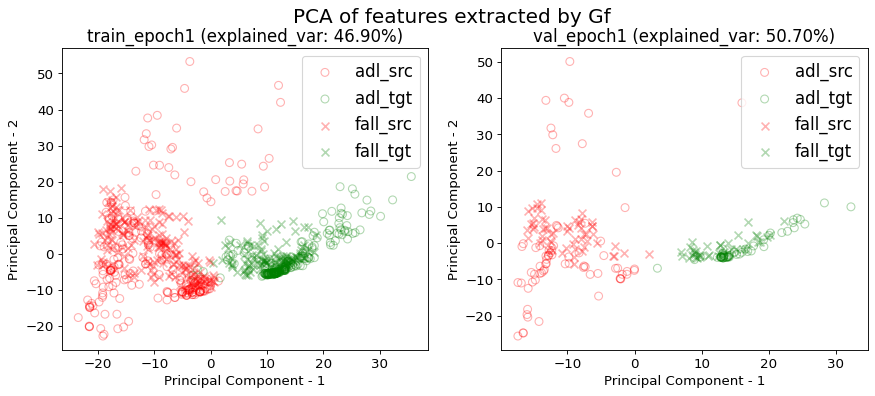

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.009159,0.988263,0.008985,0.810606,0.003626,0.885246
1,1.000000,0.027766,0.967213,0.000472,0.992366,0.012262,0.688889
mean,0.500000,0.018463,0.977738,0.004728,0.901486,0.007944,0.787067
std,0.707107,0.013157,0.014884,0.006020,0.128524,0.006107,0.138845


src val loss: 0.0047±0.0060
src val acc: 0.9015±0.1285
tgt val loss: 0.0079±0.0061
tgt val acc: 0.7871±0.1388
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UPFall', 'num_epochs': 2, 'channel_n': 16, 'batch_size': 4, 'learning_rate': 0.01, 'sensor_loc': 'wrist', 'date': '2020/04/09 20:13:01', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  train on target, val on target(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modelo

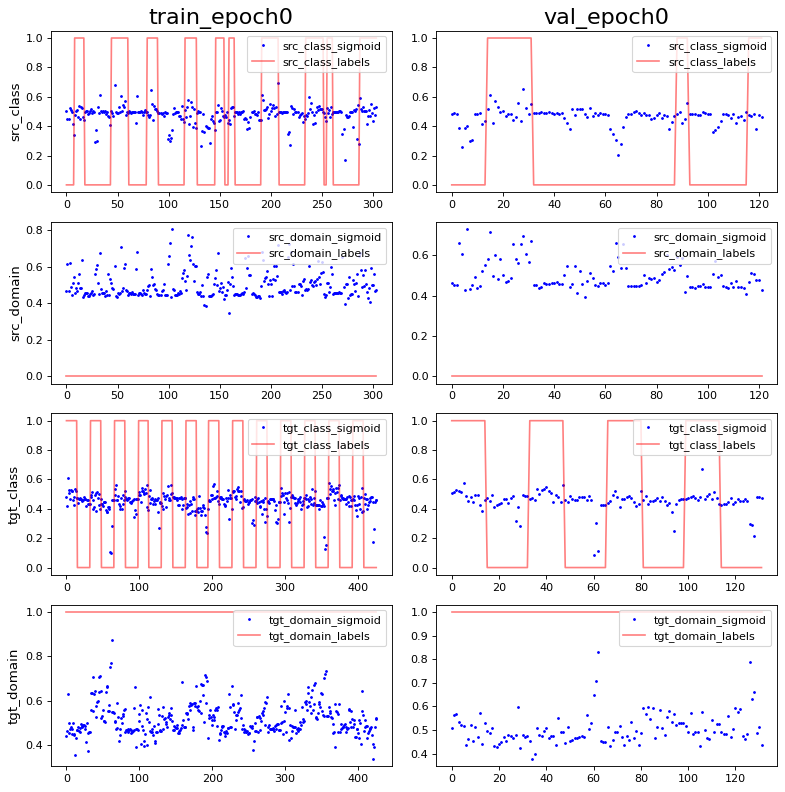

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 3.7740535e-09 0.9956503
PCA var: [18.3      29.8      37.7      42.9      47.       50.       52.5
 54.6      56.399998 57.899998]
show standardize mean and std: 1.042951e-09 0.99565023
PCA var: [20.5      34.       42.5      47.1      51.       54.5      57.8
 60.399998 62.699997 64.7     ]


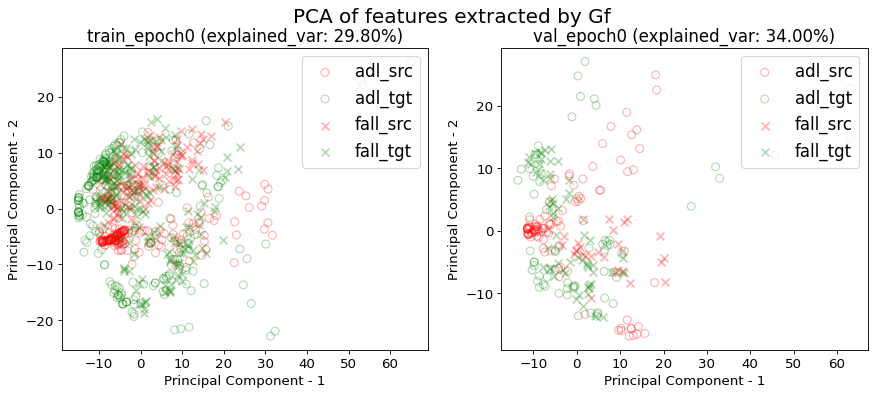

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/


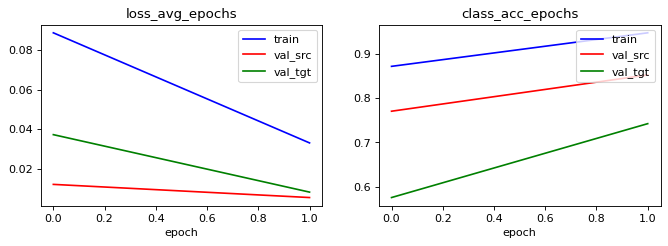

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.944078947368421 0.9671052631578947 0.9703947368421053 0.2598684210526316
acc performance: 0.8524590163934426 0.9098360655737705 0.8032786885245902 0.1721311475409836


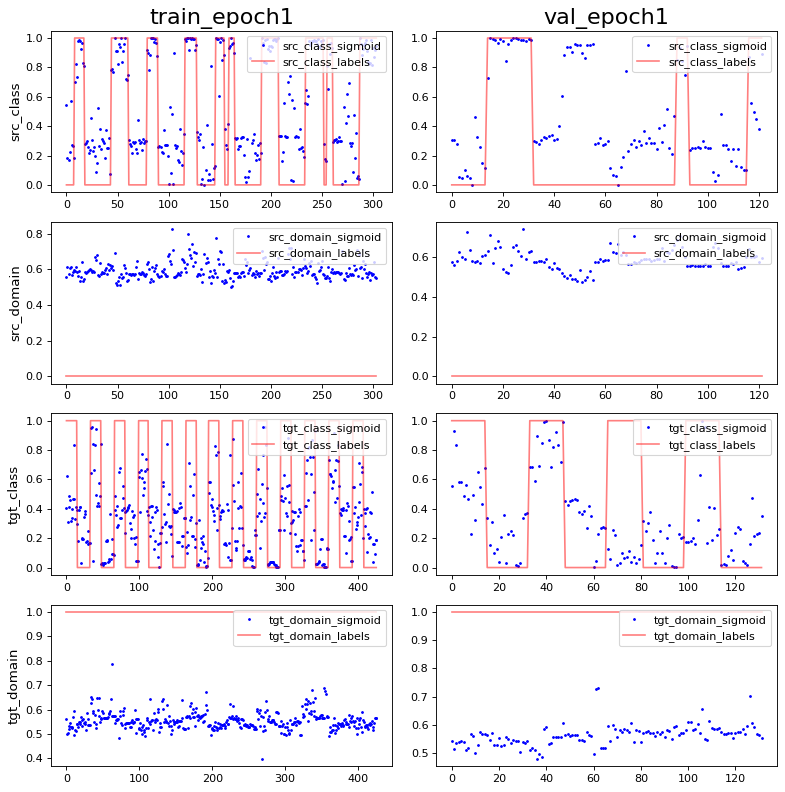

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 3.6288976e-09 0.9930314
PCA var: [28.5      43.3      50.       54.6      57.899998 60.3      62.5
 64.5      66.2      67.6     ]
show standardize mean and std: -2.5030822e-09 0.99303126
PCA var: [26.9      42.5      50.9      57.300003 61.300003 64.3      67.
 69.5      71.5      73.2     ]


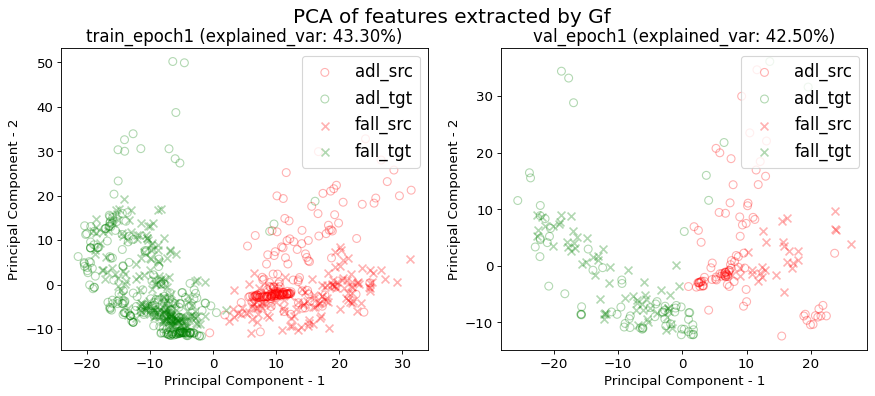

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.4375 0.9940476190476191 0.6041666666666666 0.002976190476190476
acc performance: 0.4888888888888889 0.9888888888888889 0.5888888888888889 0.0


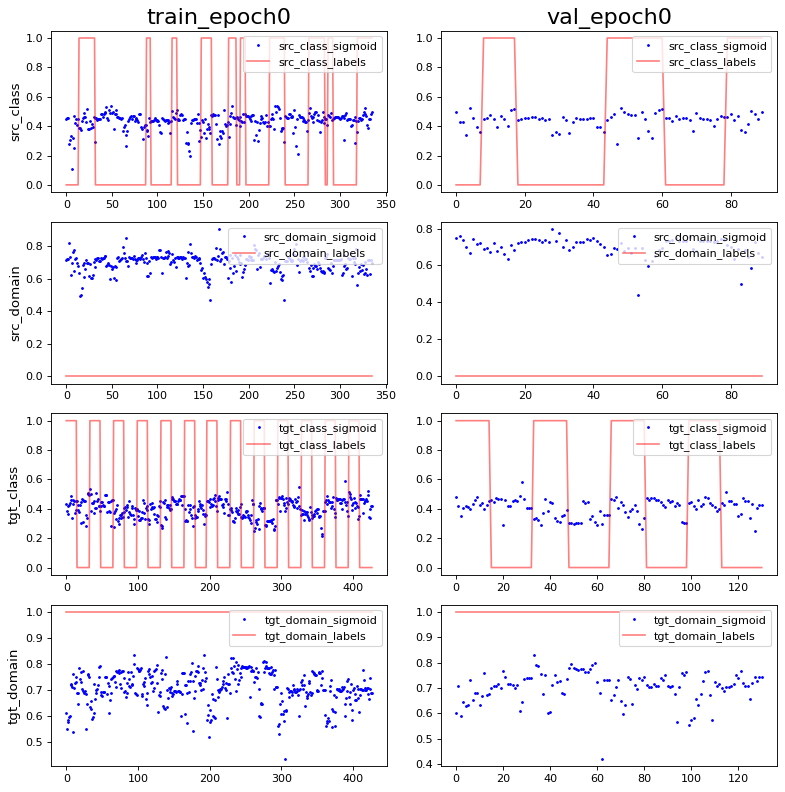

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: -9.0270613e-10 0.994778
PCA var: [13.7 25.4 32.7 38.  42.2 45.3 47.6 49.5 51.3 53. ]
show standardize mean and std: -1.9178972e-09 0.99303126
PCA var: [13.3      26.4      34.6      40.5      45.1      49.399998 52.999996
 55.599995 57.799995 59.999996]


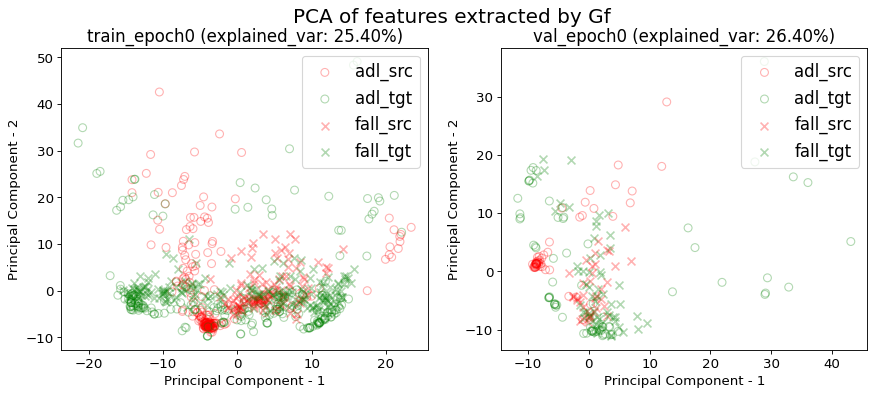

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/


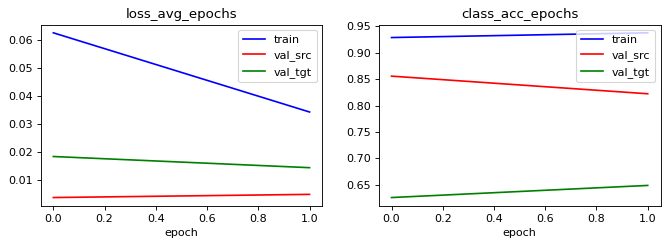

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.9017857142857143 0.9613095238095238 0.8809523809523809 0.16666666666666666
acc performance: 0.8222222222222222 0.9777777777777777 0.9444444444444444 0.06666666666666667


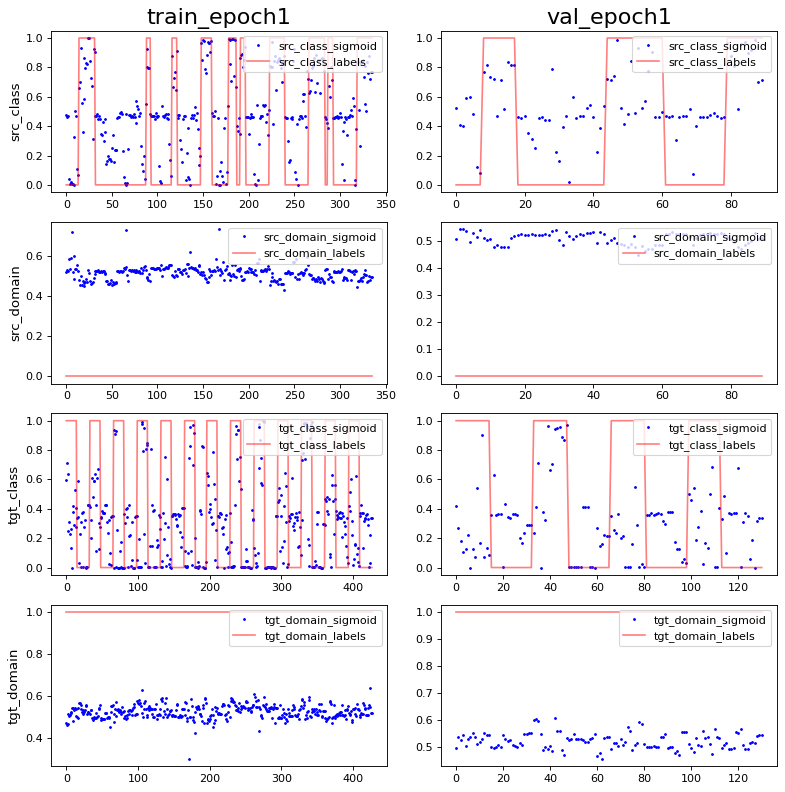

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: -2.6386795e-09 0.9637528
PCA var: [40.       48.7      54.4      58.600002 61.9      65.       67.3
 69.100006 70.700005 72.3     ]
show standardize mean and std: 0.0 0.9474014
PCA var: [39.3      49.8      58.899998 64.299995 69.299995 72.49999  75.59999
 78.09999  79.79999  81.39999 ]


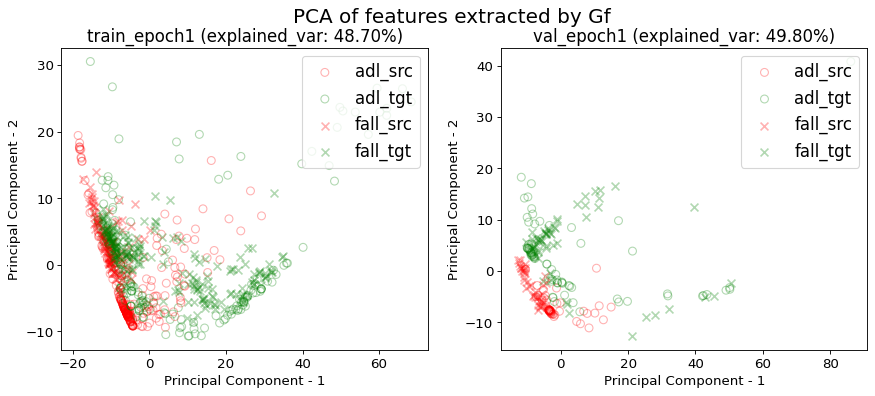

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.033153,0.947368,0.005636,0.852459,0.008370,0.742424
1,1.000000,0.034215,0.937500,0.004890,0.822222,0.014392,0.648855
mean,0.500000,0.033684,0.942434,0.005263,0.837341,0.011381,0.695640
std,0.707107,0.000750,0.006978,0.000528,0.021381,0.004258,0.066163


src val loss: 0.0053±0.0005
src val acc: 0.8373±0.0214
tgt val loss: 0.0114±0.0043
tgt val acc: 0.6956±0.0662
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 426, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UMAFall', 'num_epochs': 2, 'channel_n': 16, 'batch_size': 4, 'learning_rate': 0.01, 'sensor_loc': 'ankle', 'date': '2020/04/09 20:13:14', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  DANN training transferring knowledge(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2

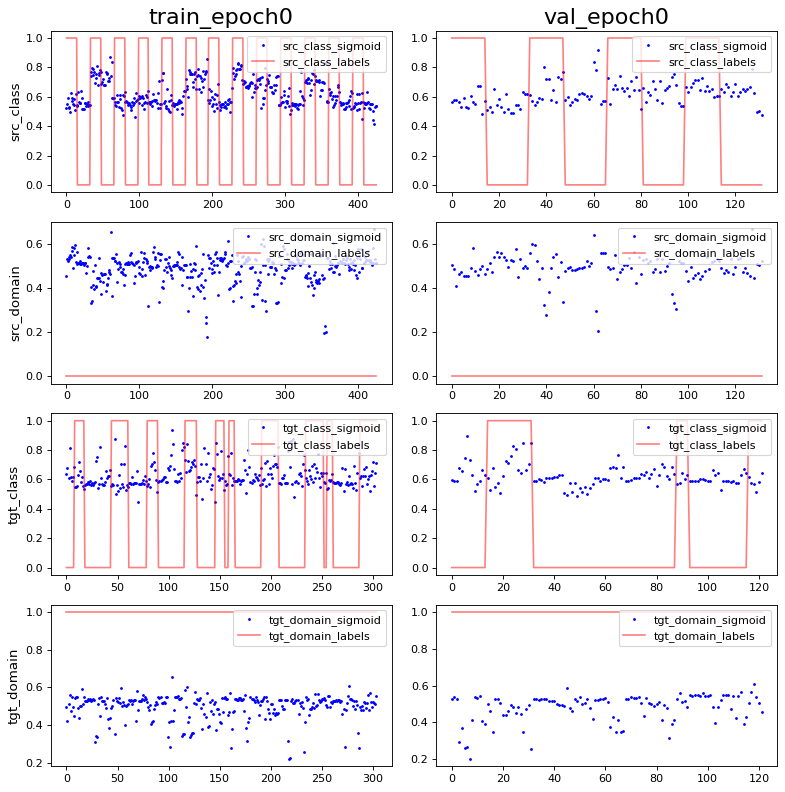

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 1.596715e-09 0.9991316
PCA var: [17.7      26.400002 34.7      40.9      44.7      48.       50.6
 52.699997 54.699997 56.199997]
show standardize mean and std: 1.8773116e-09 0.99826247
PCA var: [16.2      26.900002 35.7      41.8      46.7      50.600002 53.600002
 56.300003 58.700005 60.800003]


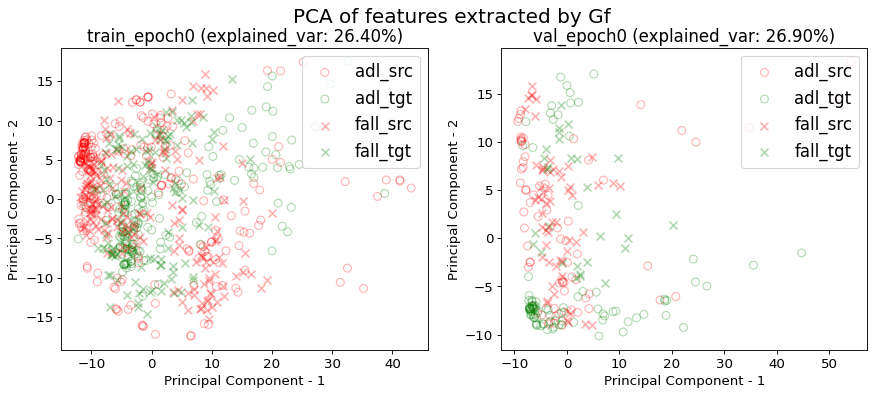

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/


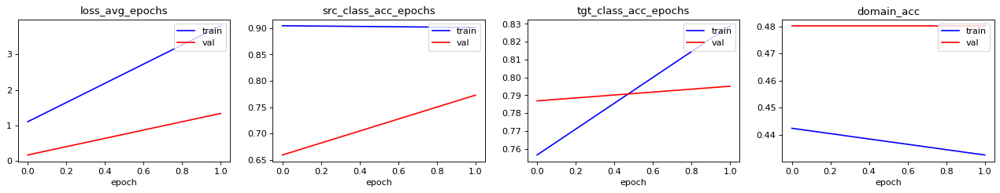

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.9460093896713615 0.0 0.45774647887323944 0.7136150234741784
acc performance: 0.7727272727272727 0.0 0.7348484848484849 0.9242424242424242


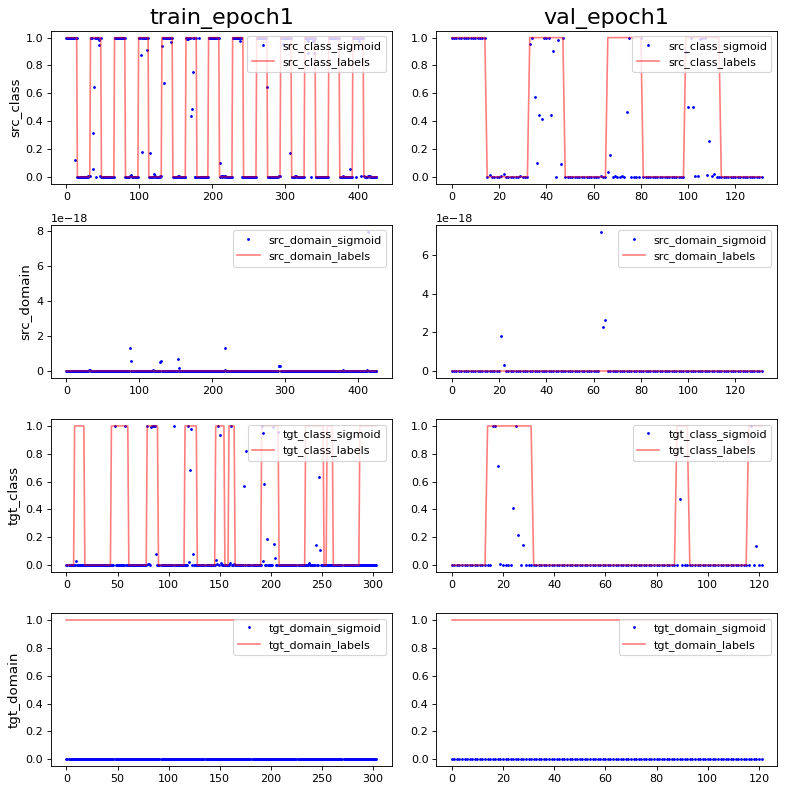

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: -2.9031182e-09 0.9824855
PCA var: [59.8      68.7      73.1      75.799995 78.1      79.7      81.2
 82.299995 83.299995 84.2     ]
show standardize mean and std: -1.168105e-08 0.9700372
PCA var: [52.2      63.2      67.8      71.9      75.1      77.7      79.899994
 81.49999  82.99999  84.299995]


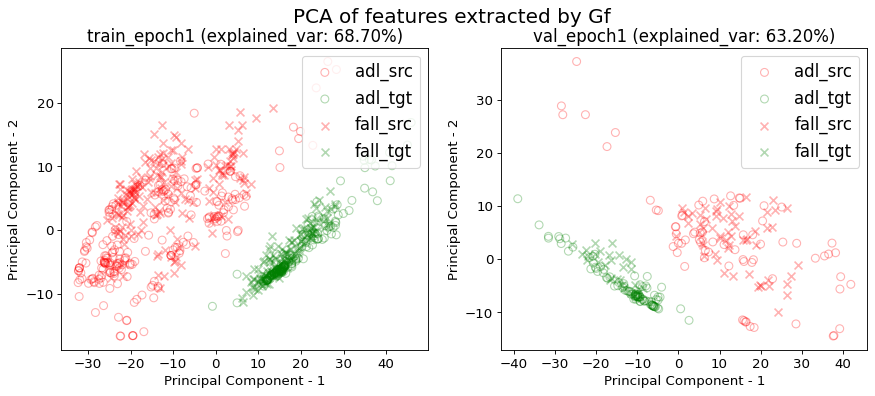

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.5433255269320844 0.7962529274004684 0.522248243559719 0.10070257611241218
acc performance: 0.549618320610687 0.8702290076335878 0.3969465648854962 0.03816793893129771


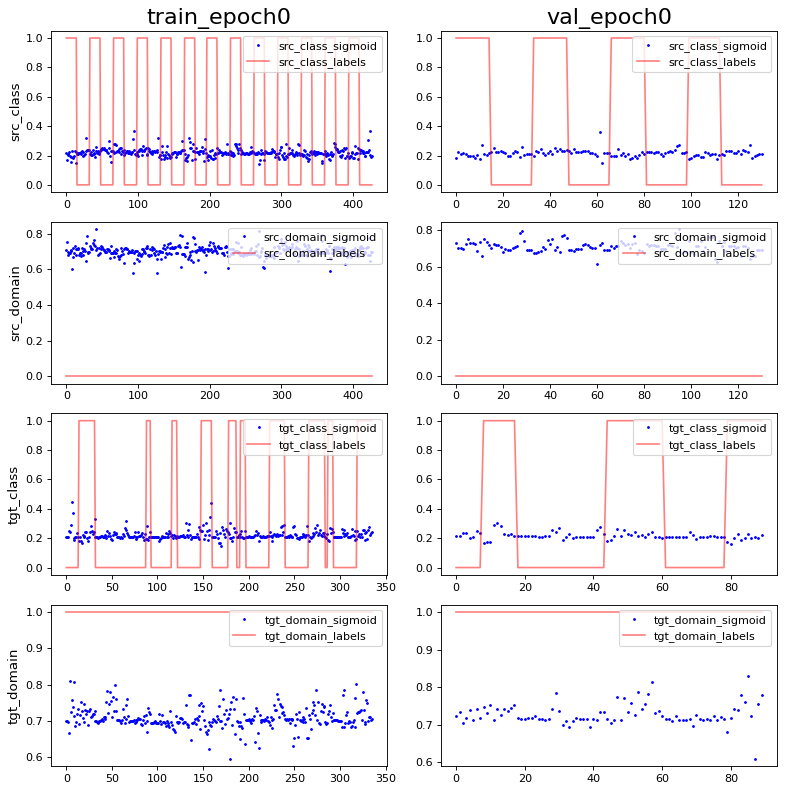

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 4.1663362e-10 0.99565023
PCA var: [15.4      28.5      33.8      38.2      41.600002 44.500004 46.900005
 49.000004 50.900005 52.700005]
show standardize mean and std: 2.3973714e-09 0.9956503
PCA var: [16.599998 28.699999 35.8      41.5      46.5      50.2      53.5
 56.1      58.6      60.8     ]


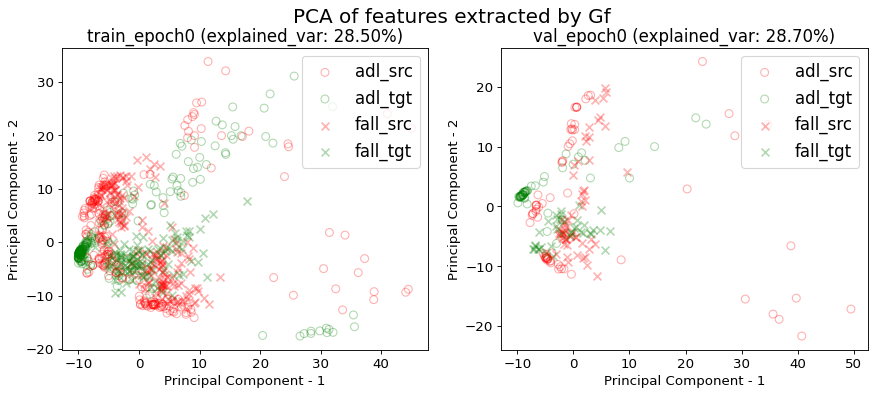

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/


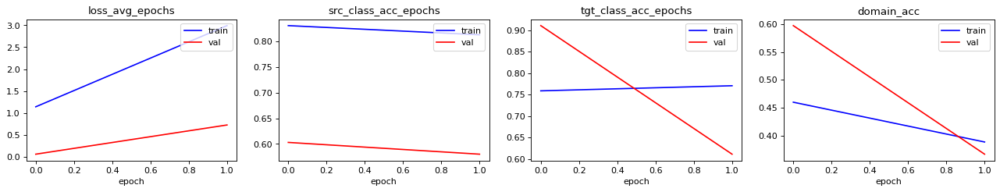

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 1824
DannModel_total_params: 4132
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.5714285714285714 0.0 0.5386416861826698 0.7259953161592506
acc performance: 0.5801526717557252 0.0 0.4198473282442748 0.6183206106870229


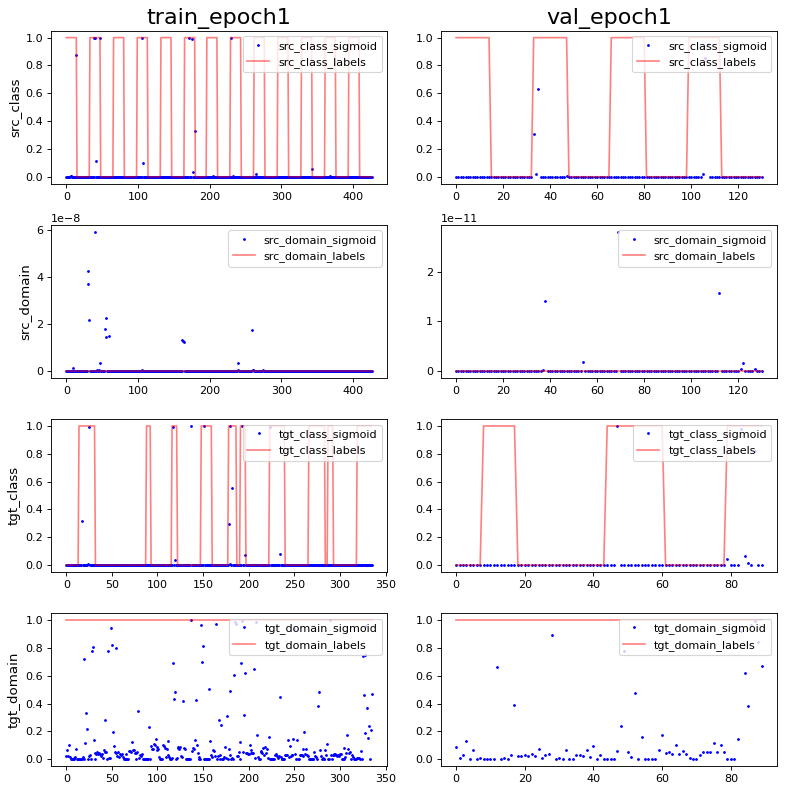

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 6.9438935e-09 0.9807169
PCA var: [61.1      70.2      76.2      78.299995 80.1      81.6      82.799995
 83.7      84.5      85.1     ]
show standardize mean and std: 1.1507383e-08 0.9718253
PCA var: [65.4      74.200005 78.8      81.3      83.3      85.       86.1
 87.1      88.1      88.9     ]


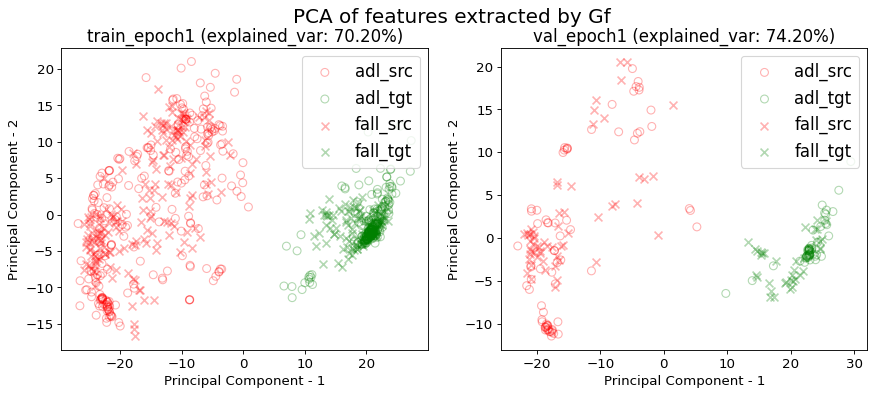

---------------Exporting model performance---------------
show df_performance


,i_CV,train_src_class_loss,train_tgt_class_loss,train_src_domain_loss,train_tgt_domain_loss,train_src_class_acc,train_tgt_class_acc,train_domain_acc,val_src_class_loss,val_tgt_class_loss,val_src_domain_loss,val_tgt_domain_loss,val_src_class_acc,val_tgt_class_acc,val_domain_acc
0,0.000000,0.119098,0.267708,1.689177,1.996246,0.901316,0.828947,0.432566,0.032427,0.041091,1.303560,0.00000,0.772727,0.795082,0.480315
1,1.000000,0.202918,0.361895,1.473243,1.317061,0.812500,0.770833,0.388393,0.106603,0.130493,0.612909,0.00430,0.580153,0.611111,0.366516
mean,0.500000,0.161008,0.314802,1.581210,1.656654,0.856908,0.799890,0.410479,0.069515,0.085792,0.958235,0.00215,0.676440,0.703097,0.423415
std,0.707107,0.059270,0.066600,0.152688,0.480256,0.062802,0.041093,0.031235,0.052450,0.063217,0.488364,0.00304,0.136171,0.130087,0.080468


val_src_class_acc: 0.6764±0.1362
val_tgt_class_acc: 0.7031±0.1301
val_domain_acc: 0.4234±0.0805
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'src_dataset_name': 'UPFall', 'tgt_dataset_name': 'UMAFall', 'src_sensor_loc': 'wrist', 'tgt_sensor_loc': 'ankle', 'date': '2020/04/09 20:13:31', 'num_epochs': 2, 'channel_n': 16, 'batch_size': 4, 'learning_rate': 0.01, 'input_dim': (4, 3, 66), 'output_dim': 2, 'label_dim': (4,)}
val_tgt_class_acc: 0.7031±0.1301
val_domain_acc: 0.4234±0.0805
time elapsed: 00:00:43

======================  train on source, val on target(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
FeatureExtractor_

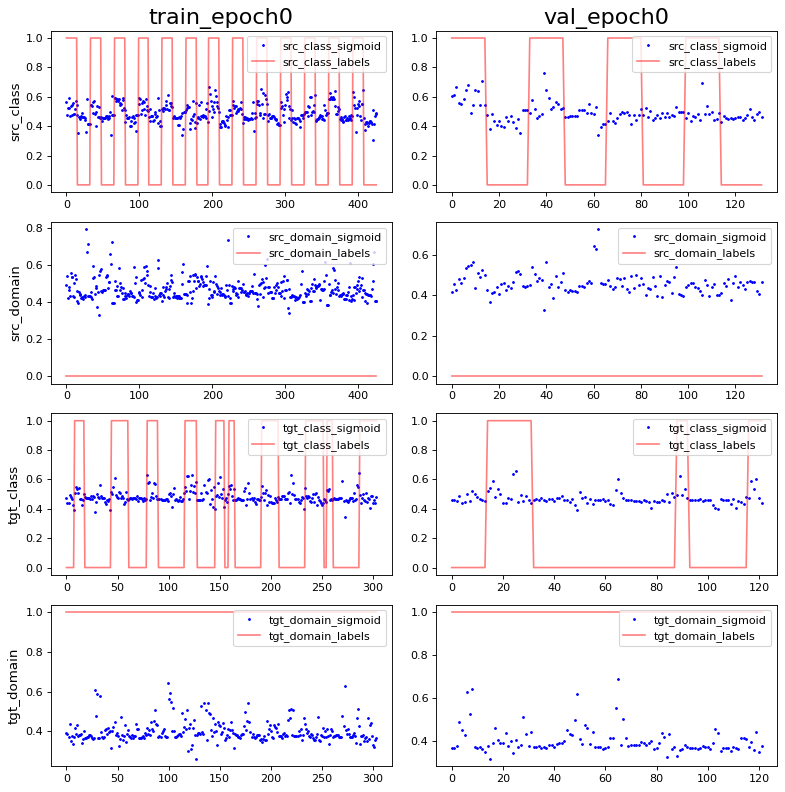

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: 5.842525e-09 0.9956502
PCA var: [14.1 26.1 32.9 39.4 44.  47.  49.5 51.6 53.5 55.2]
show standardize mean and std: -8.3436075e-10 0.99390495
PCA var: [16.       28.3      36.8      43.1      48.       51.3      54.399998
 56.899998 58.999996 60.999996]


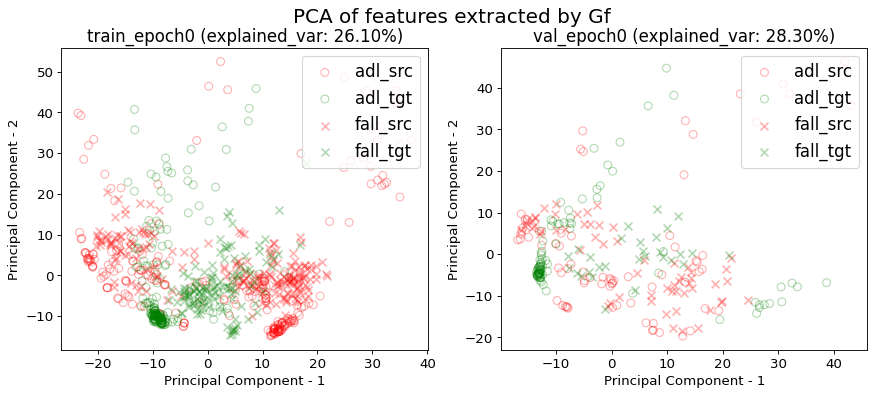

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/


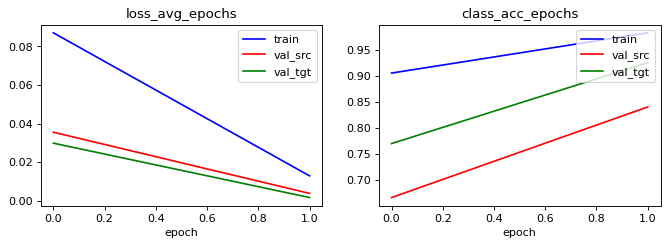

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.9882629107981221 0.9084507042253521 0.6009389671361502 0.0
acc performance: 0.8409090909090909 0.9090909090909091 0.8560606060606061 0.0


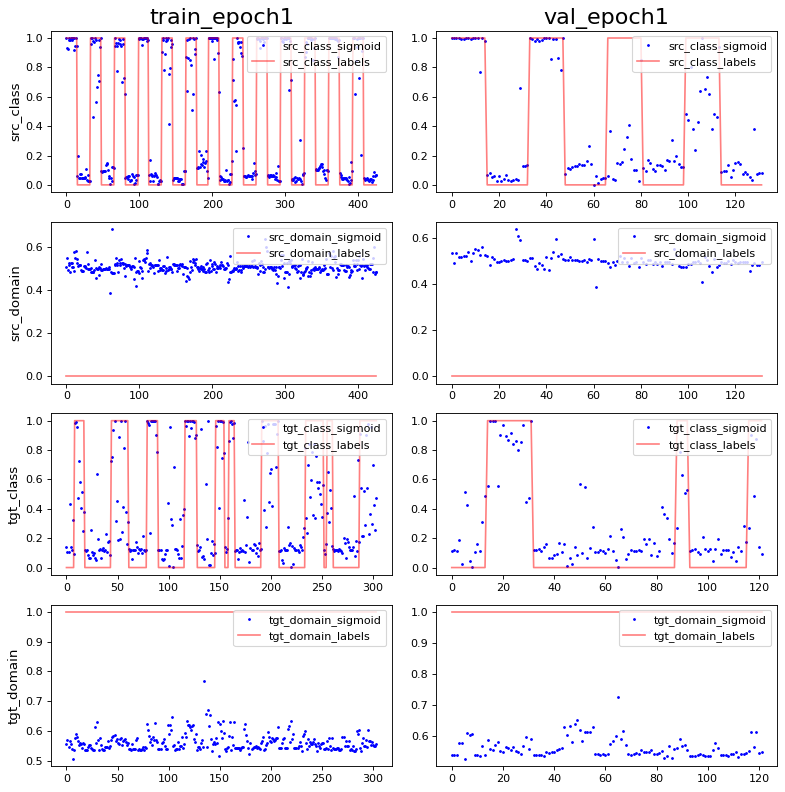

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: -2.6853844e-09 0.9904054
PCA var: [31.       48.1      55.8      60.2      63.600002 65.9      67.8
 69.3      70.8      72.200005]
show standardize mean and std: 2.5030822e-09 0.98952854
PCA var: [30.599998 45.199997 54.699997 59.499996 63.099995 66.299995 69.2
 71.899994 74.2      76.      ]


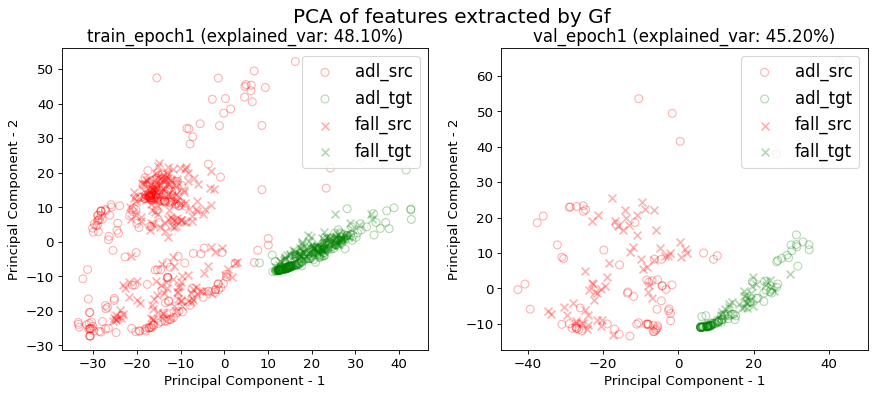

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.4613583138173302 0.8056206088992974 0.2693208430913349 0.20140515222482436
acc performance: 0.45038167938931295 0.8931297709923665 0.2900763358778626 0.15267175572519084


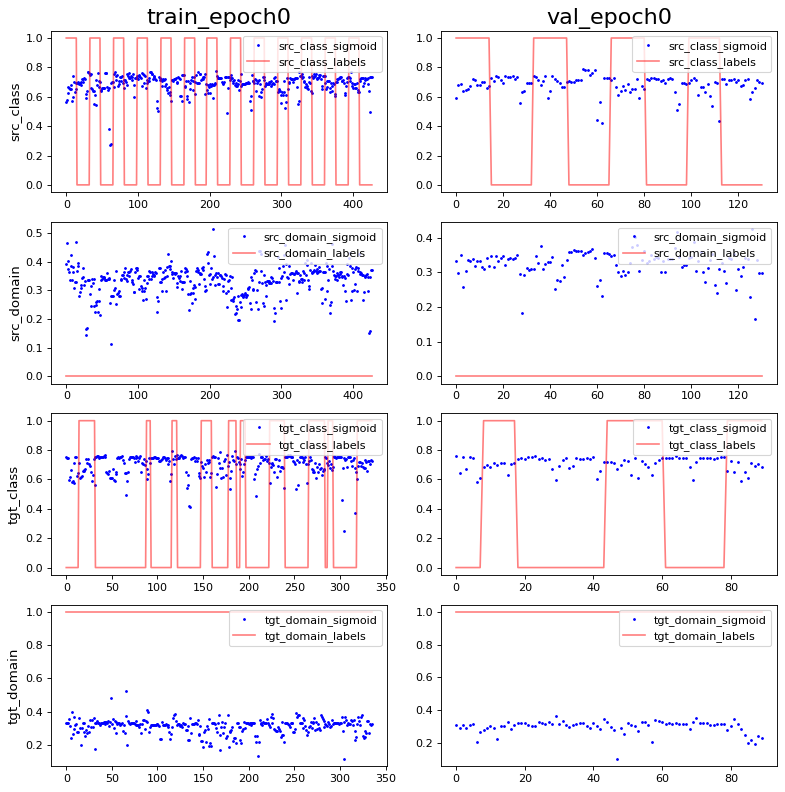

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: -2.4998017e-09 0.9965217
PCA var: [14.       24.400002 31.900002 37.7      41.7      44.7      46.8
 48.6      50.199997 51.6     ]
show standardize mean and std: 2.8918292e-09 0.99652183
PCA var: [14.7      24.8      32.2      39.       43.8      47.8      50.399998
 52.899998 55.3      57.5     ]


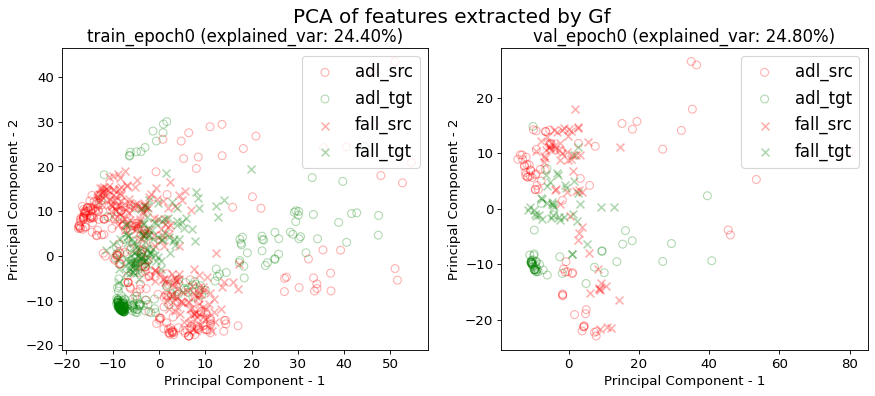

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/


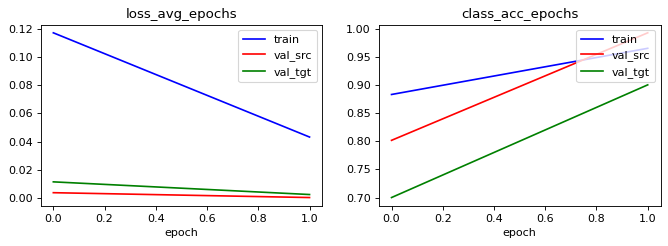

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.9765807962529274 0.47540983606557374 0.6885245901639344 0.38875878220140514
acc performance: 0.9923664122137404 0.4732824427480916 0.6183206106870229 0.32061068702290074


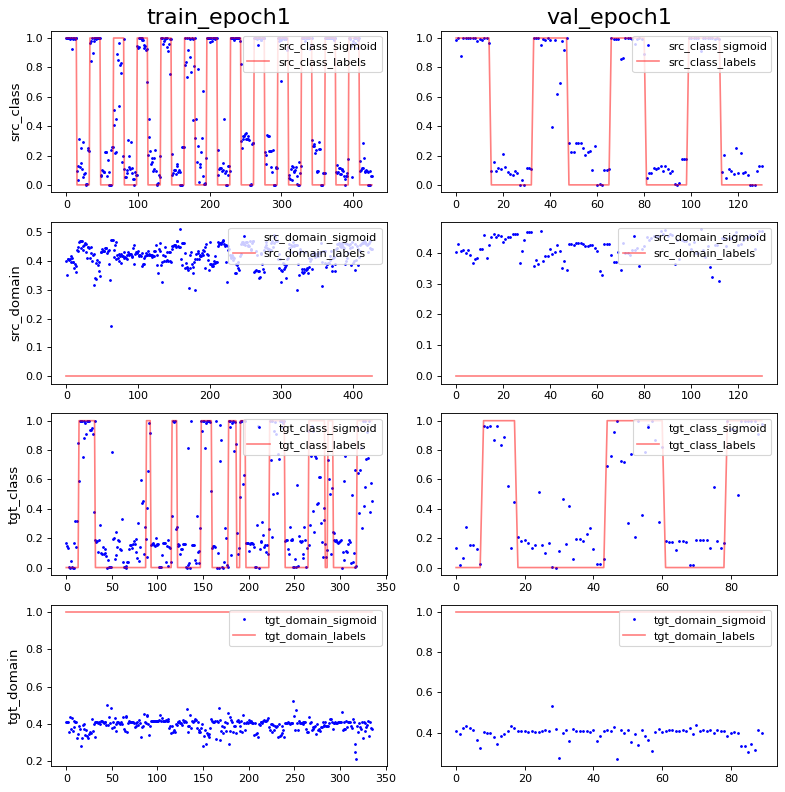

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: 2.343564e-09 0.97405565
PCA var: [33.       47.4      54.       58.       60.7      62.8      64.7
 66.6      68.299995 69.799995]
show standardize mean and std: -4.794743e-10 0.9646531
PCA var: [33.7      50.2      57.600002 62.600002 65.600006 68.200005 70.600006
 72.700005 74.700005 76.4     ]


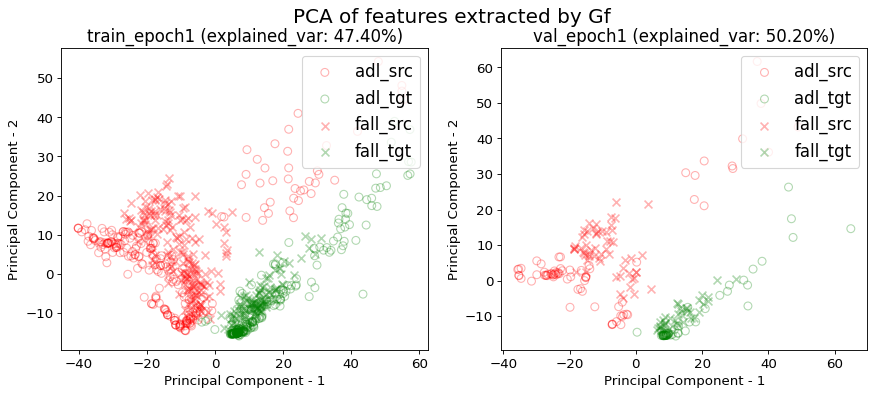

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.012876,0.983568,0.003796,0.840909,0.001635,0.926230
1,1.000000,0.043202,0.964871,0.000244,0.992366,0.002383,0.900000
mean,0.500000,0.028039,0.974220,0.002020,0.916638,0.002009,0.913115
std,0.707107,0.021444,0.013221,0.002512,0.107096,0.000529,0.018547


src val loss: 0.0020±0.0025
src val acc: 0.9166±0.1071
tgt val loss: 0.0020±0.0005
tgt val acc: 0.9131±0.0185
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UPFall', 'num_epochs': 2, 'channel_n': 32, 'batch_size': 4, 'learning_rate': 0.01, 'sensor_loc': 'wrist', 'date': '2020/04/09 20:13:45', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  train on target, val on target(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_model

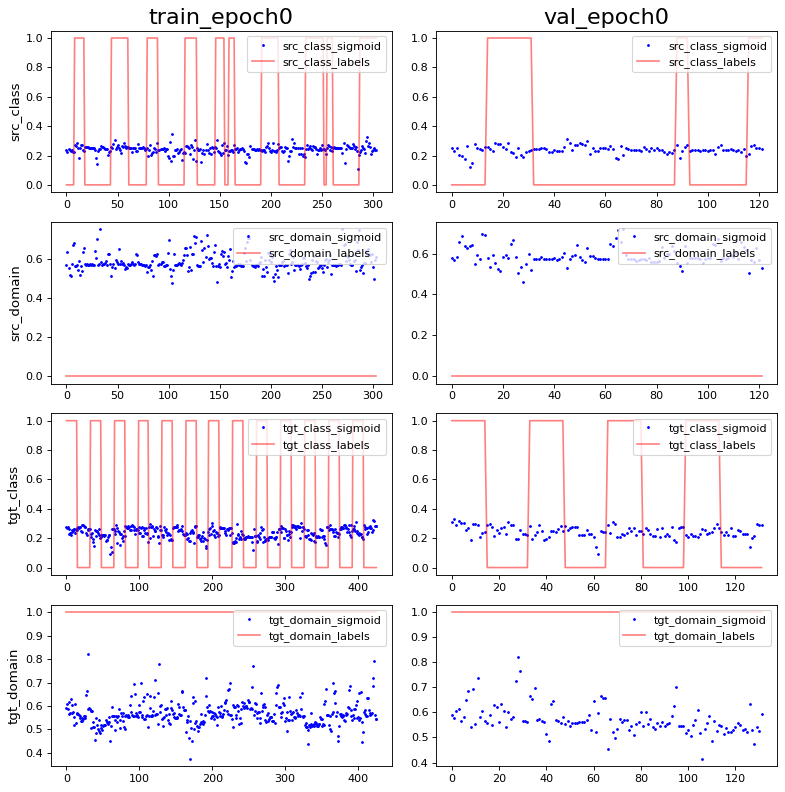

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: -4.3546772e-10 0.9956503
PCA var: [16.       26.3      32.1      37.1      41.699997 45.199997 47.6
 49.6      51.3      52.8     ]
show standardize mean and std: -1.2515411e-09 0.99390507
PCA var: [15.9      28.2      35.600002 41.7      46.100002 49.4      52.2
 54.600002 57.000004 59.100002]


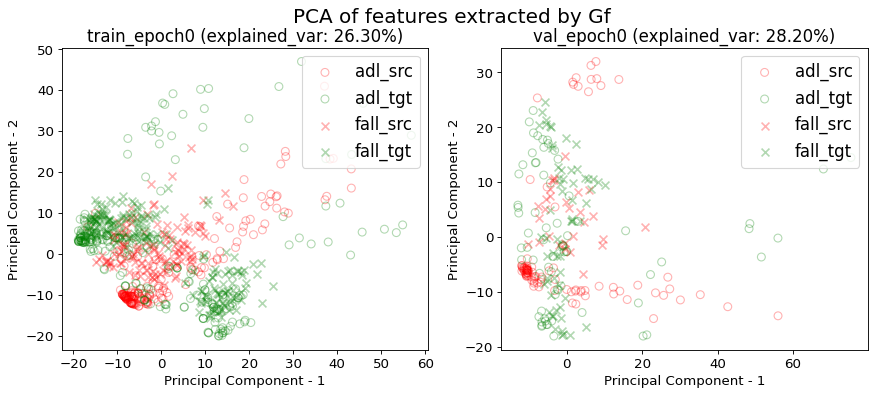

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/


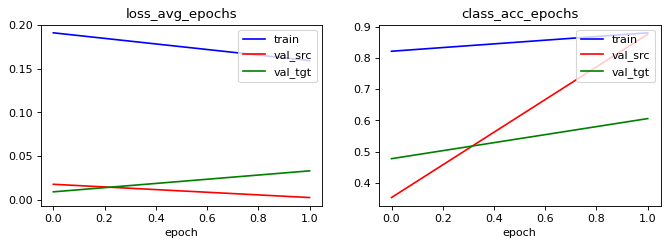

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.8618421052631579 0.0 0.8585526315789473 1.332236842105263
acc performance: 0.8770491803278688 0.09836065573770492 0.6557377049180327 1.0491803278688525


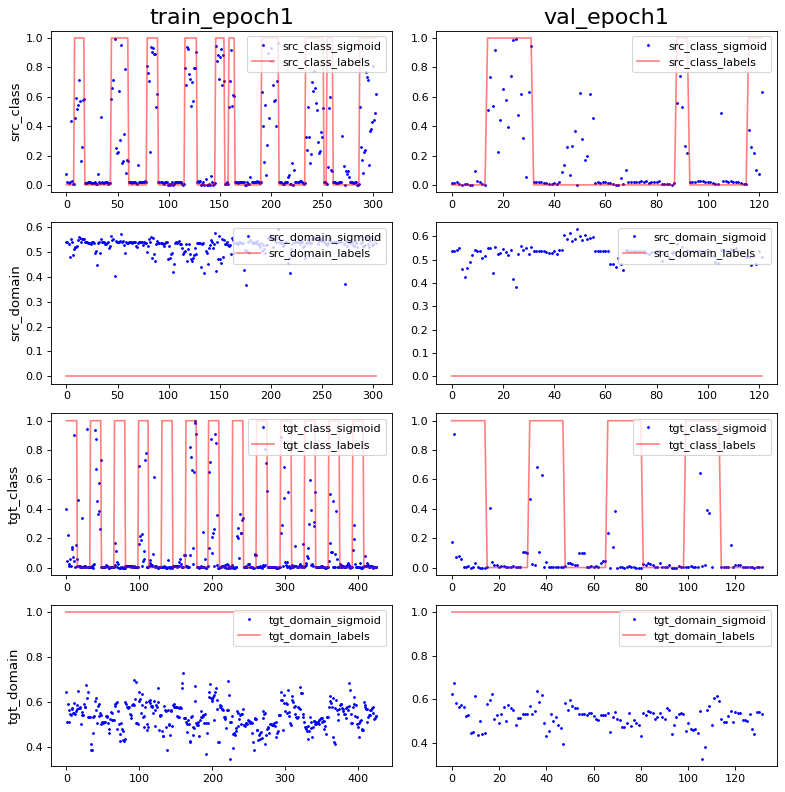

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: -2.8305402e-08 0.96600187
PCA var: [35.3      49.199997 55.699997 59.399998 62.1      64.299995 66.399994
 68.399994 69.7      70.899994]
show standardize mean and std: 1.2515411e-09 0.96059513
PCA var: [28.600002 47.100002 55.100002 60.600002 64.3      67.200005 69.600006
 71.50001  73.200005 74.700005]


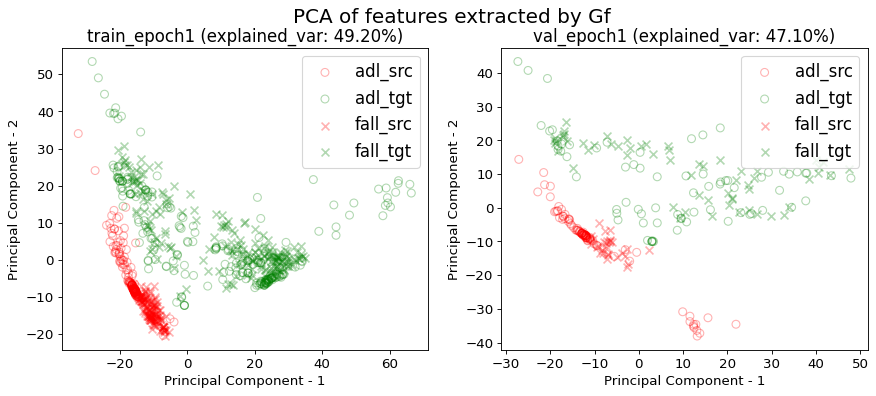

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.6607142857142857 0.0 0.6607142857142857 1.2708333333333333
acc performance: 0.5777777777777777 0.0 0.8 1.4555555555555555


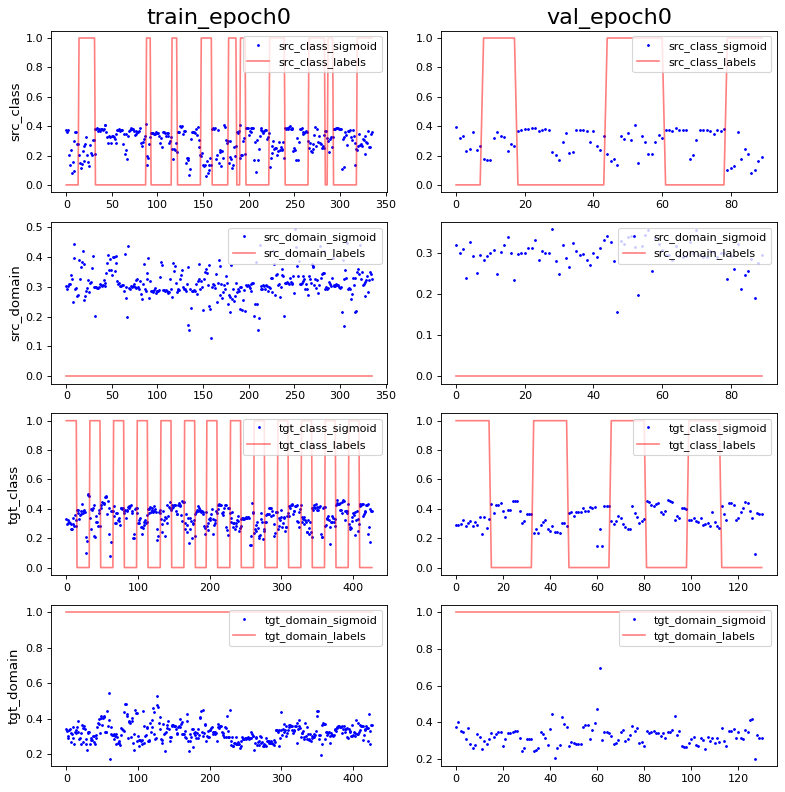

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 2.4303626e-09 0.99565023
PCA var: [14.599999 26.       34.9      39.4      43.2      46.600002 48.600002
 50.500004 52.100002 53.500004]
show standardize mean and std: 2.1576343e-09 0.994778
PCA var: [17.       27.       36.6      42.899998 47.6      51.699997 54.6
 57.1      59.5      61.5     ]


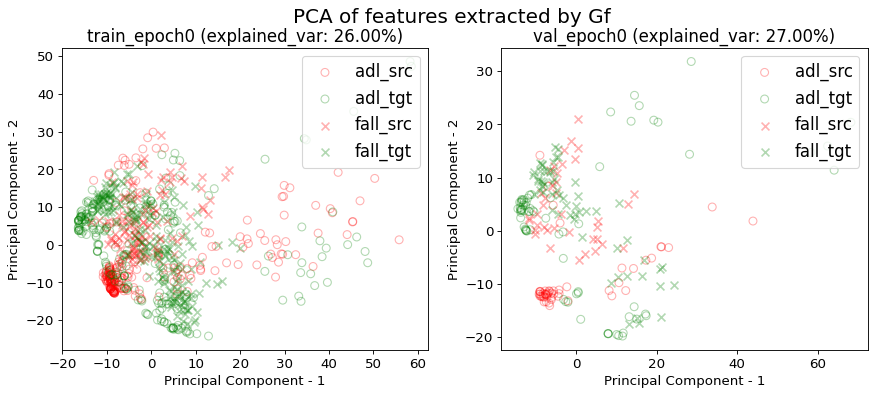

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/


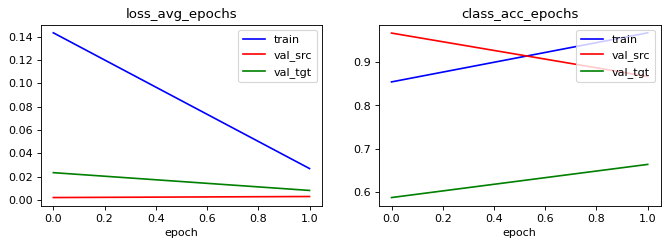

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.9404761904761905 0.16964285714285715 0.8660714285714286 1.0714285714285714
acc performance: 0.8666666666666667 0.3111111111111111 0.9666666666666667 1.3777777777777778


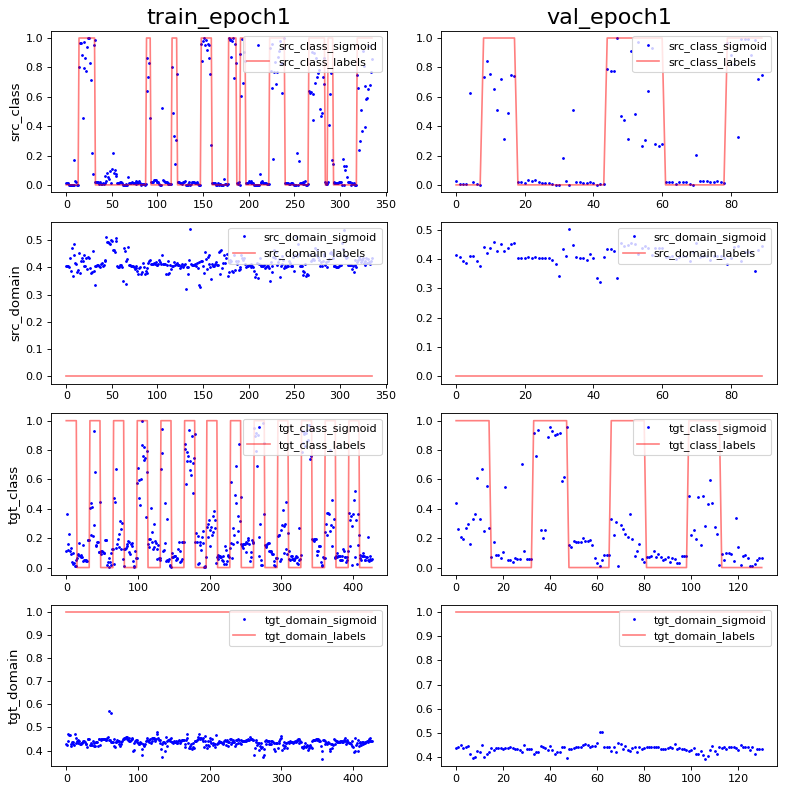

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 8.342437e-09 0.9868932
PCA var: [44.5 55.9 61.2 65.  67.5 69.4 71.1 72.6 74.  75.3]
show standardize mean and std: 1.1762103e-08 0.98469186
PCA var: [49.       61.5      67.5      70.6      73.6      76.       77.8
 79.3      80.700005 82.100006]


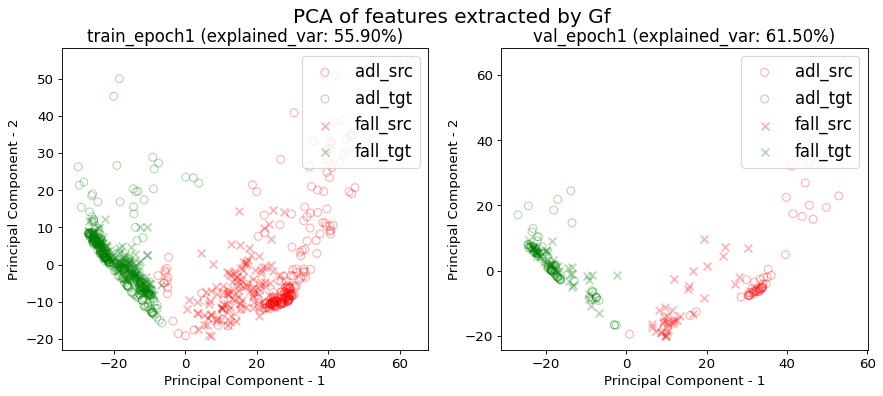

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.159449,0.881579,0.002514,0.877049,0.033100,0.606061
1,1.000000,0.026882,0.967262,0.002903,0.866667,0.008108,0.664122
mean,0.500000,0.093165,0.924420,0.002708,0.871858,0.020604,0.635091
std,0.707107,0.093739,0.060587,0.000275,0.007342,0.017673,0.041056


src val loss: 0.0027±0.0003
src val acc: 0.8719±0.0073
tgt val loss: 0.0206±0.0177
tgt val acc: 0.6351±0.0411
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 426, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UMAFall', 'num_epochs': 2, 'channel_n': 32, 'batch_size': 4, 'learning_rate': 0.01, 'sensor_loc': 'ankle', 'date': '2020/04/09 20:13:59', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  DANN training transferring knowledge(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage

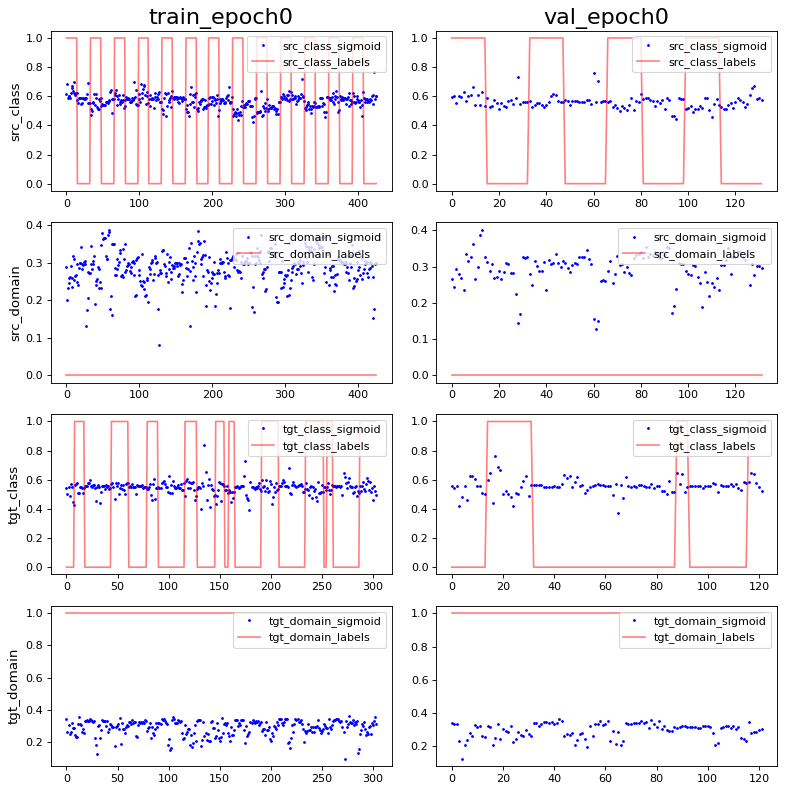

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 0.0 0.99782735
PCA var: [15.6      25.7      32.100002 37.2      41.100002 44.600002 46.800003
 48.800003 50.700005 52.500004]
show standardize mean and std: 2.9202625e-09 0.9973925
PCA var: [17.1      29.900002 37.300003 42.9      47.       50.5      53.6
 56.3      58.6      60.899998]


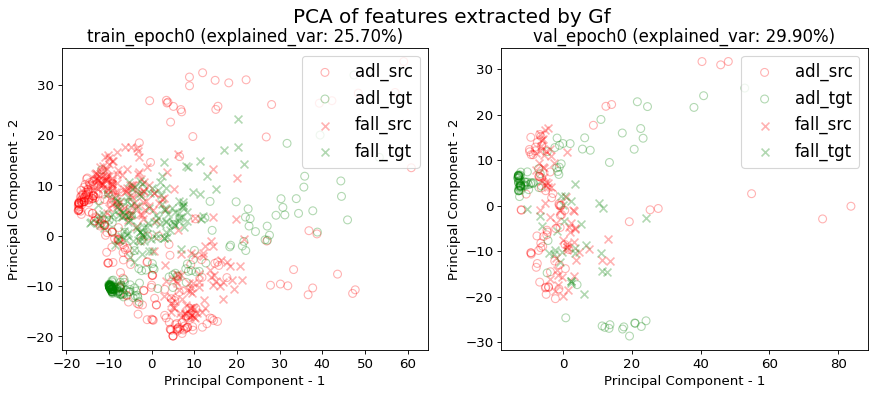

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/


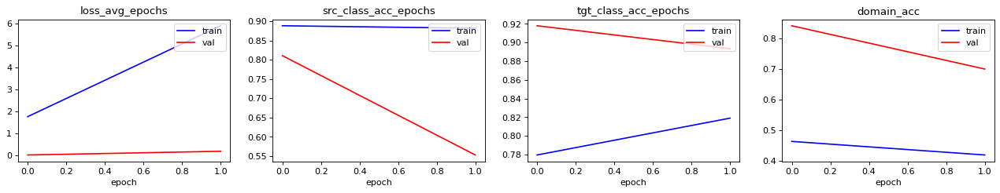

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.5633802816901409 0.9976525821596244 0.6056338028169014 0.2863849765258216
acc performance: 0.553030303030303 1.0 0.8257575757575758 0.3484848484848485


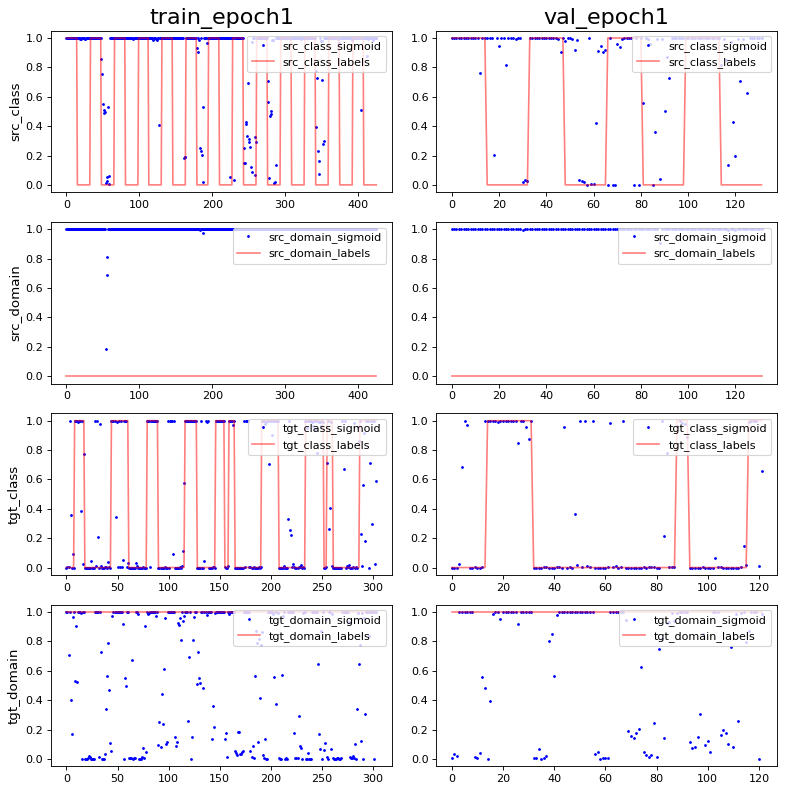

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 5.225613e-09 0.998697
PCA var: [54.000004 65.5      70.7      73.899994 76.09999  78.19999  79.49999
 80.69999  81.79999  82.89999 ]
show standardize mean and std: 2.9202625e-09 0.99782753
PCA var: [49.2      63.       69.       73.       76.3      78.700005 80.4
 81.8      83.100006 84.3     ]


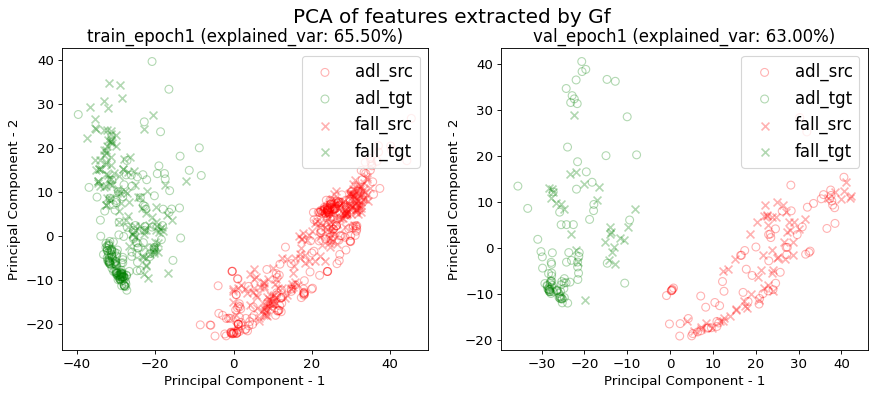

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.27634660421545665 0.09836065573770492 0.2459016393442623 0.7049180327868853
acc performance: 0.29770992366412213 0.15267175572519084 0.2366412213740458 0.5954198473282443


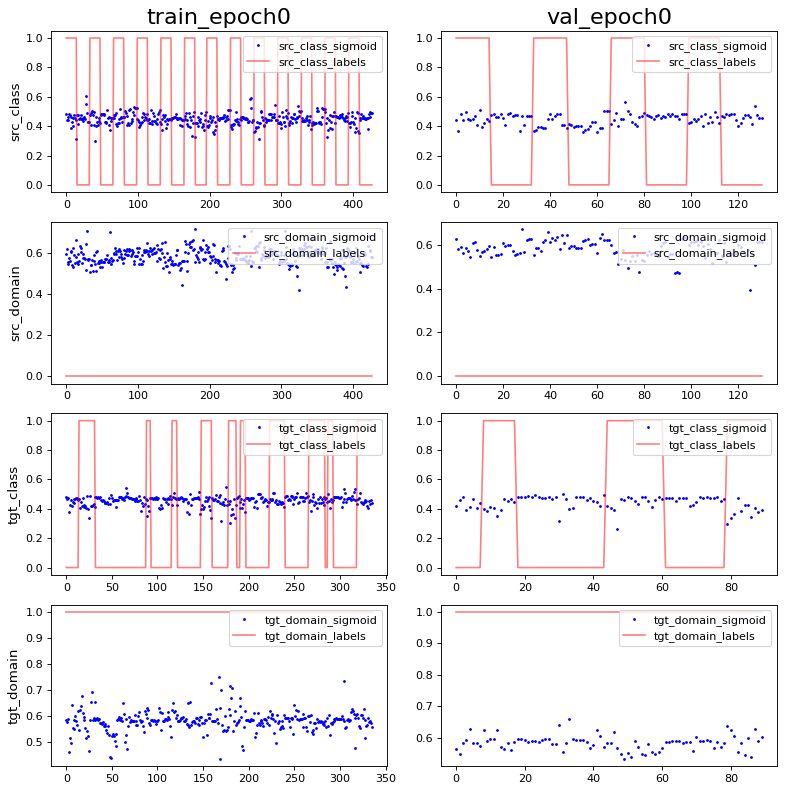

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 2.8817158e-09 0.9943417
PCA var: [13.3      23.9      31.7      37.100002 41.2      44.4      46.600002
 48.600002 50.4      52.100002]
show standardize mean and std: -1.9029136e-09 0.992594
PCA var: [15.9      28.9      36.1      42.199997 46.699997 50.299995 53.099995
 55.599995 57.899994 60.099995]


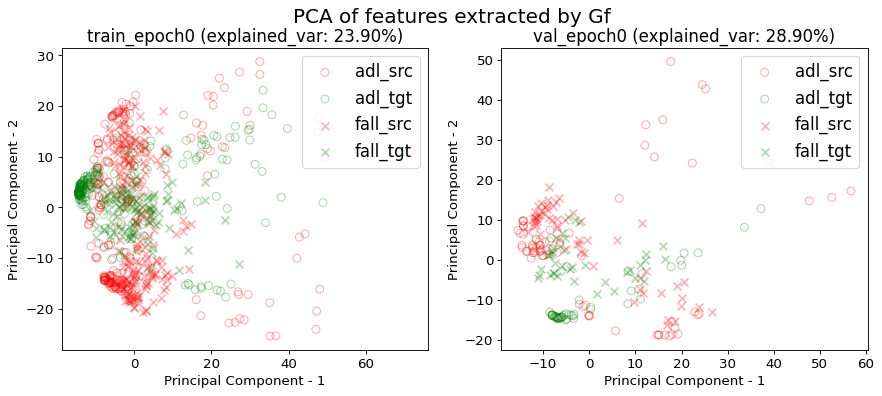

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/


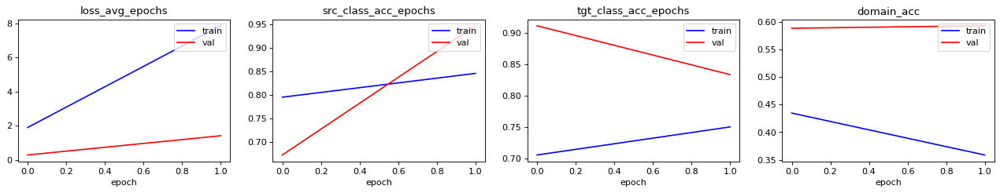

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.9039812646370023 1.0 0.6791569086651054 0.0
acc performance: 0.9465648854961832 1.0 0.5725190839694656 0.0


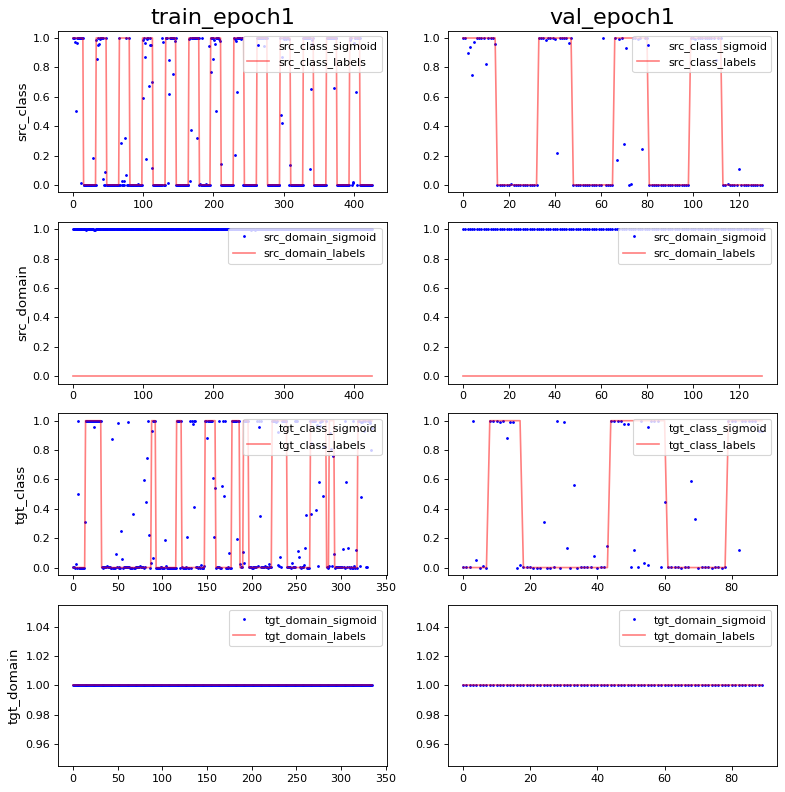

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 5.7634315e-09 0.9991317
PCA var: [47.3 58.4 66.1 69.  71.6 73.6 75.4 76.9 78.3 79.5]
show standardize mean and std: -8.9901425e-10 0.9982624
PCA var: [51.8      61.6      69.2      72.799995 75.49999  77.899994 79.7
 81.299995 82.799995 84.1     ]


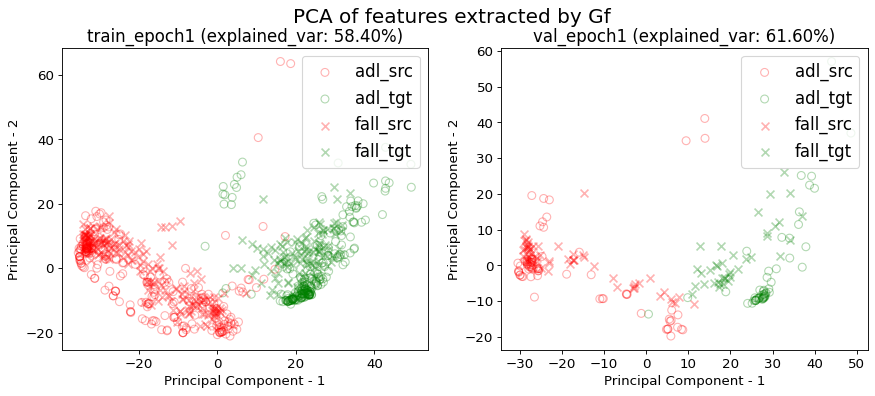

---------------Exporting model performance---------------
show df_performance


,i_CV,train_src_class_loss,train_tgt_class_loss,train_src_domain_loss,train_tgt_domain_loss,train_src_class_acc,train_tgt_class_acc,train_domain_acc,val_src_class_loss,val_tgt_class_loss,val_src_domain_loss,val_tgt_domain_loss,val_src_class_acc,val_tgt_class_acc,val_domain_acc
0,0.000000,0.170953,0.564713,3.523657,2.202896,0.881579,0.819079,0.419408,0.040222,0.009011,1.306349e-07,0.152610,0.553030,0.893443,0.700787
1,1.000000,0.282477,0.501928,4.205994,3.373367,0.845238,0.750000,0.358631,0.003316,0.021287,0.000000e+00,1.399693,0.946565,0.833333,0.592760
mean,0.500000,0.226715,0.533321,3.864826,2.788132,0.863409,0.784539,0.389019,0.021769,0.015149,6.531744e-08,0.776151,0.749798,0.863388,0.646774
std,0.707107,0.078860,0.044395,0.482485,0.827648,0.025697,0.048846,0.042976,0.026097,0.008681,9.237281e-08,0.881821,0.278271,0.042504,0.076387


val_src_class_acc: 0.7498±0.2783
val_tgt_class_acc: 0.8634±0.0425
val_domain_acc: 0.6468±0.0764
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'src_dataset_name': 'UPFall', 'tgt_dataset_name': 'UMAFall', 'src_sensor_loc': 'wrist', 'tgt_sensor_loc': 'ankle', 'date': '2020/04/09 20:14:15', 'num_epochs': 2, 'channel_n': 32, 'batch_size': 4, 'learning_rate': 0.01, 'input_dim': (4, 3, 66), 'output_dim': 2, 'label_dim': (4,)}
val_tgt_class_acc: 0.8634±0.0425
val_domain_acc: 0.6468±0.0764
time elapsed: 00:00:44

======================  train on source, val on target(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
FeatureExtractor_

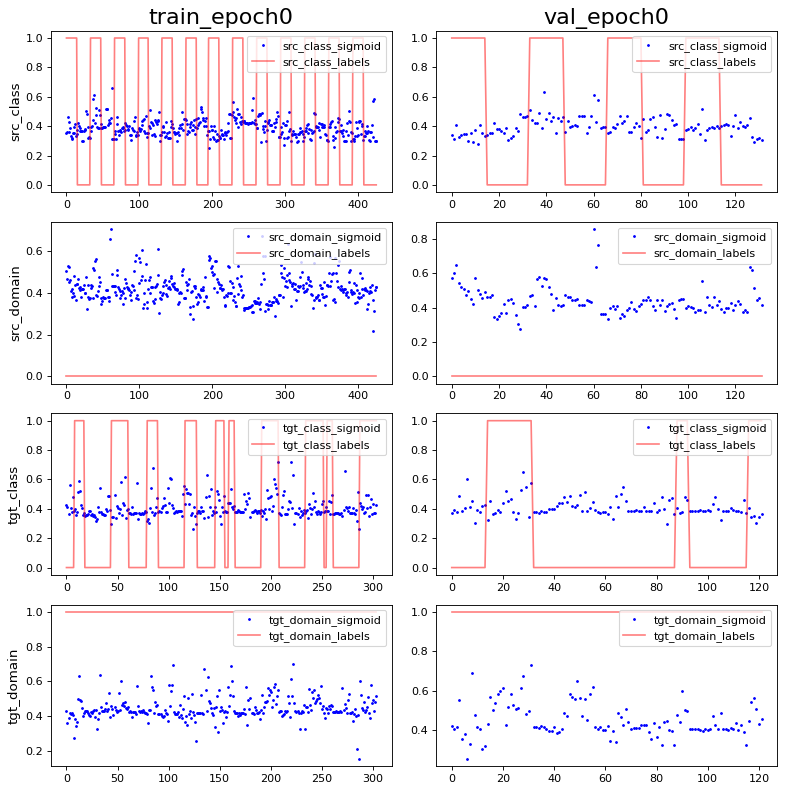

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: 5.8062366e-10 0.99999994
PCA var: [14.200001 27.5      36.       40.8      44.899998 48.499996 51.399998
 53.999996 56.299995 58.299995]
show standardize mean and std: 8.3436075e-10 1.0
PCA var: [17.7      33.9      43.600002 48.7      52.8      56.7      60.2
 62.9      65.1      67.299995]


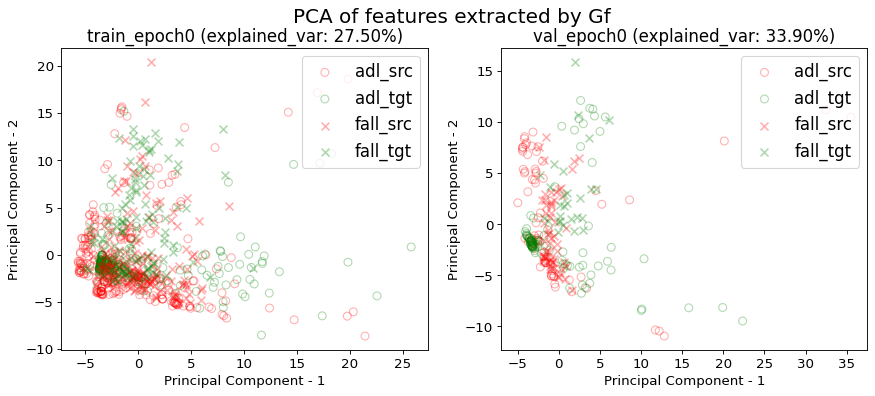

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/


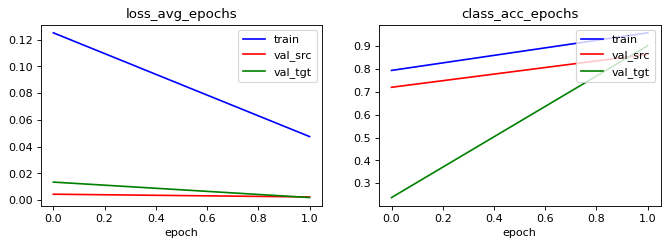

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.9765258215962441 0.20657276995305165 0.5258215962441315 0.5492957746478874
acc performance: 0.8636363636363636 0.21212121212121213 0.8333333333333334 0.6742424242424242


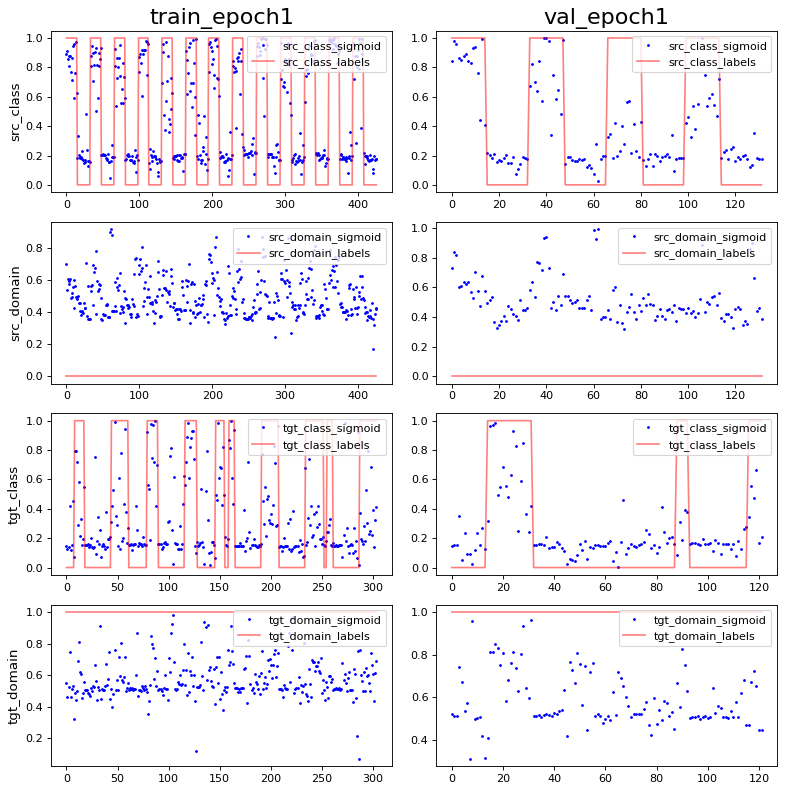

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: -9.289979e-09 1.0
PCA var: [33.1      51.5      57.2      61.7      65.1      67.4      69.5
 71.3      72.8      74.100006]
show standardize mean and std: 8.3436075e-10 1.0
PCA var: [30.899998 53.899998 60.199997 64.299995 68.1      71.7      73.899994
 75.7      77.5      79.      ]


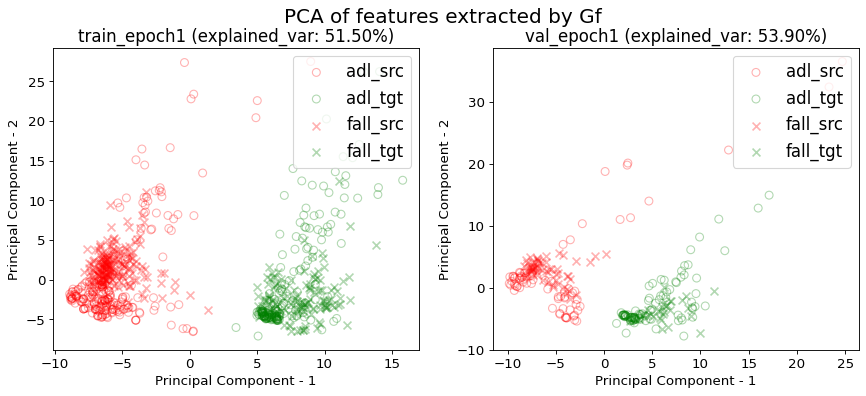

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.5573770491803278 0.20608899297423888 0.2857142857142857 0.39344262295081966
acc performance: 0.5343511450381679 0.15267175572519084 0.22137404580152673 0.3511450381679389


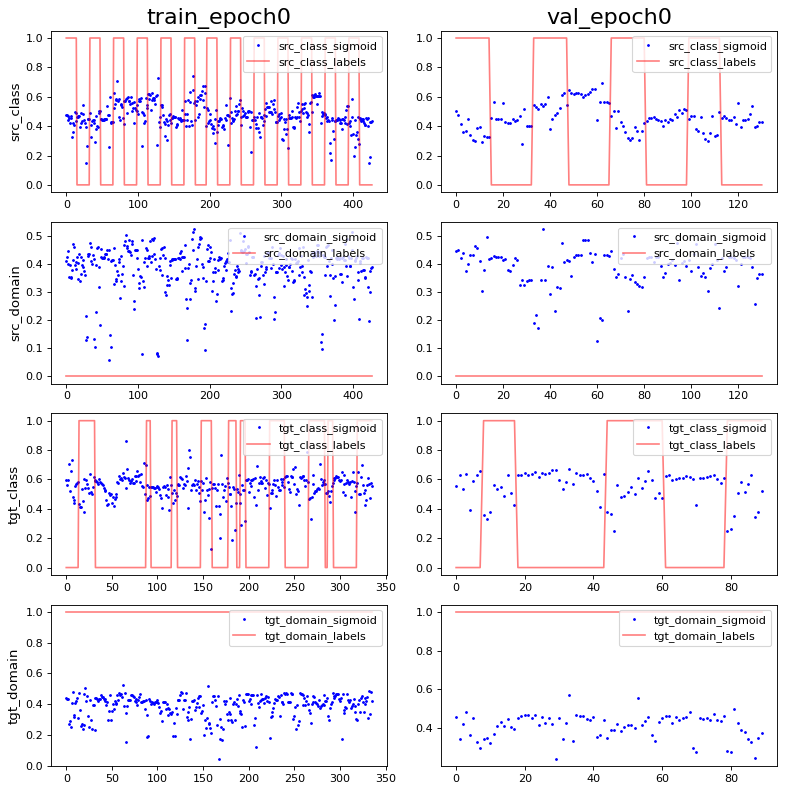

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: -2.0831681e-10 1.0
PCA var: [21.699999 31.3      38.       43.6      47.1      50.399998 52.899998
 55.3      57.5      59.6     ]
show standardize mean and std: 1.9178972e-09 1.0
PCA var: [26.800001 36.2      44.9      51.300003 55.9      59.5      62.5
 65.       67.2      69.399994]


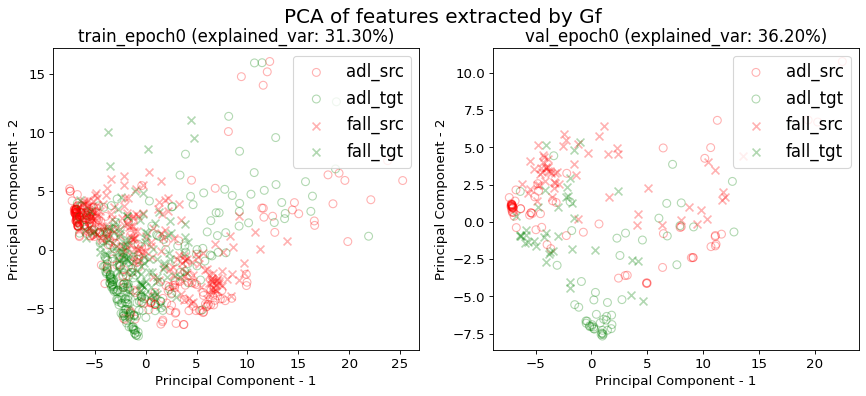

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/


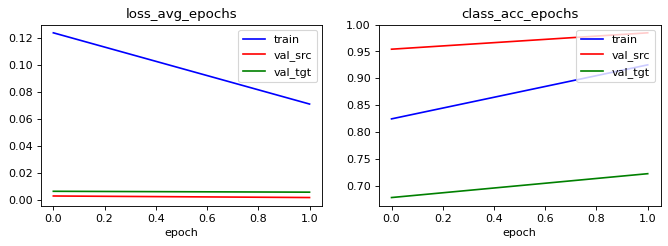

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.9203747072599532 0.11943793911007025 0.6065573770491803 0.09601873536299765
acc performance: 0.9847328244274809 0.08396946564885496 0.4961832061068702 0.04580152671755725


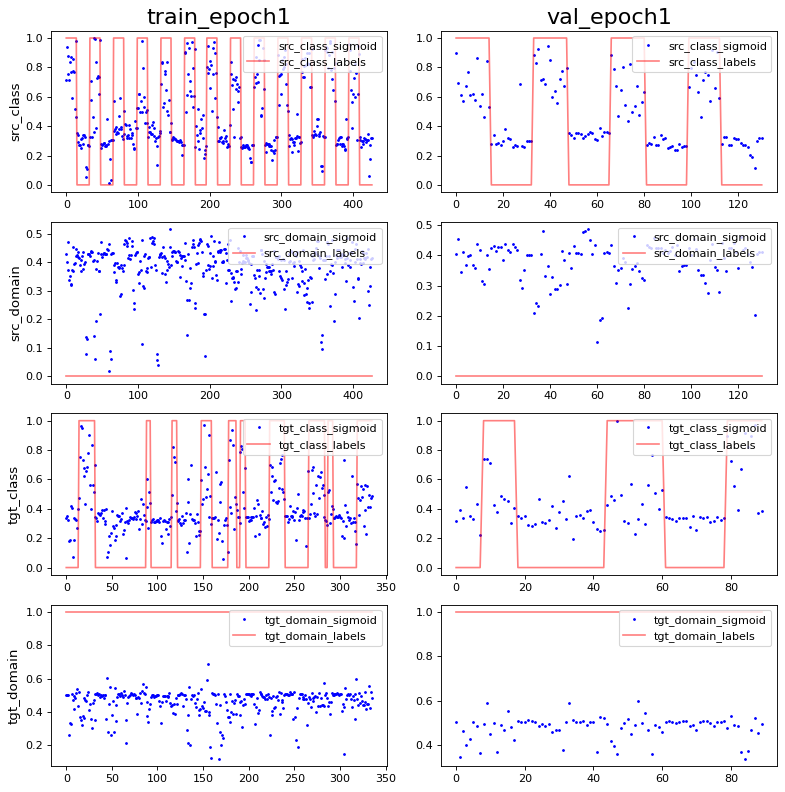

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: 1.1110229e-09 1.0
PCA var: [28.099998 40.699997 47.199997 52.699997 55.699997 58.499996 60.799995
 62.999996 64.899994 66.49999 ]
show standardize mean and std: -1.9178972e-09 0.99999994
PCA var: [28.8      41.699997 49.299995 55.299995 59.399994 62.799995 65.799995
 68.399994 70.59999  72.49999 ]


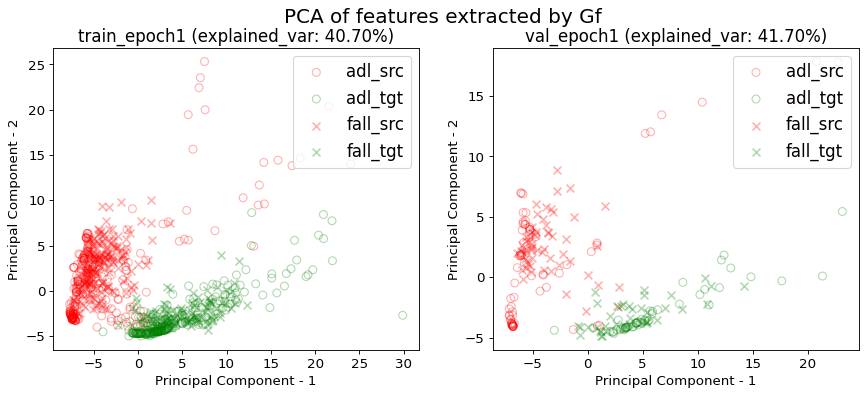

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.047583,0.957746,0.002450,0.863636,0.001997,0.901639
1,1.000000,0.070912,0.925059,0.001682,0.984733,0.005656,0.722222
mean,0.500000,0.059248,0.941403,0.002066,0.924185,0.003826,0.811931
std,0.707107,0.016496,0.023114,0.000543,0.085628,0.002587,0.126867


src val loss: 0.0021±0.0005
src val acc: 0.9242±0.0856
tgt val loss: 0.0038±0.0026
tgt val acc: 0.8119±0.1269
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UPFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.001, 'sensor_loc': 'wrist', 'date': '2020/04/09 20:14:30', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  train on target, val on target(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modelout

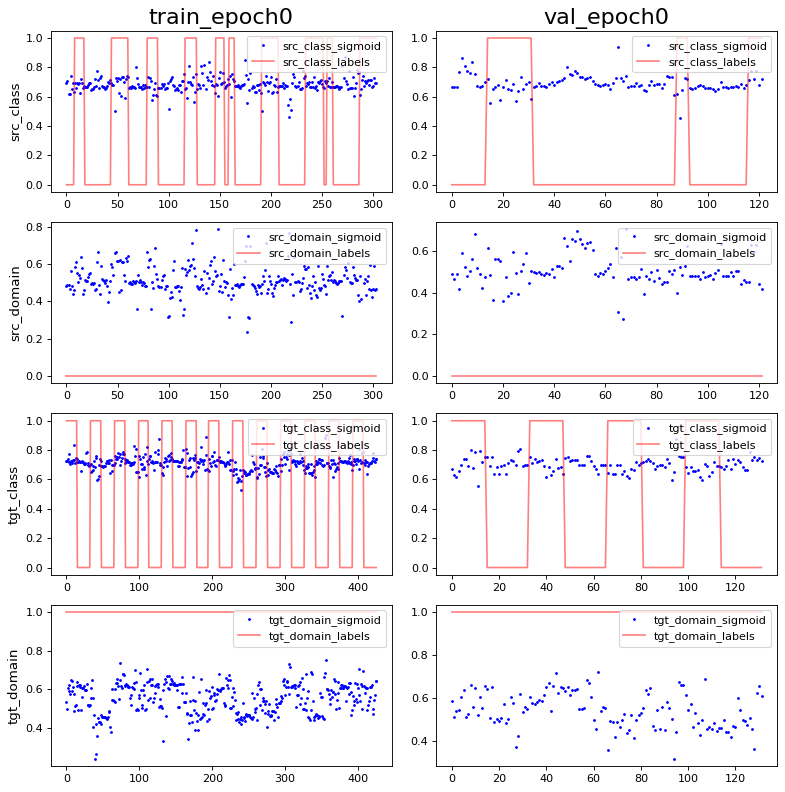

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: -2.9031182e-09 0.99303126
PCA var: [25.9      38.9      46.100002 50.9      54.       56.6      58.699997
 60.799995 62.599995 64.299995]
show standardize mean and std: -8.3436075e-10 0.9965218
PCA var: [26.       40.       46.9      52.100002 55.600002 58.800003 61.9
 64.200005 66.4      68.4     ]


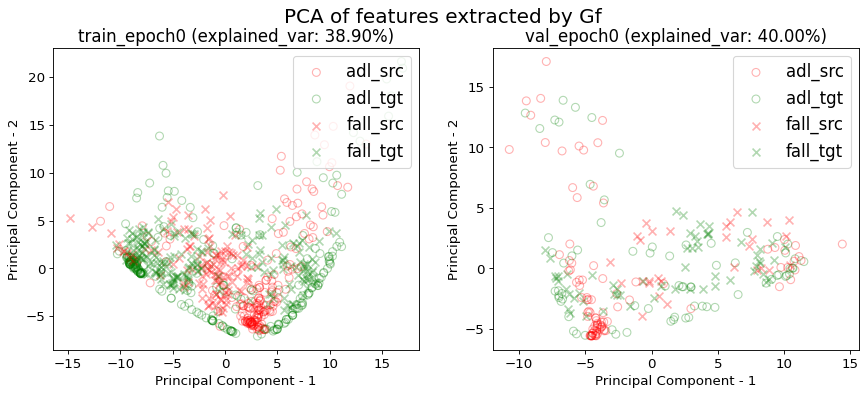

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/


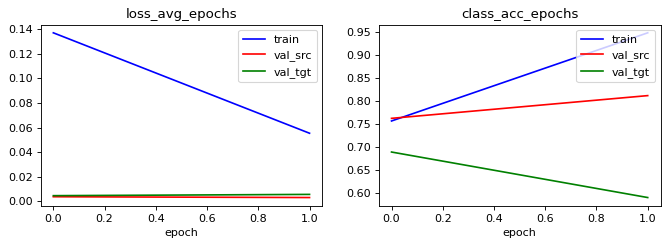

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.9342105263157895 0.8881578947368421 0.8980263157894737 0.8848684210526315
acc performance: 0.8114754098360656 0.8770491803278688 0.639344262295082 0.45901639344262296


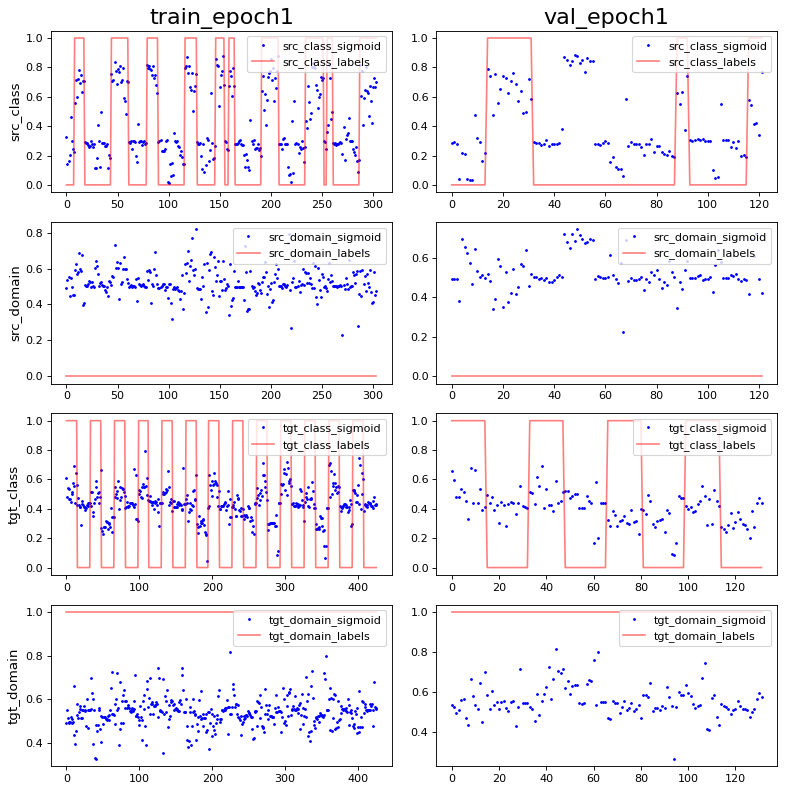

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: -4.6449893e-09 0.99652165
PCA var: [21.       34.       42.1      47.8      51.899998 54.999996 57.599995
 59.699993 61.399994 63.099995]
show standardize mean and std: -3.337443e-09 0.9965218
PCA var: [27.8      43.199997 52.299995 56.399994 60.399994 63.499992 66.19999
 68.69999  70.69999  72.59999 ]


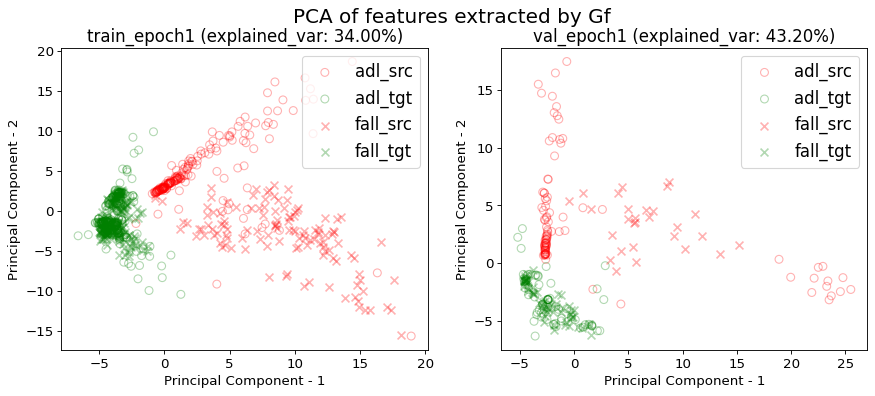

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.5922619047619048 0.0 0.7767857142857143 1.2261904761904763
acc performance: 0.5 0.011111111111111112 1.0 1.4333333333333333


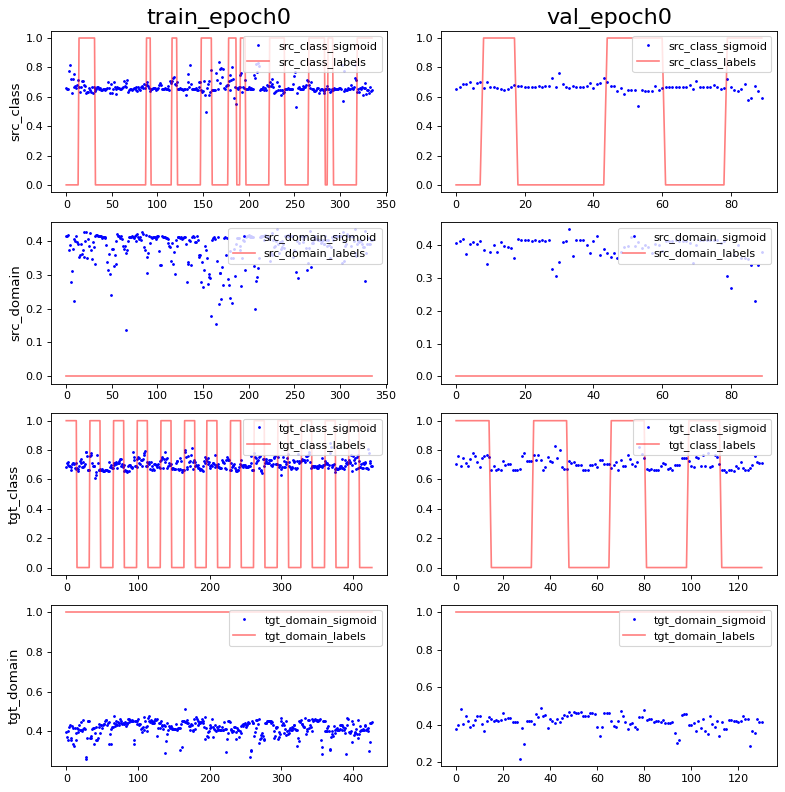

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 0.0 0.98952854
PCA var: [21.       33.1      41.199997 46.1      49.6      52.6      55.399998
 58.1      60.399998 62.499996]
show standardize mean and std: 0.0 0.98952854
PCA var: [20.5      34.2      43.       50.3      54.3      58.       61.6
 64.799995 67.2      69.5     ]


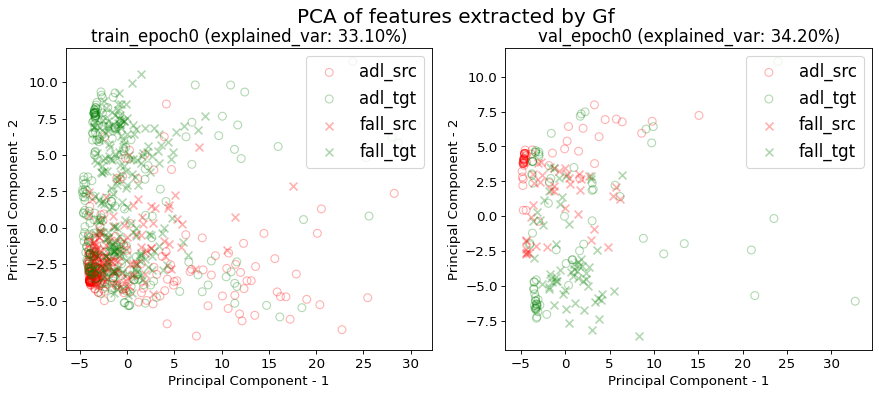

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/


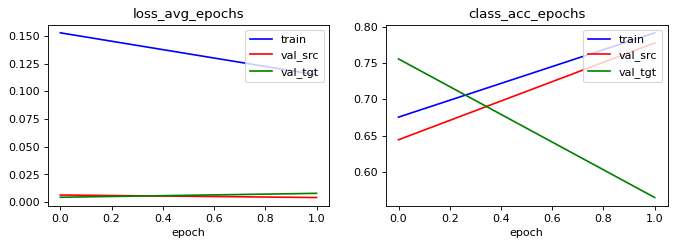

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.8065476190476191 0.03273809523809524 0.75 0.005952380952380952
acc performance: 0.7777777777777778 0.011111111111111112 0.8222222222222222 0.0


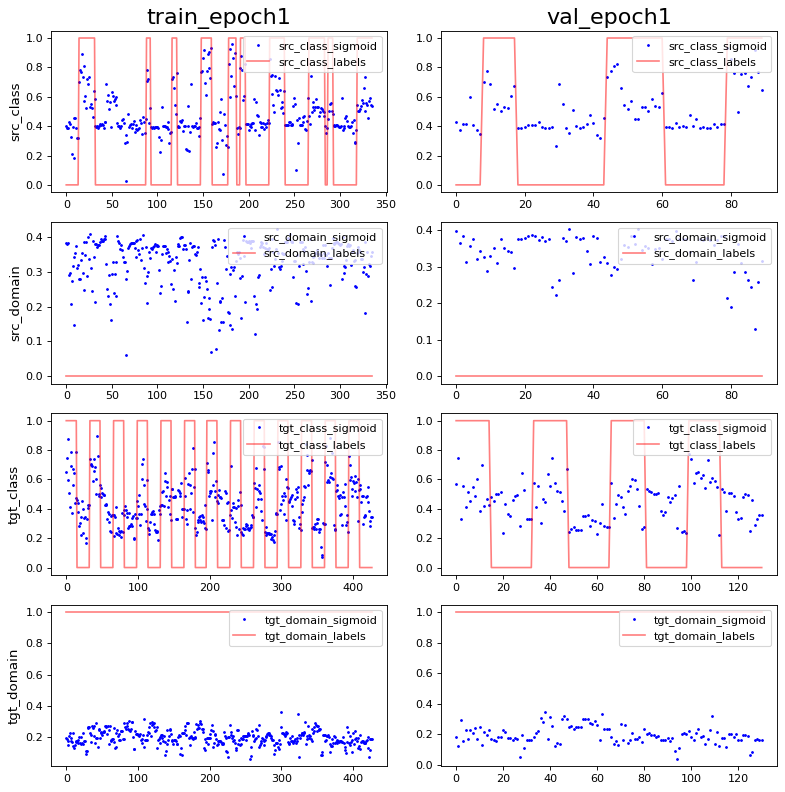

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: -4.4440918e-09 0.99303126
PCA var: [58.499996 71.2      74.799995 76.99999  78.69999  80.29999  81.499985
 82.59998  83.59998  84.499985]
show standardize mean and std: 7.671589e-09 0.98952854
PCA var: [59.899998 74.2      78.399994 81.09999  82.99999  84.49999  85.69999
 86.79999  87.79999  88.59999 ]


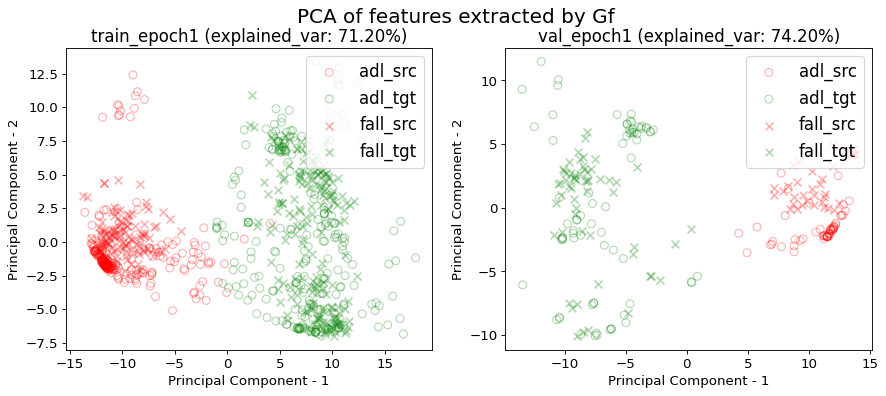

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.055375,0.947368,0.003103,0.811475,0.005657,0.590909
1,1.000000,0.114932,0.791667,0.004129,0.777778,0.007930,0.564885
mean,0.500000,0.085154,0.869518,0.003616,0.794627,0.006794,0.577897
std,0.707107,0.042113,0.110098,0.000726,0.023828,0.001607,0.018401


src val loss: 0.0036±0.0007
src val acc: 0.7946±0.0238
tgt val loss: 0.0068±0.0016
tgt val acc: 0.5779±0.0184
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 426, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UMAFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.001, 'sensor_loc': 'ankle', 'date': '2020/04/09 20:14:43', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  DANN training transferring knowledge(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_m

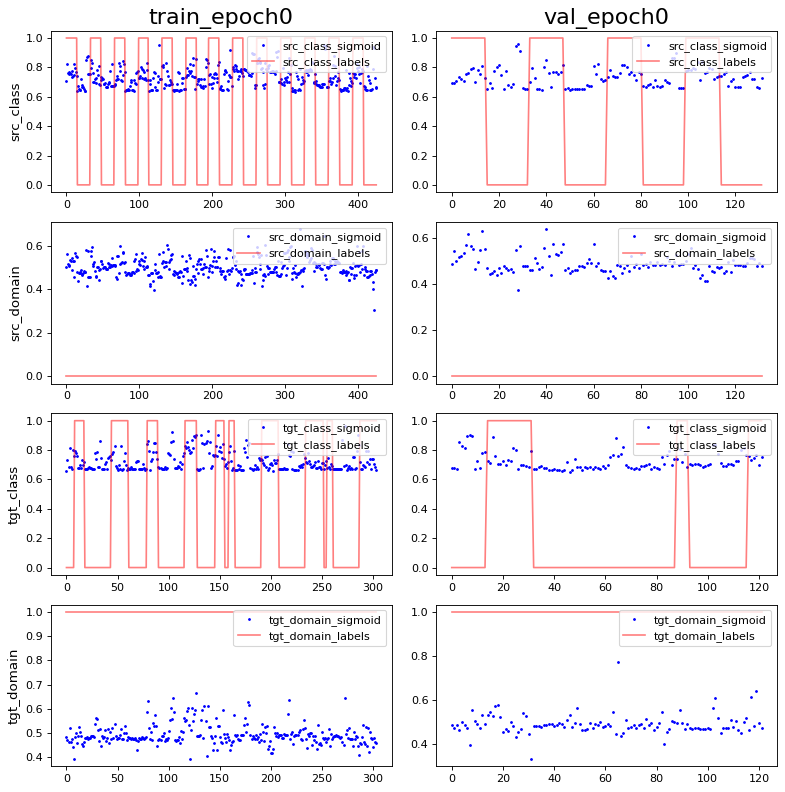

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 3.4837417e-09 0.99303126
PCA var: [22.8 36.1 42.6 47.  50.4 53.5 56.2 58.8 61.2 63.4]
show standardize mean and std: -1.6687215e-09 0.99303126
PCA var: [27.4      41.9      48.600002 53.4      56.800003 60.000004 62.800003
 65.5      68.1      70.299995]


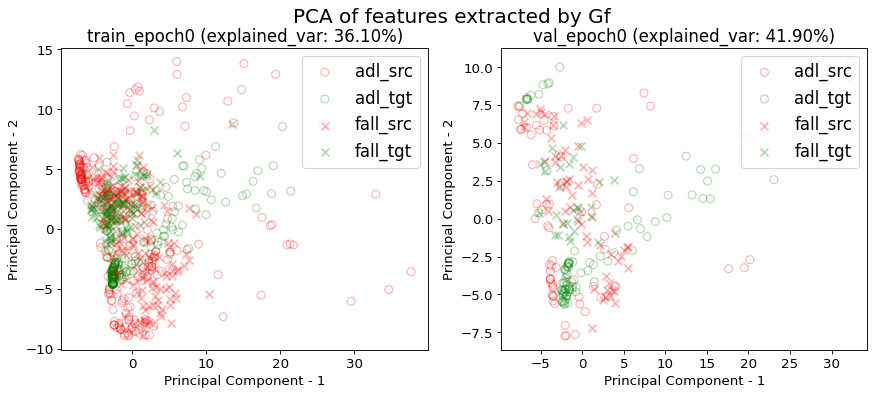

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/


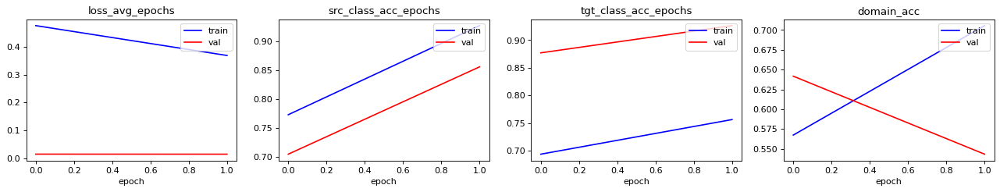

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.9084507042253521 0.44835680751173707 0.5422535211267606 0.5070422535211268
acc performance: 0.8560606060606061 0.3712121212121212 0.8560606060606061 0.6742424242424242


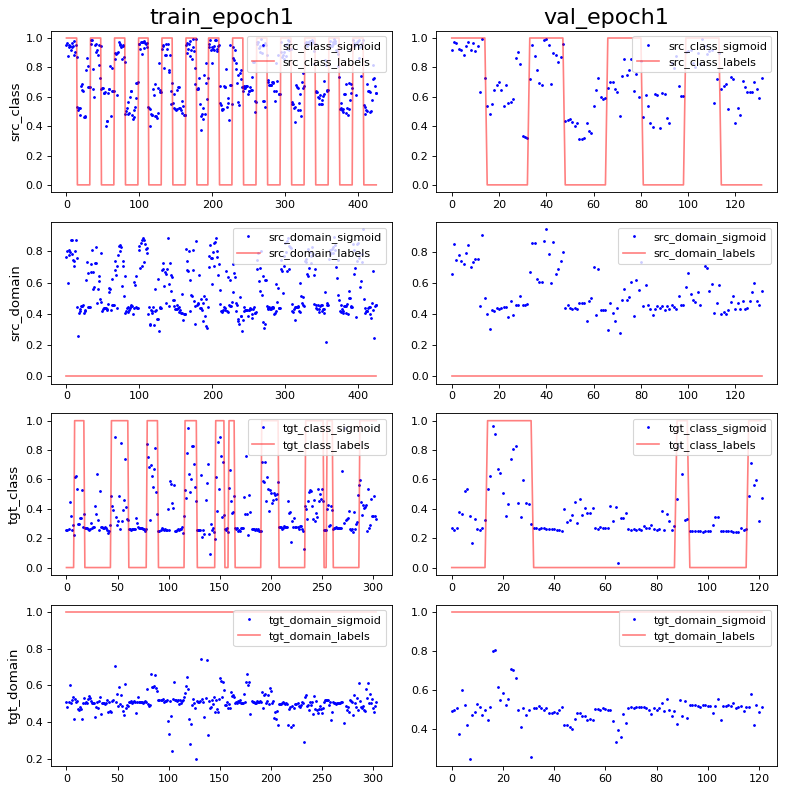

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 2.3224946e-09 0.98952854
PCA var: [48.699997 58.799995 63.699997 68.1      70.6      72.6      74.5
 76.3      77.8      79.100006]
show standardize mean and std: 2.5030822e-09 0.98952854
PCA var: [50.300003 61.700005 68.100006 72.90001  75.80001  78.00001  79.80001
 81.40001  82.80001  84.10001 ]


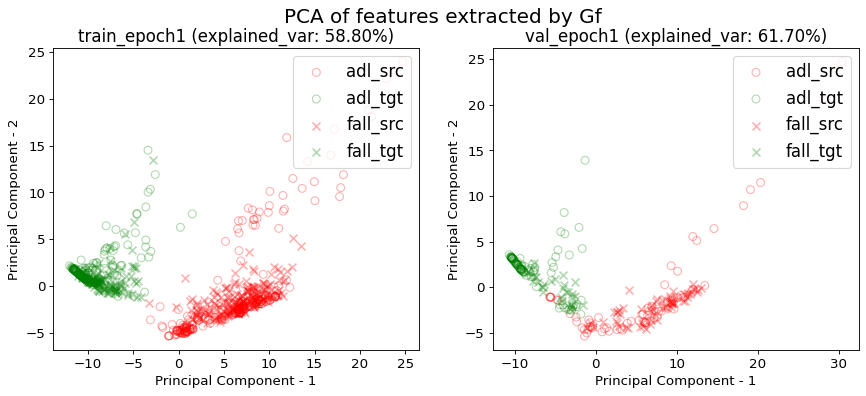

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.6112412177985949 0.8056206088992974 0.5292740046838408 0.117096018735363
acc performance: 0.5801526717557252 0.7633587786259542 0.45038167938931295 0.08396946564885496


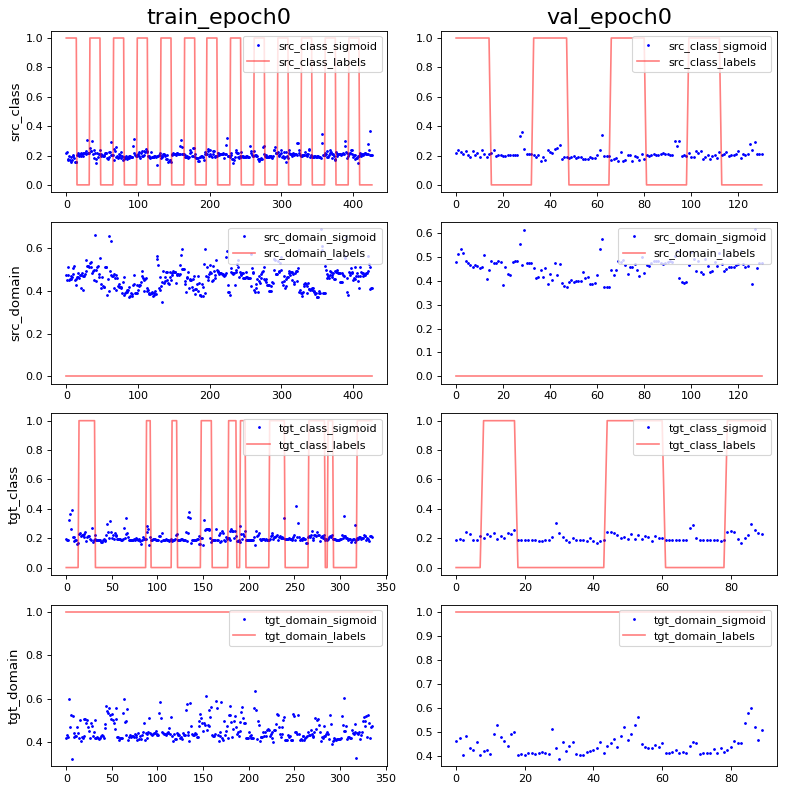

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: -6.249504e-10 0.9965218
PCA var: [18.7      29.       36.2      40.600002 43.9      46.9      49.300003
 51.700005 53.800003 55.800003]
show standardize mean and std: 0.0 0.9965218
PCA var: [20.       32.2      39.9      44.800003 48.600002 51.9      55.100002
 58.100002 61.000004 63.400005]


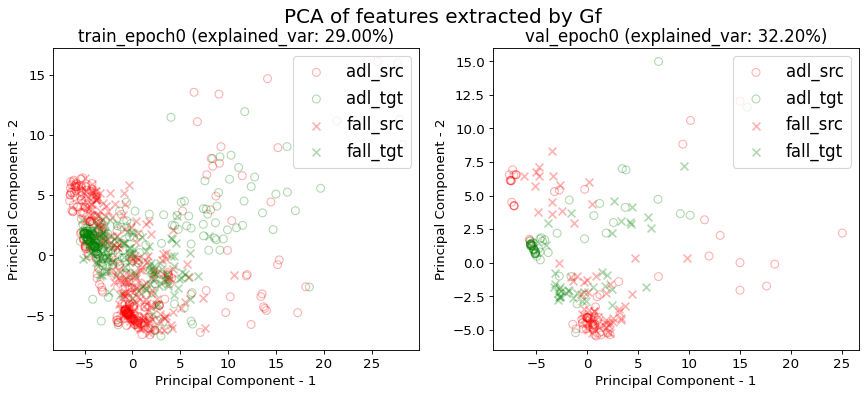

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/


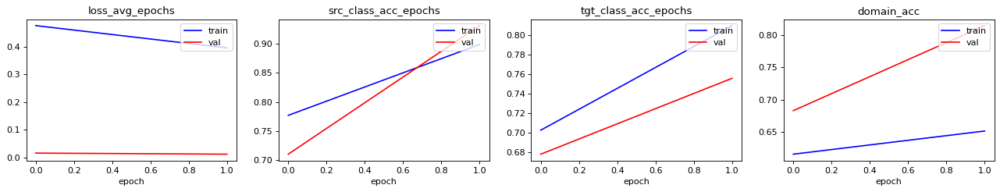

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.9110070257611241 0.7283372365339579 0.667447306791569 0.7400468384074942
acc performance: 0.9312977099236641 0.7480916030534351 0.5190839694656488 0.6259541984732825


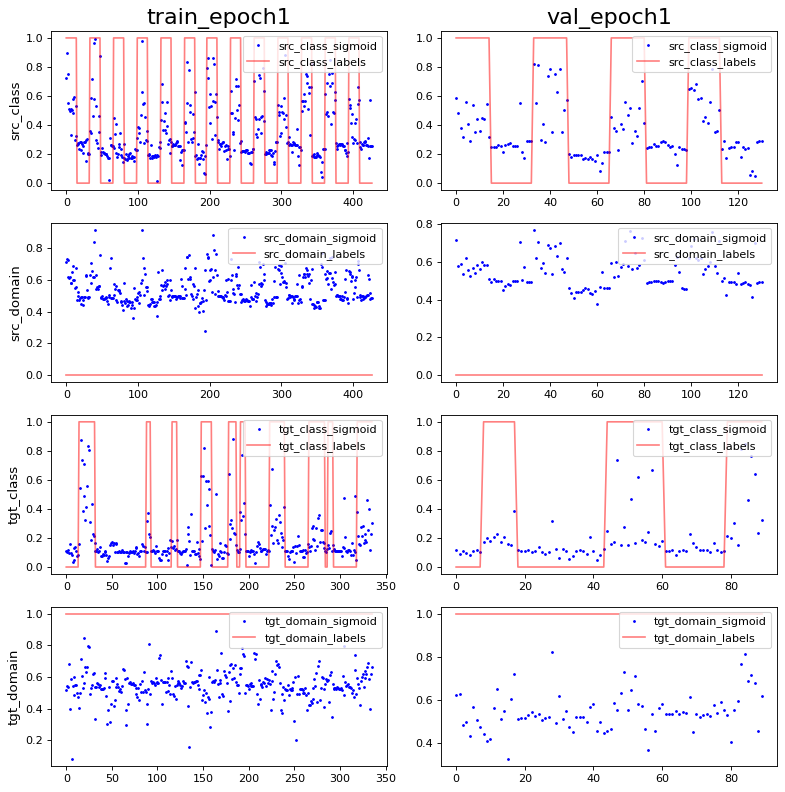

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: -2.4442505e-08 0.9965217
PCA var: [40.5      52.5      58.1      62.       64.6      66.799995 68.7
 70.399994 71.99999  73.49999 ]
show standardize mean and std: -3.8357943e-09 0.9965218
PCA var: [41.       55.5      61.6      66.       68.9      71.5      73.7
 75.6      77.299995 78.899994]


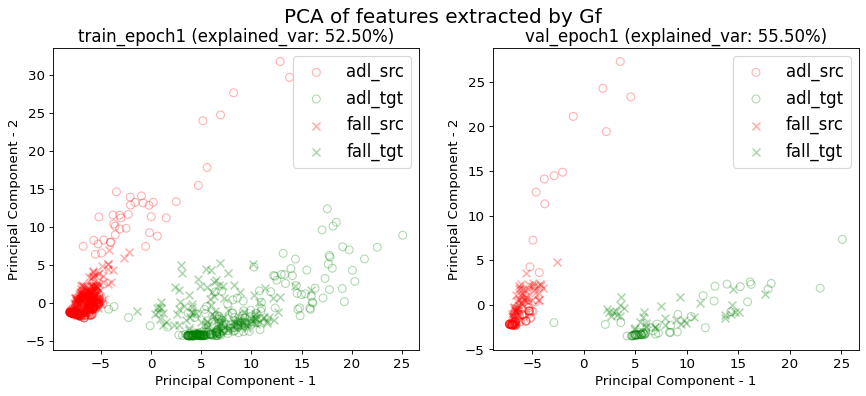

---------------Exporting model performance---------------
show df_performance


,i_CV,train_src_class_loss,train_tgt_class_loss,train_src_domain_loss,train_tgt_domain_loss,train_src_class_acc,train_tgt_class_acc,train_domain_acc,val_src_class_loss,val_tgt_class_loss,val_src_domain_loss,val_tgt_domain_loss,val_src_class_acc,val_tgt_class_acc,val_domain_acc
0,0.000000,0.079514,0.128440,0.148054,0.141720,0.927632,0.756579,0.705592,0.003274,0.002707,0.005575,0.005236,0.856061,0.926230,0.543307
1,1.000000,0.079982,0.107525,0.158406,0.156569,0.898810,0.809524,0.651786,0.002489,0.005061,0.004681,0.004949,0.931298,0.755556,0.814480
mean,0.500000,0.079748,0.117982,0.153230,0.149144,0.913221,0.783051,0.678689,0.002881,0.003884,0.005128,0.005093,0.893679,0.840893,0.678893
std,0.707107,0.000331,0.014789,0.007320,0.010500,0.020380,0.037438,0.038047,0.000555,0.001664,0.000632,0.000202,0.053201,0.120685,0.191748


val_src_class_acc: 0.8937±0.0532
val_tgt_class_acc: 0.8409±0.1207
val_domain_acc: 0.6789±0.1917
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'src_dataset_name': 'UPFall', 'tgt_dataset_name': 'UMAFall', 'src_sensor_loc': 'wrist', 'tgt_sensor_loc': 'ankle', 'date': '2020/04/09 20:15:00', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.001, 'input_dim': (4, 3, 66), 'output_dim': 2, 'label_dim': (4,)}
val_tgt_class_acc: 0.8409±0.1207
val_domain_acc: 0.6789±0.1917
time elapsed: 00:00:44

======================  train on source, val on target(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
FeatureExtractor_

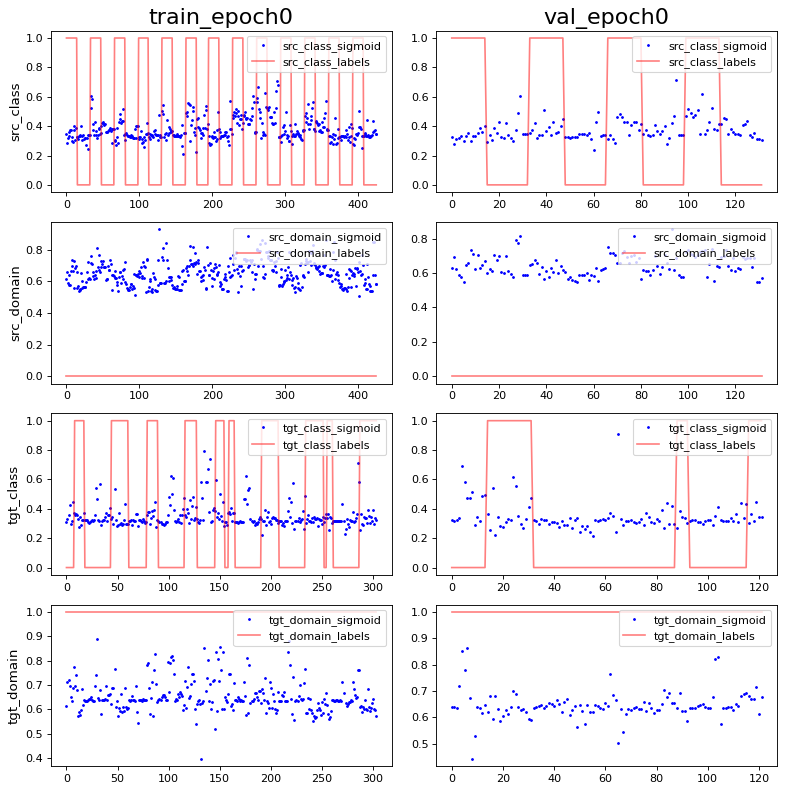

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: -1.4515591e-09 0.9965218
PCA var: [26.800001 35.1      42.899998 49.1      53.3      57.399998 60.399998
 62.999996 65.2      67.2     ]
show standardize mean and std: -5.840525e-09 0.99303126
PCA var: [26.1      37.4      46.100002 52.500004 56.700005 60.500004 63.500004
 66.3      68.600006 70.600006]


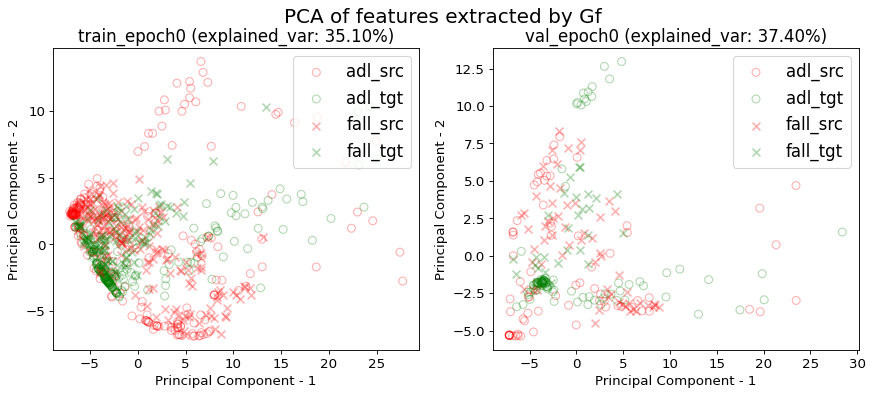

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/


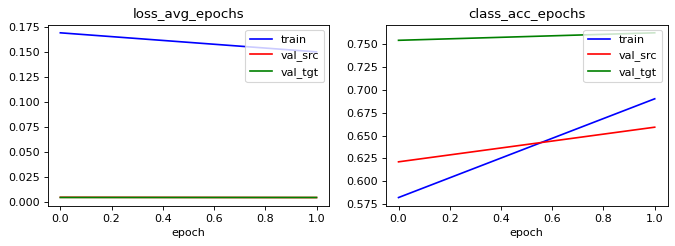

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.7276995305164319 0.755868544600939 0.41784037558685444 0.5821596244131455
acc performance: 0.6590909090909091 0.7045454545454546 0.7045454545454546 0.803030303030303


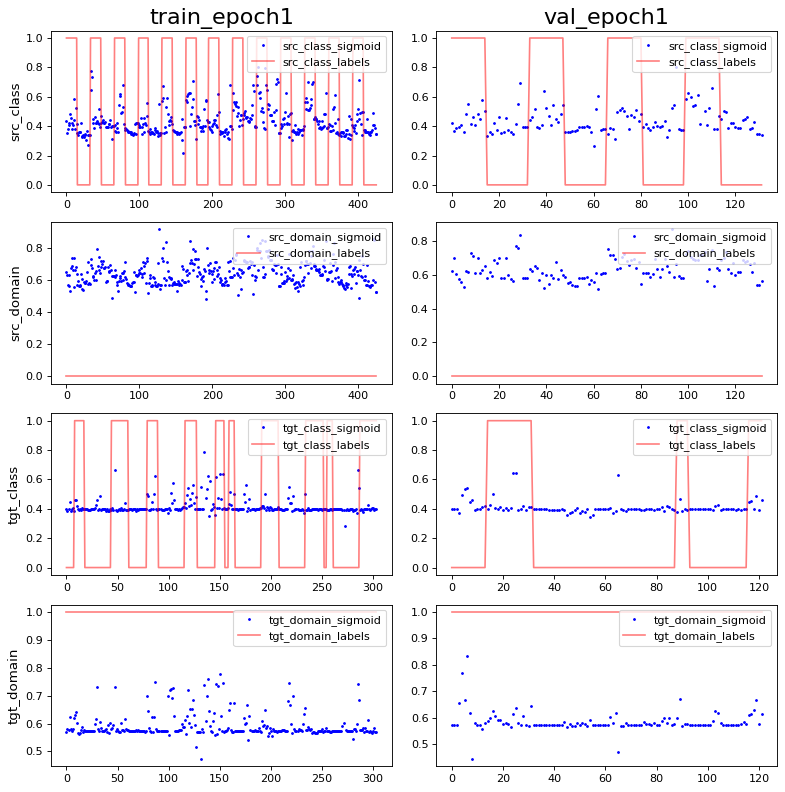

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: 4.6449893e-09 1.0
PCA var: [30.599998 47.6      55.699997 60.499996 64.299995 66.99999  69.19999
 71.09999  72.899994 74.49999 ]
show standardize mean and std: 0.0 1.0
PCA var: [34.9      47.2      54.5      59.8      63.8      67.       69.8
 72.3      74.600006 76.600006]


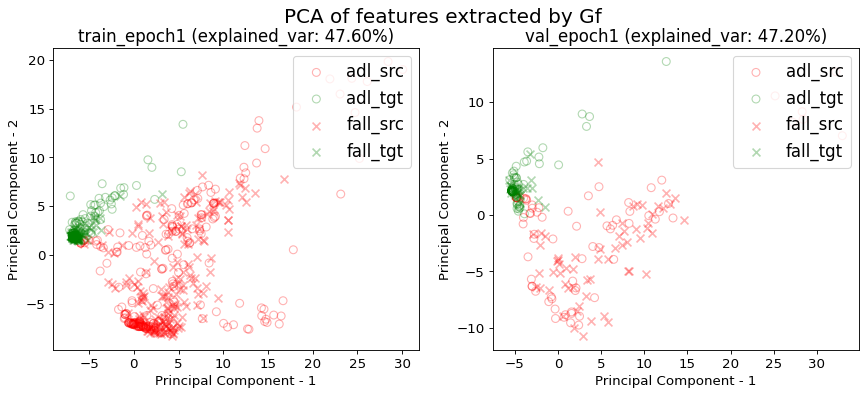

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.5433255269320844 0.00702576112412178 0.5175644028103045 0.765807962529274
acc performance: 0.549618320610687 0.015267175572519083 0.3969465648854962 0.6870229007633588


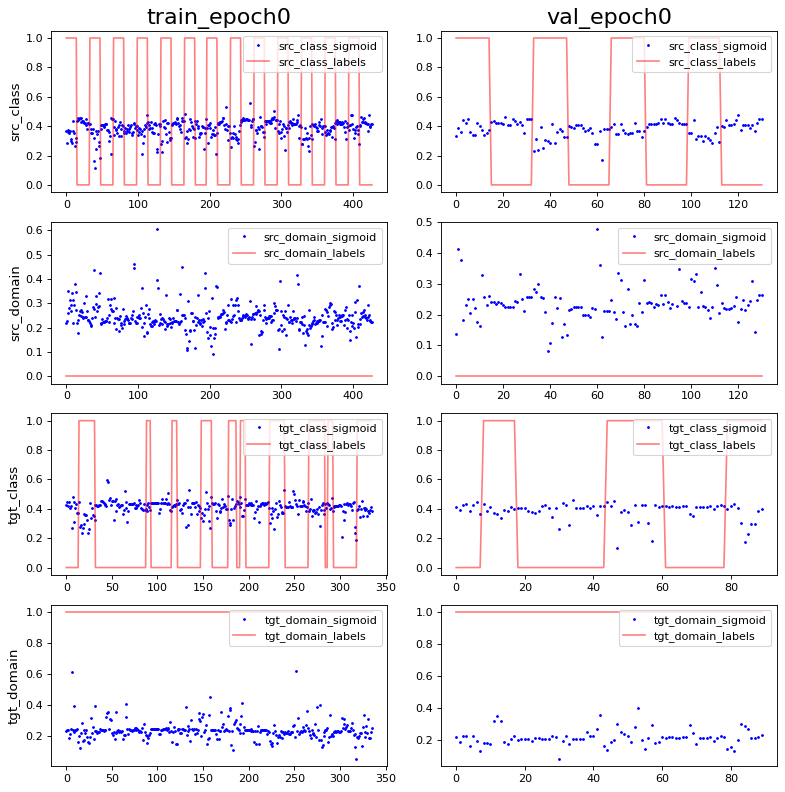

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: -4.1663362e-10 0.99303126
PCA var: [21.3      34.       39.9      44.2      48.2      51.3      54.3
 56.899998 59.399998 61.399998]
show standardize mean and std: 9.589486e-10 0.9895285
PCA var: [20.7      34.       42.6      47.699997 52.299995 55.899994 58.899994
 61.699993 64.2      66.5     ]


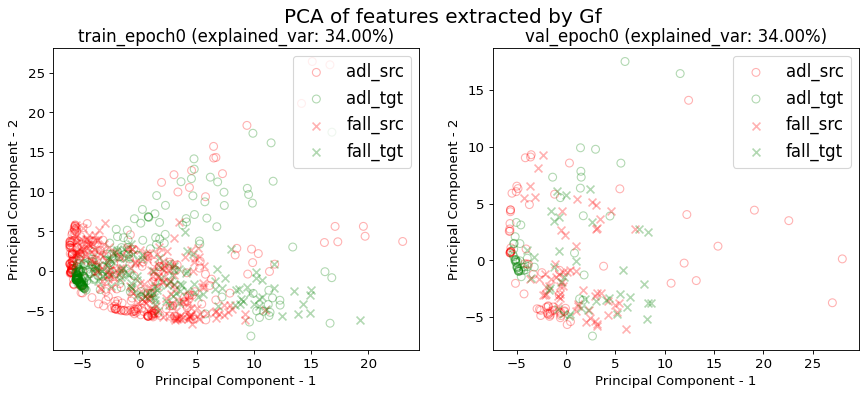

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/


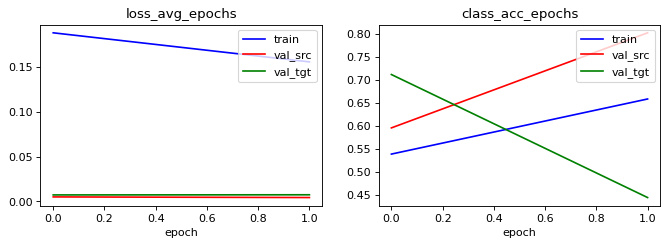

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.7892271662763466 0.01873536299765808 0.2857142857142857 0.7822014051522248
acc performance: 0.8015267175572519 0.030534351145038167 0.3053435114503817 0.6870229007633588


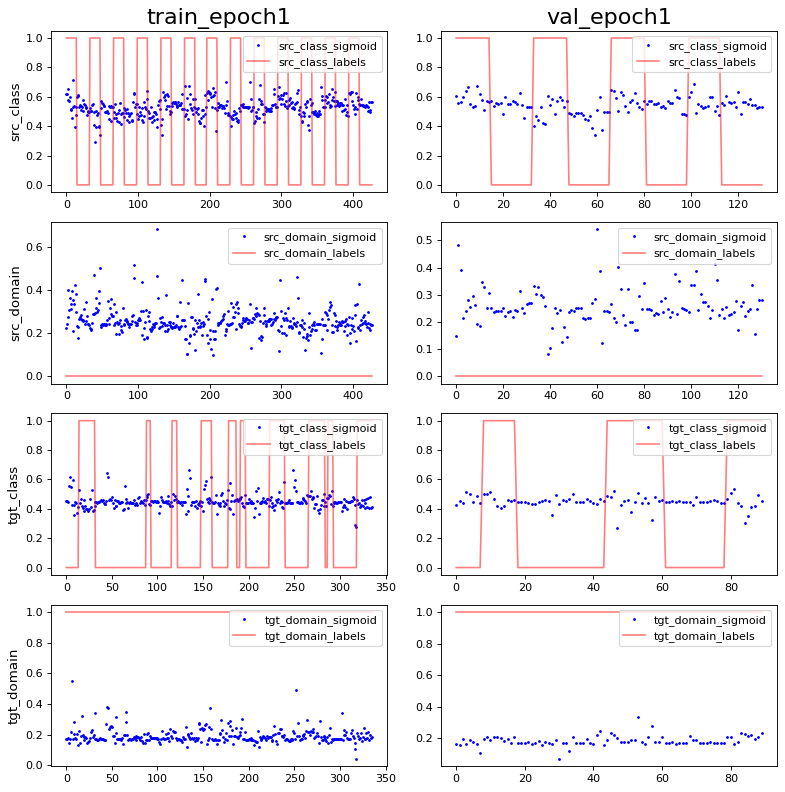

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: 2.3609237e-09 0.98952854
PCA var: [27.7      44.800003 50.500004 55.600002 59.000004 61.900005 64.40001
 66.600006 68.600006 70.50001 ]
show standardize mean and std: 2.3973714e-09 0.9895285
PCA var: [33.199997 49.999996 55.699997 60.799995 64.7      67.799995 70.399994
 72.7      74.7      76.6     ]


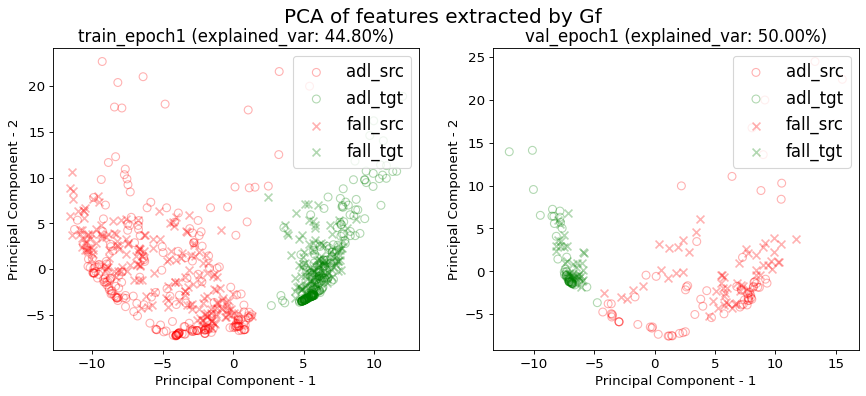

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.149846,0.690141,0.004730,0.659091,0.004775,0.762295
1,1.000000,0.156034,0.658080,0.004397,0.801527,0.007495,0.444444
mean,0.500000,0.152940,0.674110,0.004564,0.730309,0.006135,0.603370
std,0.707107,0.004376,0.022671,0.000235,0.100717,0.001924,0.224754


src val loss: 0.0046±0.0002
src val acc: 0.7303±0.1007
tgt val loss: 0.0061±0.0019
tgt val acc: 0.6034±0.2248
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UPFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.0001, 'sensor_loc': 'wrist', 'date': '2020/04/09 20:15:15', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  train on target, val on target(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modelou

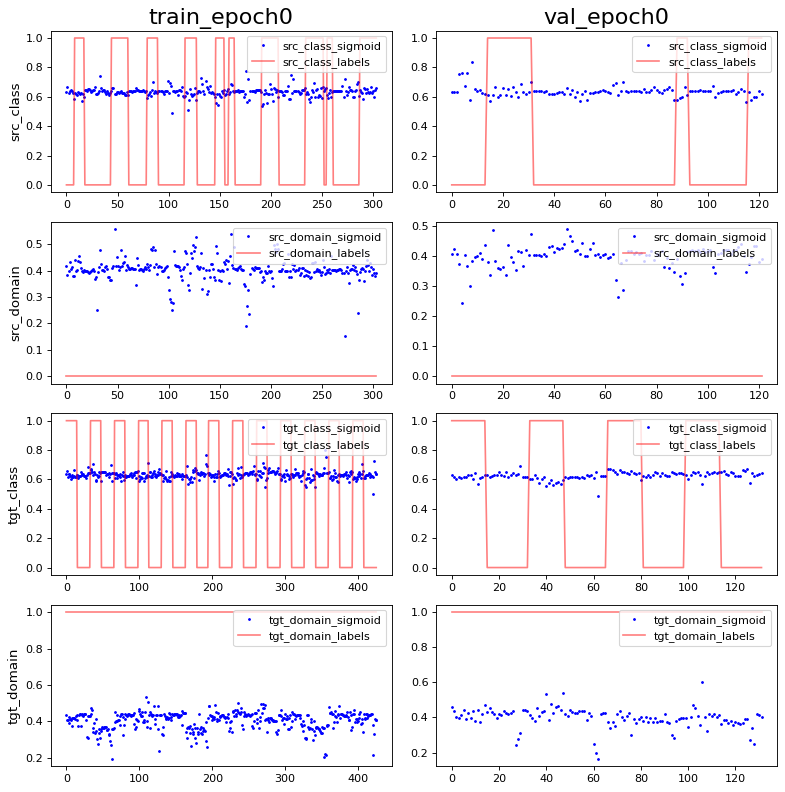

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 1.7418709e-09 0.9965218
PCA var: [18.199999 30.199999 38.5      43.2      47.5      51.       54.1
 57.       59.5      61.9     ]
show standardize mean and std: 1.042951e-09 0.9965218
PCA var: [23.5      36.5      44.6      49.399998 53.3      56.5      59.7
 62.600002 65.200005 67.700005]


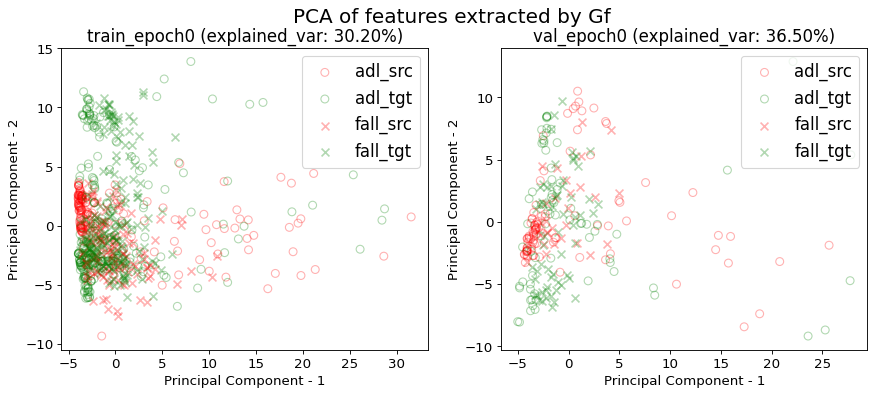

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/


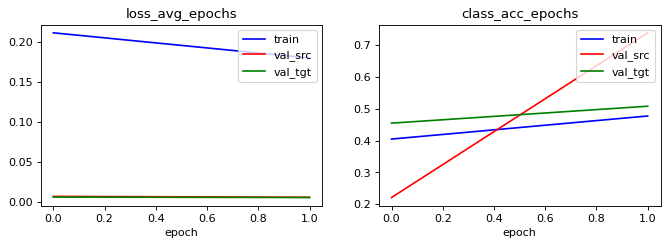

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.6447368421052632 0.5361842105263158 0.6217105263157895 0.7598684210526315
acc performance: 0.7377049180327869 0.5409836065573771 0.5491803278688525 0.5573770491803278


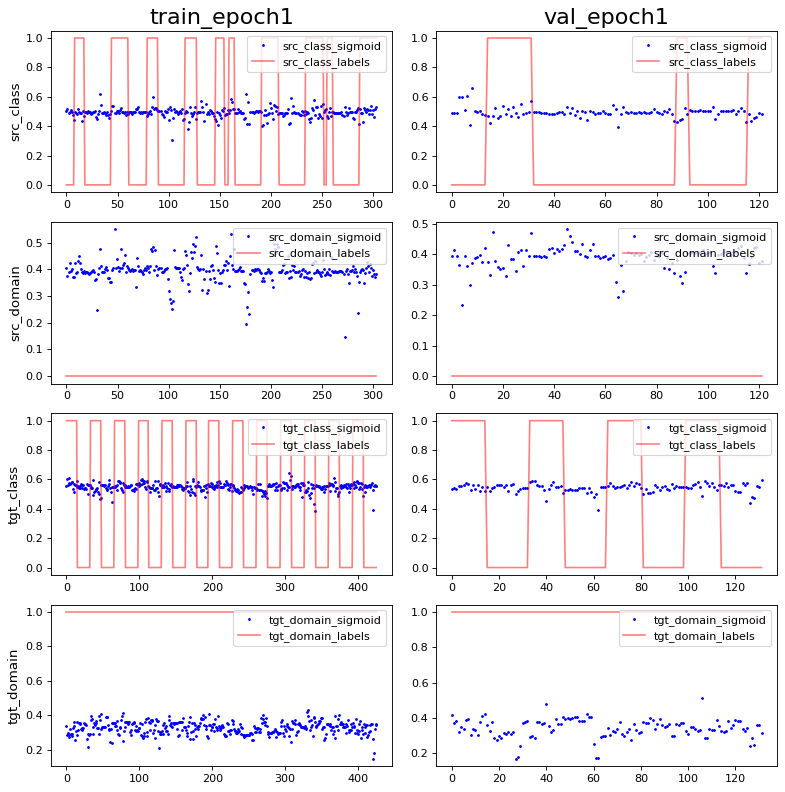

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 2.9031182e-09 0.9965218
PCA var: [43.  54.4 59.  62.4 65.4 67.9 70.  71.9 73.6 75.2]
show standardize mean and std: -6.2577055e-10 0.9965218
PCA var: [38.4      51.300003 57.600002 62.2      65.2      67.6      69.9
 72.       74.       75.7     ]


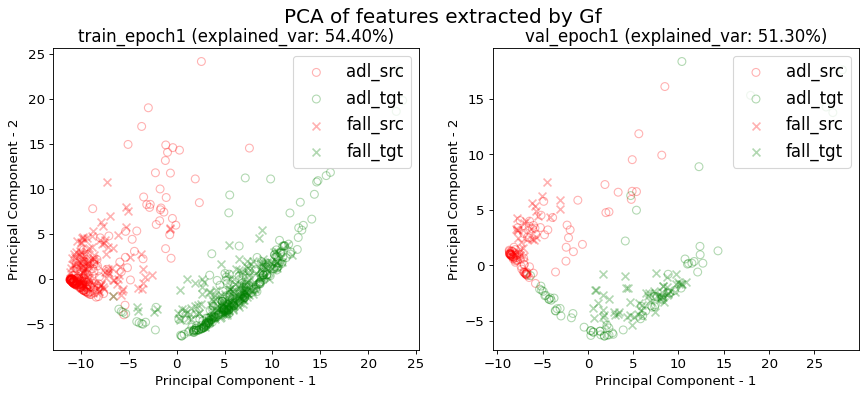

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.6458333333333334 0.011904761904761904 0.7797619047619048 1.2648809523809523
acc performance: 0.6777777777777778 0.0 0.8333333333333334 1.4444444444444444


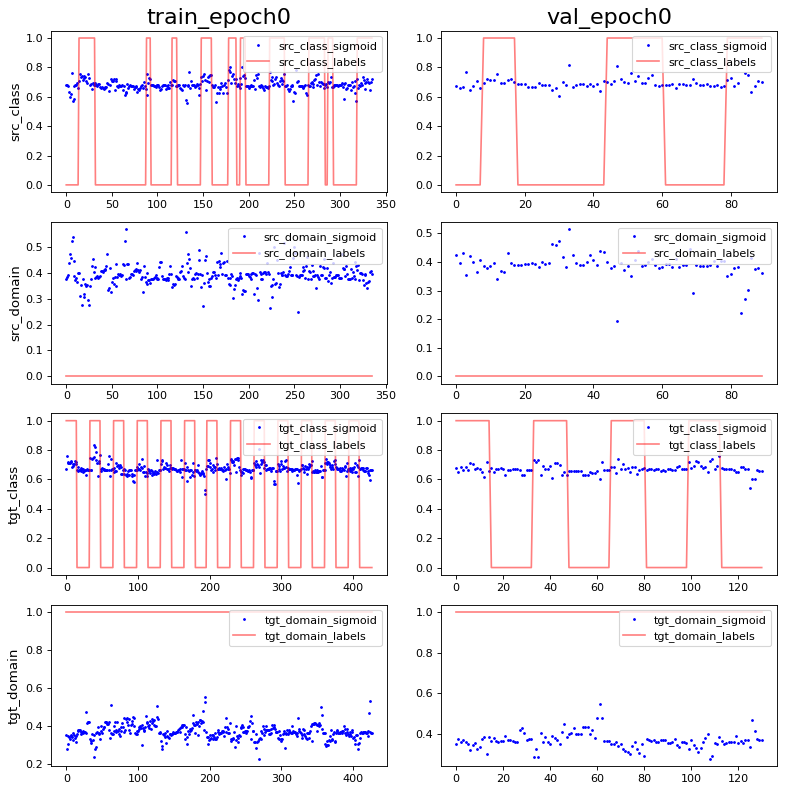

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 2.7775574e-10 1.0
PCA var: [24.6      32.8      38.4      42.800003 47.000004 49.900005 52.300007
 54.600006 56.600006 58.500008]
show standardize mean and std: -2.8768457e-09 0.98952854
PCA var: [30.300001 38.       43.8      48.3      52.6      56.       59.
 61.8      64.3      66.5     ]


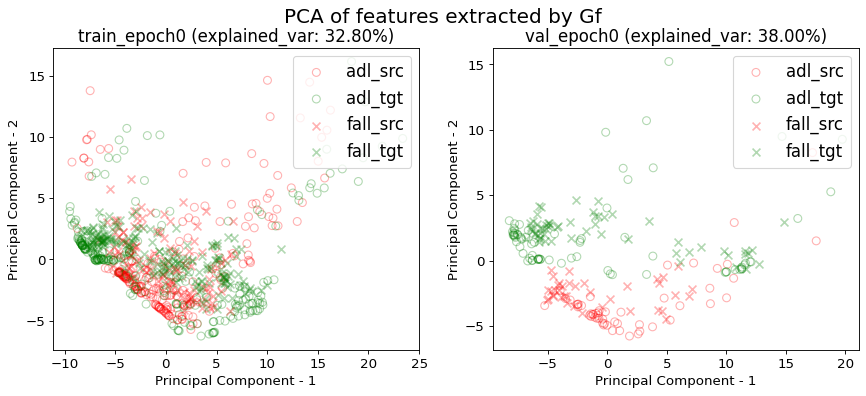

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/


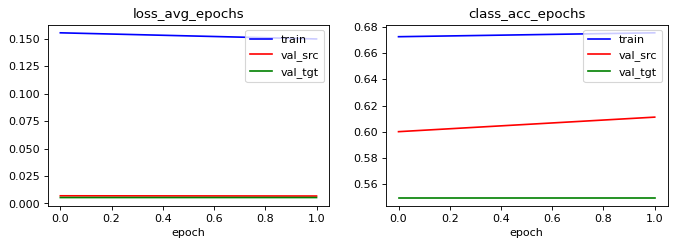

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.6815476190476191 0.011904761904761904 0.6994047619047619 1.2708333333333333
acc performance: 0.6111111111111112 0.0 0.8 1.4555555555555555


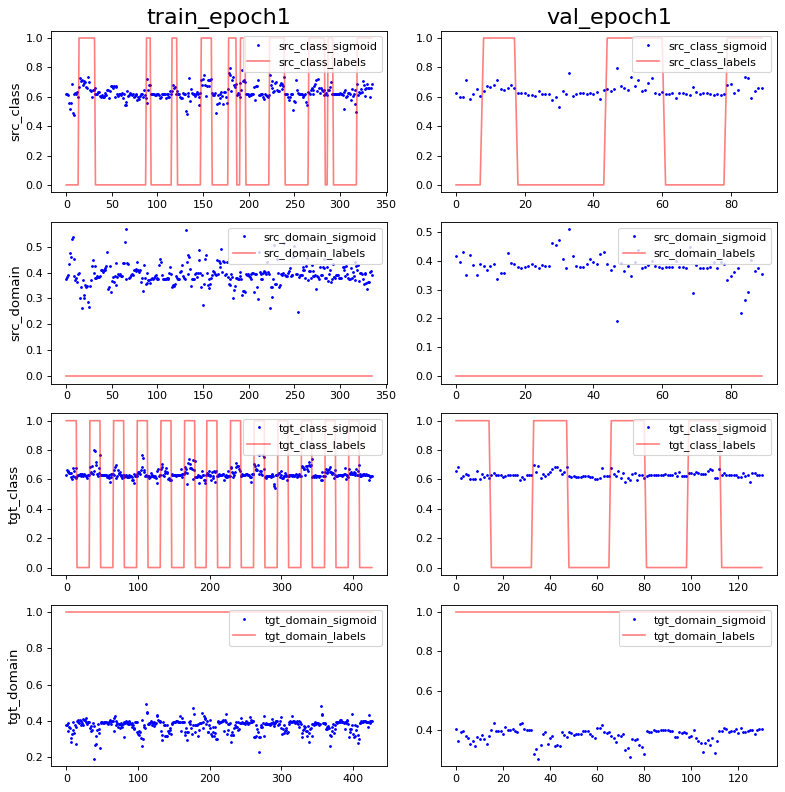

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 8.3326723e-10 0.98952854
PCA var: [17.5      34.199997 39.899998 43.899998 47.3      50.1      52.3
 54.399998 56.399998 58.3     ]
show standardize mean and std: 3.8357943e-09 0.98952854
PCA var: [20.1      35.9      42.4      47.4      51.9      55.800003 59.100002
 61.9      64.200005 66.50001 ]


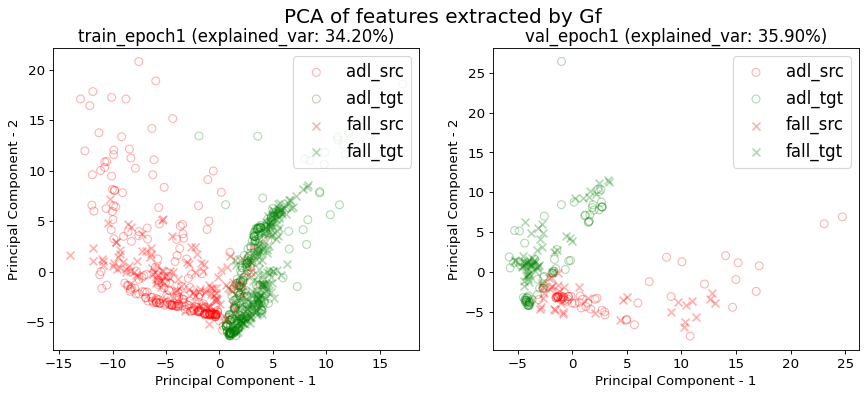

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.179402,0.476974,0.005583,0.737705,0.005195,0.507576
1,1.000000,0.149851,0.675595,0.006745,0.611111,0.005361,0.549618
mean,0.500000,0.164626,0.576284,0.006164,0.674408,0.005278,0.528597
std,0.707107,0.020895,0.140447,0.000821,0.089515,0.000118,0.029729


src val loss: 0.0062±0.0008
src val acc: 0.6744±0.0895
tgt val loss: 0.0053±0.0001
tgt val acc: 0.5286±0.0297
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 426, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UMAFall', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.0001, 'sensor_loc': 'ankle', 'date': '2020/04/09 20:15:28', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  DANN training transferring knowledge(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_

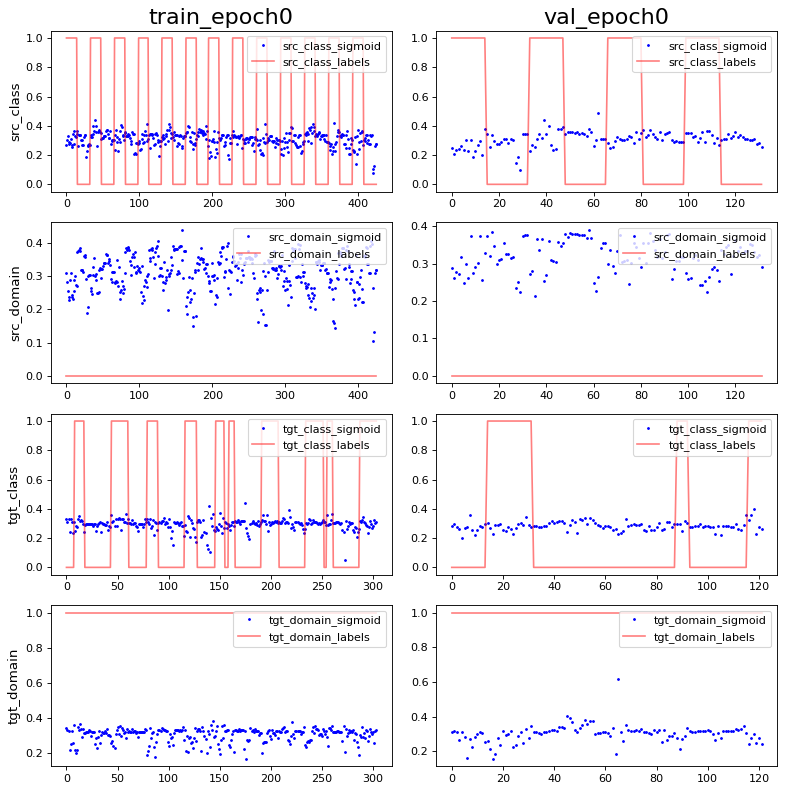

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: -5.8062366e-10 0.9965218
PCA var: [16.4      29.3      35.899998 41.399998 45.399998 48.8      51.7
 54.5      56.9      59.2     ]
show standardize mean and std: -3.337443e-09 0.9965218
PCA var: [18.4      31.3      40.9      47.2      52.100002 56.300003 59.9
 62.9      65.3      67.4     ]


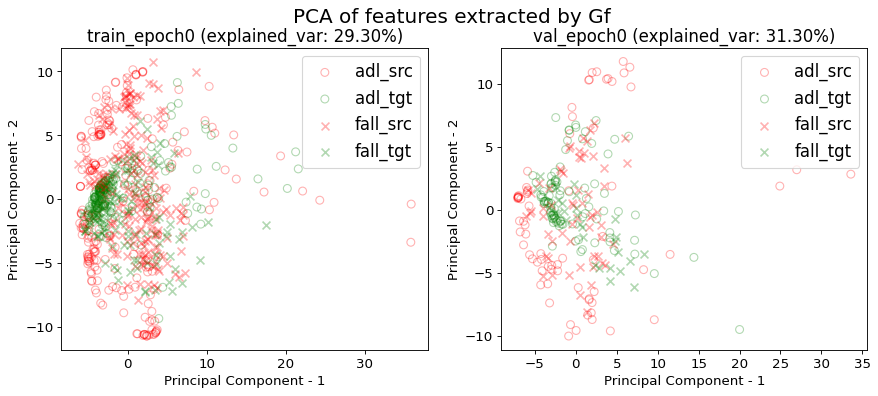

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/


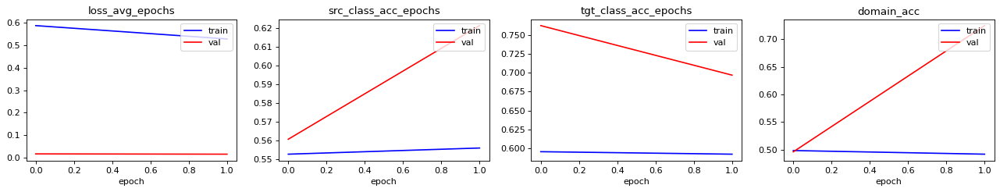

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.6572769953051644 0.6525821596244131 0.4131455399061033 0.6807511737089202
acc performance: 0.6212121212121212 0.5303030303030303 0.6439393939393939 0.8636363636363636


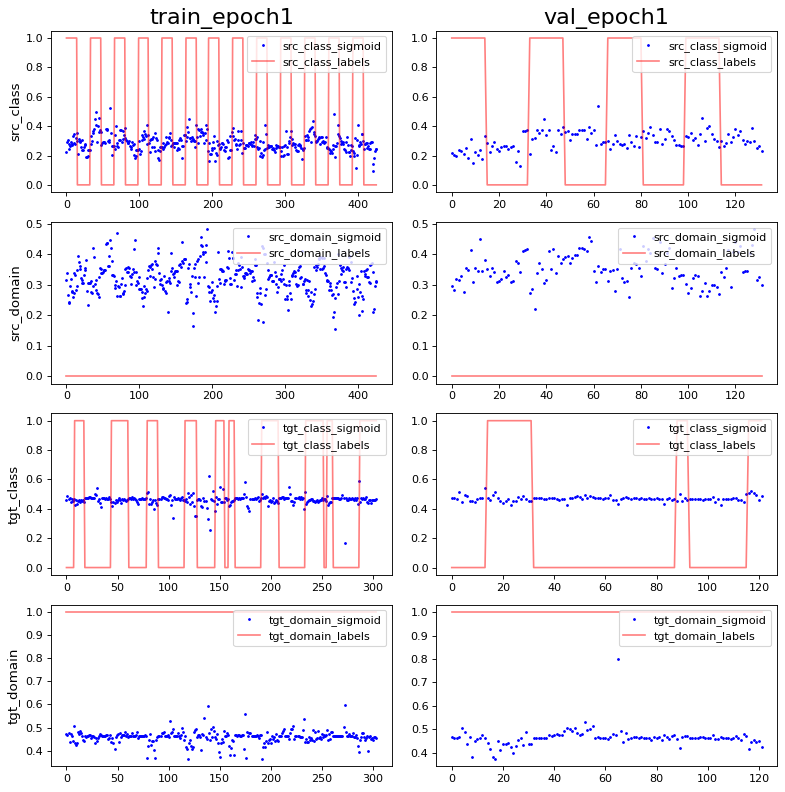

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 4.6449893e-09 0.9965217
PCA var: [44.800003 54.100002 58.9      62.5      65.1      67.4      69.4
 71.1      72.7      74.1     ]
show standardize mean and std: 0.0 0.99303126
PCA var: [41.7      53.2      62.       65.7      69.299995 71.99999  74.49999
 76.49999  78.399994 79.99999 ]


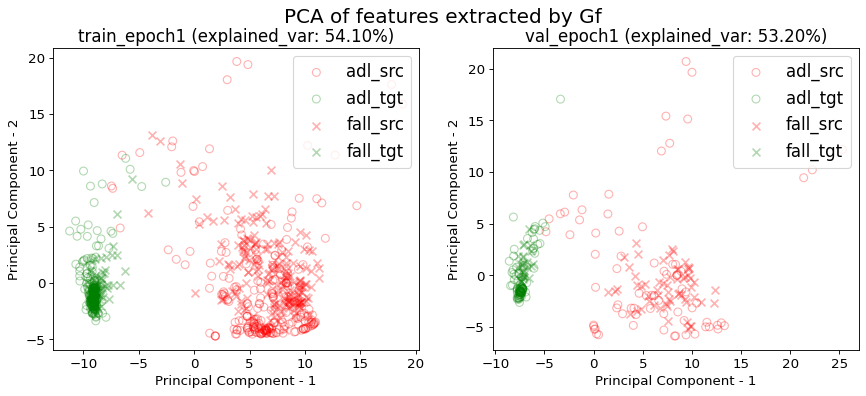

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 168
DannModel_total_params: 748
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.4566744730679157 1.0 0.26697892271662765 0.0
acc performance: 0.45038167938931295 1.0 0.2900763358778626 0.0


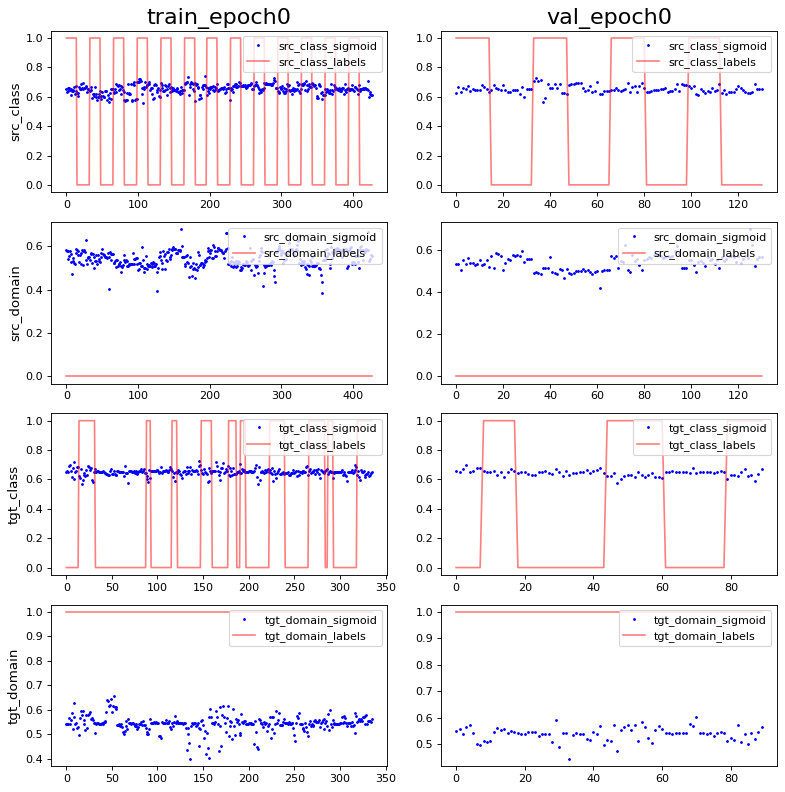

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 8.3326723e-10 0.9965218
PCA var: [25.9      39.       45.5      50.2      53.5      56.1      58.399998
 60.3      62.       63.6     ]
show standardize mean and std: -1.9178972e-09 0.9965218
PCA var: [30.199999 43.6      50.699997 55.999996 59.799995 63.499996 66.399994
 68.99999  71.09999  72.99999 ]


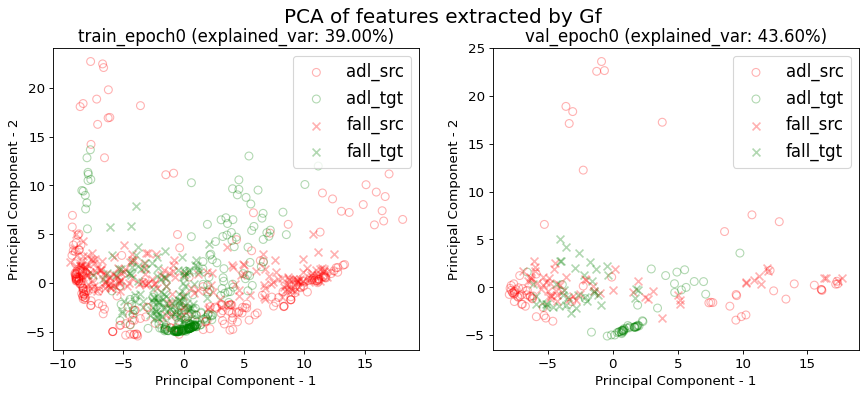

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/


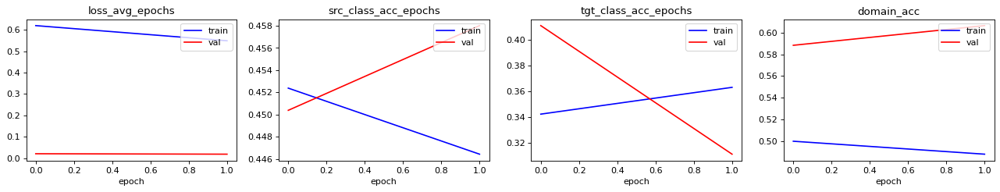

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 168
DannModel_total_params: 748
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.4613583138173302 0.9391100702576113 0.28337236533957844 0.06088992974238876
acc performance: 0.4580152671755725 0.9541984732824428 0.21374045801526717 0.06870229007633588


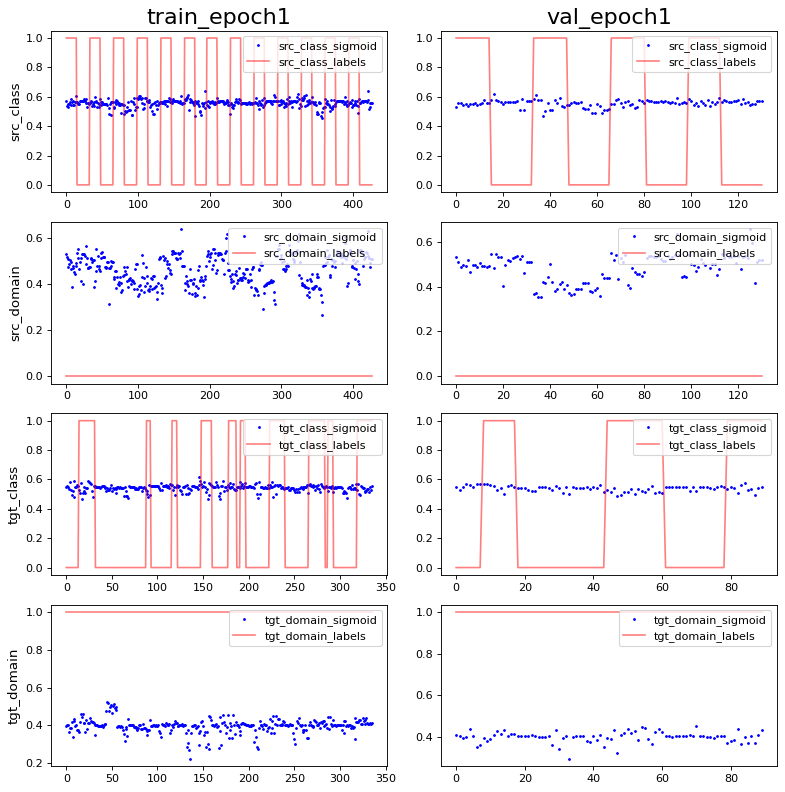

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: -3.0553131e-09 0.9965218
PCA var: [35.8      47.9      52.600002 57.000004 60.300003 63.000004 64.9
 66.700005 68.100006 69.50001 ]
show standardize mean and std: 0.0 0.9965218
PCA var: [43.1      53.699997 58.899998 62.3      65.5      68.2      70.899994
 73.2      75.1      76.799995]


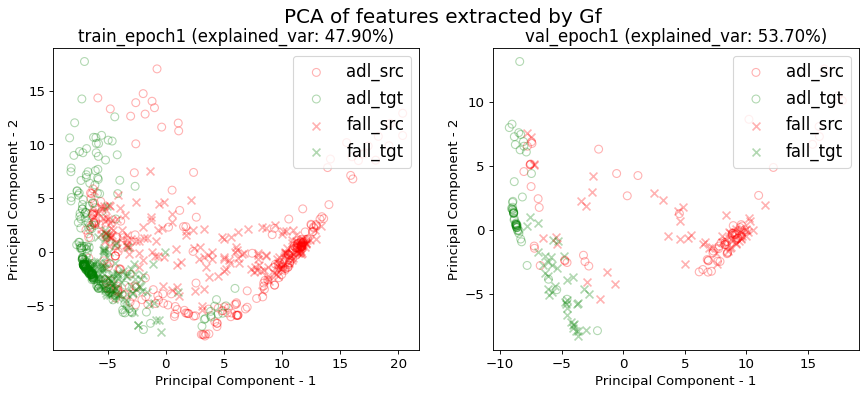

---------------Exporting model performance---------------
show df_performance


,i_CV,train_src_class_loss,train_tgt_class_loss,train_src_domain_loss,train_tgt_domain_loss,train_src_class_acc,train_tgt_class_acc,train_domain_acc,val_src_class_loss,val_tgt_class_loss,val_src_domain_loss,val_tgt_domain_loss,val_src_class_acc,val_tgt_class_acc,val_domain_acc
0,0.000000,0.171082,0.167609,0.236961,0.120054,0.555921,0.592105,0.491776,0.005176,0.005503,0.005121,0.004550,0.621212,0.696721,0.724409
1,1.000000,0.181942,0.191029,0.136093,0.230586,0.446429,0.363095,0.488095,0.005736,0.008217,0.004330,0.008494,0.458015,0.311111,0.606335
mean,0.500000,0.176512,0.179319,0.186527,0.175320,0.501175,0.477600,0.489936,0.005456,0.006860,0.004725,0.006522,0.539614,0.503916,0.665372
std,0.707107,0.007679,0.016561,0.071324,0.078157,0.077423,0.161935,0.002603,0.000396,0.001919,0.000559,0.002789,0.115398,0.272668,0.083491


val_src_class_acc: 0.5396±0.1154
val_tgt_class_acc: 0.5039±0.2727
val_domain_acc: 0.6654±0.0835
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'src_dataset_name': 'UPFall', 'tgt_dataset_name': 'UMAFall', 'src_sensor_loc': 'wrist', 'tgt_sensor_loc': 'ankle', 'date': '2020/04/09 20:15:44', 'num_epochs': 2, 'channel_n': 4, 'batch_size': 4, 'learning_rate': 0.0001, 'input_dim': (4, 3, 66), 'output_dim': 2, 'label_dim': (4,)}
val_tgt_class_acc: 0.5039±0.2727
val_domain_acc: 0.6654±0.0835
time elapsed: 00:00:44

======================  train on source, val on target(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
FeatureExtractor

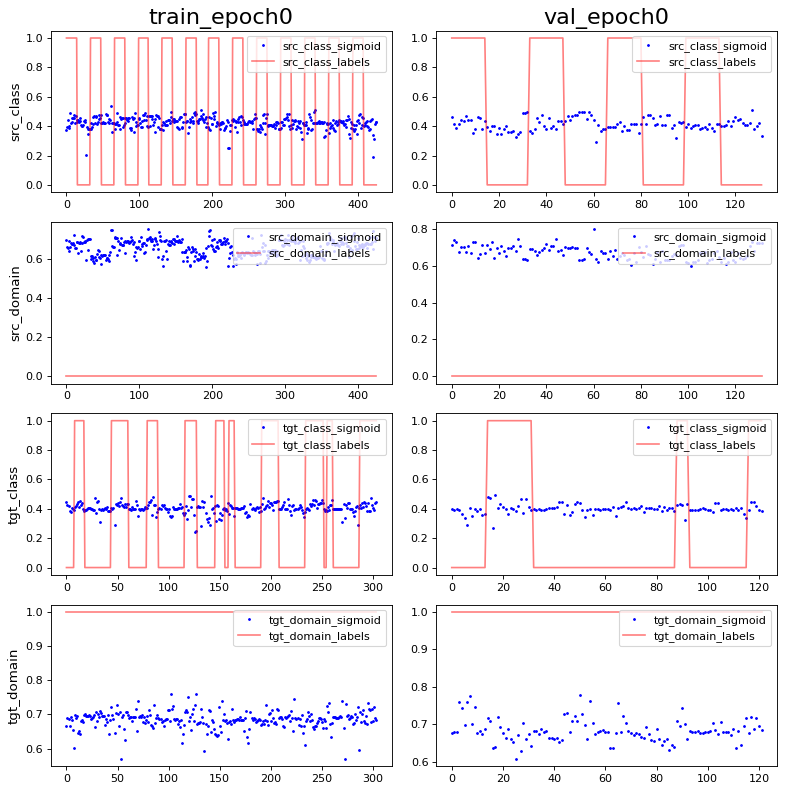

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: 2.9031183e-10 0.9952142
PCA var: [15.2      26.7      33.4      38.600002 42.4      45.300003 47.4
 49.4      51.2      53.      ]
show standardize mean and std: 1.2515411e-09 0.99303126
PCA var: [17.2      27.8      35.6      41.3      45.6      49.199997 52.1
 54.699997 57.1      59.399998]


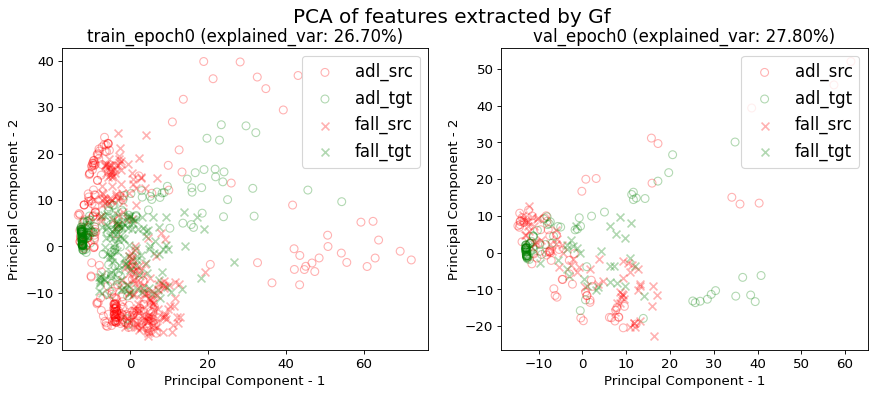

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/


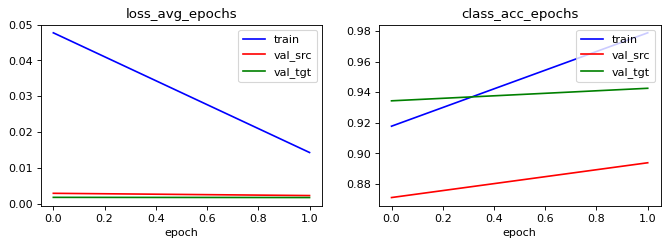

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.9953051643192489 0.9906103286384976 0.6244131455399061 0.0
acc performance: 0.8939393939393939 0.9848484848484849 0.8712121212121212 0.0


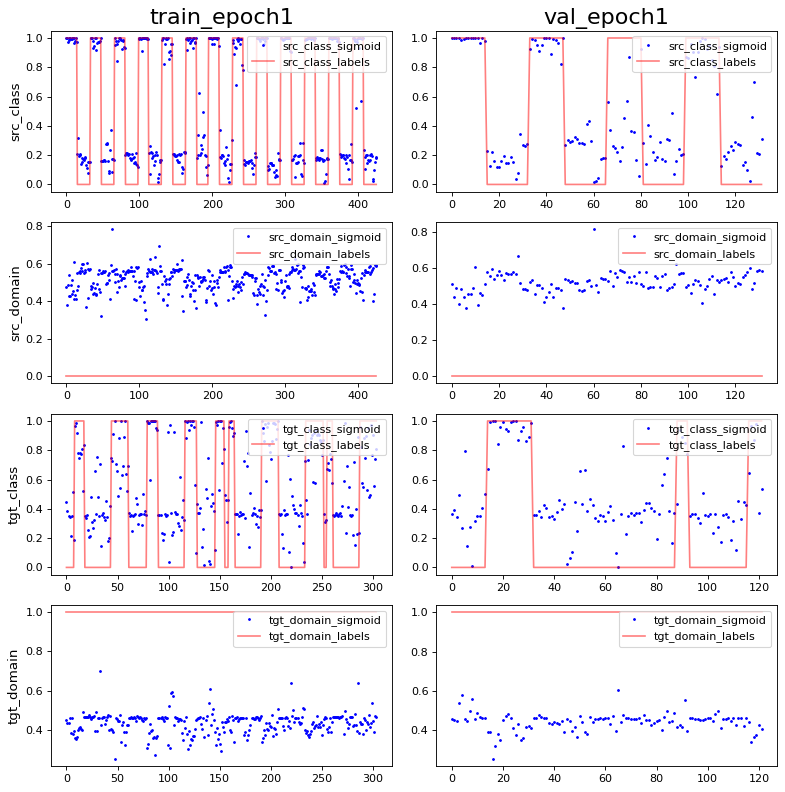

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: 8.491621e-09 0.99782735
PCA var: [37.8 51.3 57.  59.6 62.  64.1 65.9 67.5 68.9 70.1]
show standardize mean and std: -7.613542e-09 0.9952142
PCA var: [36.3      51.6      57.399998 61.6      64.6      67.       69.2
 71.2      72.899994 74.49999 ]


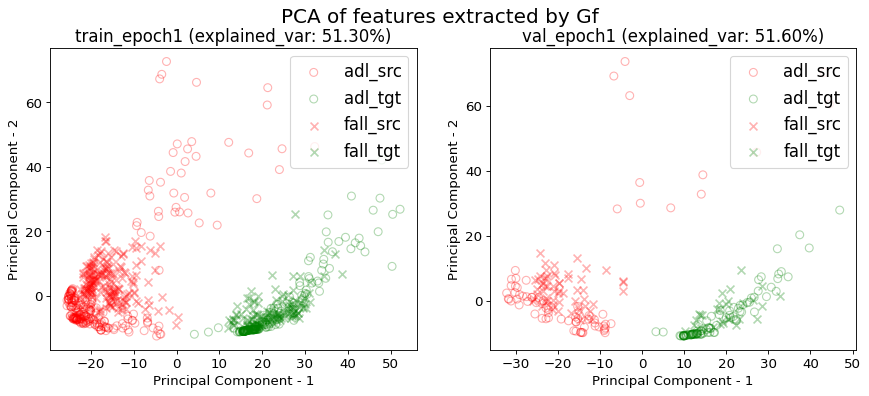

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.5409836065573771 0.07728337236533958 0.5152224824355972 0.6955503512880562
acc performance: 0.5343511450381679 0.030534351145038167 0.3969465648854962 0.6335877862595419


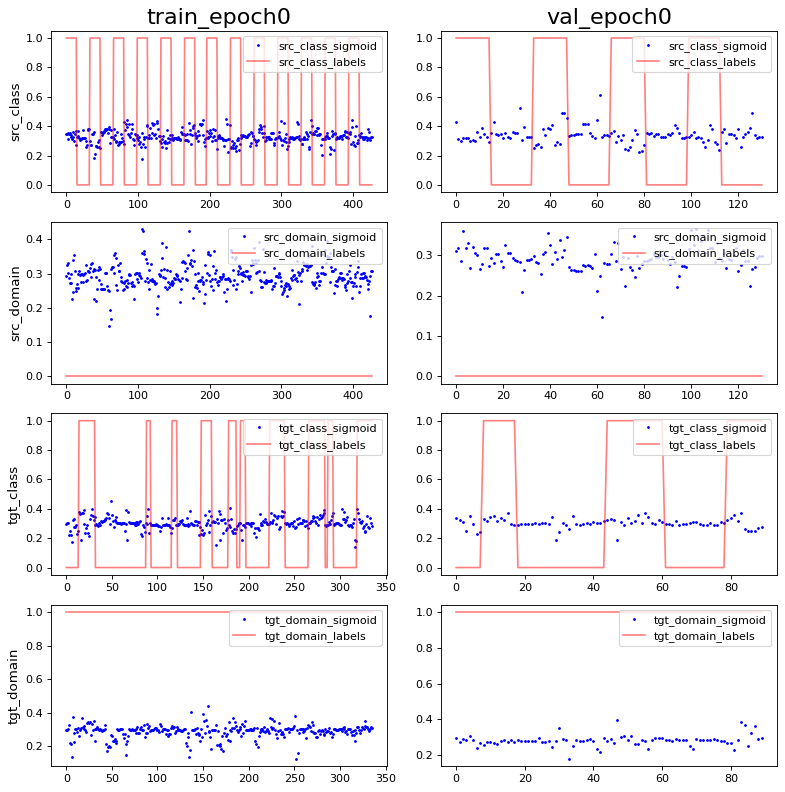

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: 1.94429e-09 0.9939051
PCA var: [16.5      26.7      32.4      37.2      40.600002 43.600002 45.9
 47.800003 49.500004 51.100002]
show standardize mean and std: -8.3907997e-10 0.9930313
PCA var: [18.5      29.9      36.5      42.2      46.600002 50.000004 53.200005
 56.000004 58.300003 60.600002]


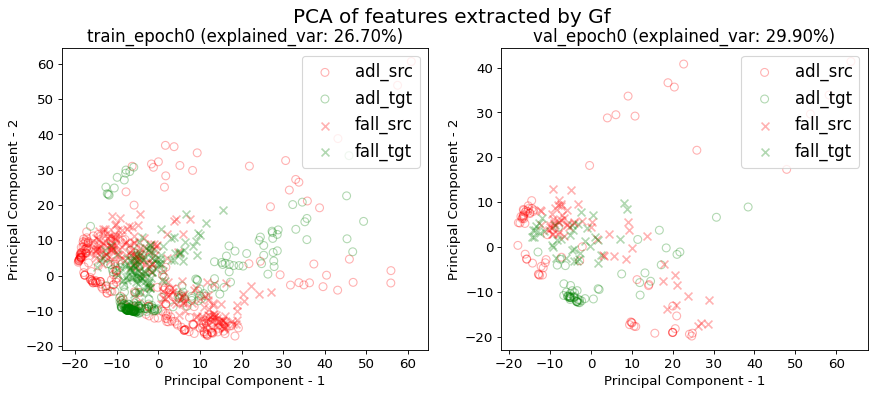

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/


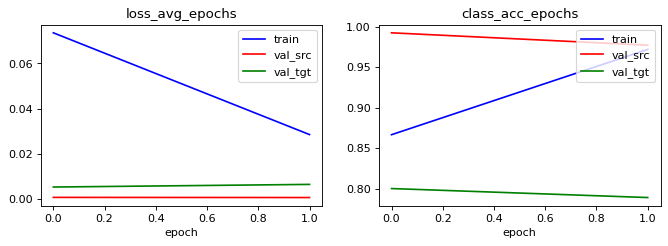

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
acc performance: 0.9391100702576113 0.9578454332552693 0.6159250585480094 0.01639344262295082
acc performance: 0.9770992366412213 0.9923664122137404 0.5419847328244275 0.0


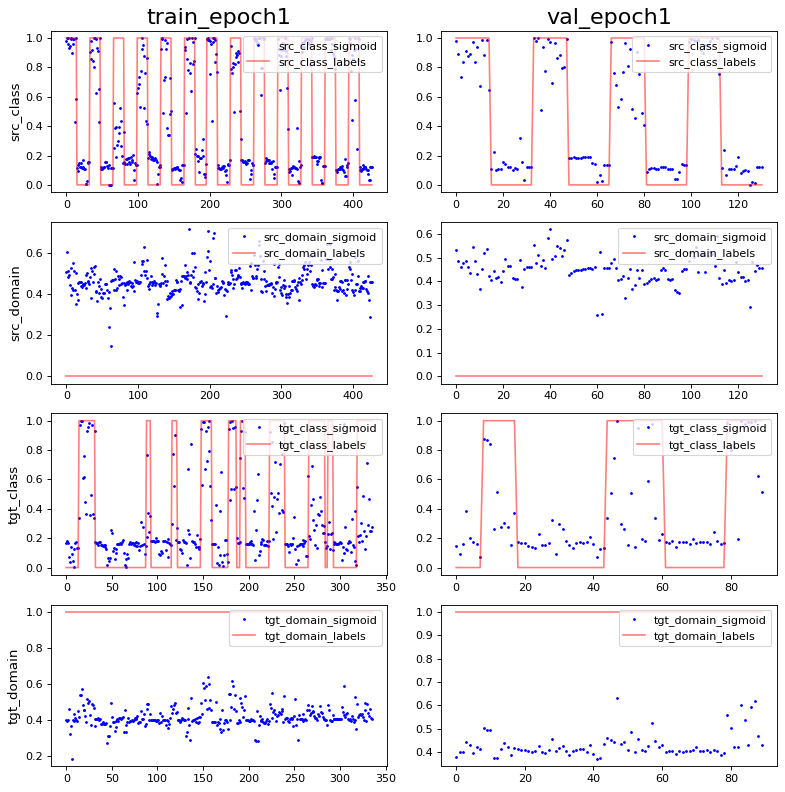

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/source/
show standardize mean and std: -1.9269304e-09 0.9982624
PCA var: [25.7      39.6      45.199997 49.999996 52.799995 54.999996 57.099995
 59.099995 60.699993 62.29999 ]
show standardize mean and std: -1.6631764e-09 0.9969571
PCA var: [26.1      44.7      50.4      55.       58.3      61.1      63.699997
 65.899994 67.899994 69.7     ]


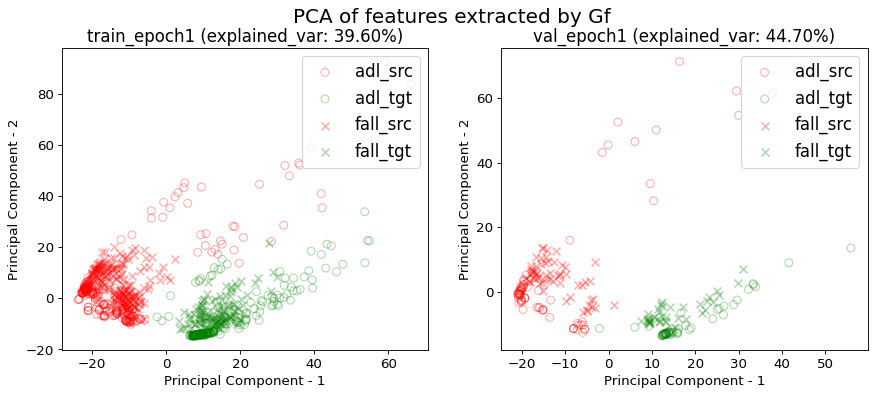

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.014278,0.978873,0.002251,0.893939,0.001696,0.942623
1,1.000000,0.028419,0.971897,0.000457,0.977099,0.006295,0.788889
mean,0.500000,0.021349,0.975385,0.001354,0.935519,0.003995,0.865756
std,0.707107,0.009999,0.004933,0.001269,0.058803,0.003251,0.108706


src val loss: 0.0014±0.0013
src val acc: 0.9355±0.0588
tgt val loss: 0.0040±0.0033
tgt val acc: 0.8658±0.1087
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UPFall', 'num_epochs': 2, 'channel_n': 32, 'batch_size': 4, 'learning_rate': 0.001, 'sensor_loc': 'wrist', 'date': '2020/04/09 20:15:58', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  train on target, val on target(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_mode

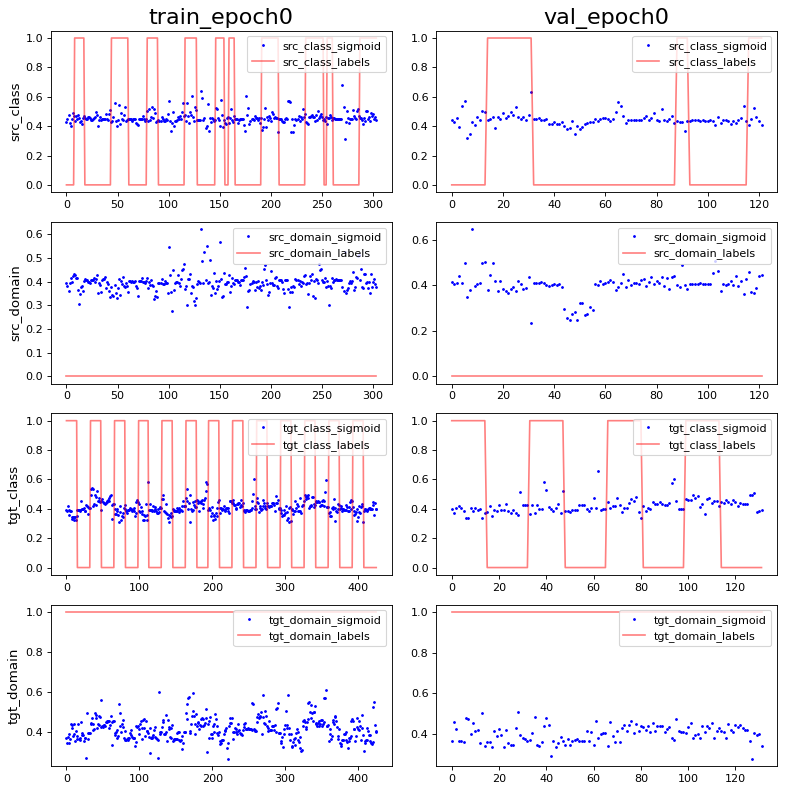

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: -2.7579623e-09 0.9965218
PCA var: [20.       29.4      36.7      42.       45.9      48.600002 51.2
 53.       54.8      56.3     ]
show standardize mean and std: 2.5030822e-09 0.9956502
PCA var: [20.6 33.4 41.4 46.2 49.8 53.1 55.8 58.  60.2 62.2]


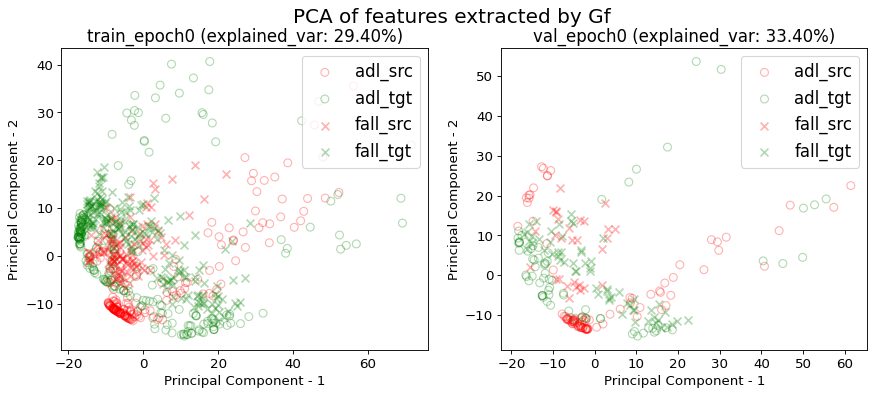

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/


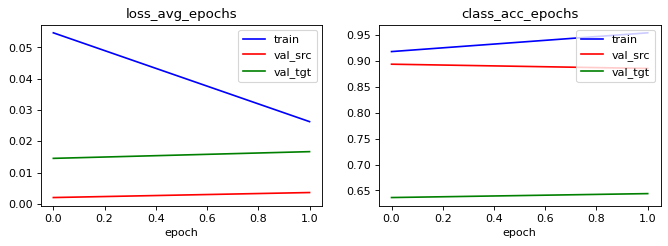

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.9671052631578947 0.805921052631579 0.9342105263157895 0.881578947368421
acc performance: 0.8852459016393442 0.7704918032786885 0.6967213114754098 0.7049180327868853


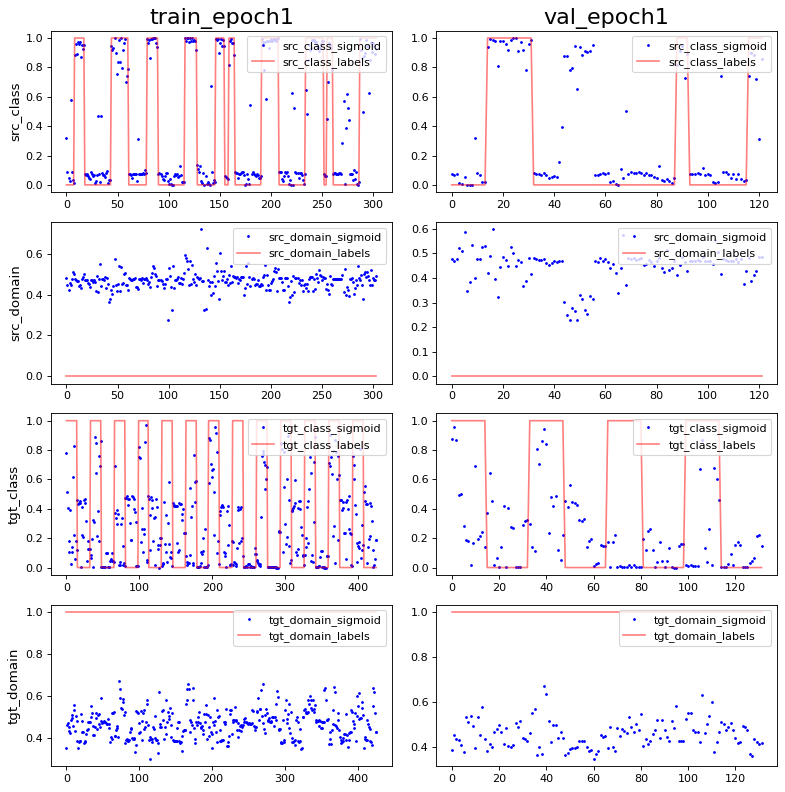

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: -1.8870268e-09 0.99434155
PCA var: [25.6      43.       52.       57.6      61.       63.7      65.7
 67.399994 68.799995 69.99999 ]
show standardize mean and std: -2.9202625e-09 0.9917191
PCA var: [27.3      44.1      55.1      59.899998 63.899998 67.1      69.799995
 71.799995 73.2      74.6     ]


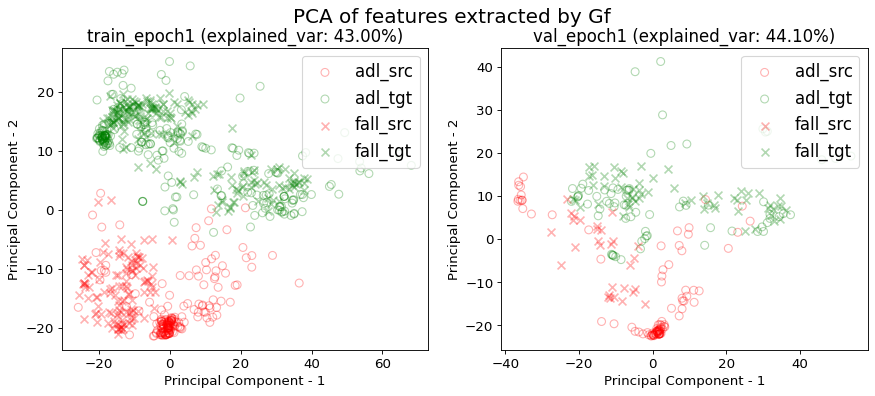

------------------------------Working on i_CV 1------------------------------
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.34226190476190477 0.002976190476190476 0.5833333333333334 1.2648809523809523
acc performance: 0.4222222222222222 0.0 0.6444444444444445 1.4555555555555555


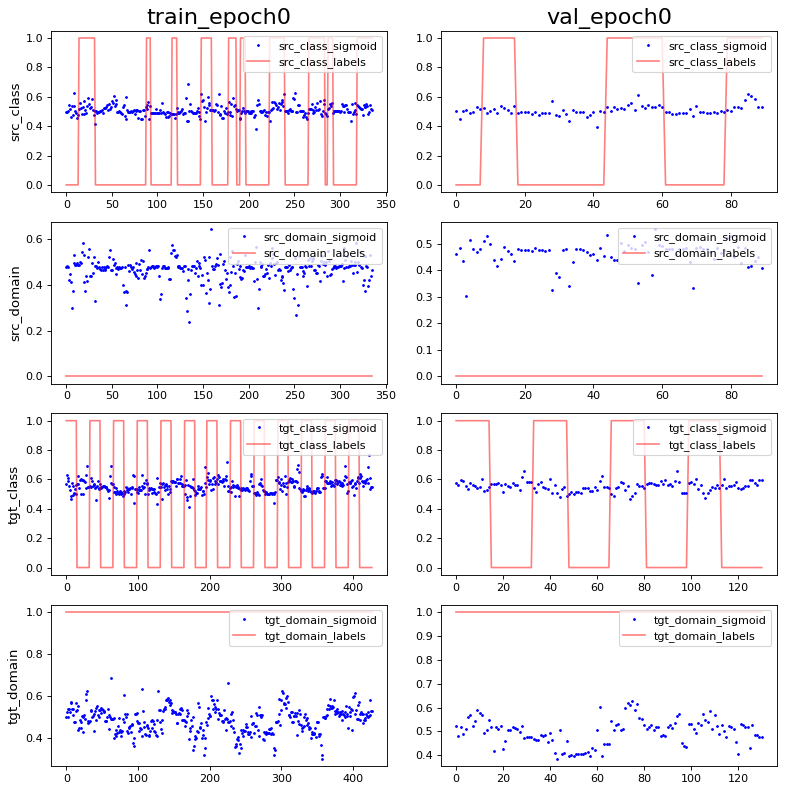

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 2.4303626e-09 0.99434173
PCA var: [16.699999 26.       32.9      38.600002 42.9      45.800003 48.100002
 49.800003 51.500004 53.000004]
show standardize mean and std: 3.596057e-10 0.993905
PCA var: [18.8      28.699999 36.8      42.899998 47.3      51.1      53.899998
 56.3      58.7      61.      ]


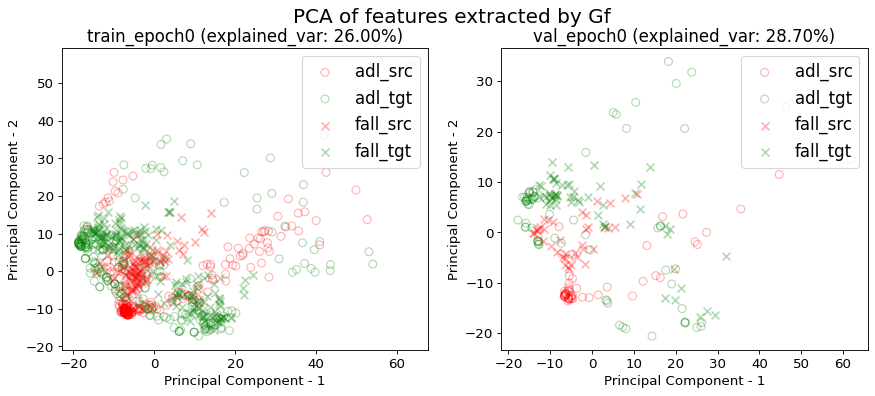

outputdir for baseline_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/


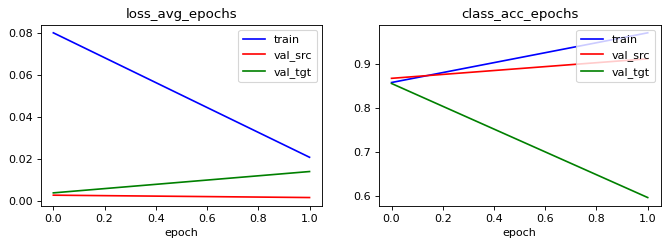

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
acc performance: 0.9851190476190477 0.011904761904761904 0.75 0.28869047619047616
acc performance: 0.9111111111111111 0.0 0.8666666666666667 0.25555555555555554


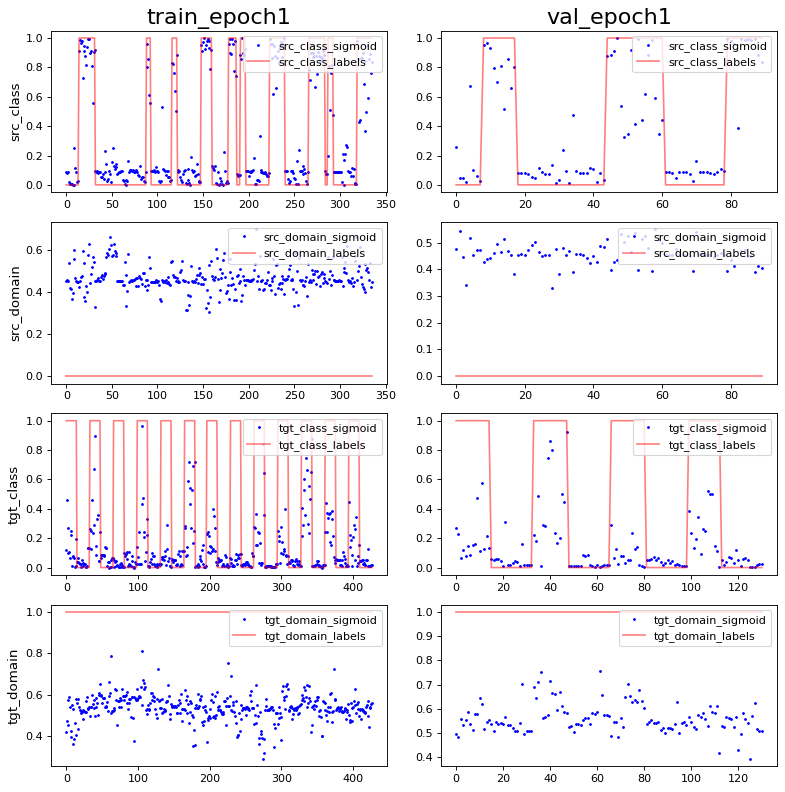

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/target/
show standardize mean and std: 2.992818e-08 0.99608606
PCA var: [39.6      51.199997 58.799995 62.699997 65.1      67.299995 68.99999
 70.399994 71.49999  72.49999 ]
show standardize mean and std: 3.6484995e-09 0.9943417
PCA var: [45.8      56.       63.2      67.4      69.9      72.200005 74.200005
 76.00001  77.40001  78.80001 ]


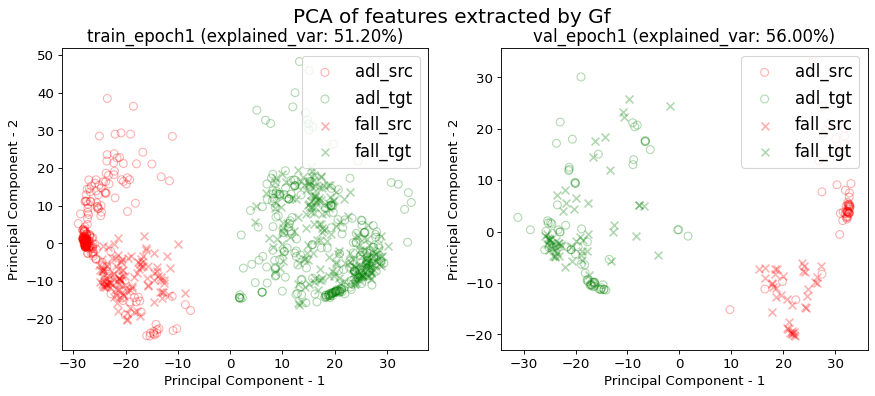

---------------Exporting model performance---------------
show df_performance


,i_CV,train_loss,train_acc,val_loss,val_acc,tgt_val_loss,tgt_val_acc
0,0.000000,0.026280,0.953947,0.003597,0.885246,0.016678,0.643939
1,1.000000,0.020697,0.970238,0.001559,0.911111,0.013920,0.595420
mean,0.500000,0.023489,0.962093,0.002578,0.898179,0.015299,0.619680
std,0.707107,0.003948,0.011519,0.001441,0.018289,0.001950,0.034309


src val loss: 0.0026±0.0014
src val acc: 0.8982±0.0183
tgt val loss: 0.0153±0.0020
tgt val acc: 0.6197±0.0343
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 426, 'classes_n': 2, 'model_name': 'DannModel', 'dataset_name': 'UMAFall', 'num_epochs': 2, 'channel_n': 32, 'batch_size': 4, 'learning_rate': 0.001, 'sensor_loc': 'ankle', 'date': '2020/04/09 20:16:11', 'input_dim': (4, 3, 66), 'output_dim': (4,)}

======================  DANN training transferring knowledge(source=UPFall_wrist to target=UMAFall_ankle)  ======================

------------------------------Working on i_CV 0------------------------------
Working on get_UPFall_loader...
train_data shape: (426, 3, 66)
val_data shape: (132, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (304, 3, 66)
val_data shape: (122, 3, 66)
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stag

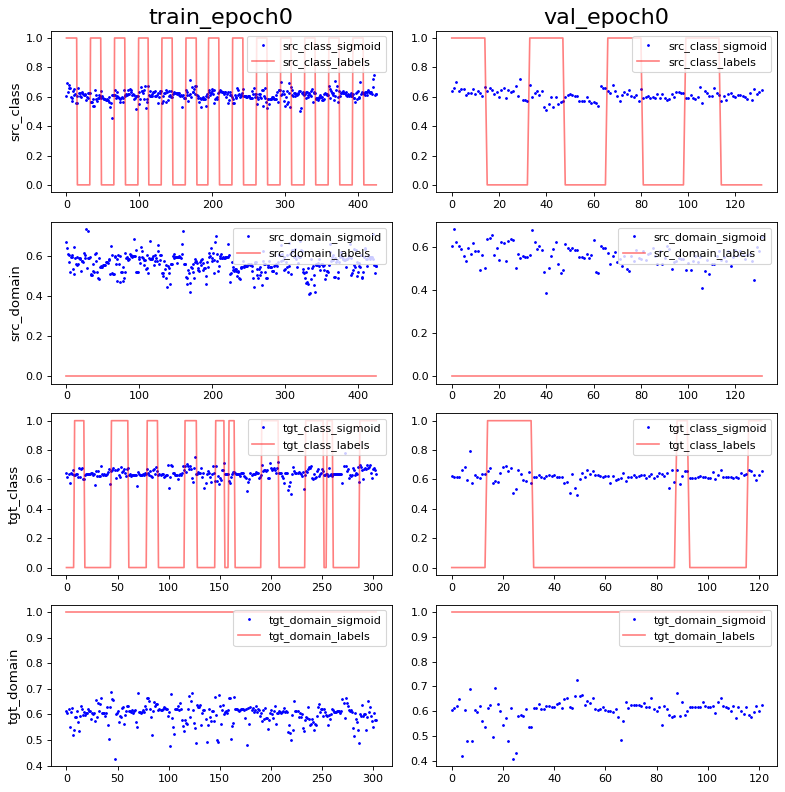

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 3.0845632e-10 0.9969572
PCA var: [14.200001 25.1      31.900002 37.600002 42.600002 45.800003 48.300003
 50.200005 51.900005 53.500004]
show standardize mean and std: 2.6073772e-09 0.9934682
PCA var: [16.9      28.5      36.2      42.3      47.9      51.2      54.2
 56.600002 58.800003 60.700005]


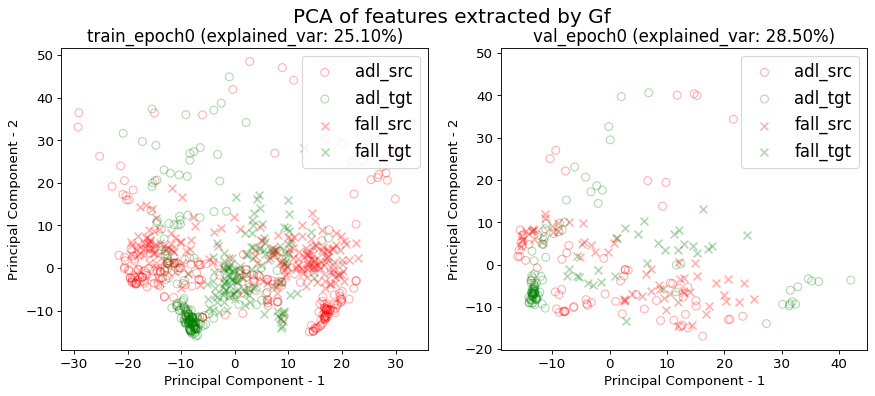

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/


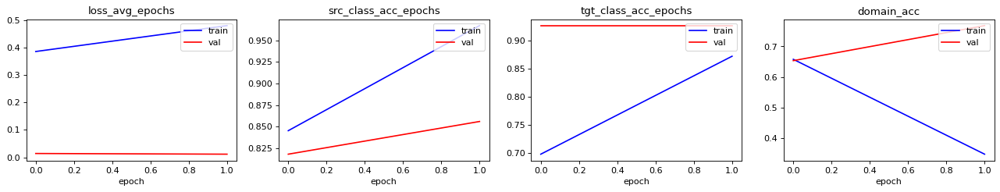

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.9530516431924883 0.7582159624413145 0.5915492957746479 0.6244131455399061
acc performance: 0.8560606060606061 0.6818181818181818 0.8560606060606061 0.7954545454545454


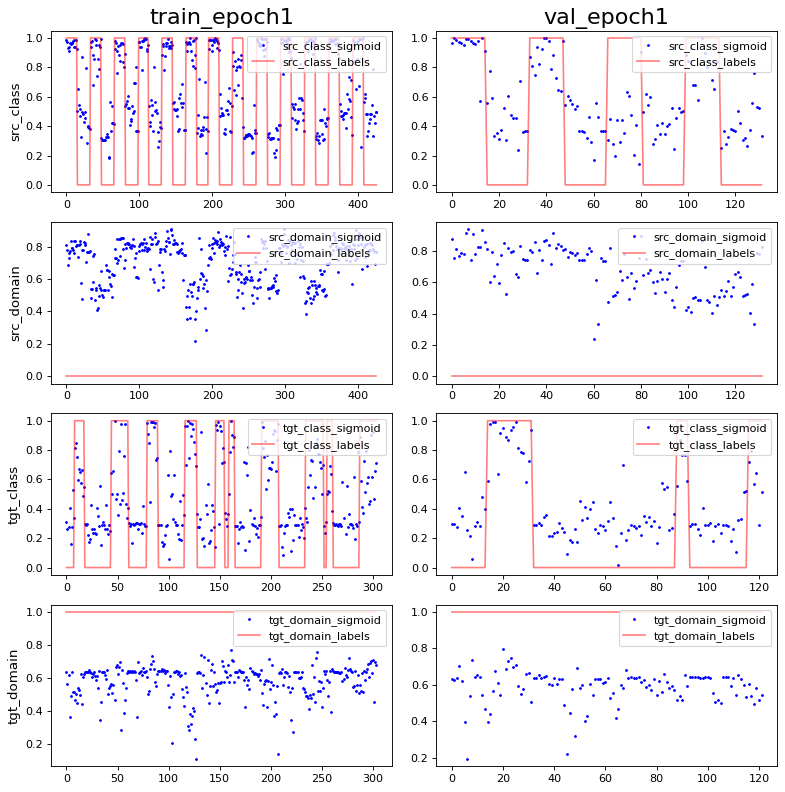

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: -3.7740535e-09 0.992594
PCA var: [39.5      50.1      57.3      61.5      64.4      66.6      68.4
 69.9      71.1      72.299995]
show standardize mean and std: -5.840525e-09 0.9904054
PCA var: [33.399998 45.799995 54.999996 60.099995 63.899994 67.299995 69.899994
 71.799995 73.299995 74.799995]


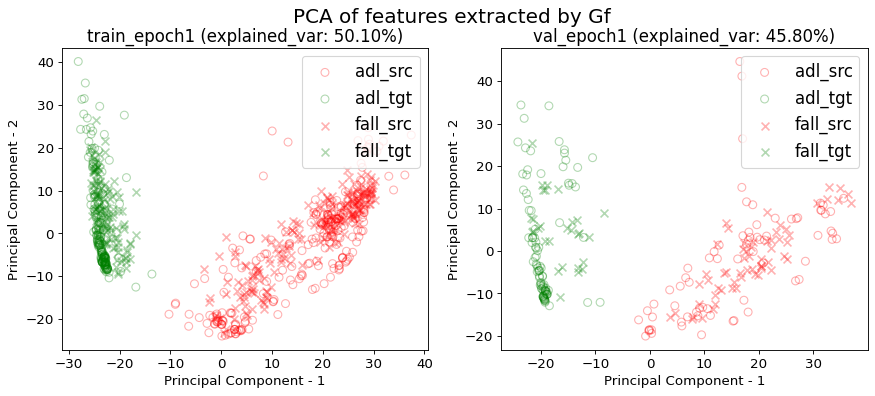

------------------------------Working on i_CV 1------------------------------
Working on get_UPFall_loader...
train_data shape: (427, 3, 66)
val_data shape: (131, 3, 66)
Working on get_UMAFall_loader...
train_data shape: (336, 3, 66)
val_data shape: (90, 3, 66)
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.5011709601873536 0.1405152224824356 0.5152224824355972 0.5831381733021077
acc performance: 0.5648854961832062 0.08396946564885496 0.3969465648854962 0.6641221374045801


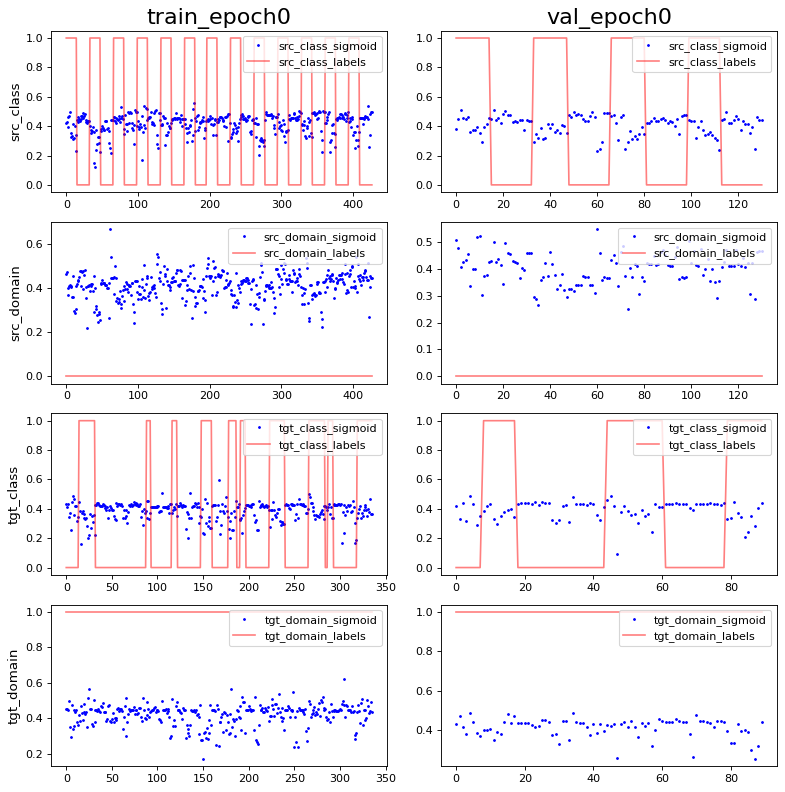

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: 1.1804618e-09 0.9969571
PCA var: [17.800001 29.800001 36.100002 40.600002 44.300003 47.300003 49.700005
 52.000004 53.800003 55.300003]
show standardize mean and std: 1.2286528e-09 0.99565023
PCA var: [19.6 31.2 39.  44.4 48.9 52.5 55.2 57.7 60.  62.2]


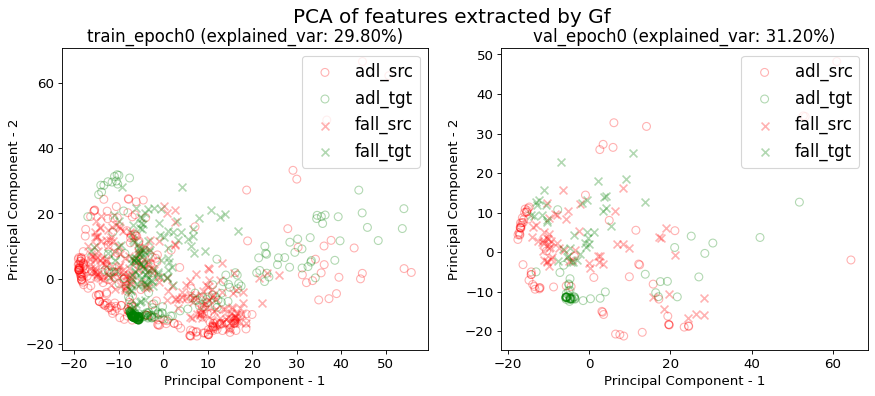

outputdir for dann_learning_diagnosis output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/


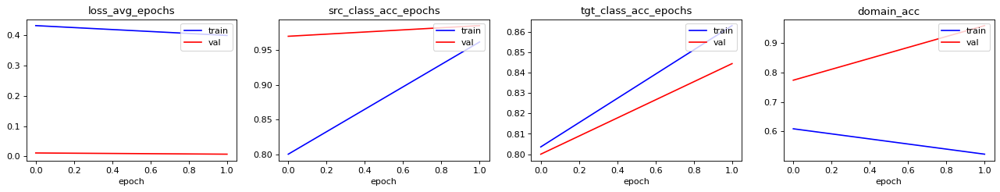

-----------------Exporting pytorch model-----------------
FeatureExtractor_total_params: 6720
DannModel_total_params: 11332
model saved successfully
-----------------Evaluating trained model-----------------
outputdir for model_output_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
acc performance: 0.9718969555035128 0.9742388758782201 0.7166276346604216 0.7213114754098361
acc performance: 0.9847328244274809 0.9923664122137404 0.5801526717557252 0.6259541984732825


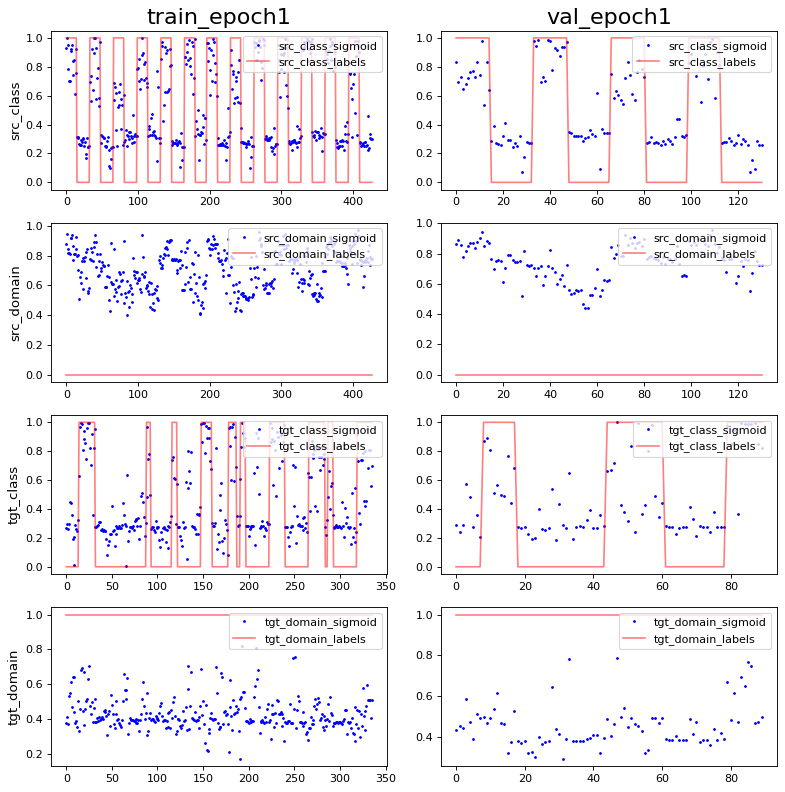

outputdir for model_features_diagnosis_trainval output: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/dann/
show standardize mean and std: -1.2499008e-09 0.99215686
PCA var: [22.9 39.6 49.5 53.7 56.9 60.  62.3 64.3 65.9 67.1]
show standardize mean and std: -5.24425e-10 0.989967
PCA var: [25.3      39.899998 50.499996 55.699997 59.699997 62.899998 65.899994
 68.09999  70.19999  71.89999 ]


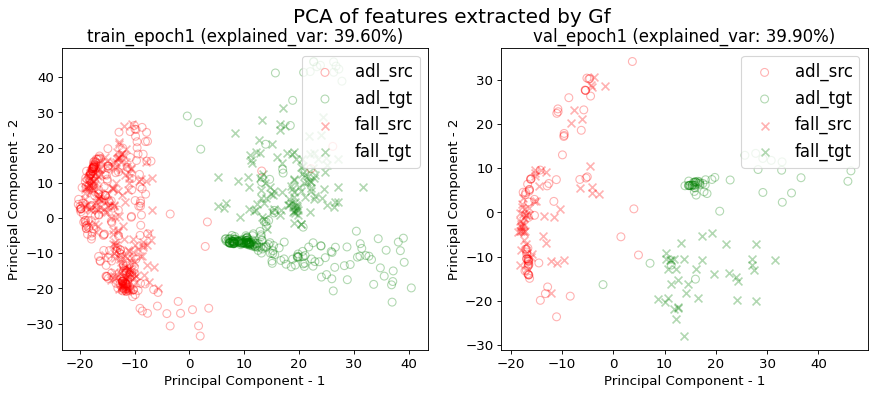

---------------Exporting model performance---------------
show df_performance


,i_CV,train_src_class_loss,train_tgt_class_loss,train_src_domain_loss,train_tgt_domain_loss,train_src_class_acc,train_tgt_class_acc,train_domain_acc,val_src_class_loss,val_tgt_class_loss,val_src_domain_loss,val_tgt_domain_loss,val_src_class_acc,val_tgt_class_acc,val_domain_acc
0,0.000000,0.029689,0.081585,0.229283,0.221280,0.967105,0.871711,0.348684,0.003275,0.001428,0.003745,0.004352,0.856061,0.926230,0.767717
1,1.000000,0.043959,0.085419,0.174612,0.181307,0.961310,0.863095,0.522321,0.001255,0.003140,0.001079,0.004798,0.984733,0.844444,0.959276
mean,0.500000,0.036824,0.083502,0.201948,0.201293,0.964207,0.867403,0.435503,0.002265,0.002284,0.002412,0.004575,0.920397,0.885337,0.863496
std,0.707107,0.010091,0.002710,0.038659,0.028265,0.004098,0.006092,0.122780,0.001428,0.001211,0.001885,0.000316,0.090985,0.057831,0.135453


val_src_class_acc: 0.9204±0.0910
val_tgt_class_acc: 0.8853±0.0578
val_domain_acc: 0.8635±0.1355
--------------Exporting notebook parameters--------------
{'CV_n': 2, 'samples_n': 558, 'classes_n': 2, 'model_name': 'DannModel', 'src_dataset_name': 'UPFall', 'tgt_dataset_name': 'UMAFall', 'src_sensor_loc': 'wrist', 'tgt_sensor_loc': 'ankle', 'date': '2020/04/09 20:16:27', 'num_epochs': 2, 'channel_n': 32, 'batch_size': 4, 'learning_rate': 0.001, 'input_dim': (4, 3, 66), 'output_dim': 2, 'label_dim': (4,)}
val_tgt_class_acc: 0.8853±0.0578
val_domain_acc: 0.8635±0.1355
time elapsed: 00:00:43


,HP_i0,HP_i1,HP_i2,HP_i3,HP_i3_1,HP_i4,HP_i5,HP_i5_1,HP_i6,HP_optimal
channel_n,4,4,4,16,4,32,4,4,4,32
batch_size,16,4,64,4,4,4,4,4,4,4
learning_rate,0.01,0.01,0.01,0.01,0.01,0.01,0.001,0.01,0.0001,0.001
source,0.806±0.135,0.811±0.094,0.812±0.127,0.787±0.139,0.811±0.094,0.913±0.019,0.812±0.127,0.811±0.094,0.603±0.225,0.866±0.109
DANN,0.751±0.120,0.823±0.158,0.592±0.240,0.703±0.130,0.823±0.158,0.863±0.043,0.841±0.121,0.823±0.158,0.504±0.273,0.885±0.058
target,0.727±0.212,0.904±0.026,0.681±0.115,0.837±0.021,0.904±0.026,0.872±0.007,0.795±0.024,0.904±0.026,0.674±0.090,0.898±0.018
domain,0.300±0.244,0.324±0.201,0.570±0.071,0.423±0.080,0.324±0.201,0.647±0.076,0.679±0.192,0.324±0.201,0.665±0.083,0.863±0.135
time_elapsed,38.3151,44.6747,35.9858,43.9137,44.6747,44.2475,44.9921,44.6747,44.2649,43.3774
num_params,748,748,748,4132,748,11332,748,748,748,11332


df_outputdir for stage2 df_performance_table_agg: /home/mchan2020/project_FDDAT/data_mic/stage2_modeloutput_18hz_5fold/UPFall_wrist_UMAFall_ankle/HP_search/


In [9]:
# fine-tuning

# tasks_list = [('UMAFall_waist', 'UPFall_belt'), ('UMAFall_waist', 'UPFall_belt')]

# extractor_type = 'CNN'
# num_epochs = 2
# CV_n = 2
# rep_n = 2
# device = torch.device('cuda:1' if torch.cuda.is_available() else 'cpu')



for task_item in tasks_list:
    (src_name, tgt_name) = task_item

    task_outputdir = home_dir + 'data_mic/{}/{}_{}/'.format(output_folder, src_name, tgt_name)

    if not os.path.exists(task_outputdir):
        os.makedirs(task_outputdir)
    print('outputdir for stage2 {} output: {}'.format(task_item, task_outputdir))

    df_outputdir = task_outputdir+'HP_search/'
    if not os.path.exists(df_outputdir):
        os.makedirs(df_outputdir)
    print('HP df_performance_table_agg saved at', df_outputdir)

    df_performance_table_agg = pd.DataFrame('', index=['channel_n', 'batch_size', 'learning_rate', 
                                                  'source', 'DANN', 'target', 'domain', 'time_elapsed', 'num_params'], columns=[])

  # 1. try all HP
    for i, training_params in enumerate(training_params_list):
#         if 'rightpocket' in src_name or 'leg' in tgt_name or 'rightpocket' in tgt_name or 'leg' in src_name:
#             training_params['CV_n'] = 15
#         else:
#             training_params['CV_n'] = 17
        df_performance_table = performance_table(src_name, tgt_name, training_params, inputdir, task_outputdir)
        df_performance_table_agg[training_params['HP_name']] = df_performance_table


    # 2. agg all HP
    df_performance_table_agg['HP_i3_1'] = df_performance_table_agg['HP_i1']
    df_performance_table_agg['HP_i5_1'] = df_performance_table_agg['HP_i1']

    # 3. run optimal param for a task
    batch_size_optimal, channel_n_optimal, learning_rate_optimal = get_optimal(df_performance_table_agg)
    training_params_optimal = training_params.copy()
    training_params_optimal['HP_name'] = 'HP_optimal'
    training_params_optimal['batch_size'] = batch_size_optimal
    training_params_optimal['channel_n'] = channel_n_optimal
    training_params_optimal['learning_rate'] = learning_rate_optimal

    df_performance_table = performance_table(src_name, tgt_name, training_params_optimal, inputdir, task_outputdir)
    df_performance_table_agg[training_params_optimal['HP_name']] = df_performance_table

    df_performance_table_agg = df_performance_table_agg[['HP_i0','HP_i1','HP_i2','HP_i3','HP_i3_1','HP_i4','HP_i5','HP_i5_1','HP_i6','HP_optimal']]
    display(df_performance_table_agg)

    print('df_outputdir for stage2 df_performance_table_HP_agg:', df_outputdir)
    df_performance_table_agg.to_csv(df_outputdir+'df_performance_table_HP_agg.csv', encoding='utf-8')

    # Serialize data into file:
    json.dump({key:val for key, val in training_params.items() if key != 'device'}, open(df_outputdir+'optimal_training_params.json', 'w'))
